In [2]:
import pyodbc
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import sweetviz as sv
from scipy.stats import spearmanr

In [4]:
##!pip install sweetviz

In [5]:
!pip install pyMechkar

# Preparation of the data before EDA

In [312]:
### downloded the file
path = "C:/Users/dalit/DataScience/project/final_project/final_project_files/ff_phyto_2412.csv"


In [313]:
### user pandas to read the csv (read_csv())
### show the top rows
ff_phyto = pd.read_csv(path)
ff_phyto.head()

,d_stamp,T_round1,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,wind_speed,pressure,BAROMETER,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgVolt,AvgLinearAdjVal,dominant_period,significant_height,mean_period,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,Direction_DegM,East_cm_s,Temperature_DegC,Heading_DegM,North_cm_s,Abs_Speed_cm_s,Abs_Tilt_Deg,Ping_Count,DCS_MEASUREMENT,Strength_dB,Max_Tilt_Deg,Std_Tilt_Deg,SP_Std_cm_s,Tilt_Y_Deg,Tilt_X_Deg,g_5,g_11,g_14,g_16,g_18,g_23,g_32,g_34,g_41,...,depth_11,depth_41,depth_77,depth_35,depth_65,depth_111,depth_49,depth_91,depth_131,depth_53,depth_115,depth_31,depth_59,depth_61,depth_27,depth_83,depth_57,depth_121,depth_13,depth_75,depth_47,depth_43,depth_29,depth_19,depth_113,depth_97,depth_101,depth_93,depth_17,depth_7,depth_107,depth_133,depth_37,depth_33,depth_25,depth_67,depth_63,depth_125,depth_55,depth_87,depth_117,depth_109,depth_123,depth_5,depth_71,depth_119,depth_135,depth_9,depth_79,chl_pred
0,26/07/2017,00:00,0.0714,0.1769,28.1,86.1,25.5,158.0,1.31,1004.9,1004.77,2396.000000,0.851038,85.103783,2290.199951,0.592186,29.218563,3.773585,0.349965,3.569183,1.002698,-1.398390,1.720726,2.459251,312.267985,305.641944,354.1157,-3.813206,29.65594,268.5581,36.99874,37.19472,3.019041,150.0,4830 164,-23.24216,6.657907,1.341434,15.58672,2.110645,-1.209371,29.66,NaN,28.57,NaN,NaN,27.62,24.81,NaN,NaN,...,0.27,0.35,0.04,0.36,0.07,NaN,0.25,0.04,NaN,0.10,NaN,0.41,0.14,0.09,0.41,0.08,0.12,NaN,0.36,0.04,0.28,0.34,0.44,0.47,NaN,46.34,0.07,0.05,0.45,0.11,46.34,NaN,0.35,0.39,0.42,0.04,0.04,NaN,0.09,0.08,NaN,46.34,NaN,0.09,0.07,NaN,NaN,0.16,0.05,0.0357
1,26/07/2017,00:30,0.0952,0.1891,28.1,86.1,25.6,181.0,1.62,1005.0,1004.85,2395.399902,0.848596,84.859589,2285.600098,0.579976,27.997559,4.878049,0.367506,3.535415,0.846920,-1.376217,1.615935,2.175767,300.039045,301.608035,359.1959,-0.561202,29.70995,271.6772,39.98478,39.98871,2.911384,150.0,4830 164,-23.27668,5.847709,1.299325,14.46207,1.981044,-1.250808,29.71,NaN,28.77,NaN,NaN,27.47,24.84,NaN,NaN,...,0.24,0.32,0.03,0.36,0.02,NaN,0.20,0.06,NaN,0.17,NaN,0.43,0.11,0.11,0.44,0.08,0.12,NaN,0.33,0.05,0.24,0.31,0.43,0.46,NaN,46.34,0.02,0.10,0.47,0.09,46.34,NaN,0.36,0.39,0.41,0.04,0.08,NaN,0.18,0.07,NaN,46.34,NaN,0.09,0.01,NaN,NaN,0.20,0.05,0.0833
2,26/07/2017,01:00,0.0833,0.1830,28.1,86.4,25.7,156.0,1.50,1005.0,1004.86,2395.600098,0.848596,84.859589,2289.399902,0.589744,28.974361,5.000000,0.383257,3.631777,1.146126,-1.358030,1.777034,2.635434,319.647782,310.163108,357.7892,-1.451574,29.77465,275.9652,37.60177,37.62978,3.168113,150.0,4830 164,-23.10335,5.826721,1.266041,13.41110,2.220903,-1.250385,29.77,NaN,29.00,NaN,NaN,27.37,24.84,NaN,NaN,...,0.24,0.36,0.05,0.37,0.04,NaN,0.28,0.12,NaN,0.15,NaN,0.41,0.11,0.09,0.39,0.07,0.07,NaN,0.38,0.02,0.26,0.30,0.40,0.38,NaN,46.34,0.05,0.10,0.41,0.10,46.34,NaN,0.37,0.39,0.43,0.05,0.05,NaN,0.15,0.15,NaN,46.34,NaN,0.12,0.03,NaN,NaN,0.23,0.08,0.0595
3,26/07/2017,01:30,0.0952,0.1891,28.1,84.6,25.2,188.0,1.26,1005.2,1005.10,2396.800049,0.851038,85.103783,2291.600098,0.594628,29.462761,4.444444,0.372835,3.516434,0.765793,-1.554695,1.733065,2.224795,296.202083,296.223396,358.5420,-1.051971,29.80680,277.9121,41.33030,41.34369,3.110452,150.0,4830 164,-22.73948,7.249548,1.349087,12.59318,2.145411,-1.218997,29.80,NaN,29.15,NaN,NaN,27.35,24.91,NaN,NaN,...,0.19,0.29,0.04,0.39,0.10,NaN,0.28,0.00,NaN,0.17,NaN,0.42,0.12,0.11,0.40,0.08,0.13,NaN,0.28,0.02,0.23,0.33,0.41,0.45,NaN,46.34,0.02,0.07,0.47,0.16,46.34,NaN,0.38,0.35,0.38,0.07,0.04,NaN,0.15,0.06,NaN,46.34,NaN,0.07,0.07,NaN,NaN,0.10,0.05,0.0833
4,26/07/2017,02:00,0.1071,0.2013,27.9,85.2,25.2,150.0,1.68,1005.3,1005.15,2391.399902,0.838828,83.882782,2291.000000,0.594628,29.462761,5.263158,0.344267,3.569575,0.691532,-1.261911,1.438970,2.007683,296.419762,298.722904,356.7025,-2.372008,29.84918,276.6292,41.17012,41.23840,3.014416,150.0,4830 164,-22.44899,6.186117,1.233424,11.52631,2.222263,-1.22

In [8]:
##change to float
ff_phyto=ff_phyto.astype({"chlorophyll_concentration":float})
ff_phyto=ff_phyto.astype({"chl_pred":float})
ff_phyto.dtypes

d_stamp                       object
T_round1                      object
chlorophyll_concentration    float64
turbidity_units              float64
temperature                  float64
                              ...   
depth_119                    float64
depth_135                    float64
depth_9                      float64
depth_79                     float64
chl_pred                     float64
Length: 126, dtype: object

In [9]:
list(ff_phyto)

['d_stamp',
 'T_round1',
 'chlorophyll_concentration',
 'turbidity_units',
 'temperature',
 'humidity',
 'dewpoint',
 'wind_direction',
 'wind_speed',
 'pressure',
 'BAROMETER',
 'external_humidity_AvgVal',
 'e_AvgVolt',
 'e_AvgLinearAdjVal',
 'external_temperature_AvgVal',
 'AvgVolt',
 'AvgLinearAdjVal',
 'dominant_period',
 'significant_height',
 'mean_period',
 'north',
 'east',
 'magnitude_1',
 'magnitude_2',
 'gustdirection',
 'winddirection',
 'Direction_DegM',
 'East_cm_s',
 'Temperature_DegC',
 'Heading_DegM',
 'North_cm_s',
 'Abs_Speed_cm_s',
 'Abs_Tilt_Deg',
 'Ping_Count',
 'DCS_MEASUREMENT',
 'Strength_dB',
 'Max_Tilt_Deg',
 'Std_Tilt_Deg',
 'SP_Std_cm_s',
 'Tilt_Y_Deg',
 'Tilt_X_Deg',
 'g_5',
 'g_11',
 'g_14',
 'g_16',
 'g_18',
 'g_23',
 'g_32',
 'g_34',
 'g_41',
 'g_50',
 'g_52',
 'g_59',
 'g_61',
 'g_68',
 'g_77',
 'g_86',
 'temp_avg',
 'depth_103',
 'depth_85',
 'depth_39',
 'depth_69',
 'depth_73',
 'depth_127',
 'depth_105',
 'depth_95',
 'depth_15',
 'depth_129',
 'de

In [11]:
#change to numeric for the sweetwiz
ff_phyto['d_stamp'] = pd.to_numeric(ff_phyto['d_stamp'], errors='coerce')
ff_phyto['T_round1'] = pd.to_numeric(ff_phyto['T_round1'], errors='coerce')
ff_phyto.dtypes

d_stamp                      float64
T_round1                     float64
chlorophyll_concentration    float64
turbidity_units              float64
temperature                  float64
                              ...   
depth_119                    float64
depth_135                    float64
depth_9                      float64
depth_79                     float64
chl_pred                     float64
Length: 126, dtype: object

C:\Users\dalit\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


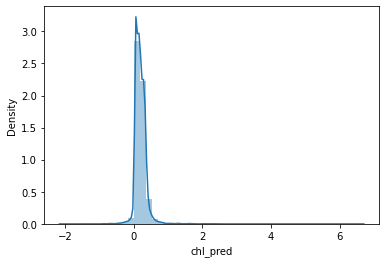

In [12]:
##
sns.distplot(ff_phyto['chl_pred'])
plt.show()

In [13]:
# checking the element is < 0 
ff_phyto[ff_phyto['chl_pred'] < 0] = 0
ff_phyto[ff_phyto['chlorophyll_concentration'] < 0] = 0

In [14]:
ff_phyto.head()

,d_stamp,T_round1,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,wind_speed,pressure,...,depth_117,depth_109,depth_123,depth_5,depth_71,depth_119,depth_135,depth_9,depth_79,chl_pred
0,NaN,NaN,0.0714,0.1769,28.1,86.1,25.5,158.0,1.31,1004.9,...,NaN,46.34,NaN,0.09,0.07,NaN,NaN,0.16,0.05,0.0357
1,NaN,NaN,0.0952,0.1891,28.1,86.1,25.6,181.0,1.62,1005.0,...,NaN,46.34,NaN,0.09,0.01,NaN,NaN,0.20,0.05,0.0833
2,NaN,NaN,0.0833,0.1830,28.1,86.4,25.7,156.0,1.50,1005.0,...,NaN,46.34,NaN,0.12,0.03,NaN,NaN,0.23,0.08,0.0595
3,NaN,NaN,0.0952,0.1891,28.1,84.6,25.2,188.0,1.26,1005.2,...,NaN,46.34,NaN,0.07,0.07,NaN,NaN,0.10,0.05,0.0833
4,NaN,NaN,0.1071,0.2013,27.9,85.2,25.2,150.0,1.68,1005.3,...,NaN,46.34,NaN,0.11,0.03,NaN,NaN,0.13,0.09,0.0476


In [15]:
##ff_phyto.describe(include='all')

C:\Users\dalit\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


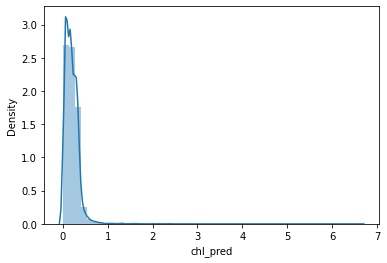

In [16]:
sns.distplot(ff_phyto['chl_pred'],bins=50 )
plt.show()

In [17]:
ff_phyto=ff_phyto.round(3)

In [18]:
for i in ff_phyto.columns:
    ff_phyto[i]=np.where((ff_phyto[i]==46.34) & (ff_phyto[i]==46.340),np.nan,ff_phyto[i])

In [19]:
ff_phyto.describe()

,d_stamp,T_round1,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,wind_speed,pressure,...,depth_117,depth_109,depth_123,depth_5,depth_71,depth_119,depth_135,depth_9,depth_79,chl_pred
count,820.0,820.0,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,...,6019.000000,1654.000000,6019.000000,17747.000000,14969.000000,6019.000000,820.0,17044.000000,13586.000000,19334.000000
mean,0.0,0.0,0.200678,0.763214,22.387018,64.296659,16.067363,164.828110,4.713126,971.283335,...,0.030678,0.119583,0.067701,0.235304,0.176831,0.042117,0.0,0.138394,0.172762,0.200946
std,0.0,0.0,0.176487,0.804897,6.259734,16.872609,5.978084,104.926174,2.822251,204.468589,...,0.024356,0.169736,0.045987,0.211081,0.155088,0.031160,0.0,0.107942,0.154464,0.175231
min,0.0,0.0,0.000000,-0.110000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000
25%,0.0,0.0,0.085000,0.183000,19.300000,59.700000,12.200000,86.336750,2.760000,1010.700000,...,0.010000,0.000000,0.030000,0.080000,0.070000,0.020000,0.0,0.070000,0.060000,0.085000
50%,0.0,0.0,0.178000,0.342000,24.000000,67.700000,16.400000,144.980000,4.370000,1013.700000,...,0.030000,0.010000,0.070000,0.170000,0.130000,0.040000,0.0,0.110000,0.120000,0.178000
75%,0.0,0.0,0.286000,1.226000,27.100000,74.100000,21.000000,259.122750,6.290000,1017.000000,...,0.040000,0.197500,0.100000,0.330000,0.250000,0.060000,0.0,0.190000,0.250000,0.286000
max,0.0,0.0,6.628000,24.894000,33.400000,93.500000,27.800000,359.988000,21.640000,1031.300000,...,0.220000,0.720000,0.270000,1.550000,0.940000,0.260000,0.0,3.996000,0.930000,6.628000


In [20]:
# Drop the columns 'Ping_Count','DCS_MEASUREMENT' as it is of no use.
ff_phyto1 = ff_phyto.drop(['Ping_Count','DCS_MEASUREMENT'], axis = 1)

In [21]:
ff_phyto1.head()

,d_stamp,T_round1,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,wind_speed,pressure,...,depth_117,depth_109,depth_123,depth_5,depth_71,depth_119,depth_135,depth_9,depth_79,chl_pred
0,NaN,NaN,0.071,0.177,28.1,86.1,25.5,158.0,1.31,1004.9,...,NaN,NaN,NaN,0.09,0.07,NaN,NaN,0.16,0.05,0.036
1,NaN,NaN,0.095,0.189,28.1,86.1,25.6,181.0,1.62,1005.0,...,NaN,NaN,NaN,0.09,0.01,NaN,NaN,0.20,0.05,0.083
2,NaN,NaN,0.083,0.183,28.1,86.4,25.7,156.0,1.50,1005.0,...,NaN,NaN,NaN,0.12,0.03,NaN,NaN,0.23,0.08,0.060
3,NaN,NaN,0.095,0.189,28.1,84.6,25.2,188.0,1.26,1005.2,...,NaN,NaN,NaN,0.07,0.07,NaN,NaN,0.10,0.05,0.083
4,NaN,NaN,0.107,0.201,27.9,85.2,25.2,150.0,1.68,1005.3,...,NaN,NaN,NaN,0.11,0.03,NaN,NaN,0.13,0.09,0.048


In [22]:
ff_phyto1['d_stamp'] = pd.to_numeric(ff_phyto1['d_stamp'], errors='coerce')
ff_phyto1['T_round1'] = pd.to_numeric(ff_phyto1['T_round1'], errors='coerce')
ff_phyto1.dtypes

d_stamp                      float64
T_round1                     float64
chlorophyll_concentration    float64
turbidity_units              float64
temperature                  float64
                              ...   
depth_119                    float64
depth_135                    float64
depth_9                      float64
depth_79                     float64
chl_pred                     float64
Length: 124, dtype: object

In [23]:
pd.set_option('display.max_columns', 100)
pd.set_option('display.max_rows', 100)

In [24]:
ff_phyto1.describe(include='all')


,d_stamp,T_round1,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,wind_speed,pressure,BAROMETER,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgVolt,AvgLinearAdjVal,dominant_period,significant_height,mean_period,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,Direction_DegM,East_cm_s,Temperature_DegC,Heading_DegM,North_cm_s,Abs_Speed_cm_s,Abs_Tilt_Deg,Strength_dB,Max_Tilt_Deg,Std_Tilt_Deg,SP_Std_cm_s,Tilt_Y_Deg,Tilt_X_Deg,g_5,g_11,g_14,g_16,g_18,g_23,g_32,g_34,g_41,g_50,g_52,...,depth_11,depth_41,depth_77,depth_35,depth_65,depth_111,depth_49,depth_91,depth_131,depth_53,depth_115,depth_31,depth_59,depth_61,depth_27,depth_83,depth_57,depth_121,depth_13,depth_75,depth_47,depth_43,depth_29,depth_19,depth_113,depth_97,depth_101,depth_93,depth_17,depth_7,depth_107,depth_133,depth_37,depth_33,depth_25,depth_67,depth_63,depth_125,depth_55,depth_87,depth_117,depth_109,depth_123,depth_5,depth_71,depth_119,depth_135,depth_9,depth_79,chl_pred
count,820.0,820.0,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19251.000000,19251.000000,19251.000000,19255.000000,19255.000000,19255.000000,19323.000000,19323.000000,19323.000000,14035.000000,14035.000000,14035.000000,14035.000000,14035.000000,14035.000000,19311.000000,19311.000000,19311.000000,19311.000000,19310.000000,19311.000000,19311.000000,19311.000000,19311.000000,19311.000000,19311.000000,19311.000000,19311.000000,13578.000000,820.0,8656.000000,4541.000000,820.0,11911.000000,5260.000000,4537.000000,4558.000000,10069.000000,4501.000000,...,16455.000000,15337.000000,14116.000000,15338.000000,15249.000000,968.000000,15337.000000,9653.000000,6018.000000,15333.000000,4331.000000,15338.00000,15326.000000,15304.000000,15341.000000,11785.000000,15328.000000,6019.000000,15942.000000,14476.000000,15338.000000,15337.000000,15338.000000,15371.000000,943.000000,6412.000000,9021.000000,8037.000000,15412.000000,17813.000000,1831.000000,820.0,15338.000000,15338.000000,15340.000000,15194.000000,15288.000000,6019.000000,15332.000000,9439.000000,6019.000000,1654.000000,6019.000000,17747.000000,14969.000000,6019.000000,820.0,17044.000000,13586.000000,19334.000000
mean,0.0,0.0,0.200678,0.763214,22.387018,64.296659,16.067363,164.828110,4.713126,971.283335,971.420763,2216.944294,0.625827,62.582407,2172.857814,0.518141,23.090034,7.659237,0.609216,3.796472,0.297307,-0.560094,4.420972,5.381194,197.118391,196.910482,130.633467,2.784823,24.467801,187.730427,5.976164,16.625155,4.142555,-16.882238,9.230592,1.606758,20.476455,1.011652,-2.667152,24.488562,0.0,25.374413,16.549932,0.0,29.551315,22.136975,36.455823,20.549846,89.206311,16.459196,...,0.145244,0.200997,0.173663,0.204319,0.180505,0.034711,0.194361,0.137367,0.043945,0.190281,0.047758,0.20383,0.184451,0.182999,0.205674,0.173769,0.186692,0.050920,0.159455,0.173795,0.196566,0.199711,0.204651,0.195219,0.028314,0.119713,0.086039,0.140730,0.185576,0.134502,0.128531,0.0,0.204059,0.203893,0.203467,0.179587,0.181842,0.064502,0.188885,0.171419,0.030678,0.119583,0.067701,0.235304,0.176831,0.042117,0.0,0.138394,0.172762,0.200946
std,0.0,0.0,0.176487,0.804897,6.259734,16.872609,5.978084,104.926174,2.822251,204.468589,204.495435,469.395671,0.165276,16.527451,458.610389,0.117336,6.477772,22.335089,0.485347,1.130619,3.765696,3.448744,2.632503,2.987457,114.297228,114.400972,110.916671,10.592411,6.229948,113.685791,17.011007,12.989605,2.634264,6.640234,4.951137,0.781498,10.813204,2.279083,2.637527,7.376653,0.0,114.368246,7.871865,0.0,565.754613,9.783761,1270.735349,17.602164,5095.309277,7.866661,...,0.215683,0.159977,0.154359,0.163230,0.154956,0.098029,0.157593,0.136854,0.030859,0.157502,0.044902,0.16429,0.156312,0.155890,0.247208,0.154438,0.156431,0.037881,0.231649,0.154602,0.157950,0.159352,0.164004,0.178477,0.088077,0.135548,0.102344,0.138168,0.165879,0.230797,0.170856,0.0,0.162494,0.163719,0.202357,0.155367,0.155701,0.

In [25]:
##Including only numeric columns in a DataFrame description.
ff_phyto1.describe(include=[np.number])

,d_stamp,T_round1,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,wind_speed,pressure,BAROMETER,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgVolt,AvgLinearAdjVal,dominant_period,significant_height,mean_period,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,Direction_DegM,East_cm_s,Temperature_DegC,Heading_DegM,North_cm_s,Abs_Speed_cm_s,Abs_Tilt_Deg,Strength_dB,Max_Tilt_Deg,Std_Tilt_Deg,SP_Std_cm_s,Tilt_Y_Deg,Tilt_X_Deg,g_5,g_11,g_14,g_16,g_18,g_23,g_32,g_34,g_41,g_50,g_52,...,depth_11,depth_41,depth_77,depth_35,depth_65,depth_111,depth_49,depth_91,depth_131,depth_53,depth_115,depth_31,depth_59,depth_61,depth_27,depth_83,depth_57,depth_121,depth_13,depth_75,depth_47,depth_43,depth_29,depth_19,depth_113,depth_97,depth_101,depth_93,depth_17,depth_7,depth_107,depth_133,depth_37,depth_33,depth_25,depth_67,depth_63,depth_125,depth_55,depth_87,depth_117,depth_109,depth_123,depth_5,depth_71,depth_119,depth_135,depth_9,depth_79,chl_pred
count,820.0,820.0,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19251.000000,19251.000000,19251.000000,19255.000000,19255.000000,19255.000000,19323.000000,19323.000000,19323.000000,14035.000000,14035.000000,14035.000000,14035.000000,14035.000000,14035.000000,19311.000000,19311.000000,19311.000000,19311.000000,19310.000000,19311.000000,19311.000000,19311.000000,19311.000000,19311.000000,19311.000000,19311.000000,19311.000000,13578.000000,820.0,8656.000000,4541.000000,820.0,11911.000000,5260.000000,4537.000000,4558.000000,10069.000000,4501.000000,...,16455.000000,15337.000000,14116.000000,15338.000000,15249.000000,968.000000,15337.000000,9653.000000,6018.000000,15333.000000,4331.000000,15338.00000,15326.000000,15304.000000,15341.000000,11785.000000,15328.000000,6019.000000,15942.000000,14476.000000,15338.000000,15337.000000,15338.000000,15371.000000,943.000000,6412.000000,9021.000000,8037.000000,15412.000000,17813.000000,1831.000000,820.0,15338.000000,15338.000000,15340.000000,15194.000000,15288.000000,6019.000000,15332.000000,9439.000000,6019.000000,1654.000000,6019.000000,17747.000000,14969.000000,6019.000000,820.0,17044.000000,13586.000000,19334.000000
mean,0.0,0.0,0.200678,0.763214,22.387018,64.296659,16.067363,164.828110,4.713126,971.283335,971.420763,2216.944294,0.625827,62.582407,2172.857814,0.518141,23.090034,7.659237,0.609216,3.796472,0.297307,-0.560094,4.420972,5.381194,197.118391,196.910482,130.633467,2.784823,24.467801,187.730427,5.976164,16.625155,4.142555,-16.882238,9.230592,1.606758,20.476455,1.011652,-2.667152,24.488562,0.0,25.374413,16.549932,0.0,29.551315,22.136975,36.455823,20.549846,89.206311,16.459196,...,0.145244,0.200997,0.173663,0.204319,0.180505,0.034711,0.194361,0.137367,0.043945,0.190281,0.047758,0.20383,0.184451,0.182999,0.205674,0.173769,0.186692,0.050920,0.159455,0.173795,0.196566,0.199711,0.204651,0.195219,0.028314,0.119713,0.086039,0.140730,0.185576,0.134502,0.128531,0.0,0.204059,0.203893,0.203467,0.179587,0.181842,0.064502,0.188885,0.171419,0.030678,0.119583,0.067701,0.235304,0.176831,0.042117,0.0,0.138394,0.172762,0.200946
std,0.0,0.0,0.176487,0.804897,6.259734,16.872609,5.978084,104.926174,2.822251,204.468589,204.495435,469.395671,0.165276,16.527451,458.610389,0.117336,6.477772,22.335089,0.485347,1.130619,3.765696,3.448744,2.632503,2.987457,114.297228,114.400972,110.916671,10.592411,6.229948,113.685791,17.011007,12.989605,2.634264,6.640234,4.951137,0.781498,10.813204,2.279083,2.637527,7.376653,0.0,114.368246,7.871865,0.0,565.754613,9.783761,1270.735349,17.602164,5095.309277,7.866661,...,0.215683,0.159977,0.154359,0.163230,0.154956,0.098029,0.157593,0.136854,0.030859,0.157502,0.044902,0.16429,0.156312,0.155890,0.247208,0.154438,0.156431,0.037881,0.231649,0.154602,0.157950,0.159352,0.164004,0.178477,0.088077,0.135548,0.102344,0.138168,0.165879,0.230797,0.170856,0.0,0.162494,0.163719,0.202357,0.155367,0.155701,0.

In [26]:
# import pyMechkar as py
# from pyMechkar import analysis
# tab1 = py.analysis.Table1(ff_phyto1)


In [27]:
##show nulls
print(ff_phyto1.isnull().sum())

d_stamp                      18514
T_round1                     18514
chlorophyll_concentration        0
turbidity_units                  0
temperature                      0
                             ...  
depth_119                    13315
depth_135                    18514
depth_9                       2290
depth_79                      5748
chl_pred                         0
Length: 124, dtype: int64


In [28]:
#analyzing the dataset
advert_report = sv.analyze(ff_phyto1)
#display the report
advert_report.show_html('ff_phyto1.html')

                                             |     | [  0%]   00:00 -> (? left)

Report ff_phyto1.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


Eaxmples of sweetwiz results


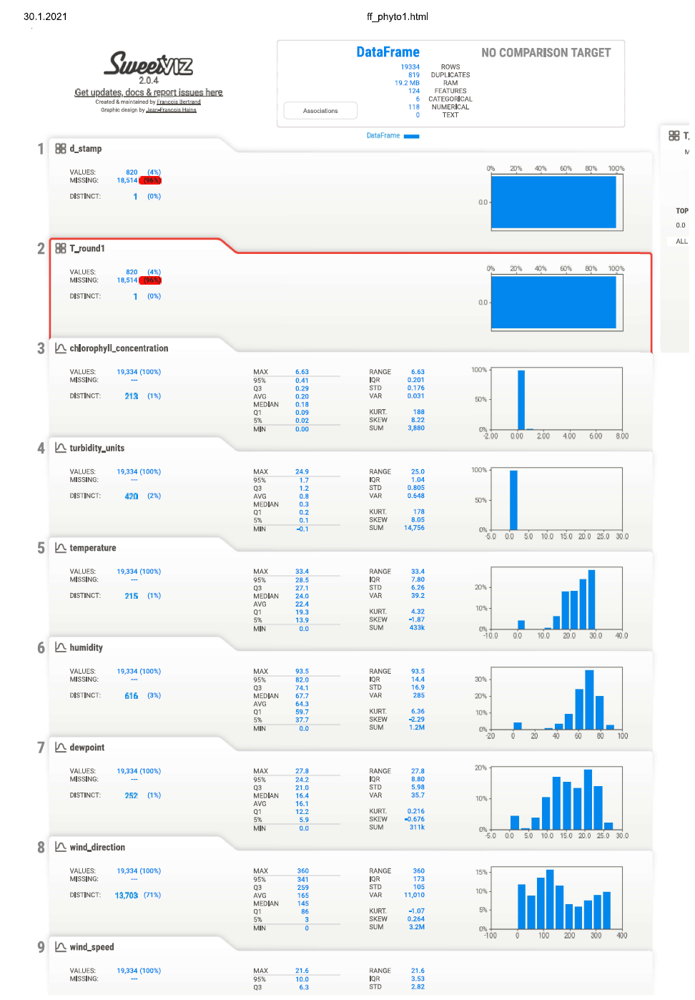

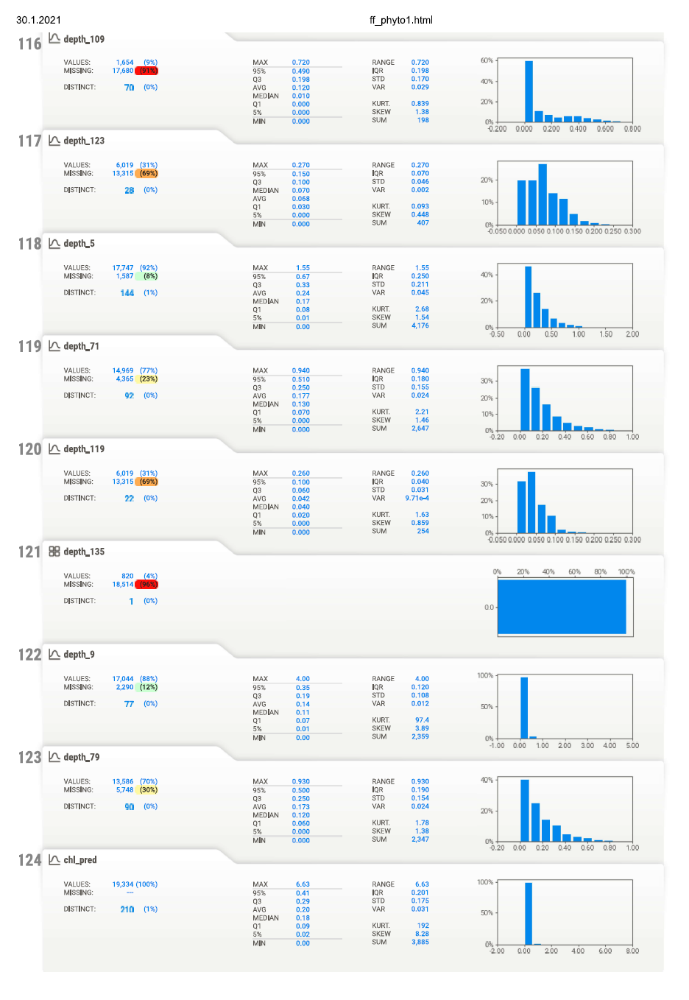

In [29]:
# Drop the columns that more than 90% were nulls according to analysis
ff_phyto2 = ff_phyto1.drop(['depth_133','depth_135','g_18','g_16','g_11','g_32','g_34','g_41','g_52','g_61',], axis = 1)

In [30]:
#analyzing the dataset once more
advert_report = sv.analyze(ff_phyto2)
#display the report
advert_report.show_html('ff_phyto1.html')

                                             |     | [  0%]   00:00 -> (? left)

Report ff_phyto1.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


In [31]:
my_list = list(ff_phyto2 )
my_list

['d_stamp',
 'T_round1',
 'chlorophyll_concentration',
 'turbidity_units',
 'temperature',
 'humidity',
 'dewpoint',
 'wind_direction',
 'wind_speed',
 'pressure',
 'BAROMETER',
 'external_humidity_AvgVal',
 'e_AvgVolt',
 'e_AvgLinearAdjVal',
 'external_temperature_AvgVal',
 'AvgVolt',
 'AvgLinearAdjVal',
 'dominant_period',
 'significant_height',
 'mean_period',
 'north',
 'east',
 'magnitude_1',
 'magnitude_2',
 'gustdirection',
 'winddirection',
 'Direction_DegM',
 'East_cm_s',
 'Temperature_DegC',
 'Heading_DegM',
 'North_cm_s',
 'Abs_Speed_cm_s',
 'Abs_Tilt_Deg',
 'Strength_dB',
 'Max_Tilt_Deg',
 'Std_Tilt_Deg',
 'SP_Std_cm_s',
 'Tilt_Y_Deg',
 'Tilt_X_Deg',
 'g_5',
 'g_14',
 'g_23',
 'g_50',
 'g_59',
 'g_68',
 'g_77',
 'g_86',
 'temp_avg',
 'depth_103',
 'depth_85',
 'depth_39',
 'depth_69',
 'depth_73',
 'depth_127',
 'depth_105',
 'depth_95',
 'depth_15',
 'depth_129',
 'depth_45',
 'depth_51',
 'depth_99',
 'depth_3',
 'depth_89',
 'depth_21',
 'depth_23',
 'depth_81',
 'depth_

<AxesSubplot:xlabel='chlorophyll_concentration'>

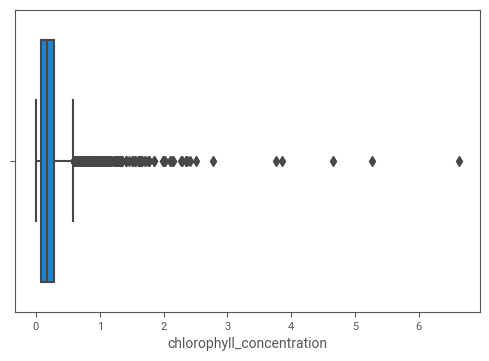

In [40]:
##show boxplots of some of the features 
import seaborn as sns
sns.boxplot(x=ff_phyto2['chlorophyll_concentration'])
# sns.boxplot(x=ff_phyto2['turbidity_units'])

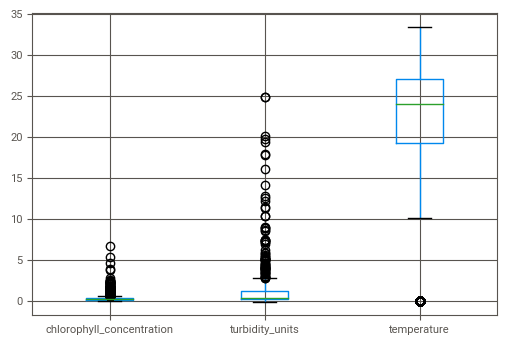

In [34]:
boxplot = ff_phyto1.boxplot(column=[ 
'chlorophyll_concentration',
'turbidity_units',
'temperature',
 ])##,by='chl_pred')

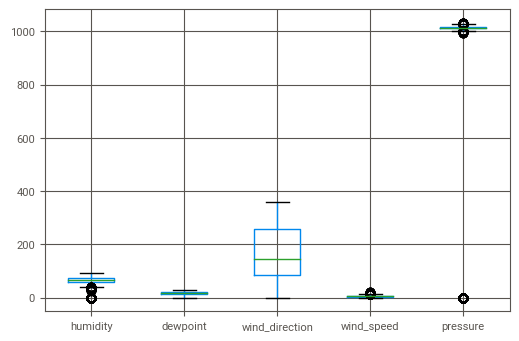

In [35]:
boxplot = ff_phyto1.boxplot(column=[ 
 'humidity',
 'dewpoint',
 'wind_direction',
 'wind_speed',
 'pressure',
 ])

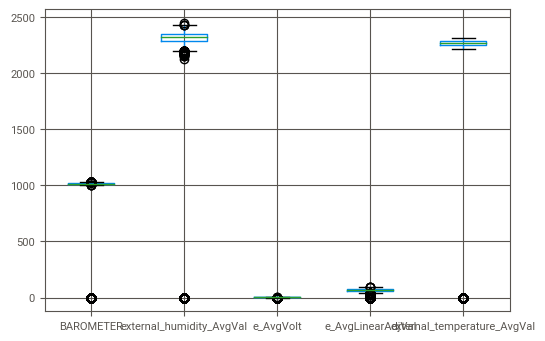

In [36]:
boxplot = ff_phyto1.boxplot(column=[ 
'BAROMETER',
 'external_humidity_AvgVal',
 'e_AvgVolt',
 'e_AvgLinearAdjVal',
 'external_temperature_AvgVal',
 
 ])

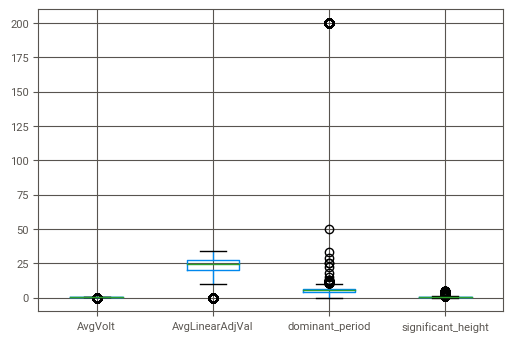

In [37]:
boxplot = ff_phyto1.boxplot(column=[ 

 'AvgVolt',
 'AvgLinearAdjVal',
 'dominant_period',
 'significant_height',
 ])

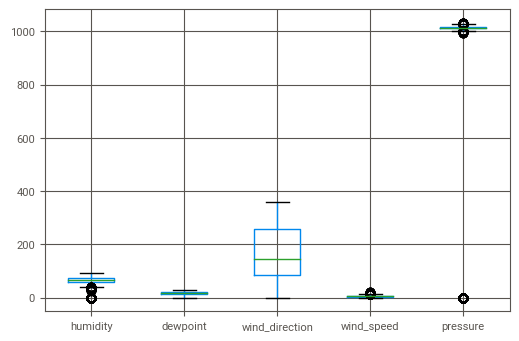

In [38]:
boxplot = ff_phyto1.boxplot(column=[ 
 'humidity',
 'dewpoint',
 'wind_direction',
 'wind_speed',
 'pressure',
 ])

In [39]:
ff_phyto2['d_stamp'] = pd.to_numeric(ff_phyto1['d_stamp'], errors='coerce')
ff_phyto2['T_round1'] = pd.to_numeric(ff_phyto1['T_round1'], errors='coerce')
ff_phyto2.dtypes

d_stamp                      float64
T_round1                     float64
chlorophyll_concentration    float64
turbidity_units              float64
temperature                  float64
                              ...   
depth_71                     float64
depth_119                    float64
depth_9                      float64
depth_79                     float64
chl_pred                     float64
Length: 114, dtype: object

## Plot variables against index

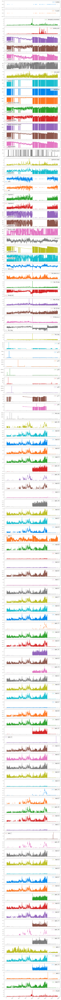

In [41]:
##plot representation of features to index
ff_phyto2.plot(subplots=True, figsize=(10, 200)); plt.legend(loc='best')


In [42]:
import missingno as msno

In [43]:
##creation of smaller df with half of the features  
df1= ff_phyto2.iloc[:, 2:39]
df1

,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,wind_speed,pressure,BAROMETER,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgVolt,AvgLinearAdjVal,dominant_period,significant_height,mean_period,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,Direction_DegM,East_cm_s,Temperature_DegC,Heading_DegM,North_cm_s,Abs_Speed_cm_s,Abs_Tilt_Deg,Strength_dB,Max_Tilt_Deg,Std_Tilt_Deg,SP_Std_cm_s,Tilt_Y_Deg,Tilt_X_Deg
0,0.071,0.177,28.1,86.1,25.5,158.000,1.31,1004.9,1004.77,2396.0,0.851,85.104,2290.2,0.592,29.219,3.774,0.350,3.569,1.003,-1.398,1.721,2.459,312.268,305.642,354.116,-3.813,29.656,268.558,36.999,37.195,3.019,-23.242,6.658,1.341,15.587,2.111,-1.209
1,0.095,0.189,28.1,86.1,25.6,181.000,1.62,1005.0,1004.85,2395.4,0.849,84.860,2285.6,0.580,27.998,4.878,0.368,3.535,0.847,-1.376,1.616,2.176,300.039,301.608,359.196,-0.561,29.710,271.677,39.985,39.989,2.911,-23.277,5.848,1.299,14.462,1.981,-1.251
2,0.083,0.183,28.1,86.4,25.7,156.000,1.50,1005.0,1004.86,2395.6,0.849,84.860,2289.4,0.590,28.974,5.000,0.383,3.632,1.146,-1.358,1.777,2.635,319.648,310.163,357.789,-1.452,29.775,275.965,37.602,37.630,3.168,-23.103,5.827,1.266,13.411,2.221,-1.250
3,0.095,0.189,28.1,84.6,25.2,188.000,1.26,1005.2,1005.10,2396.8,0.851,85.104,2291.6,0.595,29.463,4.444,0.373,3.516,0.766,-1.555,1.733,2.225,296.202,296.223,358.542,-1.052,29.807,277.912,41.330,41.344,3.110,-22.739,7.250,1.349,12.593,2.145,-1.219
4,0.107,0.201,27.9,85.2,25.2,150.000,1.68,1005.3,1005.15,2391.4,0.839,83.883,2291.0,0.595,29.463,5.263,0.344,3.570,0.692,-1.262,1.439,2.008,296.420,298.723,356.702,-2.372,29.849,276.629,41.170,41.238,3.014,-22.449,6.186,1.233,11.526,2.222,-1.224
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19329,0.266,1.232,19.6,63.4,12.5,172.341,1.95,1020.1,1018.26,2305.2,0.629,62.882,2252.4,0.499,19.939,5.405,0.384,4.526,-1.956,0.398,1.996,2.895,198.453,168.506,20.699,3.625,23.768,246.939,9.594,10.256,4.981,-15.638,6.747,0.704,12.779,2.686,-4.143
19330,0.278,1.226,20.0,59.1,11.8,154.939,3.92,1017.4,1018.36,2298.6,0.612,61.172,2258.2,0.514,21.404,5.882,0.422,4.762,-2.007,1.199,2.338,3.192,156.484,149.150,25.277,6.476,23.825,262.817,13.714,15.166,4.943,-14.989,6.208,0.814,15.723,2.951,-3.923
19331,0.254,1.238,19.3,66.0,12.8,176.651,3.36,1013.7,1018.70,2314.4,0.651,65.079,2251.2,0.497,19.695,6.250,0.391,4.785,-4.289,0.336,4.302,5.225,173.876,175.521,40.936,4.597,23.819,227.567,5.300,7.016,5.191,-15.284,6.011,0.600,12.773,2.766,-4.352
19332,0.278,1.238,19.2,58.5,10.9,71.958,1.72,1013.3,1018.77,2282.2,0.573,57.265,2259.8,0.516,21.648,6.250,0.393,4.717,0.725,1.581,1.739,2.258,62.158,65.385,22.694,7.792,23.813,269.886,18.632,20.196,4.745,-15.476,6.463,0.787,13.472,2.711,-3.840


In [44]:
##creation of smaller df with half of the features 
df2=ff_phyto2.iloc[:, 40:127]
df2

,g_14,g_23,g_50,g_59,g_68,g_77,g_86,temp_avg,depth_103,depth_85,depth_39,depth_69,depth_73,depth_127,depth_105,depth_95,depth_15,depth_129,depth_45,depth_51,depth_99,depth_3,depth_89,depth_21,depth_23,depth_81,depth_11,depth_41,depth_77,depth_35,depth_65,depth_111,depth_49,depth_91,depth_131,depth_53,depth_115,depth_31,depth_59,depth_61,depth_27,depth_83,depth_57,depth_121,depth_13,depth_75,depth_47,depth_43,depth_29,depth_19,depth_113,depth_97,depth_101,depth_93,depth_17,depth_7,depth_107,depth_37,depth_33,depth_25,depth_67,depth_63,depth_125,depth_55,depth_87,depth_117,depth_109,depth_123,depth_5,depth_71,depth_119,depth_9,depth_79,chl_pred
0,28.57,27.62,22.81,21.58,21.15,20.38,NaN,24.572,0.09,0.03,0.40,0.02,0.05,NaN,NaN,NaN,0.40,NaN,0.31,0.15,0.05,1.00,0.02,0.45,0.46,0.04,0.27,0.35,0.04,0.36,0.07,NaN,0.25,0.04,NaN,0.10,NaN,0.41,0.14,0.09,0.41,0.08,0.12,NaN,0.36,0.04,0.28,0.34,0.44,0.47,NaN,NaN,0.07,0.05,0.45,0.11,NaN,0.35,0.39,0.42,0.04,0.04,NaN,0.09,0.08,NaN,NaN,NaN,0.09,0.07,NaN,0.16,0.05,0.036
1,28.77,27.47,22.85,21.65,21.13,20.22,NaN,24.580,0.02,0.08,0.36,0.09,0.05,NaN,NaN,NaN,0.42,NaN,0.34,0.16,NaN,1.12,0.09,0.46,0.44,0.02,0.24,0.32,0.03,0.36,0.02,NaN,0.20,0.06,NaN,0.17,NaN,0.43,0.11,0.11,0.44,0.08,0.12,NaN,0.33,0.05,0.24,0.31,0.43,0.46,NaN,NaN,0.02,0.10,0.47,0.09,NaN,0.36,0.39,0.41,0.04,0.08,NaN,0.18,0.07,NaN,NaN,NaN,0.09,0.01,NaN,0.20,0.05,0.083
2,29.00,27.37,23.40,21.70,21.17,20.15,NaN,24.675,0.20,0.15,0.34,0.01,0.04,NaN,NaN,0.04,0.43,NaN,0.28,0.22,NaN,1.15,0.07,0.46,0.40,0.05,0.24,0.36,0.05,0.37,0.04,NaN,0.28,0.12,NaN,0.15,NaN,0.41,0.11,0.09,0.39,0.07,0.07,NaN,0.38,0.02,0.26,0.30,0.40,0.38,NaN,NaN,0.05,0.10,0.41,0.10,NaN,0.37,0.39,0.43,0.05,0.05,NaN,0.15,0.15,NaN,NaN,NaN,0.12,0.03,NaN,0.23,0.08,0.060
3,29.15,27.35,23.37,21.62,21.17,20.07,NaN,24.680,0.10,0.09,0.33,0.07,0.01,NaN,NaN,NaN,0.36,NaN,0.27,0.24,0.05,1.23,0.10,0.43,0.39,0.09,0.19,0.29,0.04,0.39,0.10,NaN,0.28,0.00,NaN,0.17,NaN,0.42,0.12,0.11,0.40,0.08,0.13,NaN,0.28,0.02,0.23,0.33,0.41,0.45,NaN,NaN,0.02,0.07,0.47,0.16,NaN,0.38,0.35,0.38,0.07,0.04,NaN,0.15,0.06,NaN,NaN,NaN,0.07,0.07,NaN,0.10,0.05,0.083
4,29.47,26.99,23.31,21.77,21.21,20.14,NaN,24.701,0.05,0.09,0.36,0.05,0.03,NaN,NaN,NaN,0.43,NaN,0.30,0.20,0.07,1.31,0.07,0.42,0.39,0.11,0.25,0.32,0.06,0.38,0.08,NaN,0.23,0.03,NaN,0.18,NaN,0.37,0.11,0.10,0.42,0.07,0.14,NaN,0.31,0.04,0.25,0.29,0.37,0.48,NaN,NaN,0.04,0.09,0.46,0.14,NaN,0.38,0.34,0.38,0.02,0.07,NaN,0.18,0.04,NaN,NaN,NaN,0.11,0.03,NaN,0.13,0.09,0.048
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19329,23.94,23.91,23.90,23.92,23.30,NaN,NaN,23.833,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.63,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.21,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.13,NaN,NaN,NaN,NaN,0.351
19330,23.98,23.93,23.90,23.89,23.79,NaN,NaN,23.917,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.49,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.19,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.10,NaN,NaN,NaN,NaN,0.315
19331,24.03,23.94,23.89,23.88,23.46,NaN,NaN,23.880,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.30,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.16,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.11,NaN,NaN,0.17,NaN,0.339
19332,24.05,23.93,23.91,23.89,23.44,NaN,NaN,23.887,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.21,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.13,NaN,NaN,NaN,NaN,NaN,NaN,

<AxesSubplot:>

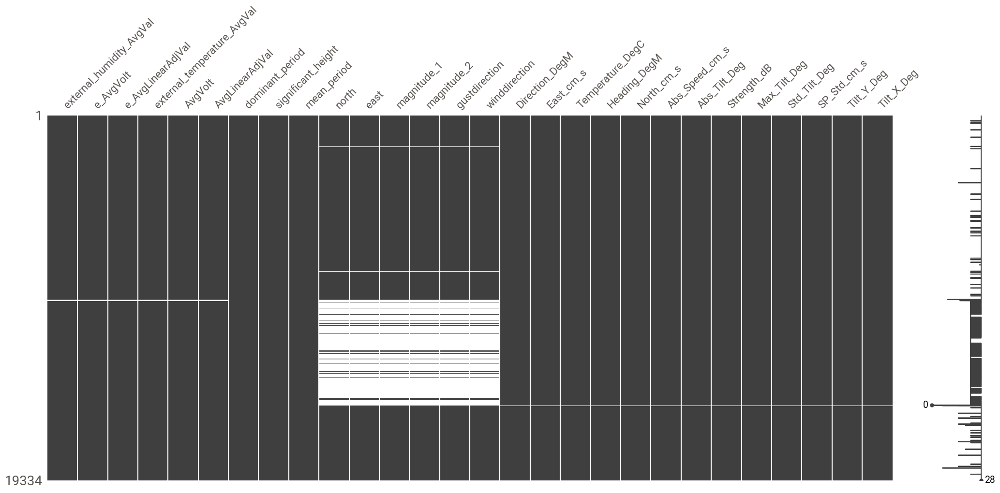

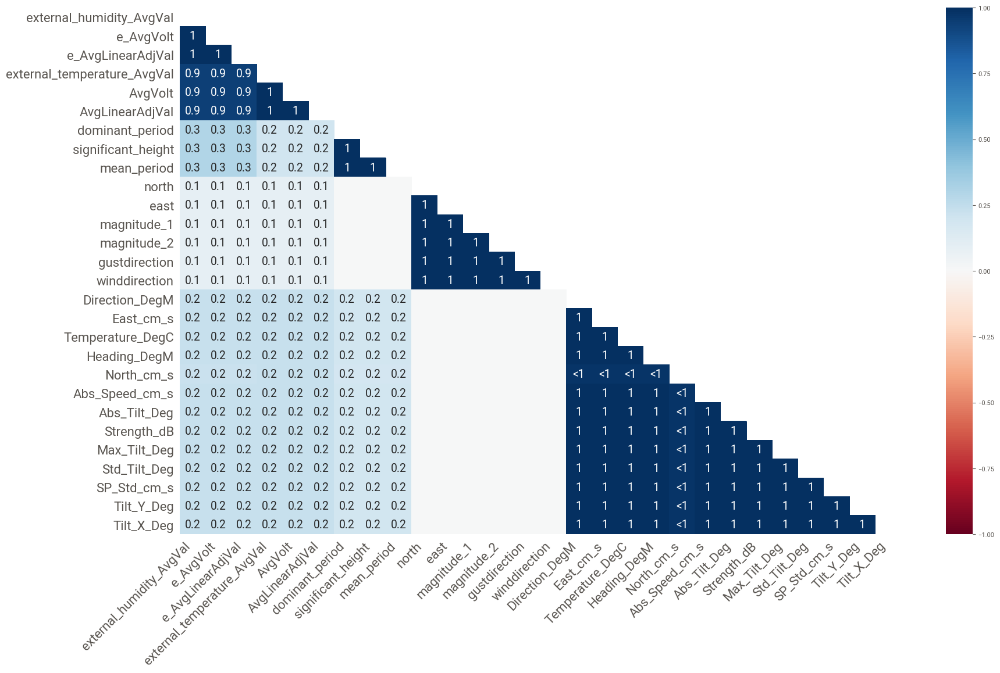

In [45]:
missingdata_df = df1.columns[df1.isnull().any()].tolist()
msno.matrix(df1[missingdata_df])
msno.heatmap(df1)

<AxesSubplot:>

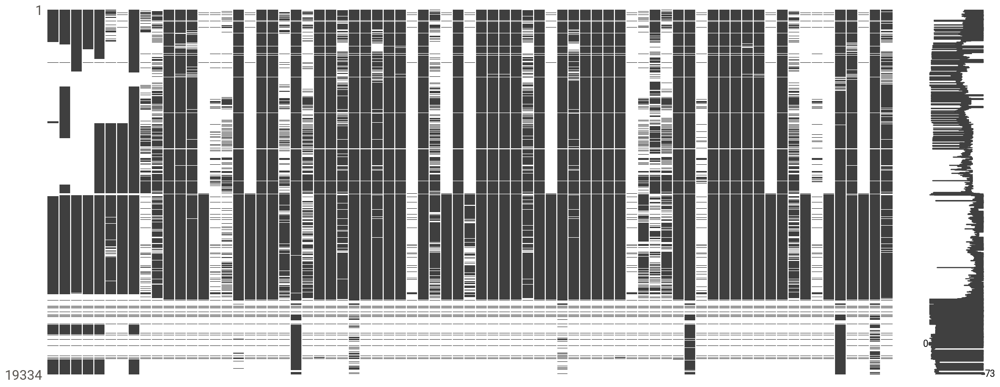

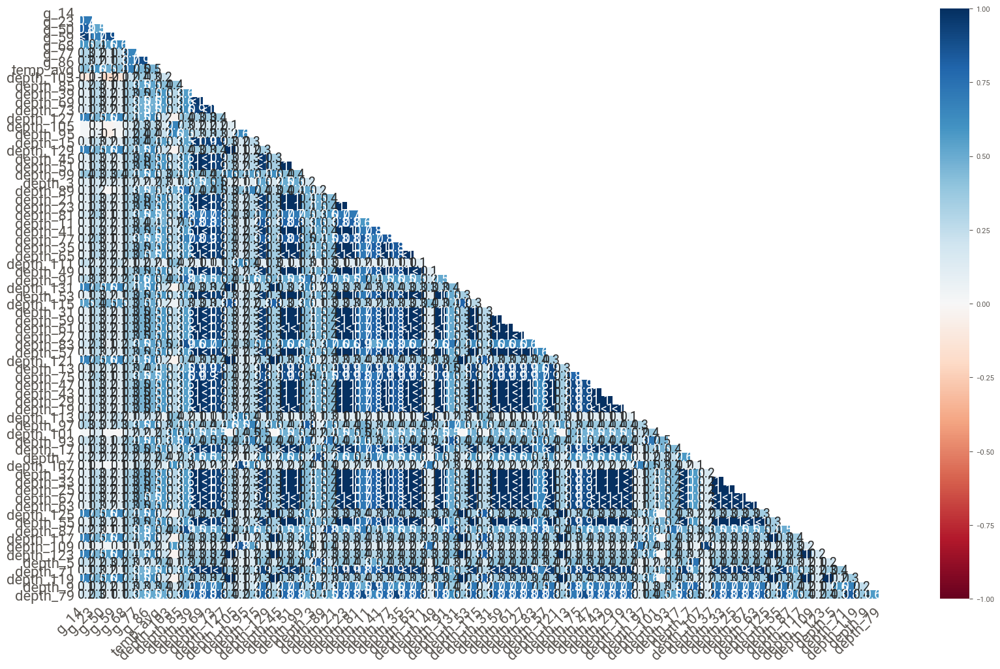

In [46]:
missingdata_df = df2.columns[df2.isnull().any()].tolist()
msno.matrix(df2[missingdata_df])
msno.heatmap(df2)

In [47]:
##pip install pingouin


In [48]:
my_list = list(ff_phyto2 )
my_list

['d_stamp',
 'T_round1',
 'chlorophyll_concentration',
 'turbidity_units',
 'temperature',
 'humidity',
 'dewpoint',
 'wind_direction',
 'wind_speed',
 'pressure',
 'BAROMETER',
 'external_humidity_AvgVal',
 'e_AvgVolt',
 'e_AvgLinearAdjVal',
 'external_temperature_AvgVal',
 'AvgVolt',
 'AvgLinearAdjVal',
 'dominant_period',
 'significant_height',
 'mean_period',
 'north',
 'east',
 'magnitude_1',
 'magnitude_2',
 'gustdirection',
 'winddirection',
 'Direction_DegM',
 'East_cm_s',
 'Temperature_DegC',
 'Heading_DegM',
 'North_cm_s',
 'Abs_Speed_cm_s',
 'Abs_Tilt_Deg',
 'Strength_dB',
 'Max_Tilt_Deg',
 'Std_Tilt_Deg',
 'SP_Std_cm_s',
 'Tilt_Y_Deg',
 'Tilt_X_Deg',
 'g_5',
 'g_14',
 'g_23',
 'g_50',
 'g_59',
 'g_68',
 'g_77',
 'g_86',
 'temp_avg',
 'depth_103',
 'depth_85',
 'depth_39',
 'depth_69',
 'depth_73',
 'depth_127',
 'depth_105',
 'depth_95',
 'depth_15',
 'depth_129',
 'depth_45',
 'depth_51',
 'depth_99',
 'depth_3',
 'depth_89',
 'depth_21',
 'depth_23',
 'depth_81',
 'depth_

In [49]:
import scipy.integrate as integrate
import scipy

In [50]:
##fig, ax = plt.subplots(figsize=(16,8))
ax.scatter(ff_phyto2['dewpoint'], ff_phyto2['chl_pred'])
ax.scatter(ff_phyto2['temperature'], ff_phyto2['chl_pred'])
ax.set_xlabel('dewpoint')
ax.set_ylabel('chl_pred')
plt.show()

NameError: name 'ax' is not defined

C:\Users\dalit\anaconda3\lib\site-packages\seaborn\axisgrid.py:1969: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


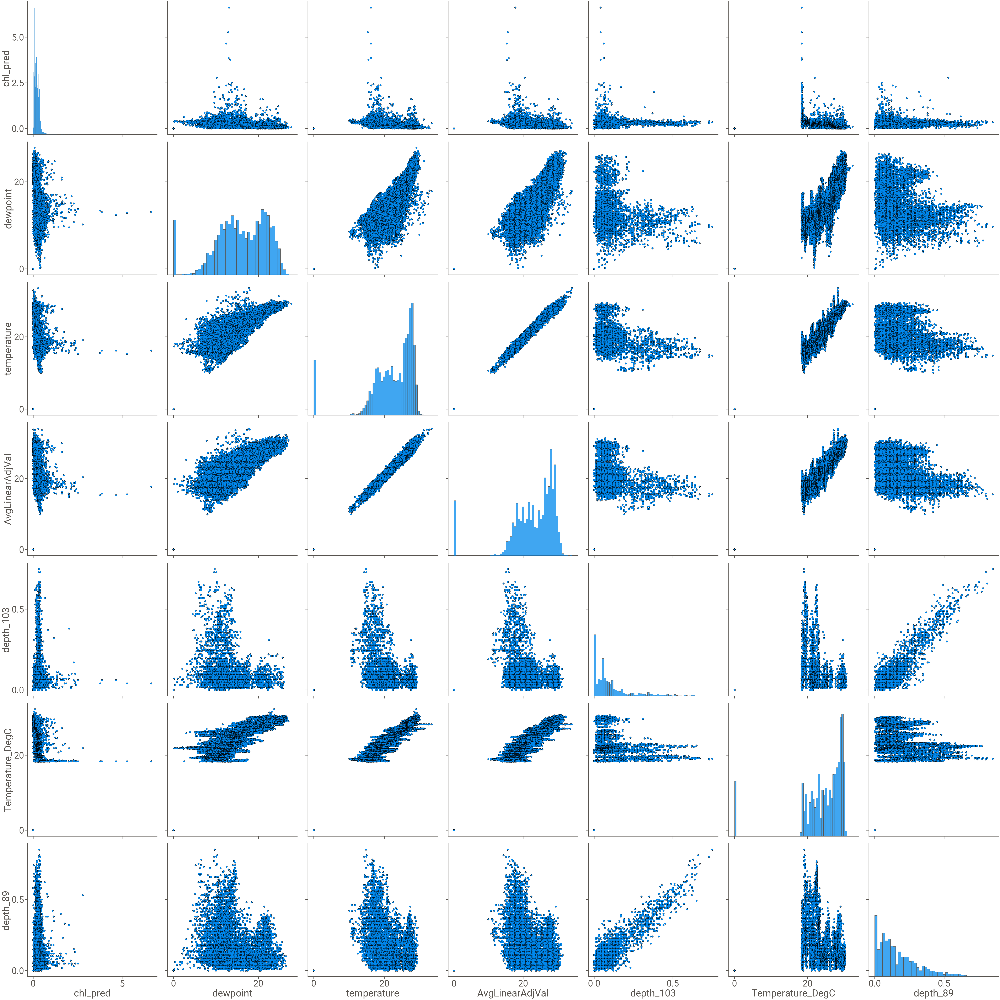

In [52]:
##pairplot of the top negative correlated parameters
sns.pairplot(ff_phyto2, 
             vars = ['chl_pred','dewpoint',
'temperature',
'AvgLinearAdjVal',
'depth_103',
'Temperature_DegC',
'depth_89',
],
            
             plot_kws = {'alpha': 1, 's': 80, 'edgecolor': 'k'},
             height=1.5, size = 10);
sns.set_context("poster", font_scale = 4, rc={"grid.linewidth": 0.6})

In [ ]:
##pairplot of the top positive correlated parameters
sns.pairplot(ff_phyto2, 
             vars = ['chl_pred',
'depth_111',
'depth_113',
'g_77',
'g_86',
'chlorophyll_concentration',

],
            
             plot_kws = {'alpha': 1, 's': 80, 'edgecolor': 'k'},
             height=1.5, size = 10);
sns.set_context("poster", font_scale = 4, rc={"grid.linewidth": 0.6})

In [ ]:
##pairplot of the top positive correlated parameters
sns.pairplot(ff_phyto2, 
             vars = ['chl_pred','BAROMETER',
'pressure',
'magnitude_2',
'magnitude_1',

],
            
             plot_kws = {'alpha': 1, 's': 80, 'edgecolor': 'k'},
             height=1.5, size = 8);
sns.set_context("poster", font_scale = 4, rc={"grid.linewidth": 0.6})

In [53]:
##correlation between all variables in the DataFrame
corr=ff_phyto2.corr(method='spearman').sort_values(ascending=True,by='chl_pred')
corr.tail(100)

,d_stamp,T_round1,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,wind_speed,pressure,BAROMETER,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgVolt,AvgLinearAdjVal,dominant_period,significant_height,mean_period,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,Direction_DegM,East_cm_s,Temperature_DegC,Heading_DegM,North_cm_s,Abs_Speed_cm_s,Abs_Tilt_Deg,Strength_dB,Max_Tilt_Deg,Std_Tilt_Deg,SP_Std_cm_s,Tilt_Y_Deg,Tilt_X_Deg,g_5,g_14,g_23,g_50,g_59,g_68,g_77,g_86,temp_avg,depth_103,depth_85,...,depth_23,depth_81,depth_11,depth_41,depth_77,depth_35,depth_65,depth_111,depth_49,depth_91,depth_131,depth_53,depth_115,depth_31,depth_59,depth_61,depth_27,depth_83,depth_57,depth_121,depth_13,depth_75,depth_47,depth_43,depth_29,depth_19,depth_113,depth_97,depth_101,depth_93,depth_17,depth_7,depth_107,depth_37,depth_33,depth_25,depth_67,depth_63,depth_125,depth_55,depth_87,depth_117,depth_109,depth_123,depth_5,depth_71,depth_119,depth_9,depth_79,chl_pred
gustdirection,NaN,NaN,-0.101798,0.092288,0.475204,0.203346,0.443260,0.416199,0.075404,-0.098073,-0.104600,0.194518,0.194522,0.194522,0.473909,0.473750,0.473750,0.269823,0.254021,0.307600,0.298478,-0.625202,0.070898,0.087584,1.000000,0.924870,0.067821,0.169723,0.497224,0.424350,0.090323,0.231037,0.081815,-0.187709,0.078669,0.085863,0.153653,0.140355,-0.059866,0.553178,0.707269,0.570541,0.339640,0.351344,0.253878,0.405924,0.433985,0.477065,0.494415,0.303879,...,0.293359,0.241906,0.239682,0.275744,0.198927,0.278461,0.211827,0.999844,0.285902,0.320051,0.999872,0.269235,0.999825,0.279994,0.227140,0.216075,0.283605,0.263535,0.246815,0.999822,0.232406,0.186583,0.284868,0.281807,0.285287,0.287139,0.972511,0.634166,0.223214,0.401290,0.273302,0.241495,0.854460,0.281660,0.276233,0.291334,0.200511,0.208640,0.972873,0.259449,0.342125,0.999843,0.888448,0.999817,0.236307,0.196525,0.999780,0.243997,0.210007,-0.106097
external_humidity_AvgVal,NaN,NaN,-0.074806,0.127829,0.279367,0.979697,0.604737,0.104095,0.105583,-0.173140,-0.163316,1.000000,0.999975,0.999975,0.262380,0.262079,0.262079,0.215504,0.163715,0.194336,0.060496,-0.053388,0.161231,0.134790,0.194518,0.199929,0.090710,0.064556,0.304776,0.088986,0.053121,0.190578,0.150118,-0.155253,0.091229,0.091923,0.048173,0.134404,-0.143344,0.406211,0.424263,0.349981,0.199297,0.228276,0.069951,0.078563,0.139448,0.199075,0.465456,0.217376,...,0.223051,0.168914,0.157974,0.176378,0.149777,0.197341,0.157085,0.988436,0.164900,0.234319,0.341428,0.169995,0.462187,0.202912,0.158794,0.161349,0.217500,0.193156,0.166473,0.349130,0.200208,0.145644,0.162895,0.169133,0.211854,0.219281,0.986123,0.352669,0.222668,0.272892,0.221515,0.085523,0.835306,0.189474,0.197489,0.220291,0.154067,0.161581,0.325492,0.172183,0.248300,0.366208,0.871567,0.366348,0.072203,0.134620,0.374614,0.098165,0.158585,-0.086411
e_AvgVolt,NaN,NaN,-0.074789,0.127901,0.279375,0.979690,0.604740,0.104116,0.105532,-0.173151,-0.163332,0.999975,1.000000,1.000000,0.262406,0.262105,0.262105,0.215523,0.163730,0.194375,0.060377,-0.053395,0.161220,0.134787,0.194522,0.199907,0.090682,0.064597,0.304796,0.089071,0.053158,0.190586,0.150124,-0.155305,0.091207,0.091896,0.048098,0.134425,-0.143358,0.406218,0.424241,0.349966,0.199272,0.228331,0.069960,0.078532,0.139422,0.199079,0.465396,0.217360,...,0.223056,0.168895,0.157970,0.176377,0.149757,0.197359,0.157076,0.988440,0.164896,0.234278,0.341384,0.170008,0.462231,0.202940,0.158782,0.161348,0.217494,0.193148,0.166495,0.349251,0.200197,0.145598,0.162893,0.169148,0.211884,0.219276,0.986113,0.352582,0.222552,0.272863,0.221514,0.085633,0.835315,0.189494,0.197519,0.220284,0.154066,0.161550,0.325588,0.172208,0.248249,0.366184,0.871543,0.366335,0.072247,0.134588,0.374562,0.098209,0.158538,-0.086403
e_AvgLinearAdjVal,NaN,NaN,-0.074789,0.127901,0.279375,0.979690,0.604740,0.104116,0.105532,-0.173151,-0.163332,0.999975,1.000000,1.000000,0.262406,0.262105,0.262105,0.215523,0.163730,0.194375,0.060377,-0

In [54]:
from scipy import stats
from scipy.stats import spearmanr


In [55]:
corr['chl_pred'] = corr['chl_pred'].astype(float)

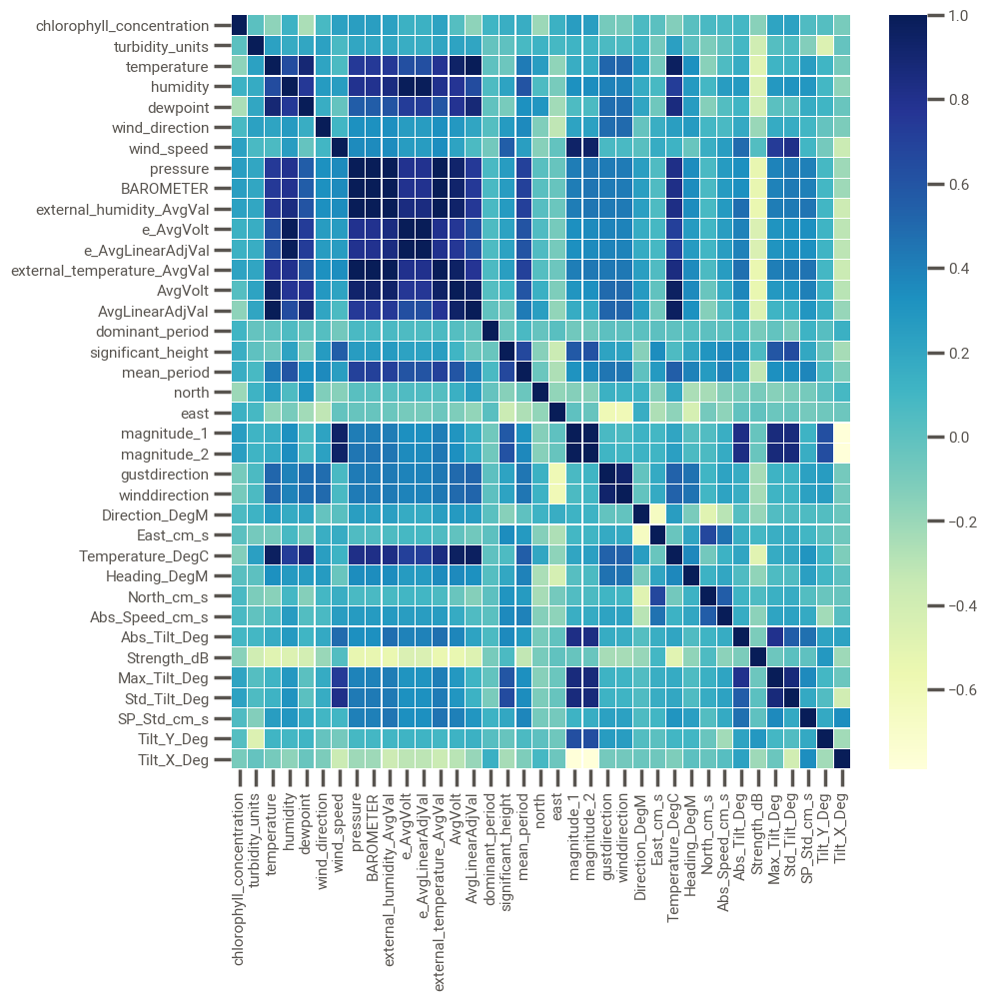

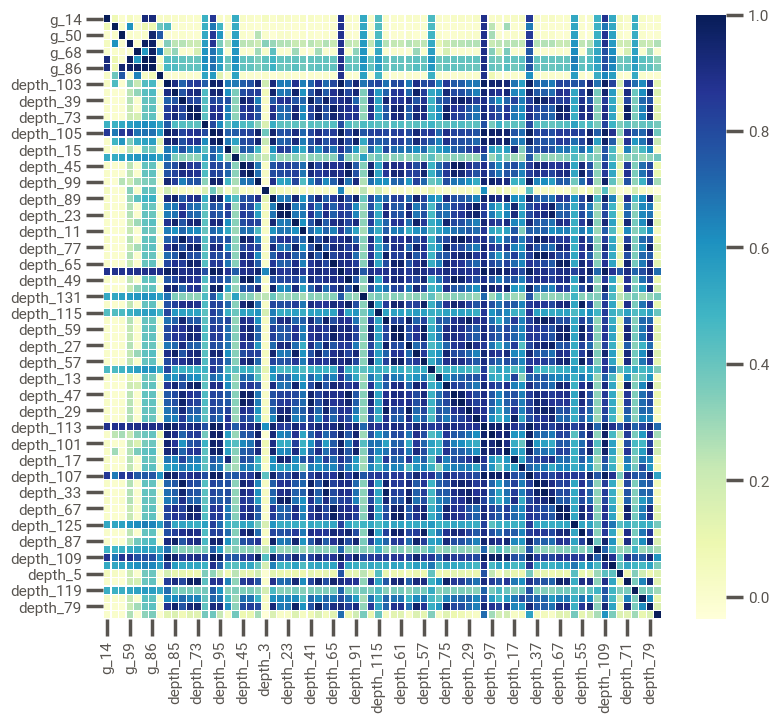

In [60]:
corrmat = df1.corr() 
f, ax = plt.subplots(figsize =(10, 10)) 
sns.heatmap(corrmat, ax = ax, cmap ="YlGnBu", linewidths = 0.1) 

corrmat2 = df2.corr() 
f, ax = plt.subplots(figsize =(9, 8)) 
sns.heatmap(corrmat2, ax = ax, cmap ="YlGnBu", linewidths = 0.1),
          
sns.set_context("poster", font_scale = 0.6, rc={"grid.linewidth": 0.6})


### Conclusions from corrlation between Y to all variables and between variables

After perform corr function on the data frame we got a list of positive correlated variables to Y (cut off >~0.4)- depth_99
depth_105
depth_97
BAROMETER
pressure
depth_107
depth_109
chlorophyll_concentration
depth_111
depth_113

and a list of relativly negative correlated variables to Y (cut off <-0.4)- 
Temperature_DegC
temperature
external_temperature_AvgVal
AvgLinearAdjVal
AvgVolt
dewpoint
g_5
g_23
temp_avg
g_14

from the positive corrlation the variables that are correlated with al the others are depth_111
depth_113, and depth_107
depth_109, and depth_105





# Finding Outliers

In [61]:
##creating new df for outliers detection
outliers= ff_phyto2.copy()

In [62]:
outliers

,d_stamp,T_round1,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,wind_speed,pressure,BAROMETER,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgVolt,AvgLinearAdjVal,dominant_period,significant_height,mean_period,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,Direction_DegM,East_cm_s,Temperature_DegC,Heading_DegM,North_cm_s,Abs_Speed_cm_s,Abs_Tilt_Deg,Strength_dB,Max_Tilt_Deg,Std_Tilt_Deg,SP_Std_cm_s,Tilt_Y_Deg,Tilt_X_Deg,g_5,g_14,g_23,g_50,g_59,g_68,g_77,g_86,temp_avg,depth_103,depth_85,...,depth_23,depth_81,depth_11,depth_41,depth_77,depth_35,depth_65,depth_111,depth_49,depth_91,depth_131,depth_53,depth_115,depth_31,depth_59,depth_61,depth_27,depth_83,depth_57,depth_121,depth_13,depth_75,depth_47,depth_43,depth_29,depth_19,depth_113,depth_97,depth_101,depth_93,depth_17,depth_7,depth_107,depth_37,depth_33,depth_25,depth_67,depth_63,depth_125,depth_55,depth_87,depth_117,depth_109,depth_123,depth_5,depth_71,depth_119,depth_9,depth_79,chl_pred
0,NaN,NaN,0.071,0.177,28.1,86.1,25.5,158.000,1.31,1004.9,1004.77,2396.0,0.851,85.104,2290.2,0.592,29.219,3.774,0.350,3.569,1.003,-1.398,1.721,2.459,312.268,305.642,354.116,-3.813,29.656,268.558,36.999,37.195,3.019,-23.242,6.658,1.341,15.587,2.111,-1.209,29.66,28.57,27.62,22.81,21.58,21.15,20.38,NaN,24.572,0.09,0.03,...,0.46,0.04,0.27,0.35,0.04,0.36,0.07,NaN,0.25,0.04,NaN,0.10,NaN,0.41,0.14,0.09,0.41,0.08,0.12,NaN,0.36,0.04,0.28,0.34,0.44,0.47,NaN,NaN,0.07,0.05,0.45,0.11,NaN,0.35,0.39,0.42,0.04,0.04,NaN,0.09,0.08,NaN,NaN,NaN,0.09,0.07,NaN,0.16,0.05,0.036
1,NaN,NaN,0.095,0.189,28.1,86.1,25.6,181.000,1.62,1005.0,1004.85,2395.4,0.849,84.860,2285.6,0.580,27.998,4.878,0.368,3.535,0.847,-1.376,1.616,2.176,300.039,301.608,359.196,-0.561,29.710,271.677,39.985,39.989,2.911,-23.277,5.848,1.299,14.462,1.981,-1.251,29.71,28.77,27.47,22.85,21.65,21.13,20.22,NaN,24.580,0.02,0.08,...,0.44,0.02,0.24,0.32,0.03,0.36,0.02,NaN,0.20,0.06,NaN,0.17,NaN,0.43,0.11,0.11,0.44,0.08,0.12,NaN,0.33,0.05,0.24,0.31,0.43,0.46,NaN,NaN,0.02,0.10,0.47,0.09,NaN,0.36,0.39,0.41,0.04,0.08,NaN,0.18,0.07,NaN,NaN,NaN,0.09,0.01,NaN,0.20,0.05,0.083
2,NaN,NaN,0.083,0.183,28.1,86.4,25.7,156.000,1.50,1005.0,1004.86,2395.6,0.849,84.860,2289.4,0.590,28.974,5.000,0.383,3.632,1.146,-1.358,1.777,2.635,319.648,310.163,357.789,-1.452,29.775,275.965,37.602,37.630,3.168,-23.103,5.827,1.266,13.411,2.221,-1.250,29.77,29.00,27.37,23.40,21.70,21.17,20.15,NaN,24.675,0.20,0.15,...,0.40,0.05,0.24,0.36,0.05,0.37,0.04,NaN,0.28,0.12,NaN,0.15,NaN,0.41,0.11,0.09,0.39,0.07,0.07,NaN,0.38,0.02,0.26,0.30,0.40,0.38,NaN,NaN,0.05,0.10,0.41,0.10,NaN,0.37,0.39,0.43,0.05,0.05,NaN,0.15,0.15,NaN,NaN,NaN,0.12,0.03,NaN,0.23,0.08,0.060
3,NaN,NaN,0.095,0.189,28.1,84.6,25.2,188.000,1.26,1005.2,1005.10,2396.8,0.851,85.104,2291.6,0.595,29.463,4.444,0.373,3.516,0.766,-1.555,1.733,2.225,296.202,296.223,358.542,-1.052,29.807,277.912,41.330,41.344,3.110,-22.739,7.250,1.349,12.593,2.145,-1.219,29.80,29.15,27.35,23.37,21.62,21.17,20.07,NaN,24.680,0.10,0.09,...,0.39,0.09,0.19,0.29,0.04,0.39,0.10,NaN,0.28,0.00,NaN,0.17,NaN,0.42,0.12,0.11,0.40,0.08,0.13,NaN,0.28,0.02,0.23,0.33,0.41,0.45,NaN,NaN,0.02,0.07,0.47,0.16,NaN,0.38,0.35,0.38,0.07,0.04,NaN,0.15,0.06,NaN,NaN,NaN,0.07,0.07,NaN,0.10,0.05,0.083
4,NaN,NaN,0.107,0.201,27.9,85.2,25.2,150.000,1.68,1005.3,1005.15,2391.4,0.839,83.883,2291.0,0.595,29.463,5.263,0.344,3.570,0.692,-1.262,1.439,2.008,296.420,298.723,356.702,-2.372,29.849,276.629,41.170,41.238,3.014,-22.449,6.186,1.233,11.526,2.222,-1.224,29.85,29.47,26.99,23.31,21.77,21.21,20.14,NaN,24.701,0.05,0.09,...,0.39,0.11,0.25,0.32,0.06,0.38,0.08,NaN,0.23,0.03,NaN,0.18,NaN,0.37,0.11,0.10,0.42,0.07,0.14,NaN,0.31,0.04,0.25,0.29,0.37,0.48,NaN,NaN,0.04,0.09,0.46,0.14,NaN,0.38,0.34,0.38,0.02,0.07,NaN,0.18,0.04,NaN,NaN,NaN,0.11,0.03,NaN,0.13,0.09,0.048
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

In [63]:
# Drop the columns 
outliers_y  = outliers.drop(['T_round1','d_stamp'], axis = 1)

In [64]:
##creating a loop for defining outliers and transform it to o,1
for i in outliers_y.columns:
    Q1=outliers_y[i].quantile(0.25)
    Q3=outliers_y[i].quantile(0.75)
    IQR = Q3 - Q1
    low=Q1-1.5* IQR
    high=Q3+1.5* IQR
    outliers_y[i]=np.where((outliers_y[i]>high)|(outliers_y[i]<low),0,1)

In [65]:
##check if df has been changed properly
outliers_y.describe(include='all')

,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,wind_speed,pressure,BAROMETER,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgVolt,AvgLinearAdjVal,dominant_period,significant_height,mean_period,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,Direction_DegM,East_cm_s,Temperature_DegC,Heading_DegM,North_cm_s,Abs_Speed_cm_s,Abs_Tilt_Deg,Strength_dB,Max_Tilt_Deg,Std_Tilt_Deg,SP_Std_cm_s,Tilt_Y_Deg,Tilt_X_Deg,g_5,g_14,g_23,g_50,g_59,g_68,g_77,g_86,temp_avg,depth_103,depth_85,depth_39,depth_69,...,depth_23,depth_81,depth_11,depth_41,depth_77,depth_35,depth_65,depth_111,depth_49,depth_91,depth_131,depth_53,depth_115,depth_31,depth_59,depth_61,depth_27,depth_83,depth_57,depth_121,depth_13,depth_75,depth_47,depth_43,depth_29,depth_19,depth_113,depth_97,depth_101,depth_93,depth_17,depth_7,depth_107,depth_37,depth_33,depth_25,depth_67,depth_63,depth_125,depth_55,depth_87,depth_117,depth_109,depth_123,depth_5,depth_71,depth_119,depth_9,depth_79,chl_pred
count,19334.000000,19334.000000,19334.000000,19334.000000,19334.0,19334.0,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.00000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.0,19334.0,19334.0,19334.000000,19334.000000,19334.0,19334.000000,19334.000000,19334.00000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,...,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000
mean,0.984121,0.996431,0.957588,0.949364,1.0,1.0,0.978949,0.948743,0.951536,0.948743,0.949364,0.948847,0.957588,0.957588,0.957588,0.981639,0.91621,0.946209,0.990173,0.988362,0.982052,0.977759,1.0,1.0,1.0,0.975846,0.957588,1.0,0.979570,0.970932,0.98919,0.996173,0.972432,0.990483,0.895676,0.999276,0.988621,0.956295,0.957277,0.957381,0.956553,0.949002,0.953036,0.955829,0.956657,0.955622,0.974811,0.979363,0.974759,0.965346,...,0.976673,0.974449,0.954846,0.976673,0.970829,0.977811,0.966018,0.992345,0.966587,0.969691,0.996793,0.966639,0.992086,0.977087,0.964674,0.964777,0.977915,0.976777,0.959605,0.993690,0.956450,0.970415,0.971863,0.976156,0.977346,0.972794,0.993690,0.975328,0.956967,0.973363,0.966174,0.966794,0.996741,0.978897,0.977449,0.975122,0.965191,0.965656,0.999121,0.958312,0.983242,0.991259,0.996121,0.998397,0.959967,0.966122,0.996224,0.967984,0.972277,0.984432
std,0.125010,0.059635,0.201533,0.219259,0.0,0.0,0.143558,0.220527,0.214750,0.220527,0.219259,0.220316,0.201533,0.201533,0.201533,0.134258,0.27708,0.225611,0.098647,0.107251,0.132765,0.147469,0.0,0.0,0.0,0.153532,0.201533,0.0,0.141471,0.168001,0.10341,0.061750,0.163736,0.097092,0.305688,0.026900,0.106066,0.204444,0.202236,0.202002,0.203866,0.220000,0.211567,0.205480,0.203634,0.205938,0.156702,0.142170,0.156859,0.182907,...,0.150943,0.157795,0.207646,0.150943,0.168291,0.147301,0.181186,0.087159,0.179716,0.171441,0.056539,0.179582,0.088608,0.149630,0.184608,0.184348,0.146965,0.150616,0.196889,0.079187,0.204097,0.169444,0.165368,0.152567,0.148803,0.162687,0.079187,0.155126,0.202937,0.161024,0.180787,0.179178,0.056992,0.143731,0.148471,0.155759,0.183301,0.182115,0.029640,0.199881,0.128367,0.0

In [66]:
##copy the df.
outliers_rm=outliers_y.copy()
outliers_rm.describe(include='all')

,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,wind_speed,pressure,BAROMETER,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgVolt,AvgLinearAdjVal,dominant_period,significant_height,mean_period,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,Direction_DegM,East_cm_s,Temperature_DegC,Heading_DegM,North_cm_s,Abs_Speed_cm_s,Abs_Tilt_Deg,Strength_dB,Max_Tilt_Deg,Std_Tilt_Deg,SP_Std_cm_s,Tilt_Y_Deg,Tilt_X_Deg,g_5,g_14,g_23,g_50,g_59,g_68,g_77,g_86,temp_avg,depth_103,depth_85,depth_39,depth_69,...,depth_23,depth_81,depth_11,depth_41,depth_77,depth_35,depth_65,depth_111,depth_49,depth_91,depth_131,depth_53,depth_115,depth_31,depth_59,depth_61,depth_27,depth_83,depth_57,depth_121,depth_13,depth_75,depth_47,depth_43,depth_29,depth_19,depth_113,depth_97,depth_101,depth_93,depth_17,depth_7,depth_107,depth_37,depth_33,depth_25,depth_67,depth_63,depth_125,depth_55,depth_87,depth_117,depth_109,depth_123,depth_5,depth_71,depth_119,depth_9,depth_79,chl_pred
count,19334.000000,19334.000000,19334.000000,19334.000000,19334.0,19334.0,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.00000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.0,19334.0,19334.0,19334.000000,19334.000000,19334.0,19334.000000,19334.000000,19334.00000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,...,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000
mean,0.984121,0.996431,0.957588,0.949364,1.0,1.0,0.978949,0.948743,0.951536,0.948743,0.949364,0.948847,0.957588,0.957588,0.957588,0.981639,0.91621,0.946209,0.990173,0.988362,0.982052,0.977759,1.0,1.0,1.0,0.975846,0.957588,1.0,0.979570,0.970932,0.98919,0.996173,0.972432,0.990483,0.895676,0.999276,0.988621,0.956295,0.957277,0.957381,0.956553,0.949002,0.953036,0.955829,0.956657,0.955622,0.974811,0.979363,0.974759,0.965346,...,0.976673,0.974449,0.954846,0.976673,0.970829,0.977811,0.966018,0.992345,0.966587,0.969691,0.996793,0.966639,0.992086,0.977087,0.964674,0.964777,0.977915,0.976777,0.959605,0.993690,0.956450,0.970415,0.971863,0.976156,0.977346,0.972794,0.993690,0.975328,0.956967,0.973363,0.966174,0.966794,0.996741,0.978897,0.977449,0.975122,0.965191,0.965656,0.999121,0.958312,0.983242,0.991259,0.996121,0.998397,0.959967,0.966122,0.996224,0.967984,0.972277,0.984432
std,0.125010,0.059635,0.201533,0.219259,0.0,0.0,0.143558,0.220527,0.214750,0.220527,0.219259,0.220316,0.201533,0.201533,0.201533,0.134258,0.27708,0.225611,0.098647,0.107251,0.132765,0.147469,0.0,0.0,0.0,0.153532,0.201533,0.0,0.141471,0.168001,0.10341,0.061750,0.163736,0.097092,0.305688,0.026900,0.106066,0.204444,0.202236,0.202002,0.203866,0.220000,0.211567,0.205480,0.203634,0.205938,0.156702,0.142170,0.156859,0.182907,...,0.150943,0.157795,0.207646,0.150943,0.168291,0.147301,0.181186,0.087159,0.179716,0.171441,0.056539,0.179582,0.088608,0.149630,0.184608,0.184348,0.146965,0.150616,0.196889,0.079187,0.204097,0.169444,0.165368,0.152567,0.148803,0.162687,0.079187,0.155126,0.202937,0.161024,0.180787,0.179178,0.056992,0.143731,0.148471,0.155759,0.183301,0.182115,0.029640,0.199881,0.128367,0.0

In [69]:
##copy the df and rename 
outliers_rm_na = outliers_rm.copy()

In [70]:
from scipy.stats import ks_2samp
from scipy import stats

In [71]:
##replace all 0 to null
outliers_rm_na = outliers_rm_na.replace(0,np.nan)
outliers_rm_na
outliers_rm_na.describe(include='all')

,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,wind_speed,pressure,BAROMETER,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgVolt,AvgLinearAdjVal,dominant_period,significant_height,mean_period,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,Direction_DegM,East_cm_s,Temperature_DegC,Heading_DegM,North_cm_s,Abs_Speed_cm_s,Abs_Tilt_Deg,Strength_dB,Max_Tilt_Deg,Std_Tilt_Deg,SP_Std_cm_s,Tilt_Y_Deg,Tilt_X_Deg,g_5,g_14,g_23,g_50,g_59,g_68,g_77,g_86,temp_avg,depth_103,depth_85,depth_39,depth_69,...,depth_23,depth_81,depth_11,depth_41,depth_77,depth_35,depth_65,depth_111,depth_49,depth_91,depth_131,depth_53,depth_115,depth_31,depth_59,depth_61,depth_27,depth_83,depth_57,depth_121,depth_13,depth_75,depth_47,depth_43,depth_29,depth_19,depth_113,depth_97,depth_101,depth_93,depth_17,depth_7,depth_107,depth_37,depth_33,depth_25,depth_67,depth_63,depth_125,depth_55,depth_87,depth_117,depth_109,depth_123,depth_5,depth_71,depth_119,depth_9,depth_79,chl_pred
count,19027.0,19265.0,18514.0,18355.0,19334.0,19334.0,18927.0,18343.0,18397.0,18343.0,18355.0,18345.0,18514.0,18514.0,18514.0,18979.0,17714.0,18294.0,19144.0,19109.0,18987.0,18904.0,19334.0,19334.0,19334.0,18867.0,18514.0,19334.0,18939.0,18772.0,19125.0,19260.0,18801.0,19150.0,17317.0,19320.0,19114.0,18489.0,18508.0,18510.0,18494.0,18348.0,18426.0,18480.0,18496.0,18476.0,18847.0,18935.0,18846.0,18664.0,...,18883.0,18840.0,18461.0,18883.0,18770.0,18905.0,18677.0,19186.0,18688.0,18748.0,19272.0,18689.0,19181.0,18891.0,18651.0,18653.0,18907.0,18885.0,18553.0,19212.0,18492.0,18762.0,18790.0,18873.0,18896.0,18808.0,19212.0,18857.0,18502.0,18819.0,18680.0,18692.0,19271.0,18926.0,18898.0,18853.0,18661.0,18670.0,19317.0,18528.0,19010.0,19165.0,19259.0,19303.0,18560.0,18679.0,19261.0,18715.0,18798.0,19033.0
mean,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
std,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
min,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
25%,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
50%,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
75%,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.

<AxesSubplot:xlabel='turbidity_units'>

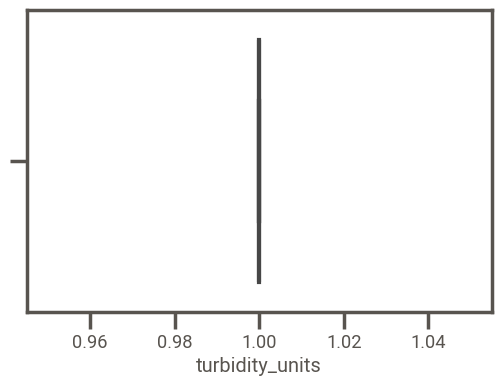

In [72]:
##see if all 0 were removed
sns.boxplot(x=outliers_rm_na['turbidity_units'])

In [73]:
outliers_rm=outliers_rm.astype(float)
outliers_rm.dtypes.head(100)

chlorophyll_concentration      float64
turbidity_units                float64
temperature                    float64
humidity                       float64
dewpoint                       float64
wind_direction                 float64
wind_speed                     float64
pressure                       float64
BAROMETER                      float64
external_humidity_AvgVal       float64
e_AvgVolt                      float64
e_AvgLinearAdjVal              float64
external_temperature_AvgVal    float64
AvgVolt                        float64
AvgLinearAdjVal                float64
dominant_period                float64
significant_height             float64
mean_period                    float64
north                          float64
east                           float64
magnitude_1                    float64
magnitude_2                    float64
gustdirection                  float64
winddirection                  float64
Direction_DegM                 float64
East_cm_s                

In [74]:
##change to float
outliers_rm_na.astype({"dewpoint":float})
#outliers_rm =outliers_rm.astype({"g_14":float})
outliers_rm_na=outliers_rm_na.astype(float)
outliers_rm_na.dtypes.head(100)


chlorophyll_concentration      float64
turbidity_units                float64
temperature                    float64
humidity                       float64
dewpoint                       float64
wind_direction                 float64
wind_speed                     float64
pressure                       float64
BAROMETER                      float64
external_humidity_AvgVal       float64
e_AvgVolt                      float64
e_AvgLinearAdjVal              float64
external_temperature_AvgVal    float64
AvgVolt                        float64
AvgLinearAdjVal                float64
dominant_period                float64
significant_height             float64
mean_period                    float64
north                          float64
east                           float64
magnitude_1                    float64
magnitude_2                    float64
gustdirection                  float64
winddirection                  float64
Direction_DegM                 float64
East_cm_s                

In [75]:
##kolmogorov-smirnov test comparing the two dataset with and without nulls. 
from scipy import stats
ot=[]
for a in outliers_rm.columns:
    for b in outliers_rm_na.columns:
        try:
            dict={}
            test = stats.ks_2samp(outliers_rm[a],outliers_rm_na[b])
            dict['names']=a
            dict['namesb']=b
            dict['stat']=test.statistic
            dict['pval']=test.pvalue
            ot.append(dict)
        except FloatingPointError:
            print('error')
ot=pd.DataFrame(ot)        

error
error
error
error
error
error
error
error
error


In [76]:
ot

,names,namesb,stat,pval
0,chlorophyll_concentration,chlorophyll_concentration,0.015879,1.511027e-02
1,chlorophyll_concentration,turbidity_units,0.015879,1.511027e-02
2,chlorophyll_concentration,temperature,0.042412,1.510448e-15
3,chlorophyll_concentration,humidity,0.050636,5.563715e-22
4,chlorophyll_concentration,dewpoint,0.015879,1.511027e-02
...,...,...,...,...
12530,chl_pred,depth_71,0.033878,4.486482e-10
12531,chl_pred,depth_119,0.015568,1.825212e-02
12532,chl_pred,depth_9,0.032016,4.821149e-09
12533,chl_pred,depth_79,0.027723,6.895945e-07


In [77]:
ot2=pd.DataFrame(ot)
ot2

,names,namesb,stat,pval
0,chlorophyll_concentration,chlorophyll_concentration,0.015879,1.511027e-02
1,chlorophyll_concentration,turbidity_units,0.015879,1.511027e-02
2,chlorophyll_concentration,temperature,0.042412,1.510448e-15
3,chlorophyll_concentration,humidity,0.050636,5.563715e-22
4,chlorophyll_concentration,dewpoint,0.015879,1.511027e-02
...,...,...,...,...
12530,chl_pred,depth_71,0.033878,4.486482e-10
12531,chl_pred,depth_119,0.015568,1.825212e-02
12532,chl_pred,depth_9,0.032016,4.821149e-09
12533,chl_pred,depth_79,0.027723,6.895945e-07


In [78]:
##keep only unique names to look at differences between the same features. the null hypotehsis- there is no difference with and withoun null. 
ot3=ot2.loc[(ot2.names==ot2.namesb)] #& (ot2.pval<0.05)] 
ot3.head(100)

,names,namesb,stat,pval
0,chlorophyll_concentration,chlorophyll_concentration,0.015879,1.511027e-02
113,turbidity_units,turbidity_units,0.003569,9.996520e-01
226,temperature,temperature,0.042412,1.510448e-15
339,humidity,humidity,0.050636,5.563715e-22
452,dewpoint,dewpoint,0.000000,1.000000e+00
564,wind_direction,wind_direction,0.000000,1.000000e+00
676,wind_speed,wind_speed,0.021051,3.747349e-04
789,pressure,pressure,0.051257,1.635174e-22
902,BAROMETER,BAROMETER,0.048464,3.593784e-20
1015,external_humidity_AvgVal,external_humidity_AvgVal,0.051257,1.635174e-22


In [ ]:
#ot3.to_csv("C:/Users/dalit/DataScience/project/final_project/ot3.csv")

### Compare correlations after outliers removal -Fisher z-transformation test
we need to check if the correlations between the variables and the y after removal of the outliers are different from those of non-treated variables. 

In [79]:
##creating new df for outliers detection
outliers_out= ff_phyto2.copy()

In [80]:
##creating new df for outliers detection
outliers= ff_phyto2.copy()

In [81]:
outliers_out

,d_stamp,T_round1,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,wind_speed,pressure,BAROMETER,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgVolt,AvgLinearAdjVal,dominant_period,significant_height,mean_period,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,Direction_DegM,East_cm_s,Temperature_DegC,Heading_DegM,North_cm_s,Abs_Speed_cm_s,Abs_Tilt_Deg,Strength_dB,Max_Tilt_Deg,Std_Tilt_Deg,SP_Std_cm_s,Tilt_Y_Deg,Tilt_X_Deg,g_5,g_14,g_23,g_50,g_59,g_68,g_77,g_86,temp_avg,depth_103,depth_85,...,depth_23,depth_81,depth_11,depth_41,depth_77,depth_35,depth_65,depth_111,depth_49,depth_91,depth_131,depth_53,depth_115,depth_31,depth_59,depth_61,depth_27,depth_83,depth_57,depth_121,depth_13,depth_75,depth_47,depth_43,depth_29,depth_19,depth_113,depth_97,depth_101,depth_93,depth_17,depth_7,depth_107,depth_37,depth_33,depth_25,depth_67,depth_63,depth_125,depth_55,depth_87,depth_117,depth_109,depth_123,depth_5,depth_71,depth_119,depth_9,depth_79,chl_pred
0,NaN,NaN,0.071,0.177,28.1,86.1,25.5,158.000,1.31,1004.9,1004.77,2396.0,0.851,85.104,2290.2,0.592,29.219,3.774,0.350,3.569,1.003,-1.398,1.721,2.459,312.268,305.642,354.116,-3.813,29.656,268.558,36.999,37.195,3.019,-23.242,6.658,1.341,15.587,2.111,-1.209,29.66,28.57,27.62,22.81,21.58,21.15,20.38,NaN,24.572,0.09,0.03,...,0.46,0.04,0.27,0.35,0.04,0.36,0.07,NaN,0.25,0.04,NaN,0.10,NaN,0.41,0.14,0.09,0.41,0.08,0.12,NaN,0.36,0.04,0.28,0.34,0.44,0.47,NaN,NaN,0.07,0.05,0.45,0.11,NaN,0.35,0.39,0.42,0.04,0.04,NaN,0.09,0.08,NaN,NaN,NaN,0.09,0.07,NaN,0.16,0.05,0.036
1,NaN,NaN,0.095,0.189,28.1,86.1,25.6,181.000,1.62,1005.0,1004.85,2395.4,0.849,84.860,2285.6,0.580,27.998,4.878,0.368,3.535,0.847,-1.376,1.616,2.176,300.039,301.608,359.196,-0.561,29.710,271.677,39.985,39.989,2.911,-23.277,5.848,1.299,14.462,1.981,-1.251,29.71,28.77,27.47,22.85,21.65,21.13,20.22,NaN,24.580,0.02,0.08,...,0.44,0.02,0.24,0.32,0.03,0.36,0.02,NaN,0.20,0.06,NaN,0.17,NaN,0.43,0.11,0.11,0.44,0.08,0.12,NaN,0.33,0.05,0.24,0.31,0.43,0.46,NaN,NaN,0.02,0.10,0.47,0.09,NaN,0.36,0.39,0.41,0.04,0.08,NaN,0.18,0.07,NaN,NaN,NaN,0.09,0.01,NaN,0.20,0.05,0.083
2,NaN,NaN,0.083,0.183,28.1,86.4,25.7,156.000,1.50,1005.0,1004.86,2395.6,0.849,84.860,2289.4,0.590,28.974,5.000,0.383,3.632,1.146,-1.358,1.777,2.635,319.648,310.163,357.789,-1.452,29.775,275.965,37.602,37.630,3.168,-23.103,5.827,1.266,13.411,2.221,-1.250,29.77,29.00,27.37,23.40,21.70,21.17,20.15,NaN,24.675,0.20,0.15,...,0.40,0.05,0.24,0.36,0.05,0.37,0.04,NaN,0.28,0.12,NaN,0.15,NaN,0.41,0.11,0.09,0.39,0.07,0.07,NaN,0.38,0.02,0.26,0.30,0.40,0.38,NaN,NaN,0.05,0.10,0.41,0.10,NaN,0.37,0.39,0.43,0.05,0.05,NaN,0.15,0.15,NaN,NaN,NaN,0.12,0.03,NaN,0.23,0.08,0.060
3,NaN,NaN,0.095,0.189,28.1,84.6,25.2,188.000,1.26,1005.2,1005.10,2396.8,0.851,85.104,2291.6,0.595,29.463,4.444,0.373,3.516,0.766,-1.555,1.733,2.225,296.202,296.223,358.542,-1.052,29.807,277.912,41.330,41.344,3.110,-22.739,7.250,1.349,12.593,2.145,-1.219,29.80,29.15,27.35,23.37,21.62,21.17,20.07,NaN,24.680,0.10,0.09,...,0.39,0.09,0.19,0.29,0.04,0.39,0.10,NaN,0.28,0.00,NaN,0.17,NaN,0.42,0.12,0.11,0.40,0.08,0.13,NaN,0.28,0.02,0.23,0.33,0.41,0.45,NaN,NaN,0.02,0.07,0.47,0.16,NaN,0.38,0.35,0.38,0.07,0.04,NaN,0.15,0.06,NaN,NaN,NaN,0.07,0.07,NaN,0.10,0.05,0.083
4,NaN,NaN,0.107,0.201,27.9,85.2,25.2,150.000,1.68,1005.3,1005.15,2391.4,0.839,83.883,2291.0,0.595,29.463,5.263,0.344,3.570,0.692,-1.262,1.439,2.008,296.420,298.723,356.702,-2.372,29.849,276.629,41.170,41.238,3.014,-22.449,6.186,1.233,11.526,2.222,-1.224,29.85,29.47,26.99,23.31,21.77,21.21,20.14,NaN,24.701,0.05,0.09,...,0.39,0.11,0.25,0.32,0.06,0.38,0.08,NaN,0.23,0.03,NaN,0.18,NaN,0.37,0.11,0.10,0.42,0.07,0.14,NaN,0.31,0.04,0.25,0.29,0.37,0.48,NaN,NaN,0.04,0.09,0.46,0.14,NaN,0.38,0.34,0.38,0.02,0.07,NaN,0.18,0.04,NaN,NaN,NaN,0.11,0.03,NaN,0.13,0.09,0.048
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

In [82]:
# Drop the columns according to analysis
outliers_out  = outliers_out.drop(['T_round1','d_stamp'], axis = 1)

In [83]:
#creating a loop
for i in outliers_out.columns:
    Q1=outliers_out[i].quantile(0.25)
    Q3=outliers_out[i].quantile(0.75)
    IQR = Q3 - Q1
    low=Q1-1.5* IQR
    high=Q3+1.5* IQR
    outliers_out[i]=np.where((outliers_out[i]>high)|(outliers_out[i]<low),np.nan,outliers_out[i])

In [ ]:
##????????????????????????????????????????????
outliers_out.describe()for i in outliers_out.columns:
    Q1=outliers_out[i].quantile(0.25)
    Q3=outliers_out[i].quantile(0.75)
    IQR = Q3 - Q1
    low=Q1-1.5* IQR
    high=Q3+1.5* IQR
    outliers_out[i]=np.where((outliers_out[i]>high)|(outliers_out[i]<low),np.nan,outliers_out[i])
outliers_out.temperature.shape


In [84]:
outliers_out

,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,wind_speed,pressure,BAROMETER,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgVolt,AvgLinearAdjVal,dominant_period,significant_height,mean_period,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,Direction_DegM,East_cm_s,Temperature_DegC,Heading_DegM,North_cm_s,Abs_Speed_cm_s,Abs_Tilt_Deg,Strength_dB,Max_Tilt_Deg,Std_Tilt_Deg,SP_Std_cm_s,Tilt_Y_Deg,Tilt_X_Deg,g_5,g_14,g_23,g_50,g_59,g_68,g_77,g_86,temp_avg,depth_103,depth_85,depth_39,depth_69,...,depth_23,depth_81,depth_11,depth_41,depth_77,depth_35,depth_65,depth_111,depth_49,depth_91,depth_131,depth_53,depth_115,depth_31,depth_59,depth_61,depth_27,depth_83,depth_57,depth_121,depth_13,depth_75,depth_47,depth_43,depth_29,depth_19,depth_113,depth_97,depth_101,depth_93,depth_17,depth_7,depth_107,depth_37,depth_33,depth_25,depth_67,depth_63,depth_125,depth_55,depth_87,depth_117,depth_109,depth_123,depth_5,depth_71,depth_119,depth_9,depth_79,chl_pred
0,0.071,0.177,28.1,86.1,25.5,158.000,1.31,1004.9,1004.77,2396.0,0.851,85.104,2290.2,0.592,29.219,3.774,0.350,3.569,1.003,-1.398,1.721,2.459,312.268,305.642,354.116,-3.813,29.656,268.558,36.999,37.195,3.019,-23.242,6.658,1.341,15.587,2.111,-1.209,29.66,28.57,27.62,22.81,21.58,21.15,20.38,NaN,24.572,0.09,0.03,0.40,0.02,...,0.46,0.04,0.27,0.35,0.04,0.36,0.07,NaN,0.25,0.04,NaN,0.10,NaN,0.41,0.14,0.09,0.41,0.08,0.12,NaN,0.36,0.04,0.28,0.34,0.44,0.47,NaN,NaN,0.07,0.05,0.45,0.11,NaN,0.35,0.39,0.42,0.04,0.04,NaN,0.09,0.08,NaN,NaN,NaN,0.09,0.07,NaN,0.16,0.05,0.036
1,0.095,0.189,28.1,86.1,25.6,181.000,1.62,1005.0,1004.85,2395.4,0.849,84.860,2285.6,0.580,27.998,4.878,0.368,3.535,0.847,-1.376,1.616,2.176,300.039,301.608,359.196,-0.561,29.710,271.677,39.985,39.989,2.911,-23.277,5.848,1.299,14.462,1.981,-1.251,29.71,28.77,27.47,22.85,21.65,21.13,20.22,NaN,24.580,0.02,0.08,0.36,0.09,...,0.44,0.02,0.24,0.32,0.03,0.36,0.02,NaN,0.20,0.06,NaN,0.17,NaN,0.43,0.11,0.11,0.44,0.08,0.12,NaN,0.33,0.05,0.24,0.31,0.43,0.46,NaN,NaN,0.02,0.10,0.47,0.09,NaN,0.36,0.39,0.41,0.04,0.08,NaN,0.18,0.07,NaN,NaN,NaN,0.09,0.01,NaN,0.20,0.05,0.083
2,0.083,0.183,28.1,86.4,25.7,156.000,1.50,1005.0,1004.86,2395.6,0.849,84.860,2289.4,0.590,28.974,5.000,0.383,3.632,1.146,-1.358,1.777,2.635,319.648,310.163,357.789,-1.452,29.775,275.965,37.602,37.630,3.168,-23.103,5.827,1.266,13.411,2.221,-1.250,29.77,29.00,27.37,23.40,21.70,21.17,20.15,NaN,24.675,0.20,0.15,0.34,0.01,...,0.40,0.05,0.24,0.36,0.05,0.37,0.04,NaN,0.28,0.12,NaN,0.15,NaN,0.41,0.11,0.09,0.39,0.07,0.07,NaN,0.38,0.02,0.26,0.30,0.40,0.38,NaN,NaN,0.05,0.10,0.41,0.10,NaN,0.37,0.39,0.43,0.05,0.05,NaN,0.15,0.15,NaN,NaN,NaN,0.12,0.03,NaN,0.23,0.08,0.060
3,0.095,0.189,28.1,84.6,25.2,188.000,1.26,1005.2,1005.10,2396.8,0.851,85.104,2291.6,0.595,29.463,4.444,0.373,3.516,0.766,-1.555,1.733,2.225,296.202,296.223,358.542,-1.052,29.807,277.912,41.330,41.344,3.110,-22.739,7.250,1.349,12.593,2.145,-1.219,29.80,29.15,27.35,23.37,21.62,21.17,20.07,NaN,24.680,0.10,0.09,0.33,0.07,...,0.39,0.09,0.19,0.29,0.04,0.39,0.10,NaN,0.28,0.00,NaN,0.17,NaN,0.42,0.12,0.11,0.40,0.08,0.13,NaN,0.28,0.02,0.23,0.33,0.41,0.45,NaN,NaN,0.02,0.07,0.47,0.16,NaN,0.38,0.35,0.38,0.07,0.04,NaN,0.15,0.06,NaN,NaN,NaN,0.07,0.07,NaN,0.10,0.05,0.083
4,0.107,0.201,27.9,85.2,25.2,150.000,1.68,1005.3,1005.15,2391.4,0.839,83.883,2291.0,0.595,29.463,5.263,0.344,3.570,0.692,-1.262,1.439,2.008,296.420,298.723,356.702,-2.372,29.849,276.629,41.170,41.238,3.014,-22.449,6.186,1.233,11.526,2.222,-1.224,29.85,29.47,26.99,23.31,21.77,21.21,20.14,NaN,24.701,0.05,0.09,0.36,0.05,...,0.39,0.11,0.25,0.32,0.06,0.38,0.08,NaN,0.23,0.03,NaN,0.18,NaN,0.37,0.11,0.10,0.42,0.07,0.14,NaN,0.31,0.04,0.25,0.29,0.37,0.48,NaN,NaN,0.04,0.09,0.46,0.14,NaN,0.38,0.34,0.38,0.02,0.07,NaN,0.18,0.04,NaN,NaN,NaN,0.11,0.03,NaN,0.13,0.09,0.048
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

In [85]:
#this code contains fisher z transformation to look at statistic significancy between correlation comparison
from __future__ import division

__author__ = 'psinger'

import numpy as np
from scipy.stats import t, norm
from math import atanh, pow
from numpy import tanh

def rz_ci(r, n, conf_level = 0.95):
    zr_se = pow(1/(n - 3), .5)
    moe = norm.ppf(1 - (1 - conf_level)/float(2)) * zr_se
    zu = atanh(r) + moe
    zl = atanh(r) - moe
    return tanh((zl, zu))

def rho_rxy_rxz(rxy, rxz, ryz):
    num = (ryz-1/2.*rxy*rxz)*(1-pow(rxy,2)-pow(rxz,2)-pow(ryz,2))+pow(ryz,3)
    den = (1 - pow(rxy,2)) * (1 - pow(rxz,2))
    return num/float(den)

def dependent_corr(xy, xz, yz, n, twotailed=True, conf_level=0.95, method='steiger'):
    """
    Calculates the statistic significance between two dependent correlation coefficients
    @param xy: correlation coefficient between x and y
    @param xz: correlation coefficient between x and z
    @param yz: correlation coefficient between y and z
    @param n: number of elements in x, y and z
    @param twotailed: whether to calculate a one or two tailed test, only works for 'steiger' method
    @param conf_level: confidence level, only works for 'zou' method
    @param method: defines the method uses, 'steiger' or 'zou'
    @return: t and p-val
    """
    if method == 'steiger':
        d = xy - xz
        determin = 1 - xy * xy - xz * xz - yz * yz + 2 * xy * xz * yz
        av = (xy + xz)/2
        cube = (1 - yz) * (1 - yz) * (1 - yz)

        t2 = d * np.sqrt((n - 1) * (1 + yz)/(((2 * (n - 1)/(n - 3)) * determin + av * av * cube)))
        p = 1 - t.cdf(abs(t2), n - 3)

        if twotailed:
            p *= 2

        return t2, p
    elif method == 'zou':
        L1 = rz_ci(xy, n, conf_level=conf_level)[0]
        U1 = rz_ci(xy, n, conf_level=conf_level)[1]
        L2 = rz_ci(xz, n, conf_level=conf_level)[0]
        U2 = rz_ci(xz, n, conf_level=conf_level)[1]
        rho_r12_r13 = rho_rxy_rxz(xy, xz, yz)
        lower = xy - xz - pow((pow((xy - L1), 2) + pow((U2 - xz), 2) - 2 * rho_r12_r13 * (xy - L1) * (U2 - xz)), 0.5)
        upper = xy - xz + pow((pow((U1 - xy), 2) + pow((xz - L2), 2) - 2 * rho_r12_r13 * (U1 - xy) * (xz - L2)), 0.5)
        return lower, upper
    else:
        raise Exception('Wrong method!')

def independent_corr(xy, ab, n, n2 = None, twotailed=True, conf_level=0.95, method='fisher'):
    """
    Calculates the statistic significance between two independent correlation coefficients
    @param xy: correlation coefficient between x and y
    @param xz: correlation coefficient between a and b
    @param n: number of elements in xy
    @param n2: number of elements in ab (if distinct from n)
    @param twotailed: whether to calculate a one or two tailed test, only works for 'fisher' method
    @param conf_level: confidence level, only works for 'zou' method
    @param method: defines the method uses, 'fisher' or 'zou'
    @return: z and p-val
    """

    if method == 'fisher':
        xy_z = 0.5 * np.log((1 + xy)/(1 - xy))
        ab_z = 0.5 * np.log((1 + ab)/(1 - ab))
        if n2 is None:
            n2 = n

        se_diff_r = np.sqrt(1/(n - 3) + 1/(n2 - 3))
        diff = xy_z - ab_z
        z = abs(diff / se_diff_r)
        p = (1 - norm.cdf(z))
        if twotailed:
            p *= 2

        return z, p
    elif method == 'zou':
        L1 = rz_ci(xy, n, conf_level=conf_level)[0]
        U1 = rz_ci(xy, n, conf_level=conf_level)[1]
        L2 = rz_ci(ab, n2, conf_level=conf_level)[0]
        U2 = rz_ci(ab, n2, conf_level=conf_level)[1]
        lower = xy - ab - pow((pow((xy - L1), 2) + pow((U2 - ab), 2)), 0.5)
        upper = xy - ab + pow((pow((U1 - xy), 2) + pow((ab - L2), 2)), 0.5)
        return lower, upper
    else:
        raise Exception('Wrong method!')

#print dependent_corr(.40, .50, .10, 103, method='steiger')
#print independent_corr(0.5 , 0.6, 103, 103, method='fisher')

#print dependent_corr(.396, .179, .088, 200, method='zou')
#print independent_corr(.560, .588, 100, 353, method='zou')

In [ ]:
#???????????????????????????????????????????????????
#for a in outliers_rm.columns:
    for b in outliers_rm_na.columns:
        dict={}
        test = ks_2samp(outliers_rm[a],outliers_rm_na[b])
        dict['a']=a
        dict['b']=b
        dict['stat']=test.statistic
        dict['pval']=test.pvalue
    ## test[i]=(np.where(test.pvalue<0.05)))
        ot.append(dict)
dependent_corr(xy, xz, yz, outliers_rm_na.shape, twotailed=True, conf_level=0.95, method='fisher'):

In [86]:
# Drop the columns, y and two others that are not needed for outliers evaluation. 
#outliers= outliers.drop(['chl_pred'], axis = 1)
outliers= outliers.drop(['T_round1','d_stamp'], axis = 1)
outliers.describe(include='all')

,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,wind_speed,pressure,BAROMETER,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgVolt,AvgLinearAdjVal,dominant_period,significant_height,mean_period,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,Direction_DegM,East_cm_s,Temperature_DegC,Heading_DegM,North_cm_s,Abs_Speed_cm_s,Abs_Tilt_Deg,Strength_dB,Max_Tilt_Deg,Std_Tilt_Deg,SP_Std_cm_s,Tilt_Y_Deg,Tilt_X_Deg,g_5,g_14,g_23,g_50,g_59,g_68,g_77,g_86,temp_avg,depth_103,depth_85,depth_39,depth_69,...,depth_23,depth_81,depth_11,depth_41,depth_77,depth_35,depth_65,depth_111,depth_49,depth_91,depth_131,depth_53,depth_115,depth_31,depth_59,depth_61,depth_27,depth_83,depth_57,depth_121,depth_13,depth_75,depth_47,depth_43,depth_29,depth_19,depth_113,depth_97,depth_101,depth_93,depth_17,depth_7,depth_107,depth_37,depth_33,depth_25,depth_67,depth_63,depth_125,depth_55,depth_87,depth_117,depth_109,depth_123,depth_5,depth_71,depth_119,depth_9,depth_79,chl_pred
count,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19251.000000,19251.000000,19251.000000,19255.000000,19255.000000,19255.000000,19323.000000,19323.000000,19323.000000,14035.000000,14035.000000,14035.000000,14035.000000,14035.000000,14035.000000,19311.000000,19311.000000,19311.000000,19311.000000,19310.000000,19311.000000,19311.000000,19311.000000,19311.000000,19311.000000,19311.000000,19311.000000,19311.000000,13578.000000,8656.000000,11911.000000,10069.000000,8962.000000,13203.000000,9379.000000,9449.000000,15861.000000,4421.000000,10573.000000,15337.000000,15104.000000,...,15344.000000,12796.000000,16455.000000,15337.000000,14116.000000,15338.000000,15249.000000,968.000000,15337.000000,9653.000000,6018.000000,15333.000000,4331.000000,15338.00000,15326.000000,15304.000000,15341.000000,11785.000000,15328.000000,6019.000000,15942.000000,14476.000000,15338.000000,15337.000000,15338.000000,15371.000000,943.000000,6412.000000,9021.000000,8037.000000,15412.000000,17813.000000,1831.000000,15338.000000,15338.000000,15340.000000,15194.000000,15288.000000,6019.000000,15332.000000,9439.000000,6019.000000,1654.000000,6019.000000,17747.000000,14969.000000,6019.000000,17044.000000,13586.000000,19334.000000
mean,0.200678,0.763214,22.387018,64.296659,16.067363,164.828110,4.713126,971.283335,971.420763,2216.944294,0.625827,62.582407,2172.857814,0.518141,23.090034,7.659237,0.609216,3.796472,0.297307,-0.560094,4.420972,5.381194,197.118391,196.910482,130.633467,2.784823,24.467801,187.730427,5.976164,16.625155,4.142555,-16.882238,9.230592,1.606758,20.476455,1.011652,-2.667152,24.488562,25.374413,29.551315,89.206311,20.134522,42.958506,18.328249,17.965424,34.558201,0.108150,0.173910,0.202666,0.177896,...,0.201668,0.173424,0.145244,0.200997,0.173663,0.204319,0.180505,0.034711,0.194361,0.137367,0.043945,0.190281,0.047758,0.20383,0.184451,0.182999,0.205674,0.173769,0.186692,0.050920,0.159455,0.173795,0.196566,0.199711,0.204651,0.195219,0.028314,0.119713,0.086039,0.140730,0.185576,0.134502,0.128531,0.204059,0.203893,0.203467,0.179587,0.181842,0.064502,0.188885,0.171419,0.030678,0.119583,0.067701,0.235304,0.176831,0.042117,0.138394,0.172762,0.200946
std,0.176487,0.804897,6.259734,16.872609,5.978084,104.926174,2.822251,204.468589,204.495435,469.395671,0.165276,16.527451,458.610389,0.117336,6.477772,22.335089,0.485347,1.130619,3.765696,3.448744,2.632503,2.987457,114.297228,114.400972,110.916671,10.592411,6.229948,113.685791,17.011007,12.989605,2.634264,6.640234,4.951137,0.781498,10.813204,2.279083,2.637527,7.376653,114.368246,565.754613,5095.309277,10.156395,2654.225696,5.815969,5.704723,788.358685,0.127877,0.154655,0.161748,0.155444,...,0.183407,0.154436,0.215683,0.159977,0.154359,0.163230,0.154956,0.098029,0.157593,0.136854,0.030859,0.157502,0.044902,0.16429,0.156312,0.155890,0.247208,0.154438,0.156431,0.037881,0.231649,0.154602,0.157950,0.159352,0.16400

In [87]:
outliers_out.describe(include='all')

,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,wind_speed,pressure,BAROMETER,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgVolt,AvgLinearAdjVal,dominant_period,significant_height,mean_period,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,Direction_DegM,East_cm_s,Temperature_DegC,Heading_DegM,North_cm_s,Abs_Speed_cm_s,Abs_Tilt_Deg,Strength_dB,Max_Tilt_Deg,Std_Tilt_Deg,SP_Std_cm_s,Tilt_Y_Deg,Tilt_X_Deg,g_5,g_14,g_23,g_50,g_59,g_68,g_77,g_86,temp_avg,depth_103,depth_85,depth_39,depth_69,...,depth_23,depth_81,depth_11,depth_41,depth_77,depth_35,depth_65,depth_111,depth_49,depth_91,depth_131,depth_53,depth_115,depth_31,depth_59,depth_61,depth_27,depth_83,depth_57,depth_121,depth_13,depth_75,depth_47,depth_43,depth_29,depth_19,depth_113,depth_97,depth_101,depth_93,depth_17,depth_7,depth_107,depth_37,depth_33,depth_25,depth_67,depth_63,depth_125,depth_55,depth_87,depth_117,depth_109,depth_123,depth_5,depth_71,depth_119,depth_9,depth_79,chl_pred
count,19027.000000,19265.000000,18514.000000,18355.000000,19334.000000,19334.000000,18927.000000,18343.000000,18397.000000,18260.000000,18272.000000,18262.000000,18435.000000,18435.000000,18435.000000,18968.000000,17703.000000,18283.000000,13845.000000,13810.000000,13688.000000,13605.000000,14035.000000,14035.000000,19311.000000,18844.000000,18491.000000,19311.000000,18915.000000,18749.000000,19102.000000,19237.000000,18778.000000,19127.000000,17294.000000,19297.000000,19091.000000,12733.000000,7830.000000,11087.000000,9229.00000,7976.000000,12295.000000,8525.000000,8611.000000,15003.000000,3934.000000,10174.000000,14849.000000,14434.000000,...,14893.000000,12302.000000,15582.000000,14886.000000,13552.000000,14909.000000,14592.000000,820.0,14691.000000,9067.000000,5956.000000,14688.000000,4178.000000,14895.000000,14643.000000,14623.000000,14914.000000,11336.000000,14547.000000,5897.000000,15100.000000,13904.000000,14794.000000,14876.000000,14900.000000,14845.000000,821.0,5935.000000,8189.000000,7522.000000,14758.000000,17171.000000,1768.000000,14930.000000,14902.000000,14859.000000,14521.000000,14624.000000,6002.000000,14526.000000,9115.000000,5850.000000,1579.000000,5988.000000,16973.000000,14314.000000,5946.000000,16425.000000,13050.000000,19033.000000
mean,0.187699,0.738728,23.378557,67.423972,16.067363,164.828110,4.529274,1014.245004,1014.363598,2316.751172,0.656410,65.650360,2269.507849,0.541188,24.117093,5.049498,0.494017,3.931363,0.412083,-0.493339,4.223446,5.107917,197.118391,196.910482,130.633467,2.486877,25.552848,187.730427,5.620378,15.443564,4.028265,-16.786682,8.794761,1.584228,19.562278,1.017565,-2.675184,26.065626,26.549344,25.523025,23.50129,21.983973,20.506704,20.106049,19.674745,23.217606,0.070239,0.156343,0.185983,0.156591,...,0.185787,0.155082,0.124337,0.185566,0.154512,0.189222,0.159878,0.0,0.174035,0.112321,0.042942,0.169939,0.042329,0.188228,0.163215,0.161705,0.189311,0.155700,0.163102,0.048431,0.136065,0.154668,0.178885,0.184071,0.189340,0.177617,0.0,0.090221,0.058697,0.114583,0.165257,0.120822,0.111770,0.189619,0.188548,0.186286,0.158362,0.160948,0.064114,0.164715,0.155563,0.028427,0.097942,0.066889,0.206457,0.155799,0.040762,0.126199,0.153884,0.188311
std,0.117934,0.616077,4.211634,9.891222,5.978084,104.926174,2.544829,4.575690,4.545915,39.814963,0.097479,9.727293,17.871750,0.043664,4.365442,1.936611,0.247248,0.761215,3.568329,3.179618,2.337597,2.577940,114.297228,114.400972,110.916671,9.643023,3.578543,113.685791,15.679868,11.163535,1.709889,6.444179,3.928687,0.748992,5.400217,2.269238,1.474850,3.021094,2.675723,2.913836,2.12964,1.623883,1.403372,1.267268,1.375319,2.375315,0.063851,0.128366,0.133911,0.121108,...,0.133318,0.125933,0.086128,0.134001,0.123891,0.137738,0.121837,0.0,0.125116,0.095255,0.029364,0.124970,0.034098,0.138035,0.122560,0.121777,0.138200,0.126547,0.119680,0.033850,0.098726,0.123828,0.129116,0.133107,0.138537,0.124538,0.0,0.086244,0.044631,0.095776,0.1159

In [88]:
outliers_out.shape

(19334, 112)

In [89]:
independent_corr(abs(outliers.temperature.corr(outliers.chl_pred)), abs(outliers_out.temperature.corr(outliers.chl_pred)), outliers.shape[0],outliers_out.shape[0], twotailed=True, conf_level=0.95, method='fisher')

(43.195621110116086, 0.0)

In [90]:
independent_corr(abs(outliers.chlorophyll_concentration.corr(outliers.chl_pred)), abs(outliers_out.chlorophyll_concentration.corr(outliers.chl_pred)), outliers.shape[0],outliers_out.shape[0], twotailed=True, conf_level=0.95, method='fisher')

(24.520141604513782, 0.0)

In [ ]:
independent_corr(abs(outliers.humidity.corr(outliers.chl_pred)), abs(outliers_out.humidity.corr(outliers.chl_pred)), outliers.shape[0],outliers_out.shape[0], twotailed=True, conf_level=0.95, method='fisher')

In [ ]:
independent_corr(outliers.humidity.corr(outliers.chl_pred, method='spearman'), outliers_out.humidity.corr(outliers.chl_pred, method='spearman'), outliers.shape[0],outliers_out.shape[0], twotailed=True, conf_level=0.95, method='fisher')

In [91]:
#comparing different codes of correlations
import scipy.stats
scipy.stats.spearmanr(outliers.humidity, outliers.chl_pred).correlation
outliers.humidity.corr(outliers_out.chl_pred, method='spearman')
scipy.stats.spearmanr(outliers.humidity, outliers.chl_pred)

SpearmanrResult(correlation=-0.10838902012868216, pvalue=1.2953434256406098e-51)

In [94]:
#define loops for correlations between each variable to y, before and after outliers removal
dfa=[]
for a in outliers.columns:
    otl_a=outliers[a].corr(outliers.chl_pred, method='spearman')
    dict={}
    dict['names']=a
    dict['corr_a']=otl_a
    dfa.append(dict)
    dfa2=pd.DataFrame(dfa)

dfb=[]
for b in outliers_out.columns:
    otl_b=outliers_out[b].corr(outliers.chl_pred, method='spearman')
    dict={}
    dict['names']=b
    dict['corr_b']=otl_b
    dfb.append(dict)
    dfb2=pd.DataFrame(dfb)

In [95]:
###inner merge courses and classrooms by CoureId
cor=pd.merge(dfb2,dfa2,on='names')
cor.head(100)

,names,corr_b,corr_a
0,chlorophyll_concentration,0.832480,0.827005
1,turbidity_units,0.020121,0.021173
2,temperature,-0.751569,-0.538575
3,humidity,-0.262913,-0.108389
4,dewpoint,-0.514708,-0.514708
5,wind_direction,0.124654,0.124654
6,wind_speed,0.305922,0.320914
7,pressure,0.553470,0.607538
8,BAROMETER,0.526578,0.588548
9,external_humidity_AvgVal,-0.240468,-0.086411


In [96]:
#design a loop for fisher z transformation function to which each 
#correlation value from the cor df will be added

fisher_list=[]
for index, row in cor.iterrows():
    #print(row['pval_a']==row['pval_b'])
    try:
        fisher=independent_corr(row['corr_a'],row['corr_b'], outliers.shape[0],outliers_out.shape[0], twotailed=True, conf_level=0.95, method='fisher')
        dict={}
        dict['names']=row['names']
        dict['corr_a']=row['corr_a']
        dict['corr_b']=row['corr_b']
        dict['z']=fisher[0]
        dict['p']=fisher[1]
        fisher_list.append(dict)
    except FloatingPointError:
        print(row['names']+str(row['corr_a'])+";"+str(row['corr_b']))
    except ZeroDivisionError:
        print(row['names']+str(row['corr_a'])+";"+str(row['corr_b']))
fisher_df=pd.DataFrame(fisher_list)  

depth_1110.9932876872749675;nan
depth_1130.9915858394558812;nan
chl_pred0.9999999999999999;1.0


In [101]:
fisher_df.head(10)

,names,corr_a,corr_b,z,p
0,chlorophyll_concentration,0.827005,0.832480,1.727809,8.402246e-02
1,turbidity_units,0.021173,0.020121,0.103527,9.175451e-01
2,temperature,-0.538575,-0.751569,36.808856,0.000000e+00
3,humidity,-0.108389,-0.262913,15.771262,0.000000e+00
4,dewpoint,-0.514708,-0.514708,0.000000,1.000000e+00
5,wind_direction,0.124654,0.124654,0.000000,1.000000e+00
6,wind_speed,0.320914,0.305922,1.634571,1.021390e-01
7,pressure,0.607538,0.553470,8.026218,1.110223e-15
8,BAROMETER,0.588548,0.526578,8.852322,0.000000e+00
9,external_humidity_AvgVal,-0.086411,-0.240468,15.596756,0.000000e+00


In [98]:
independent_corr(0.807218,0.794745, cor.shape[0],cor.shape[0], twotailed=True, conf_level=0.95, method='fisher')

(0.25697726964253625, 0.7971963201676402)

In [103]:
#merge between fisher df to ot3(ks test)
df=pd.merge(ot3,fisher_df,on='names',how='right')
df.head(20)

,names,namesb,stat,pval,corr_a,corr_b,z,p
0,chlorophyll_concentration,chlorophyll_concentration,0.015879,1.511027e-02,0.827005,0.832480,1.727809,8.402246e-02
1,turbidity_units,turbidity_units,0.003569,9.996520e-01,0.021173,0.020121,0.103527,9.175451e-01
2,temperature,temperature,0.042412,1.510448e-15,-0.538575,-0.751569,36.808856,0.000000e+00
3,humidity,humidity,0.050636,5.563715e-22,-0.108389,-0.262913,15.771262,0.000000e+00
4,dewpoint,dewpoint,0.000000,1.000000e+00,-0.514708,-0.514708,0.000000,1.000000e+00
5,wind_direction,wind_direction,0.000000,1.000000e+00,0.124654,0.124654,0.000000,1.000000e+00
6,wind_speed,wind_speed,0.021051,3.747349e-04,0.320914,0.305922,1.634571,1.021390e-01
7,pressure,pressure,0.051257,1.635174e-22,0.607538,0.553470,8.026218,1.110223e-15
8,BAROMETER,BAROMETER,0.048464,3.593784e-20,0.588548,0.526578,8.852322,0.000000e+00
9,external_humidity_AvgVal,external_humidity_AvgVal,0.051257,1.635174e-22,-0.086411,-0.240468,15.596756,0.000000e+00


In [102]:
##create a df 
dfcorr=pd.DataFrame(df)
dfcorr   

,names,namesb,stat,pval,corr_a,corr_b,z,p
0,chlorophyll_concentration,chlorophyll_concentration,0.015879,1.511027e-02,0.827005,0.832480,1.727809,0.084022
1,turbidity_units,turbidity_units,0.003569,9.996520e-01,0.021173,0.020121,0.103527,0.917545
2,temperature,temperature,0.042412,1.510448e-15,-0.538575,-0.751569,36.808856,0.000000
3,humidity,humidity,0.050636,5.563715e-22,-0.108389,-0.262913,15.771262,0.000000
4,dewpoint,dewpoint,0.000000,1.000000e+00,-0.514708,-0.514708,0.000000,1.000000
...,...,...,...,...,...,...,...,...
104,depth_5,depth_5,0.040033,6.730728e-14,0.271391,0.265008,0.676201,0.498913
105,depth_71,depth_71,0.033878,4.486482e-10,0.314486,0.318613,0.450938,0.652034
106,depth_119,depth_119,0.003776,9.990568e-01,0.384743,0.382906,0.211884,0.832198
107,depth_9,depth_9,0.032016,4.821149e-09,0.244259,0.247289,0.317007,0.751239


In [107]:
#filtering the variables in which their distribution (ks test) and correlation
#with y have not been changed after outliers removal
dfcorr= pd.concat([dfcorr.loc[(df.p>0.05) & (dfcorr.pval>0.05)],dfcorr.loc[(df.p>0.05) & (dfcorr.pval<0.05)],
                   dfcorr.loc[(df.p<0.05) & (dfcorr.pval>0.05)]])
dfcorr

,names,namesb,stat,pval,corr_a,corr_b,z,p
1,turbidity_units,turbidity_units,0.003569,9.996520e-01,0.021173,0.020121,0.103527,0.917545
4,dewpoint,dewpoint,0.000000,1.000000e+00,-0.514708,-0.514708,0.000000,1.000000
5,wind_direction,wind_direction,0.000000,1.000000e+00,0.124654,0.124654,0.000000,1.000000
18,north,north,0.009827,3.059897e-01,-0.221995,-0.207338,1.510600,0.130890
19,east,east,0.011638,1.446479e-01,0.208020,0.226375,1.893953,0.058231
22,gustdirection,gustdirection,0.000000,1.000000e+00,-0.106097,-0.106097,0.000000,1.000000
23,winddirection,winddirection,0.000000,1.000000e+00,-0.109103,-0.109103,0.000000,1.000000
24,Direction_DegM,Direction_DegM,0.000000,1.000000e+00,0.105206,0.105206,0.000000,1.000000
27,Heading_DegM,Heading_DegM,0.000000,1.000000e+00,0.014678,0.014678,0.000000,1.000000
30,Abs_Tilt_Deg,Abs_Tilt_Deg,0.010810,2.071184e-01,0.196040,0.191875,0.425436,0.670519


The outlies for these variables should been removed (transform to nan)


In [108]:
dfcorr.names.values


array(['turbidity_units', 'dewpoint', 'wind_direction', 'north', 'east',
       'gustdirection', 'winddirection', 'Direction_DegM', 'Heading_DegM',
       'Abs_Tilt_Deg', 'Strength_dB', 'Std_Tilt_Deg', 'Tilt_Y_Deg',
       'Tilt_X_Deg', 'depth_127', 'depth_129', 'depth_131', 'depth_115',
       'depth_121', 'depth_125', 'depth_117', 'depth_123', 'depth_119',
       'chlorophyll_concentration', 'wind_speed', 'dominant_period',
       'magnitude_1', 'East_cm_s', 'North_cm_s', 'Abs_Speed_cm_s',
       'depth_85', 'depth_39', 'depth_69', 'depth_73', 'depth_15',
       'depth_45', 'depth_51', 'depth_3', 'depth_21', 'depth_23',
       'depth_81', 'depth_11', 'depth_41', 'depth_77', 'depth_35',
       'depth_65', 'depth_49', 'depth_91', 'depth_53', 'depth_31',
       'depth_59', 'depth_61', 'depth_27', 'depth_83', 'depth_57',
       'depth_13', 'depth_75', 'depth_47', 'depth_43', 'depth_29',
       'depth_19', 'depth_97', 'depth_93', 'depth_17', 'depth_7',
       'depth_37', 'depth_33', 'dept

In [109]:
##creating new df for outliers detection
outliers= ff_phyto2.copy()

In [110]:
outliers.describe()

,d_stamp,T_round1,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,wind_speed,pressure,BAROMETER,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgVolt,AvgLinearAdjVal,dominant_period,significant_height,mean_period,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,Direction_DegM,East_cm_s,Temperature_DegC,Heading_DegM,North_cm_s,Abs_Speed_cm_s,Abs_Tilt_Deg,Strength_dB,Max_Tilt_Deg,Std_Tilt_Deg,SP_Std_cm_s,Tilt_Y_Deg,Tilt_X_Deg,g_5,g_14,g_23,g_50,g_59,g_68,g_77,g_86,temp_avg,depth_103,depth_85,...,depth_23,depth_81,depth_11,depth_41,depth_77,depth_35,depth_65,depth_111,depth_49,depth_91,depth_131,depth_53,depth_115,depth_31,depth_59,depth_61,depth_27,depth_83,depth_57,depth_121,depth_13,depth_75,depth_47,depth_43,depth_29,depth_19,depth_113,depth_97,depth_101,depth_93,depth_17,depth_7,depth_107,depth_37,depth_33,depth_25,depth_67,depth_63,depth_125,depth_55,depth_87,depth_117,depth_109,depth_123,depth_5,depth_71,depth_119,depth_9,depth_79,chl_pred
count,820.0,820.0,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19251.000000,19251.000000,19251.000000,19255.000000,19255.000000,19255.000000,19323.000000,19323.000000,19323.000000,14035.000000,14035.000000,14035.000000,14035.000000,14035.000000,14035.000000,19311.000000,19311.000000,19311.000000,19311.000000,19310.000000,19311.000000,19311.000000,19311.000000,19311.000000,19311.000000,19311.000000,19311.000000,19311.000000,13578.000000,8656.000000,11911.000000,10069.000000,8962.000000,13203.000000,9379.000000,9449.000000,15861.000000,4421.000000,10573.000000,...,15344.000000,12796.000000,16455.000000,15337.000000,14116.000000,15338.000000,15249.000000,968.000000,15337.000000,9653.000000,6018.000000,15333.000000,4331.000000,15338.00000,15326.000000,15304.000000,15341.000000,11785.000000,15328.000000,6019.000000,15942.000000,14476.000000,15338.000000,15337.000000,15338.000000,15371.000000,943.000000,6412.000000,9021.000000,8037.000000,15412.000000,17813.000000,1831.000000,15338.000000,15338.000000,15340.000000,15194.000000,15288.000000,6019.000000,15332.000000,9439.000000,6019.000000,1654.000000,6019.000000,17747.000000,14969.000000,6019.000000,17044.000000,13586.000000,19334.000000
mean,0.0,0.0,0.200678,0.763214,22.387018,64.296659,16.067363,164.828110,4.713126,971.283335,971.420763,2216.944294,0.625827,62.582407,2172.857814,0.518141,23.090034,7.659237,0.609216,3.796472,0.297307,-0.560094,4.420972,5.381194,197.118391,196.910482,130.633467,2.784823,24.467801,187.730427,5.976164,16.625155,4.142555,-16.882238,9.230592,1.606758,20.476455,1.011652,-2.667152,24.488562,25.374413,29.551315,89.206311,20.134522,42.958506,18.328249,17.965424,34.558201,0.108150,0.173910,...,0.201668,0.173424,0.145244,0.200997,0.173663,0.204319,0.180505,0.034711,0.194361,0.137367,0.043945,0.190281,0.047758,0.20383,0.184451,0.182999,0.205674,0.173769,0.186692,0.050920,0.159455,0.173795,0.196566,0.199711,0.204651,0.195219,0.028314,0.119713,0.086039,0.140730,0.185576,0.134502,0.128531,0.204059,0.203893,0.203467,0.179587,0.181842,0.064502,0.188885,0.171419,0.030678,0.119583,0.067701,0.235304,0.176831,0.042117,0.138394,0.172762,0.200946
std,0.0,0.0,0.176487,0.804897,6.259734,16.872609,5.978084,104.926174,2.822251,204.468589,204.495435,469.395671,0.165276,16.527451,458.610389,0.117336,6.477772,22.335089,0.485347,1.130619,3.765696,3.448744,2.632503,2.987457,114.297228,114.400972,110.916671,10.592411,6.229948,113.685791,17.011007,12.989605,2.634264,6.640234,4.951137,0.781498,10.813204,2.279083,2.637527,7.376653,114.368246,565.754613,5095.309277,10.156395,2654.225696,5.815969,5.704723,788.358685,0.127877,0.154655,...,0.183407,0.154436,0.215683,0.159977,0.154359,0.163230,0.154956,0.098029,0.157593,0.136854,0.030859,0.157502,0.044902,0.16429,0.156312,0.155890,0.247208,0.154438,0.156431,0.037881,0.231649,0.154602,0.157950,0.159352,0.164004,0.178477,0.088077,0.135548,0.1023

In [111]:
#remove outliers from variables that were filtered by the KS and fisher test (df=dfcorr)
for index, row in dfcorr.iterrows():
    Q1=outliers[row['names']].quantile(0.25)
    Q3=outliers[row['names']].quantile(0.75)
    IQR = Q3 - Q1
    low=Q1-1.5* IQR
    high=Q3+1.5* IQR
    rm_outliers=outliers[row['names']]=np.where((outliers[row['names']]>high)|(outliers[row['names']]<low),np.nan,outliers[row['names']])
    rm_outliers=pd.DataFrame(rm_outliers) 


In [112]:
outliers.describe()

,d_stamp,T_round1,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,wind_speed,pressure,BAROMETER,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgVolt,AvgLinearAdjVal,dominant_period,significant_height,mean_period,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,Direction_DegM,East_cm_s,Temperature_DegC,Heading_DegM,North_cm_s,Abs_Speed_cm_s,Abs_Tilt_Deg,Strength_dB,Max_Tilt_Deg,Std_Tilt_Deg,SP_Std_cm_s,Tilt_Y_Deg,Tilt_X_Deg,g_5,g_14,g_23,g_50,g_59,g_68,g_77,g_86,temp_avg,depth_103,depth_85,...,depth_23,depth_81,depth_11,depth_41,depth_77,depth_35,depth_65,depth_111,depth_49,depth_91,depth_131,depth_53,depth_115,depth_31,depth_59,depth_61,depth_27,depth_83,depth_57,depth_121,depth_13,depth_75,depth_47,depth_43,depth_29,depth_19,depth_113,depth_97,depth_101,depth_93,depth_17,depth_7,depth_107,depth_37,depth_33,depth_25,depth_67,depth_63,depth_125,depth_55,depth_87,depth_117,depth_109,depth_123,depth_5,depth_71,depth_119,depth_9,depth_79,chl_pred
count,820.0,820.0,19027.000000,19265.000000,19334.000000,19334.000000,19334.000000,19334.000000,18927.000000,19334.000000,19334.000000,19251.000000,19251.000000,19251.000000,19255.000000,19255.000000,19255.000000,18968.000000,19323.000000,19323.000000,13845.000000,13810.000000,13688.000000,14035.000000,14035.000000,14035.000000,19311.000000,18844.000000,19311.000000,19311.000000,18915.000000,18749.000000,19102.000000,19237.000000,19311.000000,19127.000000,19311.000000,19297.000000,19091.000000,13578.000000,8656.000000,11911.000000,10069.000000,8962.000000,13203.000000,9379.000000,9449.000000,15861.000000,4421.000000,10174.000000,...,14893.000000,12302.000000,15582.000000,14886.000000,13552.000000,14909.000000,14592.000000,968.000000,14691.000000,9067.000000,5956.000000,14688.000000,4178.000000,14895.000000,14643.000000,14623.000000,14914.000000,11336.000000,14547.000000,5897.000000,15100.000000,13904.000000,14794.000000,14876.000000,14900.000000,14845.000000,943.000000,5935.000000,9021.000000,7522.000000,14758.000000,17171.000000,1831.000000,14930.000000,14902.000000,14859.000000,14521.000000,14624.000000,6002.000000,14526.000000,9115.000000,5850.000000,1654.000000,5988.000000,16973.000000,14314.000000,5946.000000,16425.000000,13050.000000,19334.000000
mean,0.0,0.0,0.187699,0.738728,22.387018,64.296659,16.067363,164.828110,4.529274,971.283335,971.420763,2216.944294,0.625827,62.582407,2172.857814,0.518141,23.090034,5.049498,0.609216,3.796472,0.412083,-0.493339,4.223446,5.381194,197.118391,196.910482,130.633467,2.486877,24.467801,187.730427,5.620378,15.443564,4.028265,-16.786682,9.230592,1.584228,20.476455,1.017565,-2.675184,24.488562,25.374413,29.551315,89.206311,20.134522,42.958506,18.328249,17.965424,34.558201,0.108150,0.156343,...,0.185787,0.155082,0.124337,0.185566,0.154512,0.189222,0.159878,0.034711,0.174035,0.112321,0.042942,0.169939,0.042329,0.188228,0.163215,0.161705,0.189311,0.155700,0.163102,0.048431,0.136065,0.154668,0.178885,0.184071,0.189340,0.177617,0.028314,0.090221,0.086039,0.114583,0.165257,0.120822,0.128531,0.189619,0.188548,0.186286,0.158362,0.160948,0.064114,0.164715,0.155563,0.028427,0.119583,0.066889,0.206457,0.155799,0.040762,0.126199,0.153884,0.200946
std,0.0,0.0,0.117934,0.616077,6.259734,16.872609,5.978084,104.926174,2.544829,204.468589,204.495435,469.395671,0.165276,16.527451,458.610389,0.117336,6.477772,1.936611,0.485347,1.130619,3.568329,3.179618,2.337597,2.987457,114.297228,114.400972,110.916671,9.643023,6.229948,113.685791,15.679868,11.163535,1.709889,6.444179,4.951137,0.748992,10.813204,2.269238,1.474850,7.376653,114.368246,565.754613,5095.309277,10.156395,2654.225696,5.815969,5.704723,788.358685,0.127877,0.128366,...,0.133318,0.125933,0.086128,0.134001,0.123891,0.137738,0.121837,0.098029,0.125116,0.095255,0.029364,0.124970,0.034098,0.138035,0.122560,0.121777,0.138200,0.126547,0.119680,0.033850,0.098726,0.123828,0.129116,0.133107,0.138537,0.124538,0.088077,0.086244,0.102

In [113]:
OL_phyto=outliers

In [ ]:
#OL_phyto.to_csv("C:/Users/dalit/DataScience/project/final_project/OL_phyto.csv")

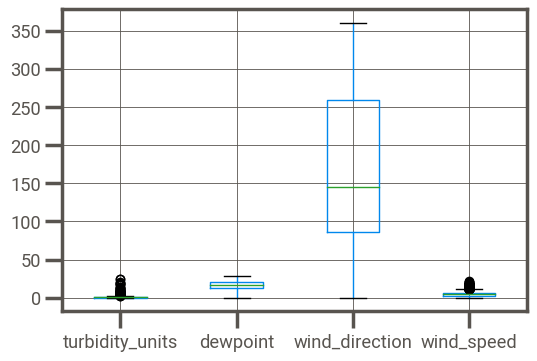

In [114]:
##here we show example of variable after outliers removal. 
boxplot = ff_phyto1.boxplot(column=['turbidity_units', 'dewpoint', 'wind_direction', 'wind_speed'])
sns.set_context("poster", font_scale = 0.5, rc={"grid.linewidth": 0.6})

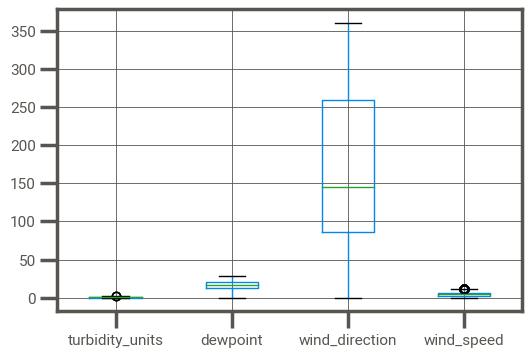

In [117]:
##here we show example of variable after outliers removal. 
boxplot = OL_phyto.boxplot(column=['turbidity_units', 'dewpoint', 'wind_direction', 'wind_speed'])
sns.set_context("poster", font_scale = 0.5, rc={"grid.linewidth": 0.6})

In [118]:
OL_phyto.describe()

,d_stamp,T_round1,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,wind_speed,pressure,BAROMETER,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgVolt,AvgLinearAdjVal,dominant_period,significant_height,mean_period,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,Direction_DegM,East_cm_s,Temperature_DegC,Heading_DegM,North_cm_s,Abs_Speed_cm_s,Abs_Tilt_Deg,Strength_dB,Max_Tilt_Deg,Std_Tilt_Deg,SP_Std_cm_s,Tilt_Y_Deg,Tilt_X_Deg,g_5,g_14,g_23,g_50,g_59,g_68,g_77,g_86,temp_avg,depth_103,depth_85,...,depth_23,depth_81,depth_11,depth_41,depth_77,depth_35,depth_65,depth_111,depth_49,depth_91,depth_131,depth_53,depth_115,depth_31,depth_59,depth_61,depth_27,depth_83,depth_57,depth_121,depth_13,depth_75,depth_47,depth_43,depth_29,depth_19,depth_113,depth_97,depth_101,depth_93,depth_17,depth_7,depth_107,depth_37,depth_33,depth_25,depth_67,depth_63,depth_125,depth_55,depth_87,depth_117,depth_109,depth_123,depth_5,depth_71,depth_119,depth_9,depth_79,chl_pred
count,820.0,820.0,19027.000000,19265.000000,19334.000000,19334.000000,19334.000000,19334.000000,18927.000000,19334.000000,19334.000000,19251.000000,19251.000000,19251.000000,19255.000000,19255.000000,19255.000000,18968.000000,19323.000000,19323.000000,13845.000000,13810.000000,13688.000000,14035.000000,14035.000000,14035.000000,19311.000000,18844.000000,19311.000000,19311.000000,18915.000000,18749.000000,19102.000000,19237.000000,19311.000000,19127.000000,19311.000000,19297.000000,19091.000000,13578.000000,8656.000000,11911.000000,10069.000000,8962.000000,13203.000000,9379.000000,9449.000000,15861.000000,4421.000000,10174.000000,...,14893.000000,12302.000000,15582.000000,14886.000000,13552.000000,14909.000000,14592.000000,968.000000,14691.000000,9067.000000,5956.000000,14688.000000,4178.000000,14895.000000,14643.000000,14623.000000,14914.000000,11336.000000,14547.000000,5897.000000,15100.000000,13904.000000,14794.000000,14876.000000,14900.000000,14845.000000,943.000000,5935.000000,9021.000000,7522.000000,14758.000000,17171.000000,1831.000000,14930.000000,14902.000000,14859.000000,14521.000000,14624.000000,6002.000000,14526.000000,9115.000000,5850.000000,1654.000000,5988.000000,16973.000000,14314.000000,5946.000000,16425.000000,13050.000000,19334.000000
mean,0.0,0.0,0.187699,0.738728,22.387018,64.296659,16.067363,164.828110,4.529274,971.283335,971.420763,2216.944294,0.625827,62.582407,2172.857814,0.518141,23.090034,5.049498,0.609216,3.796472,0.412083,-0.493339,4.223446,5.381194,197.118391,196.910482,130.633467,2.486877,24.467801,187.730427,5.620378,15.443564,4.028265,-16.786682,9.230592,1.584228,20.476455,1.017565,-2.675184,24.488562,25.374413,29.551315,89.206311,20.134522,42.958506,18.328249,17.965424,34.558201,0.108150,0.156343,...,0.185787,0.155082,0.124337,0.185566,0.154512,0.189222,0.159878,0.034711,0.174035,0.112321,0.042942,0.169939,0.042329,0.188228,0.163215,0.161705,0.189311,0.155700,0.163102,0.048431,0.136065,0.154668,0.178885,0.184071,0.189340,0.177617,0.028314,0.090221,0.086039,0.114583,0.165257,0.120822,0.128531,0.189619,0.188548,0.186286,0.158362,0.160948,0.064114,0.164715,0.155563,0.028427,0.119583,0.066889,0.206457,0.155799,0.040762,0.126199,0.153884,0.200946
std,0.0,0.0,0.117934,0.616077,6.259734,16.872609,5.978084,104.926174,2.544829,204.468589,204.495435,469.395671,0.165276,16.527451,458.610389,0.117336,6.477772,1.936611,0.485347,1.130619,3.568329,3.179618,2.337597,2.987457,114.297228,114.400972,110.916671,9.643023,6.229948,113.685791,15.679868,11.163535,1.709889,6.444179,4.951137,0.748992,10.813204,2.269238,1.474850,7.376653,114.368246,565.754613,5095.309277,10.156395,2654.225696,5.815969,5.704723,788.358685,0.127877,0.128366,...,0.133318,0.125933,0.086128,0.134001,0.123891,0.137738,0.121837,0.098029,0.125116,0.095255,0.029364,0.124970,0.034098,0.138035,0.122560,0.121777,0.138200,0.126547,0.119680,0.033850,0.098726,0.123828,0.129116,0.133107,0.138537,0.124538,0.088077,0.086244,0.102

C:\Users\dalit\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


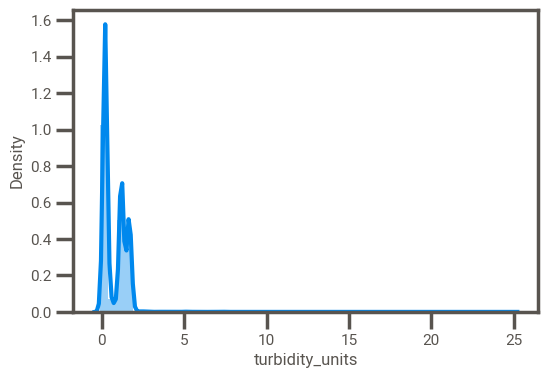

In [127]:
#boxplot = OL_phyto.boxplot(column=[
 #      'depth_81', 'depth_91', 'depth_131', 'depth_115', 'depth_83'])
sns.distplot(ff_phyto1['turbidity_units'],bins=50 )
plt.show()

C:\Users\dalit\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


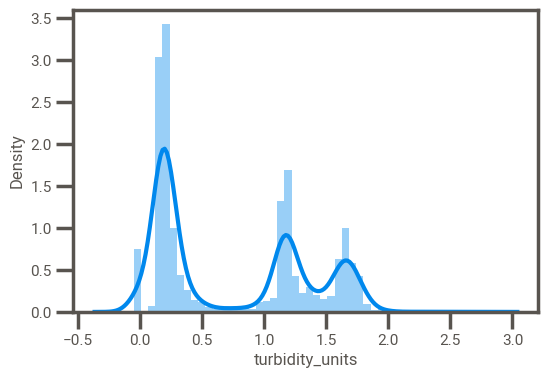

In [128]:
sns.distplot(OL_phyto['turbidity_units'],bins=50 )
plt.show()

# Missing Values Analysis and Imputation

In [134]:
miss_phyto=OL_phyto.copy()
miss_phyto.describe()

,d_stamp,T_round1,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,wind_speed,pressure,BAROMETER,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgVolt,AvgLinearAdjVal,dominant_period,significant_height,mean_period,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,Direction_DegM,East_cm_s,Temperature_DegC,Heading_DegM,North_cm_s,Abs_Speed_cm_s,Abs_Tilt_Deg,Strength_dB,Max_Tilt_Deg,Std_Tilt_Deg,SP_Std_cm_s,Tilt_Y_Deg,Tilt_X_Deg,g_5,g_14,g_23,g_50,g_59,g_68,g_77,g_86,temp_avg,depth_103,depth_85,...,depth_23,depth_81,depth_11,depth_41,depth_77,depth_35,depth_65,depth_111,depth_49,depth_91,depth_131,depth_53,depth_115,depth_31,depth_59,depth_61,depth_27,depth_83,depth_57,depth_121,depth_13,depth_75,depth_47,depth_43,depth_29,depth_19,depth_113,depth_97,depth_101,depth_93,depth_17,depth_7,depth_107,depth_37,depth_33,depth_25,depth_67,depth_63,depth_125,depth_55,depth_87,depth_117,depth_109,depth_123,depth_5,depth_71,depth_119,depth_9,depth_79,chl_pred
count,820.0,820.0,19027.000000,19265.000000,19334.000000,19334.000000,19334.000000,19334.000000,18927.000000,19334.000000,19334.000000,19251.000000,19251.000000,19251.000000,19255.000000,19255.000000,19255.000000,18968.000000,19323.000000,19323.000000,13845.000000,13810.000000,13688.000000,14035.000000,14035.000000,14035.000000,19311.000000,18844.000000,19311.000000,19311.000000,18915.000000,18749.000000,19102.000000,19237.000000,19311.000000,19127.000000,19311.000000,19297.000000,19091.000000,13578.000000,8656.000000,11911.000000,10069.000000,8962.000000,13203.000000,9379.000000,9449.000000,15861.000000,4421.000000,10174.000000,...,14893.000000,12302.000000,15582.000000,14886.000000,13552.000000,14909.000000,14592.000000,968.000000,14691.000000,9067.000000,5956.000000,14688.000000,4178.000000,14895.000000,14643.000000,14623.000000,14914.000000,11336.000000,14547.000000,5897.000000,15100.000000,13904.000000,14794.000000,14876.000000,14900.000000,14845.000000,943.000000,5935.000000,9021.000000,7522.000000,14758.000000,17171.000000,1831.000000,14930.000000,14902.000000,14859.000000,14521.000000,14624.000000,6002.000000,14526.000000,9115.000000,5850.000000,1654.000000,5988.000000,16973.000000,14314.000000,5946.000000,16425.000000,13050.000000,19334.000000
mean,0.0,0.0,0.187699,0.738728,22.387018,64.296659,16.067363,164.828110,4.529274,971.283335,971.420763,2216.944294,0.625827,62.582407,2172.857814,0.518141,23.090034,5.049498,0.609216,3.796472,0.412083,-0.493339,4.223446,5.381194,197.118391,196.910482,130.633467,2.486877,24.467801,187.730427,5.620378,15.443564,4.028265,-16.786682,9.230592,1.584228,20.476455,1.017565,-2.675184,24.488562,25.374413,29.551315,89.206311,20.134522,42.958506,18.328249,17.965424,34.558201,0.108150,0.156343,...,0.185787,0.155082,0.124337,0.185566,0.154512,0.189222,0.159878,0.034711,0.174035,0.112321,0.042942,0.169939,0.042329,0.188228,0.163215,0.161705,0.189311,0.155700,0.163102,0.048431,0.136065,0.154668,0.178885,0.184071,0.189340,0.177617,0.028314,0.090221,0.086039,0.114583,0.165257,0.120822,0.128531,0.189619,0.188548,0.186286,0.158362,0.160948,0.064114,0.164715,0.155563,0.028427,0.119583,0.066889,0.206457,0.155799,0.040762,0.126199,0.153884,0.200946
std,0.0,0.0,0.117934,0.616077,6.259734,16.872609,5.978084,104.926174,2.544829,204.468589,204.495435,469.395671,0.165276,16.527451,458.610389,0.117336,6.477772,1.936611,0.485347,1.130619,3.568329,3.179618,2.337597,2.987457,114.297228,114.400972,110.916671,9.643023,6.229948,113.685791,15.679868,11.163535,1.709889,6.444179,4.951137,0.748992,10.813204,2.269238,1.474850,7.376653,114.368246,565.754613,5095.309277,10.156395,2654.225696,5.815969,5.704723,788.358685,0.127877,0.128366,...,0.133318,0.125933,0.086128,0.134001,0.123891,0.137738,0.121837,0.098029,0.125116,0.095255,0.029364,0.124970,0.034098,0.138035,0.122560,0.121777,0.138200,0.126547,0.119680,0.033850,0.098726,0.123828,0.129116,0.133107,0.138537,0.124538,0.088077,0.086244,0.102

In [132]:
miss_phyto.depth_131.isnull().sum(),miss_phyto['depth_131'].count(),miss_phyto['depth_131'].nunique()

(13378, 5956, 13)

In [135]:
miss_phyto=miss_phyto.astype({"chlorophyll_concentration":float})
miss_phyto=miss_phyto.astype({"chl_pred":float})
miss_phyto= miss_phyto.drop(['T_round1','d_stamp'], axis = 1)
miss_phyto.dtypes

chlorophyll_concentration    float64
turbidity_units              float64
temperature                  float64
humidity                     float64
dewpoint                     float64
                              ...   
depth_71                     float64
depth_119                    float64
depth_9                      float64
depth_79                     float64
chl_pred                     float64
Length: 112, dtype: object

### columns missing

In [136]:
#sum the missing in each column
miss=pd.DataFrame(miss_phyto.isna().sum())
miss['miss']=pd.DataFrame(miss_phyto.isna().sum())
miss['names']=miss.index
miss.astype({"miss":float})
miss

,0,miss,names
chlorophyll_concentration,307,307,chlorophyll_concentration
turbidity_units,69,69,turbidity_units
temperature,0,0,temperature
humidity,0,0,humidity
dewpoint,0,0,dewpoint
...,...,...,...
depth_71,5020,5020,depth_71
depth_119,13388,13388,depth_119
depth_9,2909,2909,depth_9
depth_79,6284,6284,depth_79


In [137]:
#count the total of values in each column
total=pd.DataFrame(miss_phyto.isna().sum()+miss_phyto.count())
total['total']=pd.DataFrame(miss_phyto.isna().sum()+miss_phyto.count())
total['names']=total.index
total.astype({"total":float})
total

,0,total,names
chlorophyll_concentration,19334,19334,chlorophyll_concentration
turbidity_units,19334,19334,turbidity_units
temperature,19334,19334,temperature
humidity,19334,19334,humidity
dewpoint,19334,19334,dewpoint
...,...,...,...
depth_71,19334,19334,depth_71
depth_119,19334,19334,depth_119
depth_9,19334,19334,depth_9
depth_79,19334,19334,depth_79


In [138]:
#merge the columns
dfall=pd.merge(miss,total, on='names')
dfall['perc']=dfall['miss']/dfall['total']*100
dfall.astype({"perc":float})
dfall.head(100)

,0_x,miss,names,0_y,total,perc
0,307,307,chlorophyll_concentration,19334,19334,1.587876
1,69,69,turbidity_units,19334,19334,0.356884
2,0,0,temperature,19334,19334,0.000000
3,0,0,humidity,19334,19334,0.000000
4,0,0,dewpoint,19334,19334,0.000000
5,0,0,wind_direction,19334,19334,0.000000
6,407,407,wind_speed,19334,19334,2.105100
7,0,0,pressure,19334,19334,0.000000
8,0,0,BAROMETER,19334,19334,0.000000
9,83,83,external_humidity_AvgVal,19334,19334,0.429296


In [139]:
dfall.sort_values(ascending=False,by='perc').head(100)

,0_x,miss,names,0_y,total,perc
88,18391,18391,depth_113,19334,19334,95.122582
69,18366,18366,depth_111,19334,19334,94.993276
104,17680,17680,depth_109,19334,19334,91.445123
94,17503,17503,depth_107,19334,19334,90.529637
52,17126,17126,depth_105,19334,19334,88.579704
74,15156,15156,depth_115,19334,19334,78.390400
46,14913,14913,depth_103,19334,19334,77.133547
53,14725,14725,depth_95,19334,19334,76.161167
103,13484,13484,depth_117,19334,19334,69.742423
81,13437,13437,depth_121,19334,19334,69.499328


In [140]:
#make the names to be the index
dfall.index=dfall.names

In [141]:
dfall=dfall.drop(['0_y','0_x','names'], axis = 1)
#dfall_a.sort_values(ascending=False,by='perc').head(100)
dfall

,miss,total,perc
names,,,
chlorophyll_concentration,307,19334,1.587876
turbidity_units,69,19334,0.356884
temperature,0,19334,0.000000
humidity,0,19334,0.000000
dewpoint,0,19334,0.000000
...,...,...,...
depth_71,5020,19334,25.964622
depth_119,13388,19334,69.245888
depth_9,2909,19334,15.046033


In [142]:
dfall.head(100)

,miss,total,perc
names,,,
chlorophyll_concentration,307,19334,1.587876
turbidity_units,69,19334,0.356884
temperature,0,19334,0.000000
humidity,0,19334,0.000000
dewpoint,0,19334,0.000000
wind_direction,0,19334,0.000000
wind_speed,407,19334,2.105100
pressure,0,19334,0.000000
BAROMETER,0,19334,0.000000


In [143]:
#divide the data according to the percentage
dfall_a=dfall.loc[dfall['perc']>=80]
dfall_b=dfall.loc[(dfall['perc']>40) & (dfall['perc']<80)]
dfall_c=dfall.loc[(dfall['perc']<=40)]

In [144]:
##all the variables that have more the 80% missings
dfall_a.sort_values(ascending=False,by='perc').head(100)

,miss,total,perc
names,,,
depth_113,18391,19334,95.122582
depth_111,18366,19334,94.993276
depth_109,17680,19334,91.445123
depth_107,17503,19334,90.529637
depth_105,17126,19334,88.579704


In [145]:
#dropping the column which their missing percentage is more the 80%
miss_phyto_a=miss_phyto.drop(['depth_113','depth_111','depth_109','depth_107','depth_105'], axis = 1)

In [146]:
miss_phyto_a

,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,wind_speed,pressure,BAROMETER,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgVolt,AvgLinearAdjVal,dominant_period,significant_height,mean_period,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,Direction_DegM,East_cm_s,Temperature_DegC,Heading_DegM,North_cm_s,Abs_Speed_cm_s,Abs_Tilt_Deg,Strength_dB,Max_Tilt_Deg,Std_Tilt_Deg,SP_Std_cm_s,Tilt_Y_Deg,Tilt_X_Deg,g_5,g_14,g_23,g_50,g_59,g_68,g_77,g_86,temp_avg,depth_103,depth_85,depth_39,depth_69,...,depth_99,depth_3,depth_89,depth_21,depth_23,depth_81,depth_11,depth_41,depth_77,depth_35,depth_65,depth_49,depth_91,depth_131,depth_53,depth_115,depth_31,depth_59,depth_61,depth_27,depth_83,depth_57,depth_121,depth_13,depth_75,depth_47,depth_43,depth_29,depth_19,depth_97,depth_101,depth_93,depth_17,depth_7,depth_37,depth_33,depth_25,depth_67,depth_63,depth_125,depth_55,depth_87,depth_117,depth_123,depth_5,depth_71,depth_119,depth_9,depth_79,chl_pred
0,0.071,0.177,28.1,86.1,25.5,158.000,1.31,1004.9,1004.77,2396.0,0.851,85.104,2290.2,0.592,29.219,3.774,0.350,3.569,1.003,-1.398,1.721,2.459,312.268,305.642,354.116,-3.813,29.656,268.558,36.999,37.195,3.019,-23.242,6.658,1.341,15.587,2.111,-1.209,29.66,28.57,27.62,22.81,21.58,21.15,20.38,NaN,24.572,0.09,0.03,0.40,0.02,...,0.05,1.00,0.02,0.45,0.46,0.04,0.27,0.35,0.04,0.36,0.07,0.25,0.04,NaN,0.10,NaN,0.41,0.14,0.09,0.41,0.08,0.12,NaN,0.36,0.04,0.28,0.34,0.44,0.47,NaN,0.07,0.05,0.45,0.11,0.35,0.39,0.42,0.04,0.04,NaN,0.09,0.08,NaN,NaN,0.09,0.07,NaN,0.16,0.05,0.036
1,0.095,0.189,28.1,86.1,25.6,181.000,1.62,1005.0,1004.85,2395.4,0.849,84.860,2285.6,0.580,27.998,4.878,0.368,3.535,0.847,-1.376,1.616,2.176,300.039,301.608,359.196,-0.561,29.710,271.677,39.985,39.989,2.911,-23.277,5.848,1.299,14.462,1.981,-1.251,29.71,28.77,27.47,22.85,21.65,21.13,20.22,NaN,24.580,0.02,0.08,0.36,0.09,...,NaN,NaN,0.09,0.46,0.44,0.02,0.24,0.32,0.03,0.36,0.02,0.20,0.06,NaN,0.17,NaN,0.43,0.11,0.11,0.44,0.08,0.12,NaN,0.33,0.05,0.24,0.31,0.43,0.46,NaN,0.02,0.10,0.47,0.09,0.36,0.39,0.41,0.04,0.08,NaN,0.18,0.07,NaN,NaN,0.09,0.01,NaN,0.20,0.05,0.083
2,0.083,0.183,28.1,86.4,25.7,156.000,1.50,1005.0,1004.86,2395.6,0.849,84.860,2289.4,0.590,28.974,5.000,0.383,3.632,1.146,-1.358,1.777,2.635,319.648,310.163,357.789,-1.452,29.775,275.965,37.602,37.630,3.168,-23.103,5.827,1.266,13.411,2.221,-1.250,29.77,29.00,27.37,23.40,21.70,21.17,20.15,NaN,24.675,0.20,0.15,0.34,0.01,...,NaN,NaN,0.07,0.46,0.40,0.05,0.24,0.36,0.05,0.37,0.04,0.28,0.12,NaN,0.15,NaN,0.41,0.11,0.09,0.39,0.07,0.07,NaN,0.38,0.02,0.26,0.30,0.40,0.38,NaN,0.05,0.10,0.41,0.10,0.37,0.39,0.43,0.05,0.05,NaN,0.15,0.15,NaN,NaN,0.12,0.03,NaN,0.23,0.08,0.060
3,0.095,0.189,28.1,84.6,25.2,188.000,1.26,1005.2,1005.10,2396.8,0.851,85.104,2291.6,0.595,29.463,4.444,0.373,3.516,0.766,-1.555,1.733,2.225,296.202,296.223,358.542,-1.052,29.807,277.912,41.330,41.344,3.110,-22.739,7.250,1.349,12.593,2.145,-1.219,29.80,29.15,27.35,23.37,21.62,21.17,20.07,NaN,24.680,0.10,0.09,0.33,0.07,...,0.05,NaN,0.10,0.43,0.39,0.09,0.19,0.29,0.04,0.39,0.10,0.28,0.00,NaN,0.17,NaN,0.42,0.12,0.11,0.40,0.08,0.13,NaN,0.28,0.02,0.23,0.33,0.41,0.45,NaN,0.02,0.07,0.47,0.16,0.38,0.35,0.38,0.07,0.04,NaN,0.15,0.06,NaN,NaN,0.07,0.07,NaN,0.10,0.05,0.083
4,0.107,0.201,27.9,85.2,25.2,150.000,1.68,1005.3,1005.15,2391.4,0.839,83.883,2291.0,0.595,29.463,5.263,0.344,3.570,0.692,-1.262,1.439,2.008,296.420,298.723,356.702,-2.372,29.849,276.629,41.170,41.238,3.014,-22.449,6.186,1.233,11.526,2.222,-1.224,29.85,29.47,26.99,23.31,21.77,21.21,20.14,NaN,24.701,0.05,0.09,0.36,0.05,...,0.07,NaN,0.07,0.42,0.39,0.11,0.25,0.32,0.06,0.38,0.08,0.23,0.03,NaN,0.18,NaN,0.37,0.11,0.10,0.42,0.07,0.14,NaN,0.31,0.04,0.25,0.29,0.37,0.48,NaN,0.04,0.09,0.46,0.14,0.38,0.34,0.38,0.02,0.07,NaN,0.18,0.04,NaN,NaN,0.11,0.03,NaN,0.13,0.09,0.048
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

### row missing

In [147]:
#sum the number of missing in each row
miss_row=pd.DataFrame(miss_phyto_a.isna().sum(axis=1))
miss_row['miss']=pd.DataFrame(miss_phyto_a.isna().sum(axis=1))
#miss_row['names']=miss_row.index
miss_row.astype({"miss":float})
miss_row

,0,miss
0,12,12
1,14,14
2,13,13
3,13,13
4,13,13
...,...,...
19329,59,59
19330,59,59
19331,58,58
19332,58,58


In [148]:
#count the total number of values in each row
total_row=pd.DataFrame(miss_phyto_a.isna().sum(axis=1)+miss_phyto_a.count(axis=1))
total_row['total']=pd.DataFrame(miss_phyto_a.isna().sum(axis=1)+miss_phyto_a.count(axis=1))
#miss_row['names']=miss_row.index
total_row.astype({"total":float})
total_row


,0,total
0,107,107
1,107,107
2,107,107
3,107,107
4,107,107
...,...,...
19329,107,107
19330,107,107
19331,107,107
19332,107,107


In [149]:
#merge the columns
dfall_row=pd.merge(miss_row,total_row, left_index=True, right_index=True)

In [150]:
#calculate percentage
dfall_row['perc']=dfall_row['miss']/dfall_row['total']*100
dfall_row.astype({"perc":float})
dfall_row.sort_values(ascending=False,by='perc').head(100)

,0_x,miss,0_y,total,perc
15362,97,97,107,107,90.654206
15368,94,94,107,107,87.850467
15383,91,91,107,107,85.046729
15357,91,91,107,107,85.046729
15373,88,88,107,107,82.242991
15367,88,88,107,107,82.242991
15374,87,87,107,107,81.308411
15384,85,85,107,107,79.439252
9773,85,85,107,107,79.439252
9767,85,85,107,107,79.439252


In [151]:
#show rows with more than 80% missing
dfall_row_a=dfall_row.loc[dfall_row['perc']>=80]
dfall_row_a.index

Int64Index([15357, 15362, 15367, 15368, 15373, 15374, 15383], dtype='int64')

In [152]:
#count rows with more than 70% missing
dfall_row_b=(dfall_row.loc[dfall_row['perc']>=70]).count()
dfall_row_b

0_x      45
miss     45
0_y      45
total    45
perc     45
dtype: int64

In [153]:
#count rows with more than 60% missing
dfall_row_a=(dfall_row.loc[dfall_row['perc']>=60]).count()
dfall_row_a

0_x      2038
miss     2038
0_y      2038
total    2038
perc     2038
dtype: int64

In [154]:
#show rows with more than 70% missing
dfall_row_b=(dfall_row.loc[dfall_row['perc']>=70])
dfall_row_b.index

Int64Index([ 9760,  9762,  9763,  9764,  9765,  9766,  9767,  9768,  9769,
             9770,  9771,  9772,  9773,  9774,  9775,  9776,  9777,  9778,
             9826, 15355, 15356, 15357, 15358, 15362, 15365, 15366, 15367,
            15368, 15371, 15373, 15374, 15375, 15377, 15383, 15384, 15491,
            15783, 15960, 16035, 16061, 16363, 16694, 17297, 18008, 18688],
           dtype='int64')

In [157]:
miss_phyto_rows=miss_phyto_a
miss_phyto_rows

,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,wind_speed,pressure,BAROMETER,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgVolt,AvgLinearAdjVal,dominant_period,significant_height,mean_period,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,Direction_DegM,East_cm_s,Temperature_DegC,Heading_DegM,North_cm_s,Abs_Speed_cm_s,Abs_Tilt_Deg,Strength_dB,Max_Tilt_Deg,Std_Tilt_Deg,SP_Std_cm_s,Tilt_Y_Deg,Tilt_X_Deg,g_5,g_14,g_23,g_50,g_59,g_68,g_77,g_86,temp_avg,depth_103,depth_85,depth_39,depth_69,...,depth_99,depth_3,depth_89,depth_21,depth_23,depth_81,depth_11,depth_41,depth_77,depth_35,depth_65,depth_49,depth_91,depth_131,depth_53,depth_115,depth_31,depth_59,depth_61,depth_27,depth_83,depth_57,depth_121,depth_13,depth_75,depth_47,depth_43,depth_29,depth_19,depth_97,depth_101,depth_93,depth_17,depth_7,depth_37,depth_33,depth_25,depth_67,depth_63,depth_125,depth_55,depth_87,depth_117,depth_123,depth_5,depth_71,depth_119,depth_9,depth_79,chl_pred
0,0.071,0.177,28.1,86.1,25.5,158.000,1.31,1004.9,1004.77,2396.0,0.851,85.104,2290.2,0.592,29.219,3.774,0.350,3.569,1.003,-1.398,1.721,2.459,312.268,305.642,354.116,-3.813,29.656,268.558,36.999,37.195,3.019,-23.242,6.658,1.341,15.587,2.111,-1.209,29.66,28.57,27.62,22.81,21.58,21.15,20.38,NaN,24.572,0.09,0.03,0.40,0.02,...,0.05,1.00,0.02,0.45,0.46,0.04,0.27,0.35,0.04,0.36,0.07,0.25,0.04,NaN,0.10,NaN,0.41,0.14,0.09,0.41,0.08,0.12,NaN,0.36,0.04,0.28,0.34,0.44,0.47,NaN,0.07,0.05,0.45,0.11,0.35,0.39,0.42,0.04,0.04,NaN,0.09,0.08,NaN,NaN,0.09,0.07,NaN,0.16,0.05,0.036
1,0.095,0.189,28.1,86.1,25.6,181.000,1.62,1005.0,1004.85,2395.4,0.849,84.860,2285.6,0.580,27.998,4.878,0.368,3.535,0.847,-1.376,1.616,2.176,300.039,301.608,359.196,-0.561,29.710,271.677,39.985,39.989,2.911,-23.277,5.848,1.299,14.462,1.981,-1.251,29.71,28.77,27.47,22.85,21.65,21.13,20.22,NaN,24.580,0.02,0.08,0.36,0.09,...,NaN,NaN,0.09,0.46,0.44,0.02,0.24,0.32,0.03,0.36,0.02,0.20,0.06,NaN,0.17,NaN,0.43,0.11,0.11,0.44,0.08,0.12,NaN,0.33,0.05,0.24,0.31,0.43,0.46,NaN,0.02,0.10,0.47,0.09,0.36,0.39,0.41,0.04,0.08,NaN,0.18,0.07,NaN,NaN,0.09,0.01,NaN,0.20,0.05,0.083
2,0.083,0.183,28.1,86.4,25.7,156.000,1.50,1005.0,1004.86,2395.6,0.849,84.860,2289.4,0.590,28.974,5.000,0.383,3.632,1.146,-1.358,1.777,2.635,319.648,310.163,357.789,-1.452,29.775,275.965,37.602,37.630,3.168,-23.103,5.827,1.266,13.411,2.221,-1.250,29.77,29.00,27.37,23.40,21.70,21.17,20.15,NaN,24.675,0.20,0.15,0.34,0.01,...,NaN,NaN,0.07,0.46,0.40,0.05,0.24,0.36,0.05,0.37,0.04,0.28,0.12,NaN,0.15,NaN,0.41,0.11,0.09,0.39,0.07,0.07,NaN,0.38,0.02,0.26,0.30,0.40,0.38,NaN,0.05,0.10,0.41,0.10,0.37,0.39,0.43,0.05,0.05,NaN,0.15,0.15,NaN,NaN,0.12,0.03,NaN,0.23,0.08,0.060
3,0.095,0.189,28.1,84.6,25.2,188.000,1.26,1005.2,1005.10,2396.8,0.851,85.104,2291.6,0.595,29.463,4.444,0.373,3.516,0.766,-1.555,1.733,2.225,296.202,296.223,358.542,-1.052,29.807,277.912,41.330,41.344,3.110,-22.739,7.250,1.349,12.593,2.145,-1.219,29.80,29.15,27.35,23.37,21.62,21.17,20.07,NaN,24.680,0.10,0.09,0.33,0.07,...,0.05,NaN,0.10,0.43,0.39,0.09,0.19,0.29,0.04,0.39,0.10,0.28,0.00,NaN,0.17,NaN,0.42,0.12,0.11,0.40,0.08,0.13,NaN,0.28,0.02,0.23,0.33,0.41,0.45,NaN,0.02,0.07,0.47,0.16,0.38,0.35,0.38,0.07,0.04,NaN,0.15,0.06,NaN,NaN,0.07,0.07,NaN,0.10,0.05,0.083
4,0.107,0.201,27.9,85.2,25.2,150.000,1.68,1005.3,1005.15,2391.4,0.839,83.883,2291.0,0.595,29.463,5.263,0.344,3.570,0.692,-1.262,1.439,2.008,296.420,298.723,356.702,-2.372,29.849,276.629,41.170,41.238,3.014,-22.449,6.186,1.233,11.526,2.222,-1.224,29.85,29.47,26.99,23.31,21.77,21.21,20.14,NaN,24.701,0.05,0.09,0.36,0.05,...,0.07,NaN,0.07,0.42,0.39,0.11,0.25,0.32,0.06,0.38,0.08,0.23,0.03,NaN,0.18,NaN,0.37,0.11,0.10,0.42,0.07,0.14,NaN,0.31,0.04,0.25,0.29,0.37,0.48,NaN,0.04,0.09,0.46,0.14,0.38,0.34,0.38,0.02,0.07,NaN,0.18,0.04,NaN,NaN,0.11,0.03,NaN,0.13,0.09,0.048
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

In [ ]:
#miss_phyto_rows.to_csv("C:/Users/dalit/DataScience/project/final_project/miss_phyto_rows.csv")

In [158]:
dfall_b=dfall.loc[(dfall['perc']>40) & (dfall['perc']<80)]
dfall_c=dfall.loc[(dfall['perc']<=40)]

### missing are between  40 to 80% of the columns

In [259]:
dfall_b.sort_values(ascending=False,by='perc').head(100)

,miss,total,perc
names,,,
depth_115,15156,19334,78.390400
depth_103,14913,19334,77.133547
depth_95,14725,19334,76.161167
depth_117,13484,19334,69.742423
depth_121,13437,19334,69.499328
depth_97,13399,19334,69.302783
depth_119,13388,19334,69.245888
depth_131,13378,19334,69.194166
depth_129,13350,19334,69.049343


In [260]:
#find the columns that their missing are betweem 40-79%
miss_phyto_b=pd.DataFrame()
for indx, row in  dfall_b.iterrows():
    miss_phyto_b[indx]=miss_phyto_rows[indx]
    
miss_phyto_b


,g_14,g_50,g_59,g_77,g_86,depth_103,depth_85,depth_127,depth_95,depth_129,depth_99,depth_89,depth_91,depth_131,depth_115,depth_83,depth_121,depth_97,depth_101,depth_93,depth_125,depth_87,depth_117,depth_123,depth_119
0,28.57,22.81,21.58,20.38,NaN,0.09,0.03,NaN,NaN,NaN,0.05,0.02,0.04,NaN,NaN,0.08,NaN,NaN,0.07,0.05,NaN,0.08,NaN,NaN,NaN
1,28.77,22.85,21.65,20.22,NaN,0.02,0.08,NaN,NaN,NaN,NaN,0.09,0.06,NaN,NaN,0.08,NaN,NaN,0.02,0.10,NaN,0.07,NaN,NaN,NaN
2,29.00,23.40,21.70,20.15,NaN,0.20,0.15,NaN,0.04,NaN,NaN,0.07,0.12,NaN,NaN,0.07,NaN,NaN,0.05,0.10,NaN,0.15,NaN,NaN,NaN
3,29.15,23.37,21.62,20.07,NaN,0.10,0.09,NaN,NaN,NaN,0.05,0.10,0.00,NaN,NaN,0.08,NaN,NaN,0.02,0.07,NaN,0.06,NaN,NaN,NaN
4,29.47,23.31,21.77,20.14,NaN,0.05,0.09,NaN,NaN,NaN,0.07,0.07,0.03,NaN,NaN,0.07,NaN,NaN,0.04,0.09,NaN,0.04,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19329,23.94,23.90,23.92,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
19330,23.98,23.90,23.89,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
19331,24.03,23.89,23.88,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
19332,24.05,23.91,23.89,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


<AxesSubplot:>

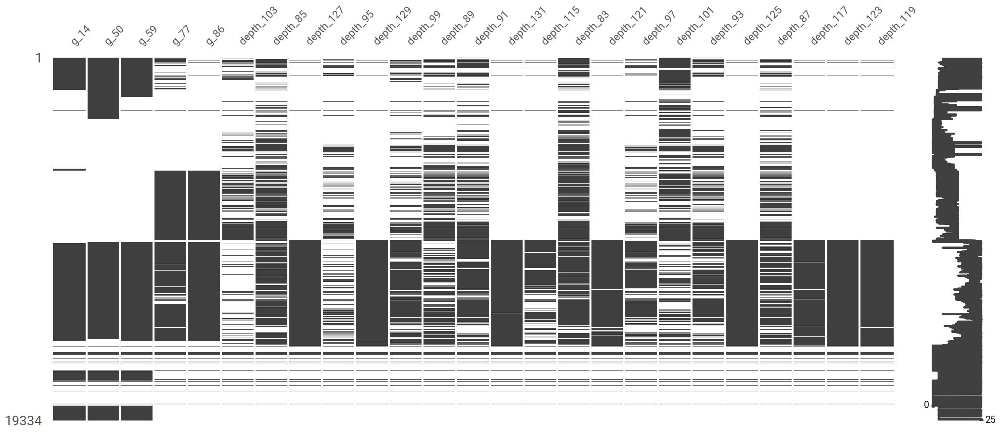

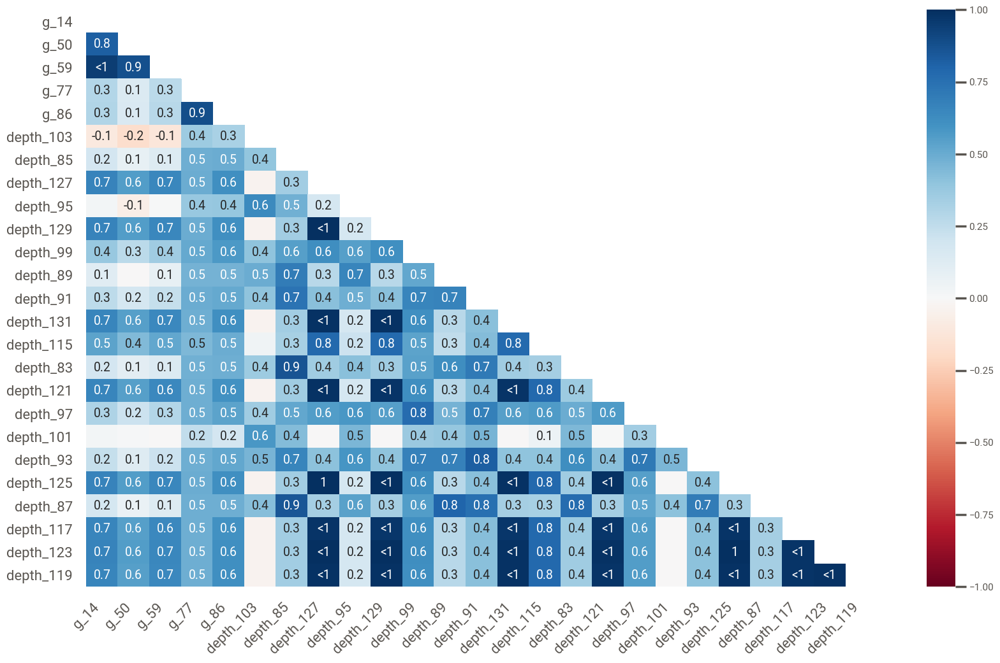

In [161]:
##show the heatmap and matrix of missing
miss_phyto2 = miss_phyto_b.columns[miss_phyto_b.isnull().any()].tolist()
msno.matrix(miss_phyto_b[miss_phyto2])
msno.heatmap(miss_phyto_b)

In [261]:
miss_phyto_b=pd.DataFrame(miss_phyto_b)
miss_phyto_b

,g_14,g_50,g_59,g_77,g_86,depth_103,depth_85,depth_127,depth_95,depth_129,depth_99,depth_89,depth_91,depth_131,depth_115,depth_83,depth_121,depth_97,depth_101,depth_93,depth_125,depth_87,depth_117,depth_123,depth_119
0,28.57,22.81,21.58,20.38,NaN,0.09,0.03,NaN,NaN,NaN,0.05,0.02,0.04,NaN,NaN,0.08,NaN,NaN,0.07,0.05,NaN,0.08,NaN,NaN,NaN
1,28.77,22.85,21.65,20.22,NaN,0.02,0.08,NaN,NaN,NaN,NaN,0.09,0.06,NaN,NaN,0.08,NaN,NaN,0.02,0.10,NaN,0.07,NaN,NaN,NaN
2,29.00,23.40,21.70,20.15,NaN,0.20,0.15,NaN,0.04,NaN,NaN,0.07,0.12,NaN,NaN,0.07,NaN,NaN,0.05,0.10,NaN,0.15,NaN,NaN,NaN
3,29.15,23.37,21.62,20.07,NaN,0.10,0.09,NaN,NaN,NaN,0.05,0.10,0.00,NaN,NaN,0.08,NaN,NaN,0.02,0.07,NaN,0.06,NaN,NaN,NaN
4,29.47,23.31,21.77,20.14,NaN,0.05,0.09,NaN,NaN,NaN,0.07,0.07,0.03,NaN,NaN,0.07,NaN,NaN,0.04,0.09,NaN,0.04,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19329,23.94,23.90,23.92,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
19330,23.98,23.90,23.89,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
19331,24.03,23.89,23.88,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
19332,24.05,23.91,23.89,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [262]:
miss_phyto_b_na=miss_phyto_b.copy()

In [263]:
#change the null to 0 and 1
for i in miss_phyto_b.columns:
    miss_phyto_b_na[i]=np.where(miss_phyto_b_na[i].isnull(),1,0)


In [165]:
miss_phyto_b_na

,g_14,g_50,g_59,g_77,g_86,depth_103,depth_85,depth_127,depth_95,depth_129,depth_99,depth_89,depth_91,depth_131,depth_115,depth_83,depth_121,depth_97,depth_101,depth_93,depth_125,depth_87,depth_117,depth_123,depth_119
0,0,0,0,0,1,0,0,1,1,1,0,0,0,1,1,0,1,1,0,0,1,0,1,1,1
1,0,0,0,0,1,0,0,1,1,1,1,0,0,1,1,0,1,1,0,0,1,0,1,1,1
2,0,0,0,0,1,0,0,1,0,1,1,0,0,1,1,0,1,1,0,0,1,0,1,1,1
3,0,0,0,0,1,0,0,1,1,1,0,0,0,1,1,0,1,1,0,0,1,0,1,1,1
4,0,0,0,0,1,0,0,1,1,1,0,0,0,1,1,0,1,1,0,0,1,0,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19329,0,0,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
19330,0,0,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
19331,0,0,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
19332,0,0,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1


In [166]:
miss_phyto_b_na_rm = miss_phyto_b_na.replace(1,np.nan)
miss_phyto_b_na_rm
miss_phyto_b_na_rm.describe(include='all')

,g_14,g_50,g_59,g_77,g_86,depth_103,depth_85,depth_127,depth_95,depth_129,depth_99,depth_89,depth_91,depth_131,depth_115,depth_83,depth_121,depth_97,depth_101,depth_93,depth_125,depth_87,depth_117,depth_123,depth_119
count,8656.0,10069.0,8962.0,9379.0,9449.0,4421.0,10174.0,5991.0,4609.0,5984.0,7711.0,7968.0,9067.0,5956.0,4178.0,11336.0,5897.0,5935.0,9021.0,7522.0,6002.0,9115.0,5850.0,5988.0,5946.0
mean,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
std,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
min,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
25%,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
50%,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
75%,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
max,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [167]:
##check if df has been changed properly
miss_phyto_b_na.describe(include='all')

,g_14,g_50,g_59,g_77,g_86,depth_103,depth_85,depth_127,depth_95,depth_129,depth_99,depth_89,depth_91,depth_131,depth_115,depth_83,depth_121,depth_97,depth_101,depth_93,depth_125,depth_87,depth_117,depth_123,depth_119
count,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000
mean,0.552291,0.479208,0.536464,0.514896,0.511275,0.771335,0.473777,0.690131,0.761612,0.690493,0.601169,0.587876,0.531033,0.691942,0.783904,0.413675,0.694993,0.693028,0.533413,0.610944,0.689562,0.528551,0.697424,0.690287,0.692459
std,0.497271,0.499580,0.498681,0.499791,0.499886,0.419984,0.499325,0.462451,0.426109,0.462302,0.489671,0.492230,0.499049,0.461703,0.411591,0.492504,0.460422,0.461250,0.498895,0.487549,0.462685,0.499197,0.459385,0.462387,0.461487
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [168]:
from scipy.stats import ks_2samp
from scipy import stats

In [169]:
##KS test on 
from scipy import stats
ks_nb=[]
for a in miss_phyto_b_na.columns:
    for b in miss_phyto_b_na_rm.columns:
        try:
            dict={}
            test = stats.ks_2samp(miss_phyto_b_na[a],miss_phyto_b_na_rm[b])
            dict['names']=a
            dict['namesb']=b
            dict['stat']=test.statistic
            dict['pval']=test.pvalue
            ks_nb.append(dict)
        except FloatingPointError:
            print('error')
ks_nb=pd.DataFrame(ks_nb) 

In [170]:
ks_nb

,names,namesb,stat,pval
0,g_14,g_14,0.552291,0.0
1,g_14,g_50,0.479208,0.0
2,g_14,g_59,0.536464,0.0
3,g_14,g_77,0.514896,0.0
4,g_14,g_86,0.511275,0.0
...,...,...,...,...
620,depth_119,depth_125,0.689562,0.0
621,depth_119,depth_87,0.528551,0.0
622,depth_119,depth_117,0.697424,0.0
623,depth_119,depth_123,0.690287,0.0


In [264]:
ks_nb2=ks_nb.copy()

In [265]:
##keep only the pvalue that between the same feature
ks_nb3=ks_nb2.loc[(ks_nb2.names==ks_nb2.namesb)] #& (ot2.pval<0.05)] 
ks_nb3.sort_values(ascending=False,by='pval').head(100)

,names,namesb,stat,pval
0,g_14,g_14,0.552291,0.0
338,depth_131,depth_131,0.691942,0.0
598,depth_123,depth_123,0.690287,0.0
572,depth_117,depth_117,0.697424,0.0
546,depth_87,depth_87,0.528551,0.0
520,depth_125,depth_125,0.689562,0.0
494,depth_93,depth_93,0.610944,0.0
468,depth_101,depth_101,0.533413,0.0
442,depth_97,depth_97,0.693028,0.0
416,depth_121,depth_121,0.694993,0.0


In [266]:
##filter all the feature that pvalue in significant
ks_nb3=ks_nb3.loc[(ks_nb3.pval<=0.05)]
ks_nb3

,names,namesb,stat,pval
0,g_14,g_14,0.552291,0.0
26,g_50,g_50,0.479208,0.0
52,g_59,g_59,0.536464,0.0
78,g_77,g_77,0.514896,0.0
104,g_86,g_86,0.511275,0.0
130,depth_103,depth_103,0.771335,0.0
156,depth_85,depth_85,0.473777,0.0
182,depth_127,depth_127,0.690131,0.0
208,depth_95,depth_95,0.761612,0.0
234,depth_129,depth_129,0.690493,0.0


In [267]:
#filter all the feature that pvalue in not significant
ks_nb3_imp=ks_nb3.loc[(ks_nb3.pval>0.05)]
ks_nb3_imp

,names,namesb,stat,pval


In [268]:
ks_nb3.index=ks_nb3.names
ks_nb3

,names,namesb,stat,pval
names,,,,
g_14,g_14,g_14,0.552291,0.0
g_50,g_50,g_50,0.479208,0.0
g_59,g_59,g_59,0.536464,0.0
g_77,g_77,g_77,0.514896,0.0
g_86,g_86,g_86,0.511275,0.0
depth_103,depth_103,depth_103,0.771335,0.0
depth_85,depth_85,depth_85,0.473777,0.0
depth_127,depth_127,depth_127,0.690131,0.0
depth_95,depth_95,depth_95,0.761612,0.0


In [269]:
##create df from the variables that their missings have ks with pval  < 0.05
miss_phyto_b_2=pd.DataFrame()
for indx, row in  ks_nb3.iterrows():
    miss_phyto_b_2[indx]=miss_phyto_b[indx]
    
miss_phyto_b_2

,g_14,g_50,g_59,g_77,g_86,depth_103,depth_85,depth_127,depth_95,depth_129,depth_99,depth_89,depth_91,depth_131,depth_115,depth_83,depth_121,depth_97,depth_101,depth_93,depth_125,depth_87,depth_117,depth_123,depth_119
0,28.57,22.81,21.58,20.38,NaN,0.09,0.03,NaN,NaN,NaN,0.05,0.02,0.04,NaN,NaN,0.08,NaN,NaN,0.07,0.05,NaN,0.08,NaN,NaN,NaN
1,28.77,22.85,21.65,20.22,NaN,0.02,0.08,NaN,NaN,NaN,NaN,0.09,0.06,NaN,NaN,0.08,NaN,NaN,0.02,0.10,NaN,0.07,NaN,NaN,NaN
2,29.00,23.40,21.70,20.15,NaN,0.20,0.15,NaN,0.04,NaN,NaN,0.07,0.12,NaN,NaN,0.07,NaN,NaN,0.05,0.10,NaN,0.15,NaN,NaN,NaN
3,29.15,23.37,21.62,20.07,NaN,0.10,0.09,NaN,NaN,NaN,0.05,0.10,0.00,NaN,NaN,0.08,NaN,NaN,0.02,0.07,NaN,0.06,NaN,NaN,NaN
4,29.47,23.31,21.77,20.14,NaN,0.05,0.09,NaN,NaN,NaN,0.07,0.07,0.03,NaN,NaN,0.07,NaN,NaN,0.04,0.09,NaN,0.04,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19329,23.94,23.90,23.92,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
19330,23.98,23.90,23.89,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
19331,24.03,23.89,23.88,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
19332,24.05,23.91,23.89,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [270]:
## quantile-manner category transformation 
for i in miss_phyto_b_2.columns:
    if miss_phyto_b_2[i].skew()> 0.5:
        Q1 = miss_phyto_b_2[i].quantile(0.1)
        Q2 = miss_phyto_b_2[i].quantile(0.15)
        Q3 = miss_phyto_b_2[i].quantile(0.2)
        Q4 = miss_phyto_b_2[i].quantile(0.25)
        Q5 = miss_phyto_b_2[i].quantile(0.3)
        Q6 = miss_phyto_b_2[i].quantile(0.35)
        Q7 = miss_phyto_b_2[i].quantile(0.4)
        Q8 = miss_phyto_b_2[i].quantile(0.45)
        Q9 = miss_phyto_b_2[i].quantile(0.5)
        Q10 = miss_phyto_b_2[i].quantile(0.55)
        Q11 = miss_phyto_b_2[i].quantile(0.6)
        Q12 = miss_phyto_b_2[i].quantile(1)
 
        miss_phyto_b_2[i]=np.where((miss_phyto_b_2[i]<Q1),1,miss_phyto_b_2[i])
        miss_phyto_b_2[i]=np.where(((miss_phyto_b_2[i]>Q1) & (miss_phyto_b_2[i]<=Q2)),2,miss_phyto_b_2[i])
        miss_phyto_b_2[i]=np.where(((miss_phyto_b_2[i]>Q2) & (miss_phyto_b_2[i]<=Q3)),3,miss_phyto_b_2[i])
        miss_phyto_b_2[i]=np.where(((miss_phyto_b_2[i]>Q3) & (miss_phyto_b_2[i]<=Q4)),4,miss_phyto_b_2[i])
        miss_phyto_b_2[i]=np.where(((miss_phyto_b_2[i]>Q4) & (miss_phyto_b_2[i]<=Q5)),5,miss_phyto_b_2[i])
        miss_phyto_b_2[i]=np.where(((miss_phyto_b_2[i]>Q5) & (miss_phyto_b_2[i]<=Q6)),6,miss_phyto_b_2[i])
        miss_phyto_b_2[i]=np.where(((miss_phyto_b_2[i]>Q6) & (miss_phyto_b_2[i]<=Q7)),7,miss_phyto_b_2[i])
        miss_phyto_b_2[i]=np.where(((miss_phyto_b_2[i]>Q7) & (miss_phyto_b_2[i]<=Q8)),8,miss_phyto_b_2[i])
        miss_phyto_b_2[i]=np.where(((miss_phyto_b_2[i]>Q8) & (miss_phyto_b_2[i]<=Q9)),9,miss_phyto_b_2[i])   
        miss_phyto_b_2[i]=np.where(((miss_phyto_b_2[i]>Q9) & (miss_phyto_b_2[i]<=Q10)),10,miss_phyto_b_2[i]) 
        miss_phyto_b_2[i]=np.where(((miss_phyto_b_2[i]>Q10) & (miss_phyto_b_2[i]<=Q11)),11,miss_phyto_b_2[i]) 
        miss_phyto_b_2[i]=np.where((miss_phyto_b_2[i]>Q11),12,miss_phyto_b_2[i])
        miss_phyto_b_2[i]=np.where((miss_phyto_b_2[i].isnull()),13,miss_phyto_b_2[i])
    
    else:
        Q1 = miss_phyto_b_2[i].quantile(0.1)
        Q2 = miss_phyto_b_2[i].quantile(0.2)
        Q3 = miss_phyto_b_2[i].quantile(0.3)
        Q4 = miss_phyto_b_2[i].quantile(0.4)
        Q5 = miss_phyto_b_2[i].quantile(0.5)
        Q6 = miss_phyto_b_2[i].quantile(0.6)
        Q7 = miss_phyto_b_2[i].quantile(0.7)
        Q8 = miss_phyto_b_2[i].quantile(0.8)
        Q9 = miss_phyto_b_2[i].quantile(0.9)
        Q10 = miss_phyto_b_2[i].quantile(1)

        miss_phyto_b_2[i]=np.where((miss_phyto_b_2[i]<Q1),1,miss_phyto_b_2[i])
        miss_phyto_b_2[i]=np.where(((miss_phyto_b_2[i]>Q1) & (miss_phyto_b_2[i]<=Q2)),2,miss_phyto_b_2[i])
        miss_phyto_b_2[i]=np.where(((miss_phyto_b_2[i]>Q2) & (miss_phyto_b_2[i]<=Q3)),3,miss_phyto_b_2[i])
        miss_phyto_b_2[i]=np.where(((miss_phyto_b_2[i]>Q3) & (miss_phyto_b_2[i]<=Q4)),4,miss_phyto_b_2[i])
        miss_phyto_b_2[i]=np.where(((miss_phyto_b_2[i]>Q4) & (miss_phyto_b_2[i]<=Q5)),5,miss_phyto_b_2[i])
        miss_phyto_b_2[i]=np.where(((miss_phyto_b_2[i]>Q5) & (miss_phyto_b_2[i]<=Q6)),6,miss_phyto_b_2[i])
        miss_phyto_b_2[i]=np.where(((miss_phyto_b_2[i]>Q6) & (miss_phyto_b_2[i]<=Q7)),7,miss_phyto_b_2[i])
        miss_phyto_b_2[i]=np.where(((miss_phyto_b_2[i]>Q7) & (miss_phyto_b_2[i]<=Q8)),8,miss_phyto_b_2[i])
        miss_phyto_b_2[i]=np.where(((miss_phyto_b_2[i]>Q8) & (miss_phyto_b_2[i]<=Q9)),9,miss_phyto_b_2[i])   
        miss_phyto_b_2[i]=np.where((miss_phyto_b_2[i]>Q9),10,miss_phyto_b_2[i])
        miss_phyto_b_2[i]=np.where((miss_phyto_b_2[i].isnull()),11,miss_phyto_b_2[i])
miss_phyto_b_2

,g_14,g_50,g_59,g_77,g_86,depth_103,depth_85,depth_127,depth_95,depth_129,depth_99,depth_89,depth_91,depth_131,depth_115,depth_83,depth_121,depth_97,depth_101,depth_93,depth_125,depth_87,depth_117,depth_123,depth_119
0,12.0,8.0,8.0,7.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0
1,12.0,8.0,8.0,7.0,11.0,12.0,12.0,11.0,13.0,11.0,13.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0
2,12.0,11.0,8.0,6.0,11.0,12.0,12.0,11.0,12.0,11.0,13.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0
3,12.0,11.0,8.0,6.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0
4,12.0,10.0,8.0,6.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19329,6.0,12.0,12.0,11.0,11.0,13.0,13.0,11.0,13.0,11.0,13.0,13.0,13.0,11.0,13.0,13.0,11.0,13.0,13.0,13.0,11.0,13.0,11.0,11.0,11.0
19330,6.0,12.0,12.0,11.0,11.0,13.0,13.0,11.0,13.0,11.0,13.0,13.0,13.0,11.0,13.0,13.0,11.0,13.0,13.0,13.0,11.0,13.0,11.0,11.0,11.0
19331,6.0,12.0,12.0,11.0,11.0,13.0,13.0,11.0,13.0,11.0,13.0,13.0,13.0,11.0,13.0,13.0,11.0,13.0,13.0,13.0,11.0,13.0,11.0,11.0,11.0
19332,6.0,12.0,12.0,11.0,11.0,13.0,13.0,11.0,13.0,11.0,13.0,13.0,13.0,11.0,13.0,13.0,11.0,13.0,13.0,13.0,11.0,13.0,11.0,11.0,11.0


In [178]:
#analyzing the dataset
advert_report = sv.analyze(miss_phyto_b_2)
#display the report
advert_report.show_html('miss_phyto_b_2.html')

                                             |     | [  0%]   00:00 -> (? left)

Report miss_phyto_b_2.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


C:\Users\dalit\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


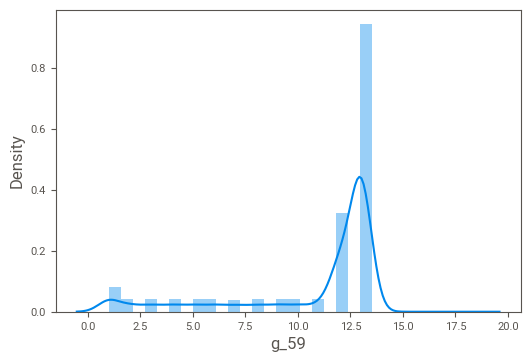

In [191]:
##show the histogram of the feature category after transformation
sns.distplot(miss_phyto_b_2['g_59'],bins=30 )
plt.show()

In [179]:
dfall_c.sort_values(ascending=False,by='perc').head(100)
dfall_c.index

Index(['chlorophyll_concentration', 'turbidity_units', 'temperature',
       'humidity', 'dewpoint', 'wind_direction', 'wind_speed', 'pressure',
       'BAROMETER', 'external_humidity_AvgVal', 'e_AvgVolt',
       'e_AvgLinearAdjVal', 'external_temperature_AvgVal', 'AvgVolt',
       'AvgLinearAdjVal', 'dominant_period', 'significant_height',
       'mean_period', 'north', 'east', 'magnitude_1', 'magnitude_2',
       'gustdirection', 'winddirection', 'Direction_DegM', 'East_cm_s',
       'Temperature_DegC', 'Heading_DegM', 'North_cm_s', 'Abs_Speed_cm_s',
       'Abs_Tilt_Deg', 'Strength_dB', 'Max_Tilt_Deg', 'Std_Tilt_Deg',
       'SP_Std_cm_s', 'Tilt_Y_Deg', 'Tilt_X_Deg', 'g_5', 'g_23', 'g_68',
       'temp_avg', 'depth_39', 'depth_69', 'depth_73', 'depth_15', 'depth_45',
       'depth_51', 'depth_3', 'depth_21', 'depth_23', 'depth_81', 'depth_11',
       'depth_41', 'depth_77', 'depth_35', 'depth_65', 'depth_49', 'depth_53',
       'depth_31', 'depth_59', 'depth_61', 'depth_27', 'depth_

In [202]:
#find the columns that their missing are less than 40%
miss_phyto_c=pd.DataFrame()
for indx, row in  dfall_c.iterrows():
    miss_phyto_c[indx]=miss_phyto_rows[indx]
    
miss_phyto_c


,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,wind_speed,pressure,BAROMETER,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgVolt,AvgLinearAdjVal,dominant_period,significant_height,mean_period,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,Direction_DegM,East_cm_s,Temperature_DegC,Heading_DegM,North_cm_s,Abs_Speed_cm_s,Abs_Tilt_Deg,Strength_dB,Max_Tilt_Deg,Std_Tilt_Deg,SP_Std_cm_s,Tilt_Y_Deg,Tilt_X_Deg,g_5,g_23,g_68,temp_avg,depth_39,depth_69,depth_73,depth_15,depth_45,depth_51,depth_3,depth_21,depth_23,depth_81,depth_11,depth_41,depth_77,depth_35,depth_65,depth_49,depth_53,depth_31,depth_59,depth_61,depth_27,depth_57,depth_13,depth_75,depth_47,depth_43,depth_29,depth_19,depth_17,depth_7,depth_37,depth_33,depth_25,depth_67,depth_63,depth_55,depth_5,depth_71,depth_9,depth_79,chl_pred
0,0.071,0.177,28.1,86.1,25.5,158.000,1.31,1004.9,1004.77,2396.0,0.851,85.104,2290.2,0.592,29.219,3.774,0.350,3.569,1.003,-1.398,1.721,2.459,312.268,305.642,354.116,-3.813,29.656,268.558,36.999,37.195,3.019,-23.242,6.658,1.341,15.587,2.111,-1.209,29.66,27.62,21.15,24.572,0.40,0.02,0.05,0.40,0.31,0.15,1.00,0.45,0.46,0.04,0.27,0.35,0.04,0.36,0.07,0.25,0.10,0.41,0.14,0.09,0.41,0.12,0.36,0.04,0.28,0.34,0.44,0.47,0.45,0.11,0.35,0.39,0.42,0.04,0.04,0.09,0.09,0.07,0.16,0.05,0.036
1,0.095,0.189,28.1,86.1,25.6,181.000,1.62,1005.0,1004.85,2395.4,0.849,84.860,2285.6,0.580,27.998,4.878,0.368,3.535,0.847,-1.376,1.616,2.176,300.039,301.608,359.196,-0.561,29.710,271.677,39.985,39.989,2.911,-23.277,5.848,1.299,14.462,1.981,-1.251,29.71,27.47,21.13,24.580,0.36,0.09,0.05,0.42,0.34,0.16,NaN,0.46,0.44,0.02,0.24,0.32,0.03,0.36,0.02,0.20,0.17,0.43,0.11,0.11,0.44,0.12,0.33,0.05,0.24,0.31,0.43,0.46,0.47,0.09,0.36,0.39,0.41,0.04,0.08,0.18,0.09,0.01,0.20,0.05,0.083
2,0.083,0.183,28.1,86.4,25.7,156.000,1.50,1005.0,1004.86,2395.6,0.849,84.860,2289.4,0.590,28.974,5.000,0.383,3.632,1.146,-1.358,1.777,2.635,319.648,310.163,357.789,-1.452,29.775,275.965,37.602,37.630,3.168,-23.103,5.827,1.266,13.411,2.221,-1.250,29.77,27.37,21.17,24.675,0.34,0.01,0.04,0.43,0.28,0.22,NaN,0.46,0.40,0.05,0.24,0.36,0.05,0.37,0.04,0.28,0.15,0.41,0.11,0.09,0.39,0.07,0.38,0.02,0.26,0.30,0.40,0.38,0.41,0.10,0.37,0.39,0.43,0.05,0.05,0.15,0.12,0.03,0.23,0.08,0.060
3,0.095,0.189,28.1,84.6,25.2,188.000,1.26,1005.2,1005.10,2396.8,0.851,85.104,2291.6,0.595,29.463,4.444,0.373,3.516,0.766,-1.555,1.733,2.225,296.202,296.223,358.542,-1.052,29.807,277.912,41.330,41.344,3.110,-22.739,7.250,1.349,12.593,2.145,-1.219,29.80,27.35,21.17,24.680,0.33,0.07,0.01,0.36,0.27,0.24,NaN,0.43,0.39,0.09,0.19,0.29,0.04,0.39,0.10,0.28,0.17,0.42,0.12,0.11,0.40,0.13,0.28,0.02,0.23,0.33,0.41,0.45,0.47,0.16,0.38,0.35,0.38,0.07,0.04,0.15,0.07,0.07,0.10,0.05,0.083
4,0.107,0.201,27.9,85.2,25.2,150.000,1.68,1005.3,1005.15,2391.4,0.839,83.883,2291.0,0.595,29.463,5.263,0.344,3.570,0.692,-1.262,1.439,2.008,296.420,298.723,356.702,-2.372,29.849,276.629,41.170,41.238,3.014,-22.449,6.186,1.233,11.526,2.222,-1.224,29.85,26.99,21.21,24.701,0.36,0.05,0.03,0.43,0.30,0.20,NaN,0.42,0.39,0.11,0.25,0.32,0.06,0.38,0.08,0.23,0.18,0.37,0.11,0.10,0.42,0.14,0.31,0.04,0.25,0.29,0.37,0.48,0.46,0.14,0.38,0.34,0.38,0.02,0.07,0.18,0.11,0.03,0.13,0.09,0.048
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19329,0.266,1.232,19.6,63.4,12.5,172.341,1.95,1020.1,1018.26,2305.2,0.629,62.882,2252.4,0.499,19.939,5.405,0.384,4.526,-1.956,0.398,1.996,2.895,198.453,168.506,20.699,3.625,23.768,246.939,9.594,10.256,4.981,-15.638,6.747,0.704,12.779,2.686,-4.143,23.95,23.91,23.30,23.833,NaN,NaN,NaN,NaN,NaN,NaN,0.63,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.21,NaN,Na

<AxesSubplot:>

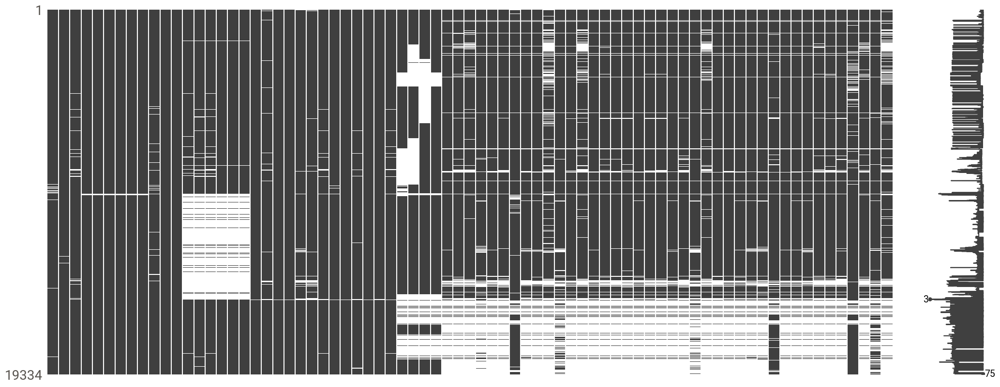

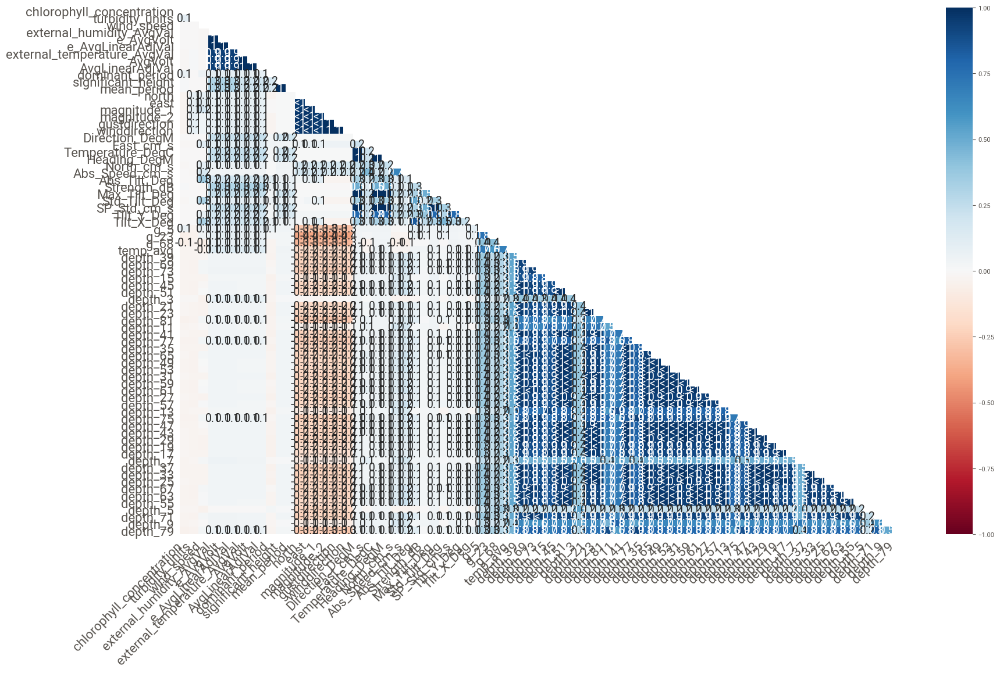

In [203]:
miss_phyto1 = miss_phyto_c.columns[miss_phyto_c.isnull().any()].tolist()
msno.matrix(miss_phyto_c[miss_phyto1])
msno.heatmap(miss_phyto_c)

### Missing that are less than 40% of the column

In [204]:
miss_phyto_c=pd.DataFrame(miss_phyto_c)
miss_phyto_c

,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,wind_speed,pressure,BAROMETER,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgVolt,AvgLinearAdjVal,dominant_period,significant_height,mean_period,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,Direction_DegM,East_cm_s,Temperature_DegC,Heading_DegM,North_cm_s,Abs_Speed_cm_s,Abs_Tilt_Deg,Strength_dB,Max_Tilt_Deg,Std_Tilt_Deg,SP_Std_cm_s,Tilt_Y_Deg,Tilt_X_Deg,g_5,g_23,g_68,temp_avg,depth_39,depth_69,depth_73,depth_15,depth_45,depth_51,depth_3,depth_21,depth_23,depth_81,depth_11,depth_41,depth_77,depth_35,depth_65,depth_49,depth_53,depth_31,depth_59,depth_61,depth_27,depth_57,depth_13,depth_75,depth_47,depth_43,depth_29,depth_19,depth_17,depth_7,depth_37,depth_33,depth_25,depth_67,depth_63,depth_55,depth_5,depth_71,depth_9,depth_79,chl_pred
0,0.071,0.177,28.1,86.1,25.5,158.000,1.31,1004.9,1004.77,2396.0,0.851,85.104,2290.2,0.592,29.219,3.774,0.350,3.569,1.003,-1.398,1.721,2.459,312.268,305.642,354.116,-3.813,29.656,268.558,36.999,37.195,3.019,-23.242,6.658,1.341,15.587,2.111,-1.209,29.66,27.62,21.15,24.572,0.40,0.02,0.05,0.40,0.31,0.15,1.00,0.45,0.46,0.04,0.27,0.35,0.04,0.36,0.07,0.25,0.10,0.41,0.14,0.09,0.41,0.12,0.36,0.04,0.28,0.34,0.44,0.47,0.45,0.11,0.35,0.39,0.42,0.04,0.04,0.09,0.09,0.07,0.16,0.05,0.036
1,0.095,0.189,28.1,86.1,25.6,181.000,1.62,1005.0,1004.85,2395.4,0.849,84.860,2285.6,0.580,27.998,4.878,0.368,3.535,0.847,-1.376,1.616,2.176,300.039,301.608,359.196,-0.561,29.710,271.677,39.985,39.989,2.911,-23.277,5.848,1.299,14.462,1.981,-1.251,29.71,27.47,21.13,24.580,0.36,0.09,0.05,0.42,0.34,0.16,NaN,0.46,0.44,0.02,0.24,0.32,0.03,0.36,0.02,0.20,0.17,0.43,0.11,0.11,0.44,0.12,0.33,0.05,0.24,0.31,0.43,0.46,0.47,0.09,0.36,0.39,0.41,0.04,0.08,0.18,0.09,0.01,0.20,0.05,0.083
2,0.083,0.183,28.1,86.4,25.7,156.000,1.50,1005.0,1004.86,2395.6,0.849,84.860,2289.4,0.590,28.974,5.000,0.383,3.632,1.146,-1.358,1.777,2.635,319.648,310.163,357.789,-1.452,29.775,275.965,37.602,37.630,3.168,-23.103,5.827,1.266,13.411,2.221,-1.250,29.77,27.37,21.17,24.675,0.34,0.01,0.04,0.43,0.28,0.22,NaN,0.46,0.40,0.05,0.24,0.36,0.05,0.37,0.04,0.28,0.15,0.41,0.11,0.09,0.39,0.07,0.38,0.02,0.26,0.30,0.40,0.38,0.41,0.10,0.37,0.39,0.43,0.05,0.05,0.15,0.12,0.03,0.23,0.08,0.060
3,0.095,0.189,28.1,84.6,25.2,188.000,1.26,1005.2,1005.10,2396.8,0.851,85.104,2291.6,0.595,29.463,4.444,0.373,3.516,0.766,-1.555,1.733,2.225,296.202,296.223,358.542,-1.052,29.807,277.912,41.330,41.344,3.110,-22.739,7.250,1.349,12.593,2.145,-1.219,29.80,27.35,21.17,24.680,0.33,0.07,0.01,0.36,0.27,0.24,NaN,0.43,0.39,0.09,0.19,0.29,0.04,0.39,0.10,0.28,0.17,0.42,0.12,0.11,0.40,0.13,0.28,0.02,0.23,0.33,0.41,0.45,0.47,0.16,0.38,0.35,0.38,0.07,0.04,0.15,0.07,0.07,0.10,0.05,0.083
4,0.107,0.201,27.9,85.2,25.2,150.000,1.68,1005.3,1005.15,2391.4,0.839,83.883,2291.0,0.595,29.463,5.263,0.344,3.570,0.692,-1.262,1.439,2.008,296.420,298.723,356.702,-2.372,29.849,276.629,41.170,41.238,3.014,-22.449,6.186,1.233,11.526,2.222,-1.224,29.85,26.99,21.21,24.701,0.36,0.05,0.03,0.43,0.30,0.20,NaN,0.42,0.39,0.11,0.25,0.32,0.06,0.38,0.08,0.23,0.18,0.37,0.11,0.10,0.42,0.14,0.31,0.04,0.25,0.29,0.37,0.48,0.46,0.14,0.38,0.34,0.38,0.02,0.07,0.18,0.11,0.03,0.13,0.09,0.048
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19329,0.266,1.232,19.6,63.4,12.5,172.341,1.95,1020.1,1018.26,2305.2,0.629,62.882,2252.4,0.499,19.939,5.405,0.384,4.526,-1.956,0.398,1.996,2.895,198.453,168.506,20.699,3.625,23.768,246.939,9.594,10.256,4.981,-15.638,6.747,0.704,12.779,2.686,-4.143,23.95,23.91,23.30,23.833,NaN,NaN,NaN,NaN,NaN,NaN,0.63,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.21,NaN,Na

In [205]:
miss_phyto_c_na=miss_phyto_c.copy()
miss_phyto_c_na

,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,wind_speed,pressure,BAROMETER,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgVolt,AvgLinearAdjVal,dominant_period,significant_height,mean_period,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,Direction_DegM,East_cm_s,Temperature_DegC,Heading_DegM,North_cm_s,Abs_Speed_cm_s,Abs_Tilt_Deg,Strength_dB,Max_Tilt_Deg,Std_Tilt_Deg,SP_Std_cm_s,Tilt_Y_Deg,Tilt_X_Deg,g_5,g_23,g_68,temp_avg,depth_39,depth_69,depth_73,depth_15,depth_45,depth_51,depth_3,depth_21,depth_23,depth_81,depth_11,depth_41,depth_77,depth_35,depth_65,depth_49,depth_53,depth_31,depth_59,depth_61,depth_27,depth_57,depth_13,depth_75,depth_47,depth_43,depth_29,depth_19,depth_17,depth_7,depth_37,depth_33,depth_25,depth_67,depth_63,depth_55,depth_5,depth_71,depth_9,depth_79,chl_pred
0,0.071,0.177,28.1,86.1,25.5,158.000,1.31,1004.9,1004.77,2396.0,0.851,85.104,2290.2,0.592,29.219,3.774,0.350,3.569,1.003,-1.398,1.721,2.459,312.268,305.642,354.116,-3.813,29.656,268.558,36.999,37.195,3.019,-23.242,6.658,1.341,15.587,2.111,-1.209,29.66,27.62,21.15,24.572,0.40,0.02,0.05,0.40,0.31,0.15,1.00,0.45,0.46,0.04,0.27,0.35,0.04,0.36,0.07,0.25,0.10,0.41,0.14,0.09,0.41,0.12,0.36,0.04,0.28,0.34,0.44,0.47,0.45,0.11,0.35,0.39,0.42,0.04,0.04,0.09,0.09,0.07,0.16,0.05,0.036
1,0.095,0.189,28.1,86.1,25.6,181.000,1.62,1005.0,1004.85,2395.4,0.849,84.860,2285.6,0.580,27.998,4.878,0.368,3.535,0.847,-1.376,1.616,2.176,300.039,301.608,359.196,-0.561,29.710,271.677,39.985,39.989,2.911,-23.277,5.848,1.299,14.462,1.981,-1.251,29.71,27.47,21.13,24.580,0.36,0.09,0.05,0.42,0.34,0.16,NaN,0.46,0.44,0.02,0.24,0.32,0.03,0.36,0.02,0.20,0.17,0.43,0.11,0.11,0.44,0.12,0.33,0.05,0.24,0.31,0.43,0.46,0.47,0.09,0.36,0.39,0.41,0.04,0.08,0.18,0.09,0.01,0.20,0.05,0.083
2,0.083,0.183,28.1,86.4,25.7,156.000,1.50,1005.0,1004.86,2395.6,0.849,84.860,2289.4,0.590,28.974,5.000,0.383,3.632,1.146,-1.358,1.777,2.635,319.648,310.163,357.789,-1.452,29.775,275.965,37.602,37.630,3.168,-23.103,5.827,1.266,13.411,2.221,-1.250,29.77,27.37,21.17,24.675,0.34,0.01,0.04,0.43,0.28,0.22,NaN,0.46,0.40,0.05,0.24,0.36,0.05,0.37,0.04,0.28,0.15,0.41,0.11,0.09,0.39,0.07,0.38,0.02,0.26,0.30,0.40,0.38,0.41,0.10,0.37,0.39,0.43,0.05,0.05,0.15,0.12,0.03,0.23,0.08,0.060
3,0.095,0.189,28.1,84.6,25.2,188.000,1.26,1005.2,1005.10,2396.8,0.851,85.104,2291.6,0.595,29.463,4.444,0.373,3.516,0.766,-1.555,1.733,2.225,296.202,296.223,358.542,-1.052,29.807,277.912,41.330,41.344,3.110,-22.739,7.250,1.349,12.593,2.145,-1.219,29.80,27.35,21.17,24.680,0.33,0.07,0.01,0.36,0.27,0.24,NaN,0.43,0.39,0.09,0.19,0.29,0.04,0.39,0.10,0.28,0.17,0.42,0.12,0.11,0.40,0.13,0.28,0.02,0.23,0.33,0.41,0.45,0.47,0.16,0.38,0.35,0.38,0.07,0.04,0.15,0.07,0.07,0.10,0.05,0.083
4,0.107,0.201,27.9,85.2,25.2,150.000,1.68,1005.3,1005.15,2391.4,0.839,83.883,2291.0,0.595,29.463,5.263,0.344,3.570,0.692,-1.262,1.439,2.008,296.420,298.723,356.702,-2.372,29.849,276.629,41.170,41.238,3.014,-22.449,6.186,1.233,11.526,2.222,-1.224,29.85,26.99,21.21,24.701,0.36,0.05,0.03,0.43,0.30,0.20,NaN,0.42,0.39,0.11,0.25,0.32,0.06,0.38,0.08,0.23,0.18,0.37,0.11,0.10,0.42,0.14,0.31,0.04,0.25,0.29,0.37,0.48,0.46,0.14,0.38,0.34,0.38,0.02,0.07,0.18,0.11,0.03,0.13,0.09,0.048
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19329,0.266,1.232,19.6,63.4,12.5,172.341,1.95,1020.1,1018.26,2305.2,0.629,62.882,2252.4,0.499,19.939,5.405,0.384,4.526,-1.956,0.398,1.996,2.895,198.453,168.506,20.699,3.625,23.768,246.939,9.594,10.256,4.981,-15.638,6.747,0.704,12.779,2.686,-4.143,23.95,23.91,23.30,23.833,NaN,NaN,NaN,NaN,NaN,NaN,0.63,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.21,NaN,Na

In [206]:
#change the null to 0 and 1
for i in miss_phyto_c_na.columns:
    miss_phyto_c_na[i]=np.where(miss_phyto_c_na[i].isnull(),1,0)
miss_phyto_c_na

,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,wind_speed,pressure,BAROMETER,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgVolt,AvgLinearAdjVal,dominant_period,significant_height,mean_period,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,Direction_DegM,East_cm_s,Temperature_DegC,Heading_DegM,North_cm_s,Abs_Speed_cm_s,Abs_Tilt_Deg,Strength_dB,Max_Tilt_Deg,Std_Tilt_Deg,SP_Std_cm_s,Tilt_Y_Deg,Tilt_X_Deg,g_5,g_23,g_68,temp_avg,depth_39,depth_69,depth_73,depth_15,depth_45,depth_51,depth_3,depth_21,depth_23,depth_81,depth_11,depth_41,depth_77,depth_35,depth_65,depth_49,depth_53,depth_31,depth_59,depth_61,depth_27,depth_57,depth_13,depth_75,depth_47,depth_43,depth_29,depth_19,depth_17,depth_7,depth_37,depth_33,depth_25,depth_67,depth_63,depth_55,depth_5,depth_71,depth_9,depth_79,chl_pred
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19329,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,1,1,1,1,1,1,0,1,1,1,0
19330,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,1,1,1,1,1,1,0,1,1,1,0
19331,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,1,1,1,1,1,1,0,1,0,1,0
19332,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,1,1,1,1,1,1,0,1,0,1,0


In [207]:
miss_phyto_c_na.describe()

,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,wind_speed,pressure,BAROMETER,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgVolt,AvgLinearAdjVal,dominant_period,significant_height,mean_period,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,Direction_DegM,East_cm_s,Temperature_DegC,Heading_DegM,North_cm_s,Abs_Speed_cm_s,Abs_Tilt_Deg,Strength_dB,Max_Tilt_Deg,Std_Tilt_Deg,SP_Std_cm_s,Tilt_Y_Deg,Tilt_X_Deg,g_5,g_23,g_68,temp_avg,depth_39,depth_69,depth_73,depth_15,depth_45,depth_51,depth_3,depth_21,depth_23,depth_81,depth_11,depth_41,depth_77,depth_35,depth_65,depth_49,depth_53,depth_31,depth_59,depth_61,depth_27,depth_57,depth_13,depth_75,depth_47,depth_43,depth_29,depth_19,depth_17,depth_7,depth_37,depth_33,depth_25,depth_67,depth_63,depth_55,depth_5,depth_71,depth_9,depth_79,chl_pred
count,19334.000000,19334.000000,19334.0,19334.0,19334.0,19334.0,19334.000000,19334.0,19334.0,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.00000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.0
mean,0.015879,0.003569,0.0,0.0,0.0,0.0,0.021051,0.0,0.0,0.004293,0.004293,0.004293,0.004086,0.004086,0.004086,0.018930,0.000569,0.000569,0.283904,0.285714,0.292024,0.274077,0.274077,0.274077,0.001190,0.025344,0.001190,0.001190,0.021672,0.030258,0.012000,0.005017,0.001190,0.010707,0.001190,0.001914,0.012569,0.297714,0.383935,0.317110,0.179632,0.231975,0.253440,0.264663,0.232647,0.236681,0.241854,0.088756,0.232957,0.229699,0.363712,0.194062,0.230061,0.299059,0.228871,0.245267,0.240147,0.240302,0.229596,0.242630,0.243664,0.228613,0.247595,0.218992,0.280852,0.234819,0.230578,0.229337,0.232182,0.236681,0.111875,0.227785,0.229233,0.231458,0.24894,0.243612,0.248681,0.122116,0.259646,0.150460,0.325023,0.0
std,0.125010,0.059635,0.0,0.0,0.0,0.0,0.143558,0.0,0.0,0.065382,0.065382,0.065382,0.063793,0.063793,0.063793,0.136283,0.023846,0.023846,0.450902,0.451766,0.454705,0.446059,0.446059,0.446059,0.034471,0.157172,0.034471,0.034471,0.145613,0.171300,0.108886,0.070655,0.034471,0.102920,0.034471,0.043705,0.111406,0.457265,0.486355,0.465363,0.383890,0.422104,0.434992,0.441165,0.422530,0.425056,0.428217,0.284398,0.422726,0.420650,0.481079,0.395487,0.420883,0.457857,0.420117,0.430257,0.427184,0.427278,0.420584,0.428684,0.429303,0.419950,0.431626,0.413574,0.449427,0.423897,0.421214,0.420417,0.422235,0.425056,0.315221,0.419414,0.420351,0.421775,0.43241,0.429272,0.432260,0.327429,0.438452,0.357531,0.468396,0.0
min,0.000000,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.00000

In [208]:
miss_phyto_c_na_rm = miss_phyto_c_na.replace(1,np.nan)
miss_phyto_c_na_rm
miss_phyto_c_na_rm.describe(include='all')

,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,wind_speed,pressure,BAROMETER,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgVolt,AvgLinearAdjVal,dominant_period,significant_height,mean_period,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,Direction_DegM,East_cm_s,Temperature_DegC,Heading_DegM,North_cm_s,Abs_Speed_cm_s,Abs_Tilt_Deg,Strength_dB,Max_Tilt_Deg,Std_Tilt_Deg,SP_Std_cm_s,Tilt_Y_Deg,Tilt_X_Deg,g_5,g_23,g_68,temp_avg,depth_39,depth_69,depth_73,depth_15,depth_45,depth_51,depth_3,depth_21,depth_23,depth_81,depth_11,depth_41,depth_77,depth_35,depth_65,depth_49,depth_53,depth_31,depth_59,depth_61,depth_27,depth_57,depth_13,depth_75,depth_47,depth_43,depth_29,depth_19,depth_17,depth_7,depth_37,depth_33,depth_25,depth_67,depth_63,depth_55,depth_5,depth_71,depth_9,depth_79,chl_pred
count,19027.0,19265.0,19334.0,19334.0,19334.0,19334.0,18927.0,19334.0,19334.0,19251.0,19251.0,19251.0,19255.0,19255.0,19255.0,18968.0,19323.0,19323.0,13845.0,13810.0,13688.0,14035.0,14035.0,14035.0,19311.0,18844.0,19311.0,19311.0,18915.0,18749.0,19102.0,19237.0,19311.0,19127.0,19311.0,19297.0,19091.0,13578.0,11911.0,13203.0,15861.0,14849.0,14434.0,14217.0,14836.0,14758.0,14658.0,17618.0,14830.0,14893.0,12302.0,15582.0,14886.0,13552.0,14909.0,14592.0,14691.0,14688.0,14895.0,14643.0,14623.0,14914.0,14547.0,15100.0,13904.0,14794.0,14876.0,14900.0,14845.0,14758.0,17171.0,14930.0,14902.0,14859.0,14521.0,14624.0,14526.0,16973.0,14314.0,16425.0,13050.0,19334.0
mean,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
std,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
min,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
25%,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
50%,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
75%,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
max,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [209]:
##check if df has been changed properly
miss_phyto_c_na.describe(include='all')

,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,wind_speed,pressure,BAROMETER,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgVolt,AvgLinearAdjVal,dominant_period,significant_height,mean_period,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,Direction_DegM,East_cm_s,Temperature_DegC,Heading_DegM,North_cm_s,Abs_Speed_cm_s,Abs_Tilt_Deg,Strength_dB,Max_Tilt_Deg,Std_Tilt_Deg,SP_Std_cm_s,Tilt_Y_Deg,Tilt_X_Deg,g_5,g_23,g_68,temp_avg,depth_39,depth_69,depth_73,depth_15,depth_45,depth_51,depth_3,depth_21,depth_23,depth_81,depth_11,depth_41,depth_77,depth_35,depth_65,depth_49,depth_53,depth_31,depth_59,depth_61,depth_27,depth_57,depth_13,depth_75,depth_47,depth_43,depth_29,depth_19,depth_17,depth_7,depth_37,depth_33,depth_25,depth_67,depth_63,depth_55,depth_5,depth_71,depth_9,depth_79,chl_pred
count,19334.000000,19334.000000,19334.0,19334.0,19334.0,19334.0,19334.000000,19334.0,19334.0,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.00000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.0
mean,0.015879,0.003569,0.0,0.0,0.0,0.0,0.021051,0.0,0.0,0.004293,0.004293,0.004293,0.004086,0.004086,0.004086,0.018930,0.000569,0.000569,0.283904,0.285714,0.292024,0.274077,0.274077,0.274077,0.001190,0.025344,0.001190,0.001190,0.021672,0.030258,0.012000,0.005017,0.001190,0.010707,0.001190,0.001914,0.012569,0.297714,0.383935,0.317110,0.179632,0.231975,0.253440,0.264663,0.232647,0.236681,0.241854,0.088756,0.232957,0.229699,0.363712,0.194062,0.230061,0.299059,0.228871,0.245267,0.240147,0.240302,0.229596,0.242630,0.243664,0.228613,0.247595,0.218992,0.280852,0.234819,0.230578,0.229337,0.232182,0.236681,0.111875,0.227785,0.229233,0.231458,0.24894,0.243612,0.248681,0.122116,0.259646,0.150460,0.325023,0.0
std,0.125010,0.059635,0.0,0.0,0.0,0.0,0.143558,0.0,0.0,0.065382,0.065382,0.065382,0.063793,0.063793,0.063793,0.136283,0.023846,0.023846,0.450902,0.451766,0.454705,0.446059,0.446059,0.446059,0.034471,0.157172,0.034471,0.034471,0.145613,0.171300,0.108886,0.070655,0.034471,0.102920,0.034471,0.043705,0.111406,0.457265,0.486355,0.465363,0.383890,0.422104,0.434992,0.441165,0.422530,0.425056,0.428217,0.284398,0.422726,0.420650,0.481079,0.395487,0.420883,0.457857,0.420117,0.430257,0.427184,0.427278,0.420584,0.428684,0.429303,0.419950,0.431626,0.413574,0.449427,0.423897,0.421214,0.420417,0.422235,0.425056,0.315221,0.419414,0.420351,0.421775,0.43241,0.429272,0.432260,0.327429,0.438452,0.357531,0.468396,0.0
min,0.000000,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.00000

In [210]:
from scipy.stats import ks_2samp
from scipy import stats

In [211]:
##KS test to test if those missing are MAR
from scipy import stats
ks_na=[]
for a in miss_phyto_c_na.columns:
    for b in miss_phyto_c_na_rm.columns:
        try:
            dict={}
            test = stats.ks_2samp(miss_phyto_c_na[a],miss_phyto_c_na_rm[b])
            dict['names']=a
            dict['namesb']=b
            dict['stat']=test.statistic
            dict['pval']=test.pvalue
            ks_na.append(dict)
        except FloatingPointError:
            print('error')
ks_na=pd.DataFrame(ks_na) 

error
error
error
error
error
error
error
error
error
error
error


In [212]:
ks_na

,names,namesb,stat,pval
0,chlorophyll_concentration,chlorophyll_concentration,0.015879,1.511027e-02
1,chlorophyll_concentration,turbidity_units,0.012310,1.059275e-01
2,chlorophyll_concentration,temperature,0.015879,1.511027e-02
3,chlorophyll_concentration,humidity,0.015879,1.511027e-02
4,chlorophyll_concentration,dewpoint,0.015879,1.511027e-02
...,...,...,...,...
6708,chl_pred,depth_5,0.122116,4.321602e-126
6709,chl_pred,depth_71,0.259646,0.000000e+00
6710,chl_pred,depth_9,0.150460,1.612941e-191
6711,chl_pred,depth_79,0.325023,0.000000e+00


In [250]:
ks_na2=ks_na.copy()

In [214]:
#keep only the pvalue between the same features. 
ks_na3=ks_na2.loc[(ks_na2.names==ks_na2.namesb)] #& (ot2.pval<0.05)] 
ks_na3.sort_values(ascending=False,by='pval').head(100)

,names,namesb,stat,pval
6712,chl_pred,chl_pred,0.000000,1.000000e+00
659,BAROMETER,BAROMETER,0.000000,1.000000e+00
1981,Direction_DegM,Direction_DegM,0.001190,1.000000e+00
2645,Max_Tilt_Deg,Max_Tilt_Deg,0.001190,1.000000e+00
2811,SP_Std_cm_s,SP_Std_cm_s,0.001190,1.000000e+00
1400,mean_period,mean_period,0.000569,1.000000e+00
1317,significant_height,significant_height,0.000569,1.000000e+00
2147,Temperature_DegC,Temperature_DegC,0.001190,1.000000e+00
2230,Heading_DegM,Heading_DegM,0.001190,1.000000e+00
410,wind_direction,wind_direction,0.000000,1.000000e+00


In [251]:
#MNAR (we changed the cut off to 0.01 to remove the chlorophyl concentration from the list)
ks_na3a=ks_na3.loc[(ks_na3.pval<=0.01)]
ks_na3a

,names,namesb,stat,pval
493,wind_speed,wind_speed,0.021051,3.747349e-04
1234,dominant_period,dominant_period,0.018930,1.933571e-03
1483,north,north,0.283904,0.000000e+00
1566,east,east,0.285714,0.000000e+00
1649,magnitude_1,magnitude_1,0.292024,0.000000e+00
1732,magnitude_2,magnitude_2,0.274077,0.000000e+00
1815,gustdirection,gustdirection,0.274077,0.000000e+00
1898,winddirection,winddirection,0.274077,0.000000e+00
2064,East_cm_s,East_cm_s,0.025344,7.938573e-06
2313,North_cm_s,North_cm_s,0.021672,2.243126e-04


In [252]:
ks_na3_imp=ks_na3.loc[(ks_na3.pval>0.01)]
ks_na3_imp

,names,namesb,stat,pval
0,chlorophyll_concentration,chlorophyll_concentration,0.015879,0.015110
83,turbidity_units,turbidity_units,0.003569,0.999652
161,temperature,temperature,0.000000,1.000000
244,humidity,humidity,0.000000,1.000000
327,dewpoint,dewpoint,0.000000,1.000000
410,wind_direction,wind_direction,0.000000,1.000000
576,pressure,pressure,0.000000,1.000000
659,BAROMETER,BAROMETER,0.000000,1.000000
742,external_humidity_AvgVal,external_humidity_AvgVal,0.004293,0.993857
824,e_AvgVolt,e_AvgVolt,0.004293,0.993857


In [253]:
ks_na3a.index=ks_na3a.names
ks_na3a

,names,namesb,stat,pval
names,,,,
wind_speed,wind_speed,wind_speed,0.021051,3.747349e-04
dominant_period,dominant_period,dominant_period,0.018930,1.933571e-03
north,north,north,0.283904,0.000000e+00
east,east,east,0.285714,0.000000e+00
magnitude_1,magnitude_1,magnitude_1,0.292024,0.000000e+00
magnitude_2,magnitude_2,magnitude_2,0.274077,0.000000e+00
gustdirection,gustdirection,gustdirection,0.274077,0.000000e+00
winddirection,winddirection,winddirection,0.274077,0.000000e+00
East_cm_s,East_cm_s,East_cm_s,0.025344,7.938573e-06


In [254]:
miss_phyto_c


,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,wind_speed,pressure,BAROMETER,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgVolt,AvgLinearAdjVal,dominant_period,significant_height,mean_period,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,Direction_DegM,East_cm_s,Temperature_DegC,Heading_DegM,North_cm_s,Abs_Speed_cm_s,Abs_Tilt_Deg,Strength_dB,Max_Tilt_Deg,Std_Tilt_Deg,SP_Std_cm_s,Tilt_Y_Deg,Tilt_X_Deg,g_5,g_23,g_68,temp_avg,depth_39,depth_69,depth_73,depth_15,depth_45,depth_51,depth_3,depth_21,depth_23,depth_81,depth_11,depth_41,depth_77,depth_35,depth_65,depth_49,depth_53,depth_31,depth_59,depth_61,depth_27,depth_57,depth_13,depth_75,depth_47,depth_43,depth_29,depth_19,depth_17,depth_7,depth_37,depth_33,depth_25,depth_67,depth_63,depth_55,depth_5,depth_71,depth_9,depth_79,chl_pred
0,0.071,0.177,28.1,86.1,25.5,158.000,1.31,1004.9,1004.77,2396.0,0.851,85.104,2290.2,0.592,29.219,3.774,0.350,3.569,1.003,-1.398,1.721,2.459,312.268,305.642,354.116,-3.813,29.656,268.558,36.999,37.195,3.019,-23.242,6.658,1.341,15.587,2.111,-1.209,29.66,27.62,21.15,24.572,0.40,0.02,0.05,0.40,0.31,0.15,1.00,0.45,0.46,0.04,0.27,0.35,0.04,0.36,0.07,0.25,0.10,0.41,0.14,0.09,0.41,0.12,0.36,0.04,0.28,0.34,0.44,0.47,0.45,0.11,0.35,0.39,0.42,0.04,0.04,0.09,0.09,0.07,0.16,0.05,0.036
1,0.095,0.189,28.1,86.1,25.6,181.000,1.62,1005.0,1004.85,2395.4,0.849,84.860,2285.6,0.580,27.998,4.878,0.368,3.535,0.847,-1.376,1.616,2.176,300.039,301.608,359.196,-0.561,29.710,271.677,39.985,39.989,2.911,-23.277,5.848,1.299,14.462,1.981,-1.251,29.71,27.47,21.13,24.580,0.36,0.09,0.05,0.42,0.34,0.16,NaN,0.46,0.44,0.02,0.24,0.32,0.03,0.36,0.02,0.20,0.17,0.43,0.11,0.11,0.44,0.12,0.33,0.05,0.24,0.31,0.43,0.46,0.47,0.09,0.36,0.39,0.41,0.04,0.08,0.18,0.09,0.01,0.20,0.05,0.083
2,0.083,0.183,28.1,86.4,25.7,156.000,1.50,1005.0,1004.86,2395.6,0.849,84.860,2289.4,0.590,28.974,5.000,0.383,3.632,1.146,-1.358,1.777,2.635,319.648,310.163,357.789,-1.452,29.775,275.965,37.602,37.630,3.168,-23.103,5.827,1.266,13.411,2.221,-1.250,29.77,27.37,21.17,24.675,0.34,0.01,0.04,0.43,0.28,0.22,NaN,0.46,0.40,0.05,0.24,0.36,0.05,0.37,0.04,0.28,0.15,0.41,0.11,0.09,0.39,0.07,0.38,0.02,0.26,0.30,0.40,0.38,0.41,0.10,0.37,0.39,0.43,0.05,0.05,0.15,0.12,0.03,0.23,0.08,0.060
3,0.095,0.189,28.1,84.6,25.2,188.000,1.26,1005.2,1005.10,2396.8,0.851,85.104,2291.6,0.595,29.463,4.444,0.373,3.516,0.766,-1.555,1.733,2.225,296.202,296.223,358.542,-1.052,29.807,277.912,41.330,41.344,3.110,-22.739,7.250,1.349,12.593,2.145,-1.219,29.80,27.35,21.17,24.680,0.33,0.07,0.01,0.36,0.27,0.24,NaN,0.43,0.39,0.09,0.19,0.29,0.04,0.39,0.10,0.28,0.17,0.42,0.12,0.11,0.40,0.13,0.28,0.02,0.23,0.33,0.41,0.45,0.47,0.16,0.38,0.35,0.38,0.07,0.04,0.15,0.07,0.07,0.10,0.05,0.083
4,0.107,0.201,27.9,85.2,25.2,150.000,1.68,1005.3,1005.15,2391.4,0.839,83.883,2291.0,0.595,29.463,5.263,0.344,3.570,0.692,-1.262,1.439,2.008,296.420,298.723,356.702,-2.372,29.849,276.629,41.170,41.238,3.014,-22.449,6.186,1.233,11.526,2.222,-1.224,29.85,26.99,21.21,24.701,0.36,0.05,0.03,0.43,0.30,0.20,NaN,0.42,0.39,0.11,0.25,0.32,0.06,0.38,0.08,0.23,0.18,0.37,0.11,0.10,0.42,0.14,0.31,0.04,0.25,0.29,0.37,0.48,0.46,0.14,0.38,0.34,0.38,0.02,0.07,0.18,0.11,0.03,0.13,0.09,0.048
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19329,0.266,1.232,19.6,63.4,12.5,172.341,1.95,1020.1,1018.26,2305.2,0.629,62.882,2252.4,0.499,19.939,5.405,0.384,4.526,-1.956,0.398,1.996,2.895,198.453,168.506,20.699,3.625,23.768,246.939,9.594,10.256,4.981,-15.638,6.747,0.704,12.779,2.686,-4.143,23.95,23.91,23.30,23.833,NaN,NaN,NaN,NaN,NaN,NaN,0.63,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.21,NaN,Na

In [255]:
##create df from the variables that their missings have ks with pval  < 0.05
miss_phyto_c_2=pd.DataFrame()
for indx, row in  ks_na3a.iterrows():
    miss_phyto_c_2[indx]=miss_phyto_c[indx]
    
miss_phyto_c_2

,wind_speed,dominant_period,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,East_cm_s,North_cm_s,Abs_Speed_cm_s,g_5,g_23,g_68,temp_avg,depth_39,depth_69,depth_73,depth_15,depth_45,depth_51,depth_3,depth_21,depth_23,depth_81,depth_11,depth_41,depth_77,depth_35,depth_65,depth_49,depth_53,depth_31,depth_59,depth_61,depth_27,depth_57,depth_13,depth_75,depth_47,depth_43,depth_29,depth_19,depth_17,depth_7,depth_37,depth_33,depth_25,depth_67,depth_63,depth_55,depth_5,depth_71,depth_9,depth_79
0,1.31,3.774,1.003,-1.398,1.721,2.459,312.268,305.642,-3.813,36.999,37.195,29.66,27.62,21.15,24.572,0.40,0.02,0.05,0.40,0.31,0.15,1.00,0.45,0.46,0.04,0.27,0.35,0.04,0.36,0.07,0.25,0.10,0.41,0.14,0.09,0.41,0.12,0.36,0.04,0.28,0.34,0.44,0.47,0.45,0.11,0.35,0.39,0.42,0.04,0.04,0.09,0.09,0.07,0.16,0.05
1,1.62,4.878,0.847,-1.376,1.616,2.176,300.039,301.608,-0.561,39.985,39.989,29.71,27.47,21.13,24.580,0.36,0.09,0.05,0.42,0.34,0.16,NaN,0.46,0.44,0.02,0.24,0.32,0.03,0.36,0.02,0.20,0.17,0.43,0.11,0.11,0.44,0.12,0.33,0.05,0.24,0.31,0.43,0.46,0.47,0.09,0.36,0.39,0.41,0.04,0.08,0.18,0.09,0.01,0.20,0.05
2,1.50,5.000,1.146,-1.358,1.777,2.635,319.648,310.163,-1.452,37.602,37.630,29.77,27.37,21.17,24.675,0.34,0.01,0.04,0.43,0.28,0.22,NaN,0.46,0.40,0.05,0.24,0.36,0.05,0.37,0.04,0.28,0.15,0.41,0.11,0.09,0.39,0.07,0.38,0.02,0.26,0.30,0.40,0.38,0.41,0.10,0.37,0.39,0.43,0.05,0.05,0.15,0.12,0.03,0.23,0.08
3,1.26,4.444,0.766,-1.555,1.733,2.225,296.202,296.223,-1.052,41.330,41.344,29.80,27.35,21.17,24.680,0.33,0.07,0.01,0.36,0.27,0.24,NaN,0.43,0.39,0.09,0.19,0.29,0.04,0.39,0.10,0.28,0.17,0.42,0.12,0.11,0.40,0.13,0.28,0.02,0.23,0.33,0.41,0.45,0.47,0.16,0.38,0.35,0.38,0.07,0.04,0.15,0.07,0.07,0.10,0.05
4,1.68,5.263,0.692,-1.262,1.439,2.008,296.420,298.723,-2.372,41.170,41.238,29.85,26.99,21.21,24.701,0.36,0.05,0.03,0.43,0.30,0.20,NaN,0.42,0.39,0.11,0.25,0.32,0.06,0.38,0.08,0.23,0.18,0.37,0.11,0.10,0.42,0.14,0.31,0.04,0.25,0.29,0.37,0.48,0.46,0.14,0.38,0.34,0.38,0.02,0.07,0.18,0.11,0.03,0.13,0.09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19329,1.95,5.405,-1.956,0.398,1.996,2.895,198.453,168.506,3.625,9.594,10.256,23.95,23.91,23.30,23.833,NaN,NaN,NaN,NaN,NaN,NaN,0.63,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.21,NaN,NaN,NaN,NaN,NaN,NaN,0.13,NaN,NaN,NaN
19330,3.92,5.882,-2.007,1.199,2.338,3.192,156.484,149.150,6.476,13.714,15.166,24.01,23.93,23.79,23.917,NaN,NaN,NaN,NaN,NaN,NaN,0.49,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.19,NaN,NaN,NaN,NaN,NaN,NaN,0.10,NaN,NaN,NaN
19331,3.36,6.250,-4.289,0.336,4.302,5.225,173.876,175.521,4.597,5.300,7.016,24.05,23.94,23.46,23.880,NaN,NaN,NaN,NaN,NaN,NaN,0.30,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.16,NaN,NaN,NaN,NaN,NaN,NaN,0.11,NaN,0.17,NaN
19332,1.72,6.250,0.725,1.581,1.739,2.258,62.158,65.385,7.792,18.632,20.196,24.07,23.93,23.44,23.887,NaN,NaN,NaN,NaN,NaN,NaN,0.21,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.13,NaN,NaN,NaN,NaN,NaN,NaN,0.09,NaN,0.14,NaN


<AxesSubplot:>

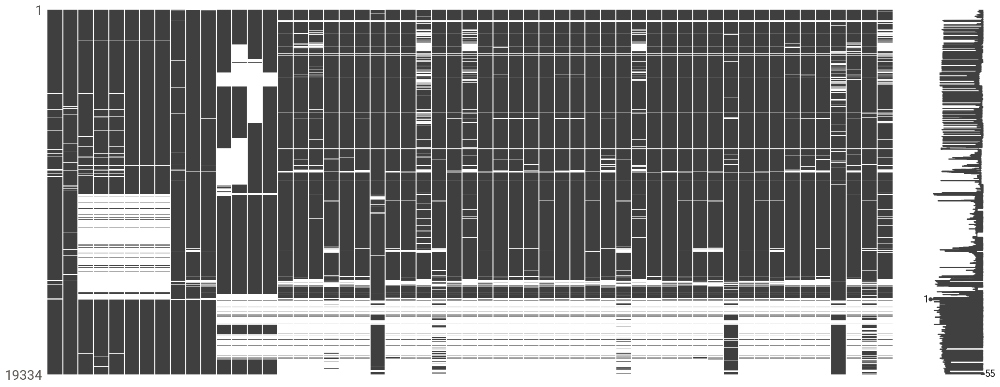

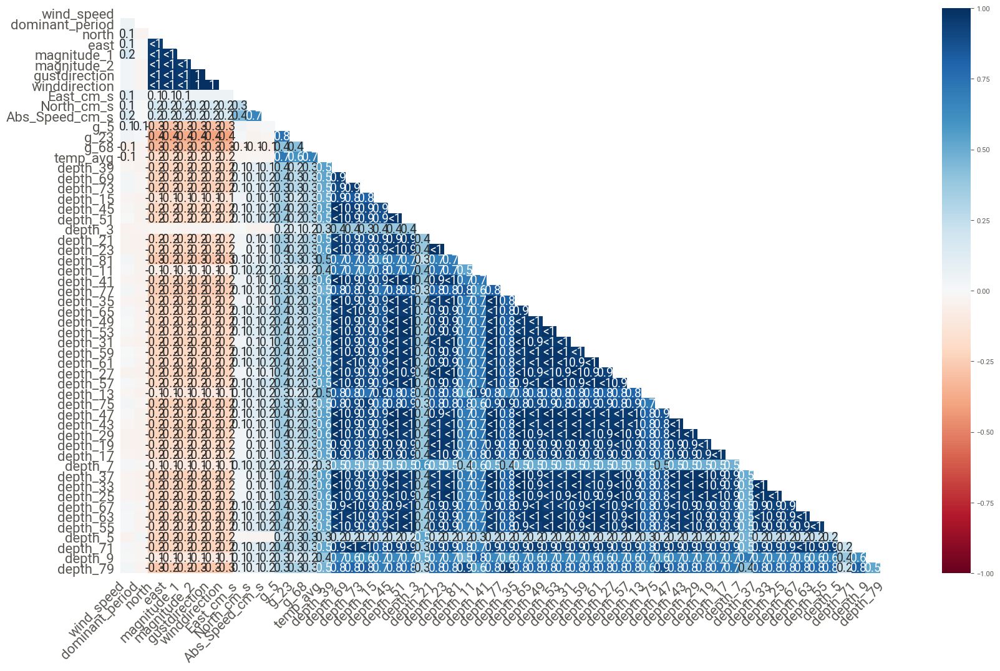

In [220]:
miss_phyto_c_2b = miss_phyto_c_2.columns[miss_phyto_c_2.isnull().any()].tolist()
msno.matrix(miss_phyto_c_2[miss_phyto_c_2b])
msno.heatmap(miss_phyto_c_2)

In [256]:
for i in miss_phyto_c_2.columns:
    if miss_phyto_c_2[i].skew()> 0.5:
        Q1 = miss_phyto_c_2[i].quantile(0.1)
        Q2 = miss_phyto_c_2[i].quantile(0.15)
        Q3 = miss_phyto_c_2[i].quantile(0.2)
        Q4 = miss_phyto_c_2[i].quantile(0.25)
        Q5 = miss_phyto_c_2[i].quantile(0.3)
        Q6 = miss_phyto_c_2[i].quantile(0.35)
        Q7 = miss_phyto_c_2[i].quantile(0.4)
        Q8 = miss_phyto_c_2[i].quantile(0.45)
        Q9 = miss_phyto_c_2[i].quantile(0.5)
        Q10 = miss_phyto_c_2[i].quantile(0.55)
        Q11 = miss_phyto_c_2[i].quantile(0.6)
        Q12 = miss_phyto_c_2[i].quantile(0.65)
        Q13 = miss_phyto_c_2[i].quantile(0.7)
        Q14 = miss_phyto_c_2[i].quantile(0.8)
        Q15 = miss_phyto_c_2[i].quantile(0.9)
 
        miss_phyto_c_2[i]=np.where((miss_phyto_c_2[i]<Q1),1,miss_phyto_c_2[i])
        miss_phyto_c_2[i]=np.where(((miss_phyto_c_2[i]>Q1) & (miss_phyto_c_2[i]<=Q2)),2,miss_phyto_c_2[i])
        miss_phyto_c_2[i]=np.where(((miss_phyto_c_2[i]>Q2) & (miss_phyto_c_2[i]<=Q3)),3,miss_phyto_c_2[i])
        miss_phyto_c_2[i]=np.where(((miss_phyto_c_2[i]>Q3) & (miss_phyto_c_2[i]<=Q4)),4,miss_phyto_c_2[i])
        miss_phyto_c_2[i]=np.where(((miss_phyto_c_2[i]>Q4) & (miss_phyto_c_2[i]<=Q5)),5,miss_phyto_c_2[i])
        miss_phyto_c_2[i]=np.where(((miss_phyto_c_2[i]>Q5) & (miss_phyto_c_2[i]<=Q6)),6,miss_phyto_c_2[i])
        miss_phyto_c_2[i]=np.where(((miss_phyto_c_2[i]>Q6) & (miss_phyto_c_2[i]<=Q7)),7,miss_phyto_c_2[i])
        miss_phyto_c_2[i]=np.where(((miss_phyto_c_2[i]>Q7) & (miss_phyto_c_2[i]<=Q8)),8,miss_phyto_c_2[i])
        miss_phyto_c_2[i]=np.where(((miss_phyto_c_2[i]>Q8) & (miss_phyto_c_2[i]<=Q9)),9,miss_phyto_c_2[i])   
        miss_phyto_c_2[i]=np.where(((miss_phyto_c_2[i]>Q9) & (miss_phyto_c_2[i]<=Q10)),10,miss_phyto_c_2[i]) 
        miss_phyto_c_2[i]=np.where(((miss_phyto_c_2[i]>Q10) & (miss_phyto_c_2[i]<=Q11)),11,miss_phyto_c_2[i]) 
        miss_phyto_c_2[i]=np.where(((miss_phyto_c_2[i]>Q11) & (miss_phyto_c_2[i]<=Q12)),12,miss_phyto_c_2[i]) 
        miss_phyto_c_2[i]=np.where(((miss_phyto_c_2[i]>Q12) & (miss_phyto_c_2[i]<=Q13)),13,miss_phyto_c_2[i])    
        miss_phyto_c_2[i]=np.where(((miss_phyto_c_2[i]>Q13) & (miss_phyto_c_2[i]<=Q14)),14,miss_phyto_c_2[i])
        miss_phyto_c_2[i]=np.where(((miss_phyto_c_2[i]>Q14) & (miss_phyto_c_2[i]<=Q15)),15,miss_phyto_c_2[i])
        miss_phyto_c_2[i]=np.where((miss_phyto_c_2[i]>Q15),16,miss_phyto_c_2[i])
        
        miss_phyto_c_2[i]=np.where((miss_phyto_c_2[i].isnull()),'m',miss_phyto_c_2[i])
    
    else:
        Q1 = miss_phyto_c_2[i].quantile(0.1)
        Q2 = miss_phyto_c_2[i].quantile(0.2)
        Q3 = miss_phyto_c_2[i].quantile(0.3)
        Q4 = miss_phyto_c_2[i].quantile(0.4)
        Q5 = miss_phyto_c_2[i].quantile(0.5)
        Q6 = miss_phyto_c_2[i].quantile(0.6)
        Q7 = miss_phyto_c_2[i].quantile(0.7)
        Q8 = miss_phyto_c_2[i].quantile(0.8)
        Q9 = miss_phyto_c_2[i].quantile(0.9)
        Q10 = miss_phyto_c_2[i].quantile(1)

        miss_phyto_c_2[i]=np.where((miss_phyto_c_2[i]<Q1),1,miss_phyto_c_2[i])
        miss_phyto_c_2[i]=np.where(((miss_phyto_c_2[i]>Q1) & (miss_phyto_c_2[i]<=Q2)),2,miss_phyto_c_2[i])
        miss_phyto_c_2[i]=np.where(((miss_phyto_c_2[i]>Q2) & (miss_phyto_c_2[i]<=Q3)),3,miss_phyto_c_2[i])
        miss_phyto_c_2[i]=np.where(((miss_phyto_c_2[i]>Q3) & (miss_phyto_c_2[i]<=Q4)),4,miss_phyto_c_2[i])
        miss_phyto_c_2[i]=np.where(((miss_phyto_c_2[i]>Q4) & (miss_phyto_c_2[i]<=Q5)),5,miss_phyto_c_2[i])
        miss_phyto_c_2[i]=np.where(((miss_phyto_c_2[i]>Q5) & (miss_phyto_c_2[i]<=Q6)),6,miss_phyto_c_2[i])
        miss_phyto_c_2[i]=np.where(((miss_phyto_c_2[i]>Q6) & (miss_phyto_c_2[i]<=Q7)),7,miss_phyto_c_2[i])
        miss_phyto_c_2[i]=np.where(((miss_phyto_c_2[i]>Q7) & (miss_phyto_c_2[i]<=Q8)),8,miss_phyto_c_2[i])
        miss_phyto_c_2[i]=np.where(((miss_phyto_c_2[i]>Q8) & (miss_phyto_c_2[i]<=Q9)),9,miss_phyto_c_2[i])   
        miss_phyto_c_2[i]=np.where((miss_phyto_c_2[i]>Q9),10,miss_phyto_c_2[i])
        miss_phyto_c_2[i]=np.where((miss_phyto_c_2[i].isnull()),'m',miss_phyto_c_2[i])
miss_phyto_c_2

,wind_speed,dominant_period,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,East_cm_s,North_cm_s,Abs_Speed_cm_s,g_5,g_23,g_68,temp_avg,depth_39,depth_69,depth_73,depth_15,depth_45,depth_51,depth_3,depth_21,depth_23,depth_81,depth_11,depth_41,depth_77,depth_35,depth_65,depth_49,depth_53,depth_31,depth_59,depth_61,depth_27,depth_57,depth_13,depth_75,depth_47,depth_43,depth_29,depth_19,depth_17,depth_7,depth_37,depth_33,depth_25,depth_67,depth_63,depth_55,depth_5,depth_71,depth_9,depth_79
0,1.0,3.0,10.0,10.0,2.0,2.0,9.0,8.0,7.0,10.0,16.0,16.0,13.0,13.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,10.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0
1,2.0,5.0,10.0,10.0,2.0,2.0,8.0,8.0,7.0,10.0,16.0,16.0,13.0,13.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,m,16.0,16.0,0.02,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0
2,2.0,5.0,10.0,10.0,2.0,2.0,9.0,9.0,7.0,10.0,16.0,16.0,12.0,14.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,m,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.03,16.0,16.0
3,1.0,4.0,10.0,10.0,2.0,2.0,8.0,8.0,7.0,10.0,16.0,16.0,12.0,14.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,m,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0
4,2.0,5.0,10.0,10.0,2.0,1.0,8.0,8.0,7.0,10.0,16.0,16.0,12.0,14.0,13.0,16.0,16.0,0.03,16.0,16.0,16.0,m,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.03,16.0,16.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19329,2.0,10.0,10.0,10.0,2.0,3.0,5.0,5.0,7.0,7.0,7.0,6.0,7.0,16.0,10.0,m,m,m,m,m,m,10.0,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,16.0,m,m,m,m,m,m,16.0,m,m,m
19330,10.0,10.0,10.0,10.0,10.0,16.0,4.0,4.0,7.0,8.0,11.0,6.0,7.0,16.0,10.0,m,m,m,m,m,m,10.0,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,16.0,m,m,m,m,m,m,16.0,m,m,m
19331,10.0,10.0,10.0,10.0,10.0,16.0,5.0,5.0,7.0,6.0,5.0,6.0,7.0,16.0,10.0,m,m,m,m,m,m,10.0,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,16.0,m,m,m,m,m,m,16.0,m,16.0,m
19332,2.0,10.0,10.0,10.0,2.0,2.0,2.0,2.0,8.0,8.0,14.0,6.0,7.0,16.0,10.0,m,m,m,m,m,m,10.0,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,16.0,m,m,m,m,m,m,16.0,m,16.0,m


In [222]:
#analyzing the dataset
advert_report = sv.analyze(miss_phyto_c_2)
#display the report
advert_report.show_html('miss_phyto_c_2.html')

                                             |     | [  0%]   00:00 -> (? left)

Report miss_phyto_c_2.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


In [257]:
miss_phyto_b_2 = miss_phyto_b.copy()
miss_phyto_b_2.describe()

,g_14,g_50,g_59,g_77,g_86,depth_103,depth_85,depth_127,depth_95,depth_129,depth_99,depth_89,depth_91,depth_131,depth_115,depth_83,depth_121,depth_97,depth_101,depth_93,depth_125,depth_87,depth_117,depth_123,depth_119
count,8656.000000,10069.000000,8962.000000,9379.000000,9449.000000,4421.000000,10174.000000,5991.000000,4609.000000,5984.000000,7711.000000,7968.000000,9067.000000,5956.000000,4178.000000,11336.000000,5897.000000,5935.000000,9021.000000,7522.000000,6002.000000,9115.000000,5850.000000,5988.000000,5946.000000
mean,25.374413,89.206311,20.134522,18.328249,17.965424,0.108150,0.156343,0.045500,0.163443,0.041479,0.102144,0.172800,0.112321,0.042942,0.042329,0.155700,0.048431,0.090221,0.086039,0.114583,0.064114,0.155563,0.028427,0.066889,0.040762
std,114.368246,5095.309277,10.156395,5.815969,5.704723,0.127877,0.128366,0.031013,0.158046,0.028516,0.119989,0.151188,0.095255,0.029364,0.034098,0.126547,0.033850,0.086244,0.102344,0.095776,0.042150,0.128249,0.020371,0.044684,0.028684
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,23.150000,21.580000,20.400000,18.870000,18.400000,0.030000,0.050000,0.020000,0.040000,0.020000,0.030000,0.060000,0.040000,0.020000,0.010000,0.060000,0.020000,0.030000,0.030000,0.040000,0.030000,0.060000,0.010000,0.030000,0.020000
50%,27.140000,23.160000,21.940000,19.740000,19.230000,0.070000,0.120000,0.040000,0.120000,0.040000,0.060000,0.130000,0.080000,0.040000,0.040000,0.120000,0.050000,0.060000,0.060000,0.090000,0.060000,0.120000,0.030000,0.070000,0.040000
75%,28.810000,24.650000,22.880000,20.710000,20.450000,0.130000,0.240000,0.070000,0.240000,0.060000,0.130000,0.250000,0.160000,0.060000,0.060000,0.230000,0.070000,0.140000,0.100000,0.160000,0.090000,0.230000,0.040000,0.100000,0.060000
max,10578.990000,462114.510000,726.570000,29.620000,38.710000,0.750000,0.530000,0.140000,0.820000,0.120000,0.830000,0.850000,0.400000,0.120000,0.140000,0.530000,0.140000,0.350000,0.720000,0.400000,0.180000,0.530000,0.080000,0.200000,0.120000


In [271]:
miss_phyto_b_2

,g_14,g_50,g_59,g_77,g_86,depth_103,depth_85,depth_127,depth_95,depth_129,depth_99,depth_89,depth_91,depth_131,depth_115,depth_83,depth_121,depth_97,depth_101,depth_93,depth_125,depth_87,depth_117,depth_123,depth_119
0,12.0,8.0,8.0,7.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0
1,12.0,8.0,8.0,7.0,11.0,12.0,12.0,11.0,13.0,11.0,13.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0
2,12.0,11.0,8.0,6.0,11.0,12.0,12.0,11.0,12.0,11.0,13.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0
3,12.0,11.0,8.0,6.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0
4,12.0,10.0,8.0,6.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19329,6.0,12.0,12.0,11.0,11.0,13.0,13.0,11.0,13.0,11.0,13.0,13.0,13.0,11.0,13.0,13.0,11.0,13.0,13.0,13.0,11.0,13.0,11.0,11.0,11.0
19330,6.0,12.0,12.0,11.0,11.0,13.0,13.0,11.0,13.0,11.0,13.0,13.0,13.0,11.0,13.0,13.0,11.0,13.0,13.0,13.0,11.0,13.0,11.0,11.0,11.0
19331,6.0,12.0,12.0,11.0,11.0,13.0,13.0,11.0,13.0,11.0,13.0,13.0,13.0,11.0,13.0,13.0,11.0,13.0,13.0,13.0,11.0,13.0,11.0,11.0,11.0
19332,6.0,12.0,12.0,11.0,11.0,13.0,13.0,11.0,13.0,11.0,13.0,13.0,13.0,11.0,13.0,13.0,11.0,13.0,13.0,13.0,11.0,13.0,11.0,11.0,11.0


In [240]:
# [['sws','ps','ts','mls','gt']]
for i in miss_phyto_b_2.columns:
    print(i)
    n='[i]'+'_na'
    miss_phyto_b_2[n] = 0
    miss_phyto_b_2.loc[(miss_phyto_b_2[i].isnull()),[n]] = 1
    miss_phyto_b_2

g_14
g_50
g_59
g_77
g_86
depth_103
depth_85
depth_127
depth_95
depth_129
depth_99
depth_89
depth_91
depth_131
depth_115
depth_83
depth_121
depth_97
depth_101
depth_93
depth_125
depth_87
depth_117
depth_123
depth_119


In [226]:
from sklearn.linear_model import LogisticRegression

In [227]:
pip install -U scikit-learn

  Attempting uninstall: scikit-learn
    Found existing installation: scikit-learn 0.24.0
    Uninstalling scikit-learn-0.24.0:
      Successfully uninstalled scikit-learn-0.24.0
Note: you may need to restart the kernel to use updated packages.


ERROR: Could not install packages due to an EnvironmentError: [WinError 5] Access is denied: 'c:\\users\\dalit\\anaconda3\\lib\\site-packages\\sklearn\\~libs\\vcomp140.dll'
Consider using the `--user` option or check the permissions.



In [228]:
scipy.stats.mstats.mquantiles(ff_phyto.significant_height, prob=[0.1,0.15,0.2,0.25,0.3,0.35,0.4,0.45,0.5,0.6,0.7,0.8,0.9,1], alphap=0.35, betap=0.35, axis=None, limit=())

array([0.235  , 0.278  , 0.317  , 0.348  , 0.377  , 0.407  , 0.434  ,
       0.464  , 0.492  , 0.557  , 0.638  , 0.77379, 1.124  ,     nan])

In [241]:
ks_na3_imp.index=ks_na3_imp.names
ks_na3_imp

,names,namesb,stat,pval
names,,,,
chlorophyll_concentration,chlorophyll_concentration,chlorophyll_concentration,0.015879,0.015110
turbidity_units,turbidity_units,turbidity_units,0.003569,0.999652
temperature,temperature,temperature,0.000000,1.000000
humidity,humidity,humidity,0.000000,1.000000
dewpoint,dewpoint,dewpoint,0.000000,1.000000
wind_direction,wind_direction,wind_direction,0.000000,1.000000
pressure,pressure,pressure,0.000000,1.000000
BAROMETER,BAROMETER,BAROMETER,0.000000,1.000000
external_humidity_AvgVal,external_humidity_AvgVal,external_humidity_AvgVal,0.004293,0.993857


In [242]:
ks_na3_imp1=pd.DataFrame()
for indx, row in ks_na3_imp.iterrows():
    
     ks_na3_imp1[indx]=miss_phyto_rows[indx]

ks_na3_imp1

,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,pressure,BAROMETER,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgVolt,AvgLinearAdjVal,significant_height,mean_period,Direction_DegM,Temperature_DegC,Heading_DegM,Abs_Tilt_Deg,Strength_dB,Max_Tilt_Deg,Std_Tilt_Deg,SP_Std_cm_s,Tilt_Y_Deg,Tilt_X_Deg,chl_pred
0,0.071,0.177,28.1,86.1,25.5,158.000,1004.9,1004.77,2396.0,0.851,85.104,2290.2,0.592,29.219,0.350,3.569,354.116,29.656,268.558,3.019,-23.242,6.658,1.341,15.587,2.111,-1.209,0.036
1,0.095,0.189,28.1,86.1,25.6,181.000,1005.0,1004.85,2395.4,0.849,84.860,2285.6,0.580,27.998,0.368,3.535,359.196,29.710,271.677,2.911,-23.277,5.848,1.299,14.462,1.981,-1.251,0.083
2,0.083,0.183,28.1,86.4,25.7,156.000,1005.0,1004.86,2395.6,0.849,84.860,2289.4,0.590,28.974,0.383,3.632,357.789,29.775,275.965,3.168,-23.103,5.827,1.266,13.411,2.221,-1.250,0.060
3,0.095,0.189,28.1,84.6,25.2,188.000,1005.2,1005.10,2396.8,0.851,85.104,2291.6,0.595,29.463,0.373,3.516,358.542,29.807,277.912,3.110,-22.739,7.250,1.349,12.593,2.145,-1.219,0.083
4,0.107,0.201,27.9,85.2,25.2,150.000,1005.3,1005.15,2391.4,0.839,83.883,2291.0,0.595,29.463,0.344,3.570,356.702,29.849,276.629,3.014,-22.449,6.186,1.233,11.526,2.222,-1.224,0.048
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19329,0.266,1.232,19.6,63.4,12.5,172.341,1020.1,1018.26,2305.2,0.629,62.882,2252.4,0.499,19.939,0.384,4.526,20.699,23.768,246.939,4.981,-15.638,6.747,0.704,12.779,2.686,-4.143,0.351
19330,0.278,1.226,20.0,59.1,11.8,154.939,1017.4,1018.36,2298.6,0.612,61.172,2258.2,0.514,21.404,0.422,4.762,25.277,23.825,262.817,4.943,-14.989,6.208,0.814,15.723,2.951,-3.923,0.315
19331,0.254,1.238,19.3,66.0,12.8,176.651,1013.7,1018.70,2314.4,0.651,65.079,2251.2,0.497,19.695,0.391,4.785,40.936,23.819,227.567,5.191,-15.284,6.011,0.600,12.773,2.766,-4.352,0.339
19332,0.278,1.238,19.2,58.5,10.9,71.958,1013.3,1018.77,2282.2,0.573,57.265,2259.8,0.516,21.648,0.393,4.717,22.694,23.813,269.886,4.745,-15.476,6.463,0.787,13.472,2.711,-3.840,0.339


In [272]:
###inner merge of all the df
df_merge=pd.merge(miss_phyto_b_2,miss_phyto_c_2,left_index=True, right_index=True)
df_merge1=pd.merge(df_merge,ks_na3_imp1,left_index=True, right_index=True)
df_merge2=pd.merge(df_merge1,df_row, left_index=True, right_index=True)
df_merge2

,g_14,g_50,g_59,g_77,g_86,depth_103,depth_85,depth_127,depth_95,depth_129,depth_99,depth_89,depth_91,depth_131,depth_115,depth_83,depth_121,depth_97,depth_101,depth_93,depth_125,depth_87,depth_117,depth_123,depth_119,wind_speed,dominant_period_x,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,East_cm_s,North_cm_s,Abs_Speed_cm_s,g_5,g_23_x,g_68,temp_avg,depth_39,depth_69,depth_73,depth_15,depth_45,depth_51,depth_3,depth_21,depth_23,depth_81,...,depth_19,depth_17,depth_7,depth_37,depth_33,depth_25,depth_67,depth_63,depth_55,depth_5,depth_71,depth_9,depth_79,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,pressure,BAROMETER,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgVolt,AvgLinearAdjVal,significant_height_x,mean_period_x,Direction_DegM_x,Temperature_DegC_x,Heading_DegM_x,Abs_Tilt_Deg,Strength_dB_x,Max_Tilt_Deg_x,Std_Tilt_Deg,SP_Std_cm_s_x,Tilt_Y_Deg,Tilt_X_Deg,chl_pred,Direction_DegM_y,dominant_period_y,g_23_y,Heading_DegM_y,Max_Tilt_Deg_y,mean_period_y,significant_height_y,SP_Std_cm_s_y,Strength_dB_y,Temperature_DegC_y
0,12.0,8.0,8.0,7.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,1.0,3.0,10.0,10.0,2.0,2.0,9.0,8.0,7.0,10.0,16.0,16.0,13.0,13.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,10.0,16.0,16.0,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.071,0.177,28.1,86.1,25.5,158.000,1004.9,1004.77,2396.0,0.851,85.104,2290.2,0.592,29.219,0.350,3.569,354.116,29.656,268.558,3.019,-23.242,6.658,1.341,15.587,2.111,-1.209,0.036,354.116,3.774,27.62,268.558,6.658,3.569,0.350,15.587,-23.242,29.656
1,12.0,8.0,8.0,7.0,11.0,12.0,12.0,11.0,13.0,11.0,13.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,2.0,5.0,10.0,10.0,2.0,2.0,8.0,8.0,7.0,10.0,16.0,16.0,13.0,13.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,m,16.0,16.0,0.02,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.095,0.189,28.1,86.1,25.6,181.000,1005.0,1004.85,2395.4,0.849,84.860,2285.6,0.580,27.998,0.368,3.535,359.196,29.710,271.677,2.911,-23.277,5.848,1.299,14.462,1.981,-1.251,0.083,359.196,4.878,27.47,271.677,5.848,3.535,0.368,14.462,-23.277,29.710
2,12.0,11.0,8.0,6.0,11.0,12.0,12.0,11.0,12.0,11.0,13.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,2.0,5.0,10.0,10.0,2.0,2.0,9.0,9.0,7.0,10.0,16.0,16.0,12.0,14.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,m,16.0,16.0,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.03,16.0,16.0,0.083,0.183,28.1,86.4,25.7,156.000,1005.0,1004.86,2395.6,0.849,84.860,2289.4,0.590,28.974,0.383,3.632,357.789,29.775,275.965,3.168,-23.103,5.827,1.266,13.411,2.221,-1.250,0.060,357.789,5.000,27.37,275.965,5.827,3.632,0.383,13.411,-23.103,29.775
3,12.0,11.0,8.0,6.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,1.0,4.0,10.0,10.0,2.0,2.0,8.0,8.0,7.0,10.0,16.0,16.0,12.0,14.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,m,16.0,16.0,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.095,0.189,28.1,84.6,25.2,188.000,1005.2,1005.10,2396.8,0.851,85.104,2291.6,0.595,29.463,0.373,3.516,358.542,29.807,277.912,3.110,-22.739,7.250,1.349,12.593,2.145,-1.219,0.083,358.542,4.444,27.35,277.912,7.250,3.516,0.373,12.593,-22.739,29.807
4,12.0,10.0,8.0,6.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,2.0,5.0,10.0,10.0,2.0,1.0,8.0,8.0,7.0,10.0,16.0,16.0,12.0,14.0,13.0,16.0,16.0,0.03,16.0,16.0,16.0,m,16.0,16.0,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.03,16.0,16.0,0.107,0.201,27.9,85.2,25.2,150.000,1005.3,1005.15,2391.4,0.839,83.883,2291.0,0.595,29.463,0.344,3.570,356.702,29.849,276.629,3.014,-22.449,6.186,1.233,11.526,2.222,-1.224,0.048,356.702,5.263,26.99,276.629,6.186,3.570,0.344,11.526,-22.449,29.849
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

In [273]:
miss_phyto=OL_phyto.copy()
miss_phyto.describe()

,d_stamp,T_round1,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,wind_speed,pressure,BAROMETER,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgVolt,AvgLinearAdjVal,dominant_period,significant_height,mean_period,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,Direction_DegM,East_cm_s,Temperature_DegC,Heading_DegM,North_cm_s,Abs_Speed_cm_s,Abs_Tilt_Deg,Strength_dB,Max_Tilt_Deg,Std_Tilt_Deg,SP_Std_cm_s,Tilt_Y_Deg,Tilt_X_Deg,g_5,g_14,g_23,g_50,g_59,g_68,g_77,g_86,temp_avg,depth_103,depth_85,...,depth_23,depth_81,depth_11,depth_41,depth_77,depth_35,depth_65,depth_111,depth_49,depth_91,depth_131,depth_53,depth_115,depth_31,depth_59,depth_61,depth_27,depth_83,depth_57,depth_121,depth_13,depth_75,depth_47,depth_43,depth_29,depth_19,depth_113,depth_97,depth_101,depth_93,depth_17,depth_7,depth_107,depth_37,depth_33,depth_25,depth_67,depth_63,depth_125,depth_55,depth_87,depth_117,depth_109,depth_123,depth_5,depth_71,depth_119,depth_9,depth_79,chl_pred
count,820.0,820.0,19027.000000,19265.000000,19334.000000,19334.000000,19334.000000,19334.000000,18927.000000,19334.000000,19334.000000,19251.000000,19251.000000,19251.000000,19255.000000,19255.000000,19255.000000,18968.000000,19323.000000,19323.000000,13845.000000,13810.000000,13688.000000,14035.000000,14035.000000,14035.000000,19311.000000,18844.000000,19311.000000,19311.000000,18915.000000,18749.000000,19102.000000,19237.000000,19311.000000,19127.000000,19311.000000,19297.000000,19091.000000,13578.000000,8656.000000,11911.000000,10069.000000,8962.000000,13203.000000,9379.000000,9449.000000,15861.000000,4421.000000,10174.000000,...,14893.000000,12302.000000,15582.000000,14886.000000,13552.000000,14909.000000,14592.000000,968.000000,14691.000000,9067.000000,5956.000000,14688.000000,4178.000000,14895.000000,14643.000000,14623.000000,14914.000000,11336.000000,14547.000000,5897.000000,15100.000000,13904.000000,14794.000000,14876.000000,14900.000000,14845.000000,943.000000,5935.000000,9021.000000,7522.000000,14758.000000,17171.000000,1831.000000,14930.000000,14902.000000,14859.000000,14521.000000,14624.000000,6002.000000,14526.000000,9115.000000,5850.000000,1654.000000,5988.000000,16973.000000,14314.000000,5946.000000,16425.000000,13050.000000,19334.000000
mean,0.0,0.0,0.187699,0.738728,22.387018,64.296659,16.067363,164.828110,4.529274,971.283335,971.420763,2216.944294,0.625827,62.582407,2172.857814,0.518141,23.090034,5.049498,0.609216,3.796472,0.412083,-0.493339,4.223446,5.381194,197.118391,196.910482,130.633467,2.486877,24.467801,187.730427,5.620378,15.443564,4.028265,-16.786682,9.230592,1.584228,20.476455,1.017565,-2.675184,24.488562,25.374413,29.551315,89.206311,20.134522,42.958506,18.328249,17.965424,34.558201,0.108150,0.156343,...,0.185787,0.155082,0.124337,0.185566,0.154512,0.189222,0.159878,0.034711,0.174035,0.112321,0.042942,0.169939,0.042329,0.188228,0.163215,0.161705,0.189311,0.155700,0.163102,0.048431,0.136065,0.154668,0.178885,0.184071,0.189340,0.177617,0.028314,0.090221,0.086039,0.114583,0.165257,0.120822,0.128531,0.189619,0.188548,0.186286,0.158362,0.160948,0.064114,0.164715,0.155563,0.028427,0.119583,0.066889,0.206457,0.155799,0.040762,0.126199,0.153884,0.200946
std,0.0,0.0,0.117934,0.616077,6.259734,16.872609,5.978084,104.926174,2.544829,204.468589,204.495435,469.395671,0.165276,16.527451,458.610389,0.117336,6.477772,1.936611,0.485347,1.130619,3.568329,3.179618,2.337597,2.987457,114.297228,114.400972,110.916671,9.643023,6.229948,113.685791,15.679868,11.163535,1.709889,6.444179,4.951137,0.748992,10.813204,2.269238,1.474850,7.376653,114.368246,565.754613,5095.309277,10.156395,2654.225696,5.815969,5.704723,788.358685,0.127877,0.128366,...,0.133318,0.125933,0.086128,0.134001,0.123891,0.137738,0.121837,0.098029,0.125116,0.095255,0.029364,0.124970,0.034098,0.138035,0.122560,0.121777,0.138200,0.126547,0.119680,0.033850,0.098726,0.123828,0.129116,0.133107,0.138537,0.124538,0.088077,0.086244,0.102

In [274]:
df=miss_phyto[['Direction_DegM','dominant_period','g_23','Heading_DegM','Max_Tilt_Deg','mean_period','significant_height','SP_Std_cm_s','Strength_dB','Temperature_DegC']]
df

,Direction_DegM,dominant_period,g_23,Heading_DegM,Max_Tilt_Deg,mean_period,significant_height,SP_Std_cm_s,Strength_dB,Temperature_DegC
0,354.116,3.774,27.62,268.558,6.658,3.569,0.350,15.587,-23.242,29.656
1,359.196,4.878,27.47,271.677,5.848,3.535,0.368,14.462,-23.277,29.710
2,357.789,5.000,27.37,275.965,5.827,3.632,0.383,13.411,-23.103,29.775
3,358.542,4.444,27.35,277.912,7.250,3.516,0.373,12.593,-22.739,29.807
4,356.702,5.263,26.99,276.629,6.186,3.570,0.344,11.526,-22.449,29.849
...,...,...,...,...,...,...,...,...,...,...
19329,20.699,5.405,23.91,246.939,6.747,4.526,0.384,12.779,-15.638,23.768
19330,25.277,5.882,23.93,262.817,6.208,4.762,0.422,15.723,-14.989,23.825
19331,40.936,6.250,23.94,227.567,6.011,4.785,0.391,12.773,-15.284,23.819
19332,22.694,6.250,23.93,269.886,6.463,4.717,0.393,13.472,-15.476,23.813


In [275]:
df_row=df

In [276]:
df_merge2.isnull().sum().sort_values(ascending=False,axis=0).head(100)


g_23_y                         7423
dominant_period_y               366
chlorophyll_concentration       307
Tilt_X_Deg                      243
Abs_Tilt_Deg                    232
Std_Tilt_Deg                    207
Strength_dB_y                    97
Strength_dB_x                    97
e_AvgVolt                        83
e_AvgLinearAdjVal                83
external_humidity_AvgVal         83
AvgVolt                          79
AvgLinearAdjVal                  79
external_temperature_AvgVal      79
turbidity_units                  69
Tilt_Y_Deg                       37
Temperature_DegC_x               23
Direction_DegM_x                 23
Temperature_DegC_y               23
Heading_DegM_x                   23
Max_Tilt_Deg_y                   23
SP_Std_cm_s_y                    23
SP_Std_cm_s_x                    23
Max_Tilt_Deg_x                   23
Direction_DegM_y                 23
Heading_DegM_y                   23
significant_height_y             11
mean_period_y               

In [277]:
df_merge2

,g_14,g_50,g_59,g_77,g_86,depth_103,depth_85,depth_127,depth_95,depth_129,depth_99,depth_89,depth_91,depth_131,depth_115,depth_83,depth_121,depth_97,depth_101,depth_93,depth_125,depth_87,depth_117,depth_123,depth_119,wind_speed,dominant_period_x,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,East_cm_s,North_cm_s,Abs_Speed_cm_s,g_5,g_23_x,g_68,temp_avg,depth_39,depth_69,depth_73,depth_15,depth_45,depth_51,depth_3,depth_21,depth_23,depth_81,...,depth_19,depth_17,depth_7,depth_37,depth_33,depth_25,depth_67,depth_63,depth_55,depth_5,depth_71,depth_9,depth_79,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,pressure,BAROMETER,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgVolt,AvgLinearAdjVal,significant_height_x,mean_period_x,Direction_DegM_x,Temperature_DegC_x,Heading_DegM_x,Abs_Tilt_Deg,Strength_dB_x,Max_Tilt_Deg_x,Std_Tilt_Deg,SP_Std_cm_s_x,Tilt_Y_Deg,Tilt_X_Deg,chl_pred,Direction_DegM_y,dominant_period_y,g_23_y,Heading_DegM_y,Max_Tilt_Deg_y,mean_period_y,significant_height_y,SP_Std_cm_s_y,Strength_dB_y,Temperature_DegC_y
0,12.0,8.0,8.0,7.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,1.0,3.0,10.0,10.0,2.0,2.0,9.0,8.0,7.0,10.0,16.0,16.0,13.0,13.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,10.0,16.0,16.0,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.071,0.177,28.1,86.1,25.5,158.000,1004.9,1004.77,2396.0,0.851,85.104,2290.2,0.592,29.219,0.350,3.569,354.116,29.656,268.558,3.019,-23.242,6.658,1.341,15.587,2.111,-1.209,0.036,354.116,3.774,27.62,268.558,6.658,3.569,0.350,15.587,-23.242,29.656
1,12.0,8.0,8.0,7.0,11.0,12.0,12.0,11.0,13.0,11.0,13.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,2.0,5.0,10.0,10.0,2.0,2.0,8.0,8.0,7.0,10.0,16.0,16.0,13.0,13.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,m,16.0,16.0,0.02,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.095,0.189,28.1,86.1,25.6,181.000,1005.0,1004.85,2395.4,0.849,84.860,2285.6,0.580,27.998,0.368,3.535,359.196,29.710,271.677,2.911,-23.277,5.848,1.299,14.462,1.981,-1.251,0.083,359.196,4.878,27.47,271.677,5.848,3.535,0.368,14.462,-23.277,29.710
2,12.0,11.0,8.0,6.0,11.0,12.0,12.0,11.0,12.0,11.0,13.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,2.0,5.0,10.0,10.0,2.0,2.0,9.0,9.0,7.0,10.0,16.0,16.0,12.0,14.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,m,16.0,16.0,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.03,16.0,16.0,0.083,0.183,28.1,86.4,25.7,156.000,1005.0,1004.86,2395.6,0.849,84.860,2289.4,0.590,28.974,0.383,3.632,357.789,29.775,275.965,3.168,-23.103,5.827,1.266,13.411,2.221,-1.250,0.060,357.789,5.000,27.37,275.965,5.827,3.632,0.383,13.411,-23.103,29.775
3,12.0,11.0,8.0,6.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,1.0,4.0,10.0,10.0,2.0,2.0,8.0,8.0,7.0,10.0,16.0,16.0,12.0,14.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,m,16.0,16.0,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.095,0.189,28.1,84.6,25.2,188.000,1005.2,1005.10,2396.8,0.851,85.104,2291.6,0.595,29.463,0.373,3.516,358.542,29.807,277.912,3.110,-22.739,7.250,1.349,12.593,2.145,-1.219,0.083,358.542,4.444,27.35,277.912,7.250,3.516,0.373,12.593,-22.739,29.807
4,12.0,10.0,8.0,6.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,2.0,5.0,10.0,10.0,2.0,1.0,8.0,8.0,7.0,10.0,16.0,16.0,12.0,14.0,13.0,16.0,16.0,0.03,16.0,16.0,16.0,m,16.0,16.0,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.03,16.0,16.0,0.107,0.201,27.9,85.2,25.2,150.000,1005.3,1005.15,2391.4,0.839,83.883,2291.0,0.595,29.463,0.344,3.570,356.702,29.849,276.629,3.014,-22.449,6.186,1.233,11.526,2.222,-1.224,0.048,356.702,5.263,26.99,276.629,6.186,3.570,0.344,11.526,-22.449,29.849
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

<AxesSubplot:>

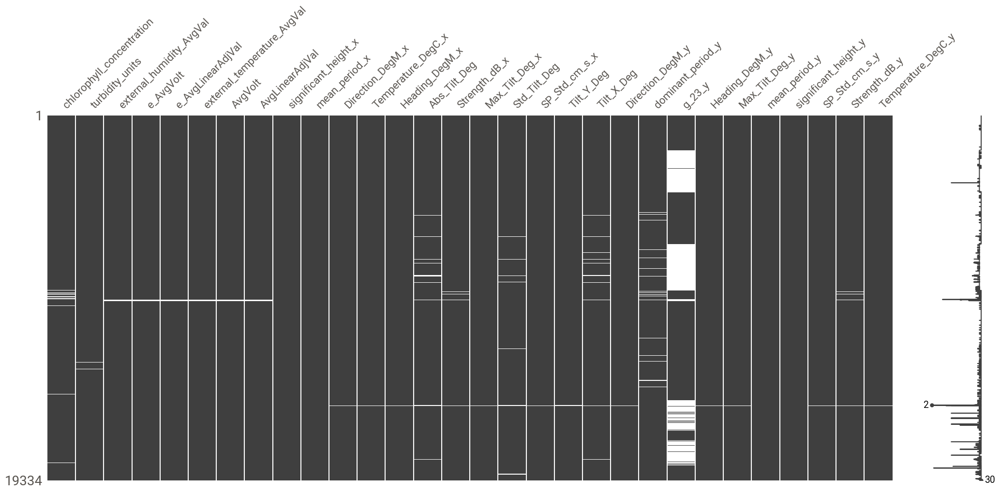

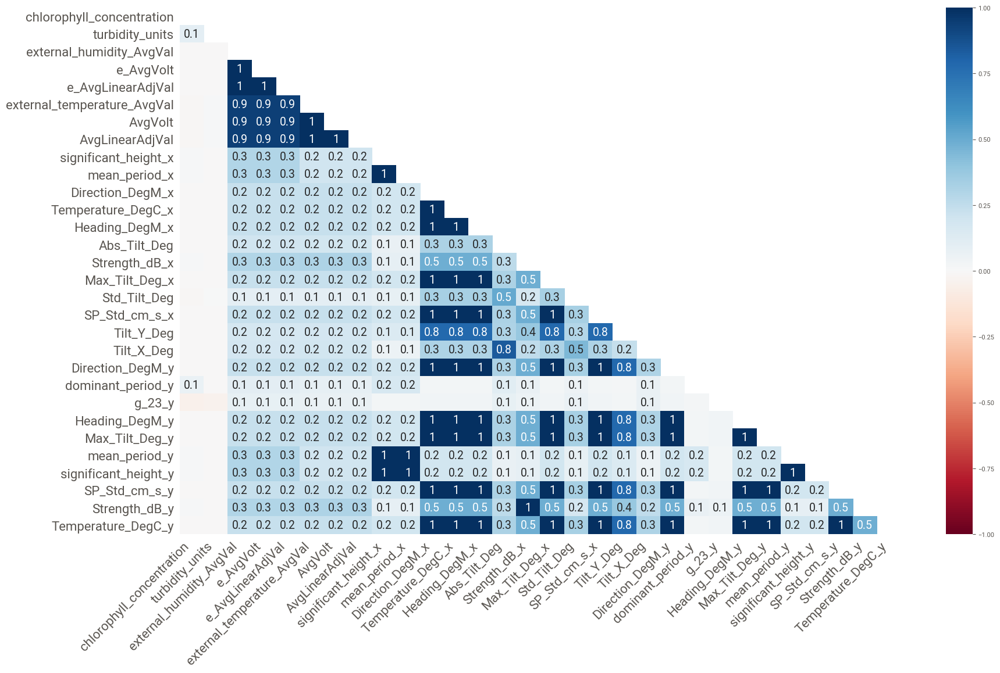

In [278]:
x = df_merge2.columns[df_merge2.isnull().any()].tolist()
msno.matrix(df_merge2[x])
msno.heatmap(df_merge2)

In [ ]:
#df_merge2.to_csv("C:/Users/dalit/DataScience/project/final_project/df_merge2_withrows.csv")

<AxesSubplot:>

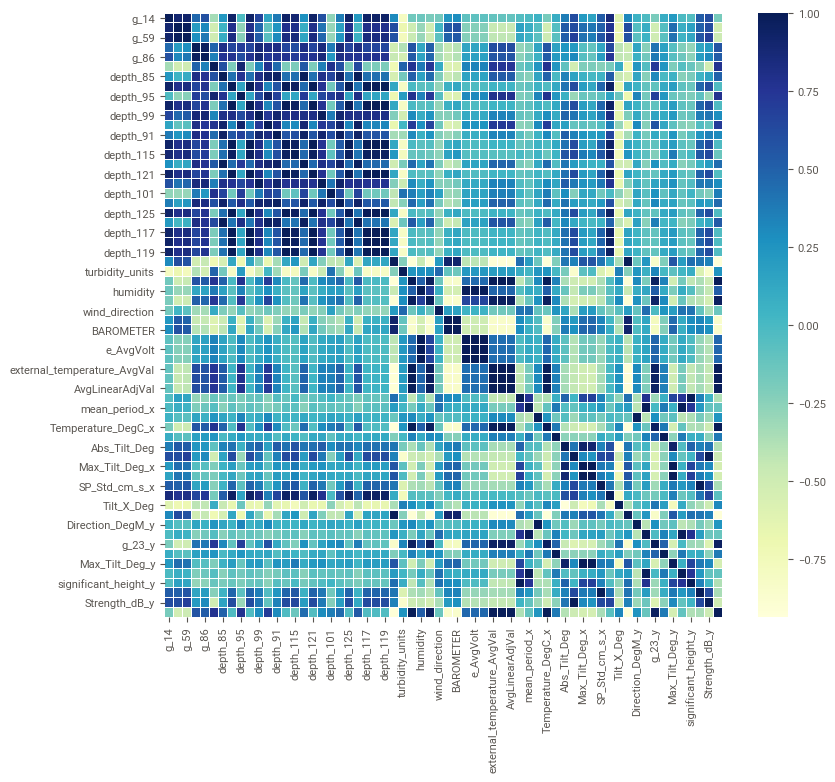

In [280]:
corrmat = corr_final.corr() 
f, ax = plt.subplots(figsize =(9, 8)) 
sns.heatmap(corrmat, ax = ax, cmap ="YlGnBu", linewidths = 0.1) 

### Imputation 

In [281]:
## !pip install fancyimpute
import fancyimpute 

In [282]:
fancyimpute.__version__

'0.5.5'

In [283]:
### downloded the dataframe that should be imputed. 
path= "C:/Users/dalit/DataScience/project/final_project/df_merge2_withrows.csv"
df_merge2 = pd.read_csv(path)
df_merge2.head()


,Unnamed: 0,g_14,g_50,g_59,g_77,g_86,depth_103,depth_85,depth_127,depth_95,depth_129,depth_99,depth_89,depth_91,depth_131,depth_115,depth_83,depth_121,depth_97,depth_101,depth_93,depth_125,depth_87,depth_117,depth_123,depth_119,[i]_na,wind_speed,dominant_period_x,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,East_cm_s,North_cm_s,Abs_Speed_cm_s,g_5,g_23_x,g_68,temp_avg,depth_39,depth_69,depth_73,depth_15,depth_45,depth_51,depth_3,depth_21,...,depth_19,depth_17,depth_7,depth_37,depth_33,depth_25,depth_67,depth_63,depth_55,depth_5,depth_71,depth_9,depth_79,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,pressure,BAROMETER,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgVolt,AvgLinearAdjVal,significant_height_x,mean_period_x,Direction_DegM_x,Temperature_DegC_x,Heading_DegM_x,Abs_Tilt_Deg,Strength_dB_x,Max_Tilt_Deg_x,Std_Tilt_Deg,SP_Std_cm_s_x,Tilt_Y_Deg,Tilt_X_Deg,chl_pred,Direction_DegM_y,dominant_period_y,g_23_y,Heading_DegM_y,Max_Tilt_Deg_y,mean_period_y,significant_height_y,SP_Std_cm_s_y,Strength_dB_y,Temperature_DegC_y
0,0,12.0,8.0,8.0,7.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,1.0,3.0,10.0,10.0,2.0,2.0,9.0,8.0,7.0,10.0,16.0,16.0,13.0,13.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,10.0,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.071,0.177,28.1,86.1,25.5,158.0,1004.9,1004.77,2396.0,0.851,85.104,2290.2,0.592,29.219,0.350,3.569,354.116,29.656,268.558,3.019,-23.242,6.658,1.341,15.587,2.111,-1.209,0.036,354.116,3.774,13.0,268.558,6.658,3.569,0.350,15.587,-23.242,29.656
1,1,12.0,8.0,8.0,7.0,11.0,12.0,12.0,11.0,13.0,11.0,13.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,2.0,5.0,10.0,10.0,2.0,2.0,8.0,8.0,7.0,10.0,16.0,16.0,13.0,13.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,m,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.095,0.189,28.1,86.1,25.6,181.0,1005.0,1004.85,2395.4,0.849,84.860,2285.6,0.580,27.998,0.368,3.535,359.196,29.710,271.677,2.911,-23.277,5.848,1.299,14.462,1.981,-1.251,0.083,359.196,4.878,13.0,271.677,5.848,3.535,0.368,14.462,-23.277,29.710
2,2,12.0,11.0,8.0,6.0,11.0,12.0,12.0,11.0,12.0,11.0,13.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,2.0,5.0,10.0,10.0,2.0,2.0,9.0,9.0,7.0,10.0,16.0,16.0,12.0,14.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,m,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.03,16.0,16.0,0.083,0.183,28.1,86.4,25.7,156.0,1005.0,1004.86,2395.6,0.849,84.860,2289.4,0.590,28.974,0.383,3.632,357.789,29.775,275.965,3.168,-23.103,5.827,1.266,13.411,2.221,-1.250,0.060,357.789,5.000,12.0,275.965,5.827,3.632,0.383,13.411,-23.103,29.775
3,3,12.0,11.0,8.0,6.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,1.0,4.0,10.0,10.0,2.0,2.0,8.0,8.0,7.0,10.0,16.0,16.0,12.0,14.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,m,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.095,0.189,28.1,84.6,25.2,188.0,1005.2,1005.10,2396.8,0.851,85.104,2291.6,0.595,29.463,0.373,3.516,358.542,29.807,277.912,3.110,-22.739,7.250,1.349,12.593,2.145,-1.219,0.083,358.542,4.444,12.0,277.912,7.250,3.516,0.373,12.593,-22.739,29.807
4,4,12.0,10.0,8.0,6.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,2.0,5.0,10.0,10.0,2.0,1.0,8.0,8.0,7.0,10.0,16.0,16.0,12.0,14.0,13.0,16.0,16.0,0.03,16.0,16.0,16.0,m,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.03,16.0,16.0,0.107,0.201,27.9,85.2,25.2,150.0,1005.3,1005.15,2391.4,0.839,83.883,2291.0,0.595,29.463,0.344,3.570,356.702,29.849,276.629,3.014,-22.449,6.186,1.233,11.526,2.222,-1.224,0.048,356.702,5.263,12.0,276.629,6.186,3.570,0.344,11.526,-22.449,29.849


In [284]:
list(df_merge2)

['Unnamed: 0',
 'g_14',
 'g_50',
 'g_59',
 'g_77',
 'g_86',
 'depth_103',
 'depth_85',
 'depth_127',
 'depth_95',
 'depth_129',
 'depth_99',
 'depth_89',
 'depth_91',
 'depth_131',
 'depth_115',
 'depth_83',
 'depth_121',
 'depth_97',
 'depth_101',
 'depth_93',
 'depth_125',
 'depth_87',
 'depth_117',
 'depth_123',
 'depth_119',
 '[i]_na',
 'wind_speed',
 'dominant_period_x',
 'north',
 'east',
 'magnitude_1',
 'magnitude_2',
 'gustdirection',
 'winddirection',
 'East_cm_s',
 'North_cm_s',
 'Abs_Speed_cm_s',
 'g_5',
 'g_23_x',
 'g_68',
 'temp_avg',
 'depth_39',
 'depth_69',
 'depth_73',
 'depth_15',
 'depth_45',
 'depth_51',
 'depth_3',
 'depth_21',
 'depth_23',
 'depth_81',
 'depth_11',
 'depth_41',
 'depth_77',
 'depth_35',
 'depth_65',
 'depth_49',
 'depth_53',
 'depth_31',
 'depth_59',
 'depth_61',
 'depth_27',
 'depth_57',
 'depth_13',
 'depth_75',
 'depth_47',
 'depth_43',
 'depth_29',
 'depth_19',
 'depth_17',
 'depth_7',
 'depth_37',
 'depth_33',
 'depth_25',
 'depth_67',
 'dep

In [286]:
column_names =list(df_merge2)

In [287]:
df_merge3 = df_merge2.reindex(columns=column_names).copy()

In [288]:
df_merge3.head()

,Unnamed: 0,g_14,g_50,g_59,g_77,g_86,depth_103,depth_85,depth_127,depth_95,depth_129,depth_99,depth_89,depth_91,depth_131,depth_115,depth_83,depth_121,depth_97,depth_101,depth_93,depth_125,depth_87,depth_117,depth_123,depth_119,[i]_na,wind_speed,dominant_period_x,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,East_cm_s,North_cm_s,Abs_Speed_cm_s,g_5,g_23_x,g_68,temp_avg,depth_39,depth_69,depth_73,depth_15,depth_45,depth_51,depth_3,depth_21,...,depth_19,depth_17,depth_7,depth_37,depth_33,depth_25,depth_67,depth_63,depth_55,depth_5,depth_71,depth_9,depth_79,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,pressure,BAROMETER,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgVolt,AvgLinearAdjVal,significant_height_x,mean_period_x,Direction_DegM_x,Temperature_DegC_x,Heading_DegM_x,Abs_Tilt_Deg,Strength_dB_x,Max_Tilt_Deg_x,Std_Tilt_Deg,SP_Std_cm_s_x,Tilt_Y_Deg,Tilt_X_Deg,chl_pred,Direction_DegM_y,dominant_period_y,g_23_y,Heading_DegM_y,Max_Tilt_Deg_y,mean_period_y,significant_height_y,SP_Std_cm_s_y,Strength_dB_y,Temperature_DegC_y
0,0,12.0,8.0,8.0,7.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,1.0,3.0,10.0,10.0,2.0,2.0,9.0,8.0,7.0,10.0,16.0,16.0,13.0,13.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,10.0,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.071,0.177,28.1,86.1,25.5,158.0,1004.9,1004.77,2396.0,0.851,85.104,2290.2,0.592,29.219,0.350,3.569,354.116,29.656,268.558,3.019,-23.242,6.658,1.341,15.587,2.111,-1.209,0.036,354.116,3.774,13.0,268.558,6.658,3.569,0.350,15.587,-23.242,29.656
1,1,12.0,8.0,8.0,7.0,11.0,12.0,12.0,11.0,13.0,11.0,13.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,2.0,5.0,10.0,10.0,2.0,2.0,8.0,8.0,7.0,10.0,16.0,16.0,13.0,13.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,m,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.095,0.189,28.1,86.1,25.6,181.0,1005.0,1004.85,2395.4,0.849,84.860,2285.6,0.580,27.998,0.368,3.535,359.196,29.710,271.677,2.911,-23.277,5.848,1.299,14.462,1.981,-1.251,0.083,359.196,4.878,13.0,271.677,5.848,3.535,0.368,14.462,-23.277,29.710
2,2,12.0,11.0,8.0,6.0,11.0,12.0,12.0,11.0,12.0,11.0,13.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,2.0,5.0,10.0,10.0,2.0,2.0,9.0,9.0,7.0,10.0,16.0,16.0,12.0,14.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,m,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.03,16.0,16.0,0.083,0.183,28.1,86.4,25.7,156.0,1005.0,1004.86,2395.6,0.849,84.860,2289.4,0.590,28.974,0.383,3.632,357.789,29.775,275.965,3.168,-23.103,5.827,1.266,13.411,2.221,-1.250,0.060,357.789,5.000,12.0,275.965,5.827,3.632,0.383,13.411,-23.103,29.775
3,3,12.0,11.0,8.0,6.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,1.0,4.0,10.0,10.0,2.0,2.0,8.0,8.0,7.0,10.0,16.0,16.0,12.0,14.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,m,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.095,0.189,28.1,84.6,25.2,188.0,1005.2,1005.10,2396.8,0.851,85.104,2291.6,0.595,29.463,0.373,3.516,358.542,29.807,277.912,3.110,-22.739,7.250,1.349,12.593,2.145,-1.219,0.083,358.542,4.444,12.0,277.912,7.250,3.516,0.373,12.593,-22.739,29.807
4,4,12.0,10.0,8.0,6.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,2.0,5.0,10.0,10.0,2.0,1.0,8.0,8.0,7.0,10.0,16.0,16.0,12.0,14.0,13.0,16.0,16.0,0.03,16.0,16.0,16.0,m,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.03,16.0,16.0,0.107,0.201,27.9,85.2,25.2,150.0,1005.3,1005.15,2391.4,0.839,83.883,2291.0,0.595,29.463,0.344,3.570,356.702,29.849,276.629,3.014,-22.449,6.186,1.233,11.526,2.222,-1.224,0.048,356.702,5.263,12.0,276.629,6.186,3.570,0.344,11.526,-22.449,29.849


In [289]:
X = df_merge3.copy()
X = X.iloc[:,0:111]
X.head()

,Unnamed: 0,g_14,g_50,g_59,g_77,g_86,depth_103,depth_85,depth_127,depth_95,depth_129,depth_99,depth_89,depth_91,depth_131,depth_115,depth_83,depth_121,depth_97,depth_101,depth_93,depth_125,depth_87,depth_117,depth_123,depth_119,[i]_na,wind_speed,dominant_period_x,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,East_cm_s,North_cm_s,Abs_Speed_cm_s,g_5,g_23_x,g_68,temp_avg,depth_39,depth_69,depth_73,depth_15,depth_45,depth_51,depth_3,depth_21,...,depth_61,depth_27,depth_57,depth_13,depth_75,depth_47,depth_43,depth_29,depth_19,depth_17,depth_7,depth_37,depth_33,depth_25,depth_67,depth_63,depth_55,depth_5,depth_71,depth_9,depth_79,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,pressure,BAROMETER,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgVolt,AvgLinearAdjVal,significant_height_x,mean_period_x,Direction_DegM_x,Temperature_DegC_x,Heading_DegM_x,Abs_Tilt_Deg,Strength_dB_x,Max_Tilt_Deg_x,Std_Tilt_Deg,SP_Std_cm_s_x,Tilt_Y_Deg,Tilt_X_Deg,chl_pred,Direction_DegM_y,dominant_period_y
0,0,12.0,8.0,8.0,7.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,1.0,3.0,10.0,10.0,2.0,2.0,9.0,8.0,7.0,10.0,16.0,16.0,13.0,13.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,10.0,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.071,0.177,28.1,86.1,25.5,158.0,1004.9,1004.77,2396.0,0.851,85.104,2290.2,0.592,29.219,0.350,3.569,354.116,29.656,268.558,3.019,-23.242,6.658,1.341,15.587,2.111,-1.209,0.036,354.116,3.774
1,1,12.0,8.0,8.0,7.0,11.0,12.0,12.0,11.0,13.0,11.0,13.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,2.0,5.0,10.0,10.0,2.0,2.0,8.0,8.0,7.0,10.0,16.0,16.0,13.0,13.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,m,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.095,0.189,28.1,86.1,25.6,181.0,1005.0,1004.85,2395.4,0.849,84.860,2285.6,0.580,27.998,0.368,3.535,359.196,29.710,271.677,2.911,-23.277,5.848,1.299,14.462,1.981,-1.251,0.083,359.196,4.878
2,2,12.0,11.0,8.0,6.0,11.0,12.0,12.0,11.0,12.0,11.0,13.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,2.0,5.0,10.0,10.0,2.0,2.0,9.0,9.0,7.0,10.0,16.0,16.0,12.0,14.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,m,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.03,16.0,16.0,0.083,0.183,28.1,86.4,25.7,156.0,1005.0,1004.86,2395.6,0.849,84.860,2289.4,0.590,28.974,0.383,3.632,357.789,29.775,275.965,3.168,-23.103,5.827,1.266,13.411,2.221,-1.250,0.060,357.789,5.000
3,3,12.0,11.0,8.0,6.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,1.0,4.0,10.0,10.0,2.0,2.0,8.0,8.0,7.0,10.0,16.0,16.0,12.0,14.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,m,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.095,0.189,28.1,84.6,25.2,188.0,1005.2,1005.10,2396.8,0.851,85.104,2291.6,0.595,29.463,0.373,3.516,358.542,29.807,277.912,3.110,-22.739,7.250,1.349,12.593,2.145,-1.219,0.083,358.542,4.444
4,4,12.0,10.0,8.0,6.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,2.0,5.0,10.0,10.0,2.0,1.0,8.0,8.0,7.0,10.0,16.0,16.0,12.0,14.0,13.0,16.0,16.0,0.03,16.0,16.0,16.0,m,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.03,16.0,16.0,0.107,0.201,27.9,85.2,25.2,150.0,1005.3,1005.15,2391.4,0.839,83.883,2291.0,0.595,29.463,0.344,3.570,356.702,29.849,276.629,3.014,-22.449,6.186,1.233,11.526,2.222,-1.224,0.048,356.702,5.263


In [290]:
X.columns

Index(['Unnamed: 0', 'g_14', 'g_50', 'g_59', 'g_77', 'g_86', 'depth_103',
       'depth_85', 'depth_127', 'depth_95',
       ...
       'Abs_Tilt_Deg', 'Strength_dB_x', 'Max_Tilt_Deg_x', 'Std_Tilt_Deg',
       'SP_Std_cm_s_x', 'Tilt_Y_Deg', 'Tilt_X_Deg', 'chl_pred',
       'Direction_DegM_y', 'dominant_period_y'],
      dtype='object', length=111)

In [291]:
a=df_merge3.isnull().sum().sort_values(ascending=False,axis=0).head(100)
a=pd.DataFrame(a)
a

,0
dominant_period_y,366
chlorophyll_concentration,307
Tilt_X_Deg,243
Abs_Tilt_Deg,232
Std_Tilt_Deg,207
Strength_dB_y,97
Strength_dB_x,97
external_humidity_AvgVal,83
e_AvgVolt,83
e_AvgLinearAdjVal,83


In [292]:
a=a.rename(columns={0: "miss"})
a
#a.astype({"miss":float})


,miss
dominant_period_y,366
chlorophyll_concentration,307
Tilt_X_Deg,243
Abs_Tilt_Deg,232
Std_Tilt_Deg,207
Strength_dB_y,97
Strength_dB_x,97
external_humidity_AvgVal,83
e_AvgVolt,83
e_AvgLinearAdjVal,83


In [293]:
miss_df=a[(a.miss>0)]
miss_df

,miss
dominant_period_y,366
chlorophyll_concentration,307
Tilt_X_Deg,243
Abs_Tilt_Deg,232
Std_Tilt_Deg,207
Strength_dB_y,97
Strength_dB_x,97
external_humidity_AvgVal,83
e_AvgVolt,83
e_AvgLinearAdjVal,83


In [294]:
#find the columns that their missing are betweem 40-79%
miss_df_imp=pd.DataFrame()
for indx, row in  miss_df.iterrows():
    miss_df_imp[indx]=df_merge3[indx]
    
miss_df_imp


,dominant_period_y,chlorophyll_concentration,Tilt_X_Deg,Abs_Tilt_Deg,Std_Tilt_Deg,Strength_dB_y,Strength_dB_x,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgLinearAdjVal,AvgVolt,turbidity_units,Tilt_Y_Deg,Heading_DegM_x,Direction_DegM_x,Temperature_DegC_x,Temperature_DegC_y,Max_Tilt_Deg_x,Heading_DegM_y,SP_Std_cm_s_y,SP_Std_cm_s_x,Direction_DegM_y,Max_Tilt_Deg_y,significant_height_y,mean_period_y,significant_height_x,mean_period_x
0,3.774,0.071,-1.209,3.019,1.341,-23.242,-23.242,2396.0,0.851,85.104,2290.2,29.219,0.592,0.177,2.111,268.558,354.116,29.656,29.656,6.658,268.558,15.587,15.587,354.116,6.658,0.350,3.569,0.350,3.569
1,4.878,0.095,-1.251,2.911,1.299,-23.277,-23.277,2395.4,0.849,84.860,2285.6,27.998,0.580,0.189,1.981,271.677,359.196,29.710,29.710,5.848,271.677,14.462,14.462,359.196,5.848,0.368,3.535,0.368,3.535
2,5.000,0.083,-1.250,3.168,1.266,-23.103,-23.103,2395.6,0.849,84.860,2289.4,28.974,0.590,0.183,2.221,275.965,357.789,29.775,29.775,5.827,275.965,13.411,13.411,357.789,5.827,0.383,3.632,0.383,3.632
3,4.444,0.095,-1.219,3.110,1.349,-22.739,-22.739,2396.8,0.851,85.104,2291.6,29.463,0.595,0.189,2.145,277.912,358.542,29.807,29.807,7.250,277.912,12.593,12.593,358.542,7.250,0.373,3.516,0.373,3.516
4,5.263,0.107,-1.224,3.014,1.233,-22.449,-22.449,2391.4,0.839,83.883,2291.0,29.463,0.595,0.201,2.222,276.629,356.702,29.849,29.849,6.186,276.629,11.526,11.526,356.702,6.186,0.344,3.570,0.344,3.570
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19329,5.405,0.266,-4.143,4.981,0.704,-15.638,-15.638,2305.2,0.629,62.882,2252.4,19.939,0.499,1.232,2.686,246.939,20.699,23.768,23.768,6.747,246.939,12.779,12.779,20.699,6.747,0.384,4.526,0.384,4.526
19330,5.882,0.278,-3.923,4.943,0.814,-14.989,-14.989,2298.6,0.612,61.172,2258.2,21.404,0.514,1.226,2.951,262.817,25.277,23.825,23.825,6.208,262.817,15.723,15.723,25.277,6.208,0.422,4.762,0.422,4.762
19331,6.250,0.254,-4.352,5.191,0.600,-15.284,-15.284,2314.4,0.651,65.079,2251.2,19.695,0.497,1.238,2.766,227.567,40.936,23.819,23.819,6.011,227.567,12.773,12.773,40.936,6.011,0.391,4.785,0.391,4.785
19332,6.250,0.278,-3.840,4.745,0.787,-15.476,-15.476,2282.2,0.573,57.265,2259.8,21.648,0.516,1.238,2.711,269.886,22.694,23.813,23.813,6.463,269.886,13.472,13.472,22.694,6.463,0.393,4.717,0.393,4.717


In [ ]:
#miss_df_imp.to_csv("C:/Users/dalit/DataScience/project/final_project/miss_df_imp.csv")

In [295]:
### downloded the file
miss_df_imp = "C:/Users/dalit/DataScience/project/final_project/miss_df_imp.csv"
### user pandas to read the csv (read_csv())
### show the top rows
miss_df_imp = pd.read_csv(miss_df_imp)
miss_df_imp

,Unnamed: 0,dominant_period_y,chlorophyll_concentration,Tilt_X_Deg,Abs_Tilt_Deg,Std_Tilt_Deg,Strength_dB_y,Strength_dB_x,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgLinearAdjVal,AvgVolt,turbidity_units,Tilt_Y_Deg,Heading_DegM_x,Direction_DegM_x,Temperature_DegC_x,Temperature_DegC_y,Max_Tilt_Deg_x,Heading_DegM_y,SP_Std_cm_s_y,SP_Std_cm_s_x,Direction_DegM_y,Max_Tilt_Deg_y,significant_height_y,mean_period_y,significant_height_x,mean_period_x
0,0,3.774,0.071,-1.209,3.019,1.341,-23.242,-23.242,2396.0,0.851,85.104,2290.2,29.219,0.592,0.177,2.111,268.558,354.116,29.656,29.656,6.658,268.558,15.587,15.587,354.116,6.658,0.350,3.569,0.350,3.569
1,1,4.878,0.095,-1.251,2.911,1.299,-23.277,-23.277,2395.4,0.849,84.860,2285.6,27.998,0.580,0.189,1.981,271.677,359.196,29.710,29.710,5.848,271.677,14.462,14.462,359.196,5.848,0.368,3.535,0.368,3.535
2,2,5.000,0.083,-1.250,3.168,1.266,-23.103,-23.103,2395.6,0.849,84.860,2289.4,28.974,0.590,0.183,2.221,275.965,357.789,29.775,29.775,5.827,275.965,13.411,13.411,357.789,5.827,0.383,3.632,0.383,3.632
3,3,4.444,0.095,-1.219,3.110,1.349,-22.739,-22.739,2396.8,0.851,85.104,2291.6,29.463,0.595,0.189,2.145,277.912,358.542,29.807,29.807,7.250,277.912,12.593,12.593,358.542,7.250,0.373,3.516,0.373,3.516
4,4,5.263,0.107,-1.224,3.014,1.233,-22.449,-22.449,2391.4,0.839,83.883,2291.0,29.463,0.595,0.201,2.222,276.629,356.702,29.849,29.849,6.186,276.629,11.526,11.526,356.702,6.186,0.344,3.570,0.344,3.570
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19329,19329,5.405,0.266,-4.143,4.981,0.704,-15.638,-15.638,2305.2,0.629,62.882,2252.4,19.939,0.499,1.232,2.686,246.939,20.699,23.768,23.768,6.747,246.939,12.779,12.779,20.699,6.747,0.384,4.526,0.384,4.526
19330,19330,5.882,0.278,-3.923,4.943,0.814,-14.989,-14.989,2298.6,0.612,61.172,2258.2,21.404,0.514,1.226,2.951,262.817,25.277,23.825,23.825,6.208,262.817,15.723,15.723,25.277,6.208,0.422,4.762,0.422,4.762
19331,19331,6.250,0.254,-4.352,5.191,0.600,-15.284,-15.284,2314.4,0.651,65.079,2251.2,19.695,0.497,1.238,2.766,227.567,40.936,23.819,23.819,6.011,227.567,12.773,12.773,40.936,6.011,0.391,4.785,0.391,4.785
19332,19332,6.250,0.278,-3.840,4.745,0.787,-15.476,-15.476,2282.2,0.573,57.265,2259.8,21.648,0.516,1.238,2.711,269.886,22.694,23.813,23.813,6.463,269.886,13.472,13.472,22.694,6.463,0.393,4.717,0.393,4.717


In [296]:
### KNN
from fancyimpute import KNN 

#X_imputed = fancyimpute.KNN(6).fit_transform(miss_df_imp)
X_imputed = KNN(6).fit_transform(miss_df_imp)
X_imputed = pd.DataFrame(X_imputed,columns=miss_df_imp.columns)
X_imputed.head(100)

Imputing row 1/19334 with 0 missing, elapsed time: 104.591
Imputing row 101/19334 with 0 missing, elapsed time: 104.629
Imputing row 201/19334 with 0 missing, elapsed time: 104.644
Imputing row 301/19334 with 0 missing, elapsed time: 104.644
Imputing row 401/19334 with 0 missing, elapsed time: 104.644
Imputing row 501/19334 with 0 missing, elapsed time: 104.644
Imputing row 601/19334 with 0 missing, elapsed time: 104.676
Imputing row 701/19334 with 0 missing, elapsed time: 104.676
Imputing row 801/19334 with 0 missing, elapsed time: 104.676
Imputing row 901/19334 with 0 missing, elapsed time: 104.676
Imputing row 1001/19334 with 0 missing, elapsed time: 104.676
Imputing row 1101/19334 with 0 missing, elapsed time: 104.676
Imputing row 1201/19334 with 0 missing, elapsed time: 104.676
Imputing row 1301/19334 with 0 missing, elapsed time: 104.676
Imputing row 1401/19334 with 0 missing, elapsed time: 104.676
Imputing row 1501/19334 with 0 missing, elapsed time: 104.676
Imputing row 1601/19

Imputing row 18801/19334 with 0 missing, elapsed time: 105.267
Imputing row 18901/19334 with 0 missing, elapsed time: 105.270
Imputing row 19001/19334 with 0 missing, elapsed time: 105.275
Imputing row 19101/19334 with 0 missing, elapsed time: 105.282
Imputing row 19201/19334 with 0 missing, elapsed time: 105.282
Imputing row 19301/19334 with 0 missing, elapsed time: 105.286


,Unnamed: 0,dominant_period_y,chlorophyll_concentration,Tilt_X_Deg,Abs_Tilt_Deg,Std_Tilt_Deg,Strength_dB_y,Strength_dB_x,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgLinearAdjVal,AvgVolt,turbidity_units,Tilt_Y_Deg,Heading_DegM_x,Direction_DegM_x,Temperature_DegC_x,Temperature_DegC_y,Max_Tilt_Deg_x,Heading_DegM_y,SP_Std_cm_s_y,SP_Std_cm_s_x,Direction_DegM_y,Max_Tilt_Deg_y,significant_height_y,mean_period_y,significant_height_x,mean_period_x
0,0.0,3.774,0.071,-1.209,3.019,1.341,-23.242,-23.242,2396.0,0.851,85.104,2290.2,29.219,0.592,0.177,2.111,268.558,354.116,29.656,29.656,6.658,268.558,15.587,15.587,354.116,6.658,0.350,3.569,0.350,3.569
1,1.0,4.878,0.095,-1.251,2.911,1.299,-23.277,-23.277,2395.4,0.849,84.860,2285.6,27.998,0.580,0.189,1.981,271.677,359.196,29.710,29.710,5.848,271.677,14.462,14.462,359.196,5.848,0.368,3.535,0.368,3.535
2,2.0,5.000,0.083,-1.250,3.168,1.266,-23.103,-23.103,2395.6,0.849,84.860,2289.4,28.974,0.590,0.183,2.221,275.965,357.789,29.775,29.775,5.827,275.965,13.411,13.411,357.789,5.827,0.383,3.632,0.383,3.632
3,3.0,4.444,0.095,-1.219,3.110,1.349,-22.739,-22.739,2396.8,0.851,85.104,2291.6,29.463,0.595,0.189,2.145,277.912,358.542,29.807,29.807,7.250,277.912,12.593,12.593,358.542,7.250,0.373,3.516,0.373,3.516
4,4.0,5.263,0.107,-1.224,3.014,1.233,-22.449,-22.449,2391.4,0.839,83.883,2291.0,29.463,0.595,0.201,2.222,276.629,356.702,29.849,29.849,6.186,276.629,11.526,11.526,356.702,6.186,0.344,3.570,0.344,3.570
5,5.0,5.714,0.083,-1.279,3.130,1.263,-23.381,-23.381,2391.8,0.839,83.883,2290.2,29.219,0.592,0.183,2.300,277.247,356.458,29.866,29.866,7.432,277.247,10.944,10.944,356.458,7.432,0.376,3.641,0.376,3.641
6,6.0,5.556,0.083,-1.376,3.366,1.155,-23.486,-23.486,2398.8,0.856,85.592,2284.0,27.753,0.578,0.189,2.499,275.717,357.699,29.874,29.874,7.023,275.717,12.842,12.842,357.699,7.023,0.373,3.619,0.373,3.619
7,7.0,5.714,0.083,-1.455,3.341,1.094,-23.978,-23.978,2400.6,0.861,86.081,2292.6,29.707,0.597,0.195,2.461,274.524,356.898,29.869,29.869,7.051,274.524,12.014,12.014,356.898,7.051,0.380,3.657,0.380,3.657
8,8.0,5.556,0.071,-1.519,3.279,1.054,-24.264,-24.264,2391.6,0.839,83.883,2289.2,28.974,0.590,0.195,2.503,274.257,358.044,29.843,29.843,6.353,274.257,15.472,15.472,358.044,6.353,0.354,3.504,0.354,3.504
9,9.0,5.000,0.083,-1.412,3.555,1.060,-25.386,-25.386,2397.0,0.853,85.348,2284.4,27.753,0.578,0.201,2.893,274.176,358.858,29.803,29.803,6.757,274.176,15.659,15.659,358.858,6.757,0.338,3.599,0.338,3.599


In [297]:
X_imputed = pd.DataFrame(X_imputed,columns=miss_df_imp.columns)
X_imputed.head(100)

,Unnamed: 0,dominant_period_y,chlorophyll_concentration,Tilt_X_Deg,Abs_Tilt_Deg,Std_Tilt_Deg,Strength_dB_y,Strength_dB_x,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgLinearAdjVal,AvgVolt,turbidity_units,Tilt_Y_Deg,Heading_DegM_x,Direction_DegM_x,Temperature_DegC_x,Temperature_DegC_y,Max_Tilt_Deg_x,Heading_DegM_y,SP_Std_cm_s_y,SP_Std_cm_s_x,Direction_DegM_y,Max_Tilt_Deg_y,significant_height_y,mean_period_y,significant_height_x,mean_period_x
0,0.0,3.774,0.071,-1.209,3.019,1.341,-23.242,-23.242,2396.0,0.851,85.104,2290.2,29.219,0.592,0.177,2.111,268.558,354.116,29.656,29.656,6.658,268.558,15.587,15.587,354.116,6.658,0.350,3.569,0.350,3.569
1,1.0,4.878,0.095,-1.251,2.911,1.299,-23.277,-23.277,2395.4,0.849,84.860,2285.6,27.998,0.580,0.189,1.981,271.677,359.196,29.710,29.710,5.848,271.677,14.462,14.462,359.196,5.848,0.368,3.535,0.368,3.535
2,2.0,5.000,0.083,-1.250,3.168,1.266,-23.103,-23.103,2395.6,0.849,84.860,2289.4,28.974,0.590,0.183,2.221,275.965,357.789,29.775,29.775,5.827,275.965,13.411,13.411,357.789,5.827,0.383,3.632,0.383,3.632
3,3.0,4.444,0.095,-1.219,3.110,1.349,-22.739,-22.739,2396.8,0.851,85.104,2291.6,29.463,0.595,0.189,2.145,277.912,358.542,29.807,29.807,7.250,277.912,12.593,12.593,358.542,7.250,0.373,3.516,0.373,3.516
4,4.0,5.263,0.107,-1.224,3.014,1.233,-22.449,-22.449,2391.4,0.839,83.883,2291.0,29.463,0.595,0.201,2.222,276.629,356.702,29.849,29.849,6.186,276.629,11.526,11.526,356.702,6.186,0.344,3.570,0.344,3.570
5,5.0,5.714,0.083,-1.279,3.130,1.263,-23.381,-23.381,2391.8,0.839,83.883,2290.2,29.219,0.592,0.183,2.300,277.247,356.458,29.866,29.866,7.432,277.247,10.944,10.944,356.458,7.432,0.376,3.641,0.376,3.641
6,6.0,5.556,0.083,-1.376,3.366,1.155,-23.486,-23.486,2398.8,0.856,85.592,2284.0,27.753,0.578,0.189,2.499,275.717,357.699,29.874,29.874,7.023,275.717,12.842,12.842,357.699,7.023,0.373,3.619,0.373,3.619
7,7.0,5.714,0.083,-1.455,3.341,1.094,-23.978,-23.978,2400.6,0.861,86.081,2292.6,29.707,0.597,0.195,2.461,274.524,356.898,29.869,29.869,7.051,274.524,12.014,12.014,356.898,7.051,0.380,3.657,0.380,3.657
8,8.0,5.556,0.071,-1.519,3.279,1.054,-24.264,-24.264,2391.6,0.839,83.883,2289.2,28.974,0.590,0.195,2.503,274.257,358.044,29.843,29.843,6.353,274.257,15.472,15.472,358.044,6.353,0.354,3.504,0.354,3.504
9,9.0,5.000,0.083,-1.412,3.555,1.060,-25.386,-25.386,2397.0,0.853,85.348,2284.4,27.753,0.578,0.201,2.893,274.176,358.858,29.803,29.803,6.757,274.176,15.659,15.659,358.858,6.757,0.338,3.599,0.338,3.599


In [298]:
X_imputed

,Unnamed: 0,dominant_period_y,chlorophyll_concentration,Tilt_X_Deg,Abs_Tilt_Deg,Std_Tilt_Deg,Strength_dB_y,Strength_dB_x,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgLinearAdjVal,AvgVolt,turbidity_units,Tilt_Y_Deg,Heading_DegM_x,Direction_DegM_x,Temperature_DegC_x,Temperature_DegC_y,Max_Tilt_Deg_x,Heading_DegM_y,SP_Std_cm_s_y,SP_Std_cm_s_x,Direction_DegM_y,Max_Tilt_Deg_y,significant_height_y,mean_period_y,significant_height_x,mean_period_x
0,0.0,3.774,0.071,-1.209,3.019,1.341,-23.242,-23.242,2396.0,0.851,85.104,2290.2,29.219,0.592,0.177,2.111,268.558,354.116,29.656,29.656,6.658,268.558,15.587,15.587,354.116,6.658,0.350,3.569,0.350,3.569
1,1.0,4.878,0.095,-1.251,2.911,1.299,-23.277,-23.277,2395.4,0.849,84.860,2285.6,27.998,0.580,0.189,1.981,271.677,359.196,29.710,29.710,5.848,271.677,14.462,14.462,359.196,5.848,0.368,3.535,0.368,3.535
2,2.0,5.000,0.083,-1.250,3.168,1.266,-23.103,-23.103,2395.6,0.849,84.860,2289.4,28.974,0.590,0.183,2.221,275.965,357.789,29.775,29.775,5.827,275.965,13.411,13.411,357.789,5.827,0.383,3.632,0.383,3.632
3,3.0,4.444,0.095,-1.219,3.110,1.349,-22.739,-22.739,2396.8,0.851,85.104,2291.6,29.463,0.595,0.189,2.145,277.912,358.542,29.807,29.807,7.250,277.912,12.593,12.593,358.542,7.250,0.373,3.516,0.373,3.516
4,4.0,5.263,0.107,-1.224,3.014,1.233,-22.449,-22.449,2391.4,0.839,83.883,2291.0,29.463,0.595,0.201,2.222,276.629,356.702,29.849,29.849,6.186,276.629,11.526,11.526,356.702,6.186,0.344,3.570,0.344,3.570
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19329,19329.0,5.405,0.266,-4.143,4.981,0.704,-15.638,-15.638,2305.2,0.629,62.882,2252.4,19.939,0.499,1.232,2.686,246.939,20.699,23.768,23.768,6.747,246.939,12.779,12.779,20.699,6.747,0.384,4.526,0.384,4.526
19330,19330.0,5.882,0.278,-3.923,4.943,0.814,-14.989,-14.989,2298.6,0.612,61.172,2258.2,21.404,0.514,1.226,2.951,262.817,25.277,23.825,23.825,6.208,262.817,15.723,15.723,25.277,6.208,0.422,4.762,0.422,4.762
19331,19331.0,6.250,0.254,-4.352,5.191,0.600,-15.284,-15.284,2314.4,0.651,65.079,2251.2,19.695,0.497,1.238,2.766,227.567,40.936,23.819,23.819,6.011,227.567,12.773,12.773,40.936,6.011,0.391,4.785,0.391,4.785
19332,19332.0,6.250,0.278,-3.840,4.745,0.787,-15.476,-15.476,2282.2,0.573,57.265,2259.8,21.648,0.516,1.238,2.711,269.886,22.694,23.813,23.813,6.463,269.886,13.472,13.472,22.694,6.463,0.393,4.717,0.393,4.717


In [ ]:
#X_imputed.to_csv("C:/Users/dalit/DataScience/project/final_project/X_imputed.csv")

C:\Users\dalit\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


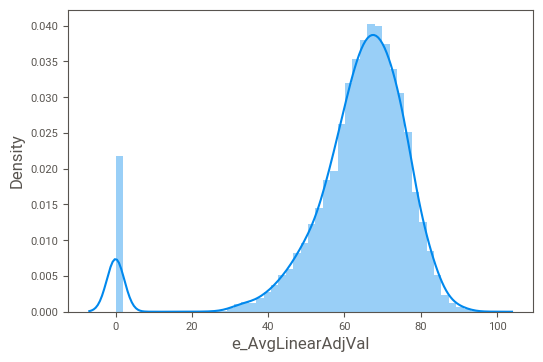

In [299]:
##plot after imputation. 
sns.distplot(X_imputed['e_AvgLinearAdjVal'])
plt.show()


In [300]:
import matplotlib.pyplot as plt

(<matplotlib.collections.PathCollection at 0x251a6b77748>,)

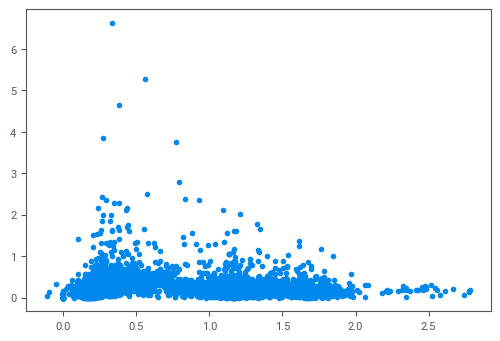

In [304]:
plt.scatter(df_merge3['turbidity_units'],df_merge3['chl_pred']),



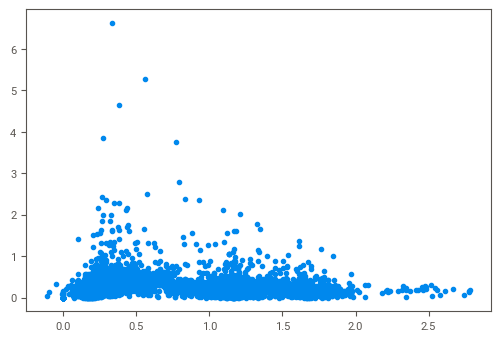

In [302]:
plt.scatter(X_imputed['turbidity_units'],df_merge3['chl_pred'])

In [305]:
df_merge4=df_merge3.copy()

In [306]:
list(X_imputed)

['Unnamed: 0',
 'dominant_period_y',
 'chlorophyll_concentration',
 'Tilt_X_Deg',
 'Abs_Tilt_Deg',
 'Std_Tilt_Deg',
 'Strength_dB_y',
 'Strength_dB_x',
 'external_humidity_AvgVal',
 'e_AvgVolt',
 'e_AvgLinearAdjVal',
 'external_temperature_AvgVal',
 'AvgLinearAdjVal',
 'AvgVolt',
 'turbidity_units',
 'Tilt_Y_Deg',
 'Heading_DegM_x',
 'Direction_DegM_x',
 'Temperature_DegC_x',
 'Temperature_DegC_y',
 'Max_Tilt_Deg_x',
 'Heading_DegM_y',
 'SP_Std_cm_s_y',
 'SP_Std_cm_s_x',
 'Direction_DegM_y',
 'Max_Tilt_Deg_y',
 'significant_height_y',
 'mean_period_y',
 'significant_height_x',
 'mean_period_x']

In [307]:
# Drop the columns from the df in order to replace it with the imputed columns
df_merge5 = df_merge4.drop(list(X_imputed), axis = 1)
df_merge5 

,g_14,g_50,g_59,g_77,g_86,depth_103,depth_85,depth_127,depth_95,depth_129,depth_99,depth_89,depth_91,depth_131,depth_115,depth_83,depth_121,depth_97,depth_101,depth_93,depth_125,depth_87,depth_117,depth_123,depth_119,[i]_na,wind_speed,dominant_period_x,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,East_cm_s,North_cm_s,Abs_Speed_cm_s,g_5,g_23_x,g_68,temp_avg,depth_39,depth_69,depth_73,depth_15,depth_45,depth_51,depth_3,depth_21,depth_23,depth_81,depth_11,depth_41,depth_77,depth_35,depth_65,depth_49,depth_53,depth_31,depth_59,depth_61,depth_27,depth_57,depth_13,depth_75,depth_47,depth_43,depth_29,depth_19,depth_17,depth_7,depth_37,depth_33,depth_25,depth_67,depth_63,depth_55,depth_5,depth_71,depth_9,depth_79,temperature,humidity,dewpoint,wind_direction,pressure,BAROMETER,chl_pred,g_23_y
0,12.0,8.0,8.0,7.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,1.0,3.0,10.0,10.0,2.0,2.0,9.0,8.0,7.0,10.0,16.0,16.0,13.0,13.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,10.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,28.1,86.1,25.5,158.000,1004.9,1004.77,0.036,13.0
1,12.0,8.0,8.0,7.0,11.0,12.0,12.0,11.0,13.0,11.0,13.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,2.0,5.0,10.0,10.0,2.0,2.0,8.0,8.0,7.0,10.0,16.0,16.0,13.0,13.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,m,16.0,16.0,0.02,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,28.1,86.1,25.6,181.000,1005.0,1004.85,0.083,13.0
2,12.0,11.0,8.0,6.0,11.0,12.0,12.0,11.0,12.0,11.0,13.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,2.0,5.0,10.0,10.0,2.0,2.0,9.0,9.0,7.0,10.0,16.0,16.0,12.0,14.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,m,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.03,16.0,16.0,28.1,86.4,25.7,156.000,1005.0,1004.86,0.060,12.0
3,12.0,11.0,8.0,6.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,1.0,4.0,10.0,10.0,2.0,2.0,8.0,8.0,7.0,10.0,16.0,16.0,12.0,14.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,m,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,28.1,84.6,25.2,188.000,1005.2,1005.10,0.083,12.0
4,12.0,10.0,8.0,6.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,2.0,5.0,10.0,10.0,2.0,1.0,8.0,8.0,7.0,10.0,16.0,16.0,12.0,14.0,13.0,16.0,16.0,0.03,16.0,16.0,16.0,m,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.03,16.0,16.0,27.9,85.2,25.2,150.000,1005.3,1005.15,0.048,12.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19329,6.0,12.0,12.0,11.0,11.0,13.0,13.0,11.0,13.0,11.0,13.0,13.0,13.0,11.0,13.0,13.0,11.0,13.0,13.0,13.0,11.0,13.0,11.0,11.0,11.0,0,2.0,10.0,10.0,10.0,2.0,3.0,5.0,5.0,7.0,7.0,7.0,6.0,7.0,16.0,10.0,m,m,m,m,m,m,10.0,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,16.0,m,m,m,m,m,m,16.0,m,m,m,19.6,63.4,12.5,172.341,1020.1,1018.26,0.351,7.0
19330,6.0,12.0,12.0,11.0,11.0,13.0,13.0,11.0,13.0,11.0,13.0,13.0,13.0,11.0,13.0,13.0,11.0,13.0,13.0,13.0,11.0,13.0,11.0,11.0,11.0,0,10.0,10.0,10.0,10.0,10.0,16.0,4.0,4.0,7.0,8.0,11.0,6.0,7.0,16.0,10.0,m,m,m,m,m,m,10.0,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,m,16.0,m,m,m,m,m,m,16.0,m,m

In [308]:
#merge the columns to get the new dataFrame
phyto_df_imputed=pd.merge(df_merge5,X_imputed, left_index=True, right_index=True)
phyto_df_imputed.head()

,g_14,g_50,g_59,g_77,g_86,depth_103,depth_85,depth_127,depth_95,depth_129,depth_99,depth_89,depth_91,depth_131,depth_115,depth_83,depth_121,depth_97,depth_101,depth_93,depth_125,depth_87,depth_117,depth_123,depth_119,[i]_na,wind_speed,dominant_period_x,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,East_cm_s,North_cm_s,Abs_Speed_cm_s,g_5,g_23_x,g_68,temp_avg,depth_39,depth_69,depth_73,depth_15,depth_45,depth_51,depth_3,depth_21,depth_23,...,depth_17,depth_7,depth_37,depth_33,depth_25,depth_67,depth_63,depth_55,depth_5,depth_71,depth_9,depth_79,temperature,humidity,dewpoint,wind_direction,pressure,BAROMETER,chl_pred,g_23_y,Unnamed: 0,dominant_period_y,chlorophyll_concentration,Tilt_X_Deg,Abs_Tilt_Deg,Std_Tilt_Deg,Strength_dB_y,Strength_dB_x,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgLinearAdjVal,AvgVolt,turbidity_units,Tilt_Y_Deg,Heading_DegM_x,Direction_DegM_x,Temperature_DegC_x,Temperature_DegC_y,Max_Tilt_Deg_x,Heading_DegM_y,SP_Std_cm_s_y,SP_Std_cm_s_x,Direction_DegM_y,Max_Tilt_Deg_y,significant_height_y,mean_period_y,significant_height_x,mean_period_x
0,12.0,8.0,8.0,7.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,1.0,3.0,10.0,10.0,2.0,2.0,9.0,8.0,7.0,10.0,16.0,16.0,13.0,13.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,10.0,16.0,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,28.1,86.1,25.5,158.0,1004.9,1004.77,0.036,13.0,0.0,3.774,0.071,-1.209,3.019,1.341,-23.242,-23.242,2396.0,0.851,85.104,2290.2,29.219,0.592,0.177,2.111,268.558,354.116,29.656,29.656,6.658,268.558,15.587,15.587,354.116,6.658,0.350,3.569,0.350,3.569
1,12.0,8.0,8.0,7.0,11.0,12.0,12.0,11.0,13.0,11.0,13.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,2.0,5.0,10.0,10.0,2.0,2.0,8.0,8.0,7.0,10.0,16.0,16.0,13.0,13.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,m,16.0,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,28.1,86.1,25.6,181.0,1005.0,1004.85,0.083,13.0,1.0,4.878,0.095,-1.251,2.911,1.299,-23.277,-23.277,2395.4,0.849,84.860,2285.6,27.998,0.580,0.189,1.981,271.677,359.196,29.710,29.710,5.848,271.677,14.462,14.462,359.196,5.848,0.368,3.535,0.368,3.535
2,12.0,11.0,8.0,6.0,11.0,12.0,12.0,11.0,12.0,11.0,13.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,2.0,5.0,10.0,10.0,2.0,2.0,9.0,9.0,7.0,10.0,16.0,16.0,12.0,14.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,m,16.0,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.03,16.0,16.0,28.1,86.4,25.7,156.0,1005.0,1004.86,0.060,12.0,2.0,5.000,0.083,-1.250,3.168,1.266,-23.103,-23.103,2395.6,0.849,84.860,2289.4,28.974,0.590,0.183,2.221,275.965,357.789,29.775,29.775,5.827,275.965,13.411,13.411,357.789,5.827,0.383,3.632,0.383,3.632
3,12.0,11.0,8.0,6.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,1.0,4.0,10.0,10.0,2.0,2.0,8.0,8.0,7.0,10.0,16.0,16.0,12.0,14.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,m,16.0,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,28.1,84.6,25.2,188.0,1005.2,1005.10,0.083,12.0,3.0,4.444,0.095,-1.219,3.110,1.349,-22.739,-22.739,2396.8,0.851,85.104,2291.6,29.463,0.595,0.189,2.145,277.912,358.542,29.807,29.807,7.250,277.912,12.593,12.593,358.542,7.250,0.373,3.516,0.373,3.516
4,12.0,10.0,8.0,6.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,2.0,5.0,10.0,10.0,2.0,1.0,8.0,8.0,7.0,10.0,16.0,16.0,12.0,14.0,13.0,16.0,16.0,0.03,16.0,16.0,16.0,m,16.0,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.03,16.0,16.0,27.9,85.2,25.2,150.0,1005.3,1005.15,0.048,12.0,4.0,5.263,0.107,-1.224,3.014,1.233,-22.449,-22.449,2391.4,0.839,83.883,2291.0,29.463,0.595,0.201,2.222,276.629,356.702,29.849,29.849,6.186,276.629,11.526,11.526,356.702,6.186,0.344,3.570,0.344,3.570


In [ ]:
#phyto_df_imputed.to_csv("C:/Users/dalit/DataScience/project/final_project/phyto_df_imputed.csv")

In [309]:
a=phyto_df_imputed.isnull().sum().sort_values(ascending=False,axis=0).head(100)
a=pd.DataFrame(a)
a

,0
mean_period_x,0
depth_73,0
magnitude_2,0
gustdirection,0
winddirection,0
East_cm_s,0
North_cm_s,0
Abs_Speed_cm_s,0
g_5,0
g_23_x,0


### The imputed dataframe - phyto_df_imputed

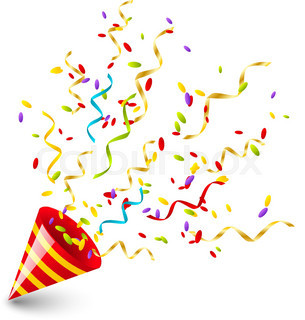

# Feature enrichment

there are several changes that we should apply on the data:
1. from dates- divide the date into day and month
2. from hours- divide the time into hours and minutes
3. from hours/date- transfrom month and hours to cos/sin cycle-optional
4. from hours- create another hour column (12 h) and am/pm column- optional
5. from sunlight hours- Add day/light hours, -> calculated from sunlight hours. 
6. from chl- compute running avarge of chlorophyl from the past 24 hours. 
7. from g_x- calculated average and stdev out of the original data of temperature at different depths (g_x)
8. from chl- calculate the change level (x-(x-1)) or (x/(x-1))
9. from sunlight hours- Add day/light hours, -> calculated from sunlight hours.
10. add sunlight hours according to dates, from NOAA website


### Date and time manipulation

In [314]:
##copy the original df with all the values
df=ff_phyto.copy()
df.head()

,d_stamp,T_round1,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,wind_speed,pressure,BAROMETER,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgVolt,AvgLinearAdjVal,dominant_period,significant_height,mean_period,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,Direction_DegM,East_cm_s,Temperature_DegC,Heading_DegM,North_cm_s,Abs_Speed_cm_s,Abs_Tilt_Deg,Ping_Count,DCS_MEASUREMENT,Strength_dB,Max_Tilt_Deg,Std_Tilt_Deg,SP_Std_cm_s,Tilt_Y_Deg,Tilt_X_Deg,g_5,g_11,g_14,g_16,g_18,g_23,g_32,g_34,g_41,...,depth_11,depth_41,depth_77,depth_35,depth_65,depth_111,depth_49,depth_91,depth_131,depth_53,depth_115,depth_31,depth_59,depth_61,depth_27,depth_83,depth_57,depth_121,depth_13,depth_75,depth_47,depth_43,depth_29,depth_19,depth_113,depth_97,depth_101,depth_93,depth_17,depth_7,depth_107,depth_133,depth_37,depth_33,depth_25,depth_67,depth_63,depth_125,depth_55,depth_87,depth_117,depth_109,depth_123,depth_5,depth_71,depth_119,depth_135,depth_9,depth_79,chl_pred
0,26/07/2017,00:00,0.0714,0.1769,28.1,86.1,25.5,158.0,1.31,1004.9,1004.77,2396.000000,0.851038,85.103783,2290.199951,0.592186,29.218563,3.773585,0.349965,3.569183,1.002698,-1.398390,1.720726,2.459251,312.267985,305.641944,354.1157,-3.813206,29.65594,268.5581,36.99874,37.19472,3.019041,150.0,4830 164,-23.24216,6.657907,1.341434,15.58672,2.110645,-1.209371,29.66,NaN,28.57,NaN,NaN,27.62,24.81,NaN,NaN,...,0.27,0.35,0.04,0.36,0.07,NaN,0.25,0.04,NaN,0.10,NaN,0.41,0.14,0.09,0.41,0.08,0.12,NaN,0.36,0.04,0.28,0.34,0.44,0.47,NaN,46.34,0.07,0.05,0.45,0.11,46.34,NaN,0.35,0.39,0.42,0.04,0.04,NaN,0.09,0.08,NaN,46.34,NaN,0.09,0.07,NaN,NaN,0.16,0.05,0.0357
1,26/07/2017,00:30,0.0952,0.1891,28.1,86.1,25.6,181.0,1.62,1005.0,1004.85,2395.399902,0.848596,84.859589,2285.600098,0.579976,27.997559,4.878049,0.367506,3.535415,0.846920,-1.376217,1.615935,2.175767,300.039045,301.608035,359.1959,-0.561202,29.70995,271.6772,39.98478,39.98871,2.911384,150.0,4830 164,-23.27668,5.847709,1.299325,14.46207,1.981044,-1.250808,29.71,NaN,28.77,NaN,NaN,27.47,24.84,NaN,NaN,...,0.24,0.32,0.03,0.36,0.02,NaN,0.20,0.06,NaN,0.17,NaN,0.43,0.11,0.11,0.44,0.08,0.12,NaN,0.33,0.05,0.24,0.31,0.43,0.46,NaN,46.34,0.02,0.10,0.47,0.09,46.34,NaN,0.36,0.39,0.41,0.04,0.08,NaN,0.18,0.07,NaN,46.34,NaN,0.09,0.01,NaN,NaN,0.20,0.05,0.0833
2,26/07/2017,01:00,0.0833,0.1830,28.1,86.4,25.7,156.0,1.50,1005.0,1004.86,2395.600098,0.848596,84.859589,2289.399902,0.589744,28.974361,5.000000,0.383257,3.631777,1.146126,-1.358030,1.777034,2.635434,319.647782,310.163108,357.7892,-1.451574,29.77465,275.9652,37.60177,37.62978,3.168113,150.0,4830 164,-23.10335,5.826721,1.266041,13.41110,2.220903,-1.250385,29.77,NaN,29.00,NaN,NaN,27.37,24.84,NaN,NaN,...,0.24,0.36,0.05,0.37,0.04,NaN,0.28,0.12,NaN,0.15,NaN,0.41,0.11,0.09,0.39,0.07,0.07,NaN,0.38,0.02,0.26,0.30,0.40,0.38,NaN,46.34,0.05,0.10,0.41,0.10,46.34,NaN,0.37,0.39,0.43,0.05,0.05,NaN,0.15,0.15,NaN,46.34,NaN,0.12,0.03,NaN,NaN,0.23,0.08,0.0595
3,26/07/2017,01:30,0.0952,0.1891,28.1,84.6,25.2,188.0,1.26,1005.2,1005.10,2396.800049,0.851038,85.103783,2291.600098,0.594628,29.462761,4.444444,0.372835,3.516434,0.765793,-1.554695,1.733065,2.224795,296.202083,296.223396,358.5420,-1.051971,29.80680,277.9121,41.33030,41.34369,3.110452,150.0,4830 164,-22.73948,7.249548,1.349087,12.59318,2.145411,-1.218997,29.80,NaN,29.15,NaN,NaN,27.35,24.91,NaN,NaN,...,0.19,0.29,0.04,0.39,0.10,NaN,0.28,0.00,NaN,0.17,NaN,0.42,0.12,0.11,0.40,0.08,0.13,NaN,0.28,0.02,0.23,0.33,0.41,0.45,NaN,46.34,0.02,0.07,0.47,0.16,46.34,NaN,0.38,0.35,0.38,0.07,0.04,NaN,0.15,0.06,NaN,46.34,NaN,0.07,0.07,NaN,NaN,0.10,0.05,0.0833
4,26/07/2017,02:00,0.1071,0.2013,27.9,85.2,25.2,150.0,1.68,1005.3,1005.15,2391.399902,0.838828,83.882782,2291.000000,0.594628,29.462761,5.263158,0.344267,3.569575,0.691532,-1.261911,1.438970,2.007683,296.419762,298.722904,356.7025,-2.372008,29.84918,276.6292,41.17012,41.23840,3.014416,150.0,4830 164,-22.44899,6.186117,1.233424,11.52631,2.222263,-1.22

In [315]:
df_date=df[['d_stamp','T_round1']]
df_date.head()

,d_stamp,T_round1
0,26/07/2017,00:00
1,26/07/2017,00:30
2,26/07/2017,01:00
3,26/07/2017,01:30
4,26/07/2017,02:00


In [316]:
df_date_row=df_date

In [317]:
df_date_row.head()

,d_stamp,T_round1
0,26/07/2017,00:00
1,26/07/2017,00:30
2,26/07/2017,01:00
3,26/07/2017,01:30
4,26/07/2017,02:00


In [318]:
df_date_row1=df_date_row.copy()

In [319]:
pd.to_datetime(df_date_row['d_stamp']).head()

0   2017-07-26
1   2017-07-26
2   2017-07-26
3   2017-07-26
4   2017-07-26
Name: d_stamp, dtype: datetime64[ns]

In [320]:
df_date_row['d_stamp1']=df_date_row['d_stamp']

C:\Users\dalit\anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [321]:
#change d_stamp to year,month and day
df_date_row=pd.concat([df_date_row.drop('d_stamp', axis = 1),
                       (df_date_row.d_stamp.str.split("-").str[:3].apply(pd.Series).rename(columns={0:'year', 1:'month', 2:'day'}))], axis = 1)


In [322]:
df_date_row['hour']=df_date_row['T_round1']
df_date_row['minute']=df_date_row['T_round1']
df_date_row.head()

,T_round1,d_stamp1,year,hour,minute
0,00:00,26/07/2017,26/07/2017,00:00,00:00
1,00:30,26/07/2017,26/07/2017,00:30,00:30
2,01:00,26/07/2017,26/07/2017,01:00,01:00
3,01:30,26/07/2017,26/07/2017,01:30,01:30
4,02:00,26/07/2017,26/07/2017,02:00,02:00


In [323]:
df_date_row['T_round1']= pd.to_datetime(df_date_row['T_round1'])
df_date_row['hour']= pd.to_datetime(df_date_row['hour'])
df_date_row['minute']= pd.to_datetime(df_date_row['minute'])

In [ ]:
#df_date_row=pd.DataFrame(df_date_row)

In [324]:
import time
#seconds = time.time()
#print(df_date_row'T_round1', time.strftime("%H:%M", t))
#time.strptime(T_round1[, format])
df_date_row['T_round1']=pd.to_datetime(df_date_row['T_round1']).dt.strftime('%H:%M')
df_date_row.head()

,T_round1,d_stamp1,year,hour,minute
0,00:00,26/07/2017,26/07/2017,2021-01-31 00:00:00,2021-01-31 00:00:00
1,00:30,26/07/2017,26/07/2017,2021-01-31 00:30:00,2021-01-31 00:30:00
2,01:00,26/07/2017,26/07/2017,2021-01-31 01:00:00,2021-01-31 01:00:00
3,01:30,26/07/2017,26/07/2017,2021-01-31 01:30:00,2021-01-31 01:30:00
4,02:00,26/07/2017,26/07/2017,2021-01-31 02:00:00,2021-01-31 02:00:00


In [325]:
#create new feature that shows only the minute
df_date_row['minute']=pd.to_datetime(df_date_row['minute']).dt.strftime('%M')
df_date_row=df_date_row

In [326]:
#create a new feature that shows only the hour
df_date_row['hour']=pd.to_datetime(df_date_row['hour']).dt.strftime('%H')
df_date_row=df_date_row

In [327]:
#create a new feature that show the time in 12:12 format
df_date_row['T_round2']=df_date_row['T_round1']
df_date_row['T_round2']=pd.to_datetime(df_date_row['T_round2']).dt.strftime('%I:%M')
df_date_row.head()

,T_round1,d_stamp1,year,hour,minute,T_round2
0,00:00,26/07/2017,26/07/2017,00,00,12:00
1,00:30,26/07/2017,26/07/2017,00,30,12:30
2,01:00,26/07/2017,26/07/2017,01,00,01:00
3,01:30,26/07/2017,26/07/2017,01,30,01:30
4,02:00,26/07/2017,26/07/2017,02,00,02:00


In [329]:
#create a nea feature -am/pm
df_date_row['am/pm']=df_date_row['T_round2']
df_date_row['am/pm']=pd.to_datetime(df_date_row['am/pm']).dt.strftime('%p')
df_date_row.head()
#np.where((df_date_row['i']>high)|(outliers_out[i]<low),np.nan,outliers_out[i])

,T_round1,d_stamp1,year,hour,minute,T_round2,am/pm
0,00:00,26/07/2017,26/07/2017,00,00,12:00,PM
1,00:30,26/07/2017,26/07/2017,00,30,12:30,PM
2,01:00,26/07/2017,26/07/2017,01,00,01:00,AM
3,01:30,26/07/2017,26/07/2017,01,30,01:30,AM
4,02:00,26/07/2017,26/07/2017,02,00,02:00,AM


In [330]:
df_date_row['d_stamp']=df_date_row['d_stamp1']

In [331]:
df_date_time=df_date_row.copy()

In [ ]:
#df_date_row.to_csv("C:/Users/dalit/DataScience/project/final_project/date_time.csv")

In [332]:
### downloded the file
date_time = "C:/Users/dalit/DataScience/project/final_project/date_time.csv"


In [333]:
### user pandas to read the csv (read_csv())
### show the top rows
date_time = pd.read_csv(date_time)
date_time

,Unnamed: 0,T_round1,d_stamp1,year,hour,minute,T_round2,am/pm,d_stamp
0,0,00:00,26/07/2017,26/07/2017,0,0,12:00,PM,26/07/2017
1,1,00:30,26/07/2017,26/07/2017,0,30,12:30,PM,26/07/2017
2,2,01:00,26/07/2017,26/07/2017,1,0,01:00,AM,26/07/2017
3,3,01:30,26/07/2017,26/07/2017,1,30,01:30,AM,26/07/2017
4,4,02:00,26/07/2017,26/07/2017,2,0,02:00,AM,26/07/2017
...,...,...,...,...,...,...,...,...,...
19329,19329,16:30,27/11/2020,27/11/2020,16,30,04:30,AM,27/11/2020
19330,19330,17:00,27/11/2020,27/11/2020,17,0,05:00,AM,27/11/2020
19331,19331,17:30,27/11/2020,27/11/2020,17,30,05:30,AM,27/11/2020
19332,19332,18:00,27/11/2020,27/11/2020,18,0,06:00,AM,27/11/2020


In [334]:
date_time['x']=date_time.index
date_time.head()

,Unnamed: 0,T_round1,d_stamp1,year,hour,minute,T_round2,am/pm,d_stamp,x
0,0,00:00,26/07/2017,26/07/2017,0,0,12:00,PM,26/07/2017,0
1,1,00:30,26/07/2017,26/07/2017,0,30,12:30,PM,26/07/2017,1
2,2,01:00,26/07/2017,26/07/2017,1,0,01:00,AM,26/07/2017,2
3,3,01:30,26/07/2017,26/07/2017,1,30,01:30,AM,26/07/2017,3
4,4,02:00,26/07/2017,26/07/2017,2,0,02:00,AM,26/07/2017,4


# calculated average and stdev out of the original data of temperature at different depths (g_x)

In [335]:
##copy the original df with all the values
df_temp=ff_phyto.copy()
df_temp.head()

,d_stamp,T_round1,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,wind_speed,pressure,BAROMETER,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgVolt,AvgLinearAdjVal,dominant_period,significant_height,mean_period,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,Direction_DegM,East_cm_s,Temperature_DegC,Heading_DegM,North_cm_s,Abs_Speed_cm_s,Abs_Tilt_Deg,Ping_Count,DCS_MEASUREMENT,Strength_dB,Max_Tilt_Deg,Std_Tilt_Deg,SP_Std_cm_s,Tilt_Y_Deg,Tilt_X_Deg,g_5,g_11,g_14,g_16,g_18,g_23,g_32,g_34,g_41,...,depth_11,depth_41,depth_77,depth_35,depth_65,depth_111,depth_49,depth_91,depth_131,depth_53,depth_115,depth_31,depth_59,depth_61,depth_27,depth_83,depth_57,depth_121,depth_13,depth_75,depth_47,depth_43,depth_29,depth_19,depth_113,depth_97,depth_101,depth_93,depth_17,depth_7,depth_107,depth_133,depth_37,depth_33,depth_25,depth_67,depth_63,depth_125,depth_55,depth_87,depth_117,depth_109,depth_123,depth_5,depth_71,depth_119,depth_135,depth_9,depth_79,chl_pred
0,26/07/2017,00:00,0.0714,0.1769,28.1,86.1,25.5,158.0,1.31,1004.9,1004.77,2396.000000,0.851038,85.103783,2290.199951,0.592186,29.218563,3.773585,0.349965,3.569183,1.002698,-1.398390,1.720726,2.459251,312.267985,305.641944,354.1157,-3.813206,29.65594,268.5581,36.99874,37.19472,3.019041,150.0,4830 164,-23.24216,6.657907,1.341434,15.58672,2.110645,-1.209371,29.66,NaN,28.57,NaN,NaN,27.62,24.81,NaN,NaN,...,0.27,0.35,0.04,0.36,0.07,NaN,0.25,0.04,NaN,0.10,NaN,0.41,0.14,0.09,0.41,0.08,0.12,NaN,0.36,0.04,0.28,0.34,0.44,0.47,NaN,46.34,0.07,0.05,0.45,0.11,46.34,NaN,0.35,0.39,0.42,0.04,0.04,NaN,0.09,0.08,NaN,46.34,NaN,0.09,0.07,NaN,NaN,0.16,0.05,0.0357
1,26/07/2017,00:30,0.0952,0.1891,28.1,86.1,25.6,181.0,1.62,1005.0,1004.85,2395.399902,0.848596,84.859589,2285.600098,0.579976,27.997559,4.878049,0.367506,3.535415,0.846920,-1.376217,1.615935,2.175767,300.039045,301.608035,359.1959,-0.561202,29.70995,271.6772,39.98478,39.98871,2.911384,150.0,4830 164,-23.27668,5.847709,1.299325,14.46207,1.981044,-1.250808,29.71,NaN,28.77,NaN,NaN,27.47,24.84,NaN,NaN,...,0.24,0.32,0.03,0.36,0.02,NaN,0.20,0.06,NaN,0.17,NaN,0.43,0.11,0.11,0.44,0.08,0.12,NaN,0.33,0.05,0.24,0.31,0.43,0.46,NaN,46.34,0.02,0.10,0.47,0.09,46.34,NaN,0.36,0.39,0.41,0.04,0.08,NaN,0.18,0.07,NaN,46.34,NaN,0.09,0.01,NaN,NaN,0.20,0.05,0.0833
2,26/07/2017,01:00,0.0833,0.1830,28.1,86.4,25.7,156.0,1.50,1005.0,1004.86,2395.600098,0.848596,84.859589,2289.399902,0.589744,28.974361,5.000000,0.383257,3.631777,1.146126,-1.358030,1.777034,2.635434,319.647782,310.163108,357.7892,-1.451574,29.77465,275.9652,37.60177,37.62978,3.168113,150.0,4830 164,-23.10335,5.826721,1.266041,13.41110,2.220903,-1.250385,29.77,NaN,29.00,NaN,NaN,27.37,24.84,NaN,NaN,...,0.24,0.36,0.05,0.37,0.04,NaN,0.28,0.12,NaN,0.15,NaN,0.41,0.11,0.09,0.39,0.07,0.07,NaN,0.38,0.02,0.26,0.30,0.40,0.38,NaN,46.34,0.05,0.10,0.41,0.10,46.34,NaN,0.37,0.39,0.43,0.05,0.05,NaN,0.15,0.15,NaN,46.34,NaN,0.12,0.03,NaN,NaN,0.23,0.08,0.0595
3,26/07/2017,01:30,0.0952,0.1891,28.1,84.6,25.2,188.0,1.26,1005.2,1005.10,2396.800049,0.851038,85.103783,2291.600098,0.594628,29.462761,4.444444,0.372835,3.516434,0.765793,-1.554695,1.733065,2.224795,296.202083,296.223396,358.5420,-1.051971,29.80680,277.9121,41.33030,41.34369,3.110452,150.0,4830 164,-22.73948,7.249548,1.349087,12.59318,2.145411,-1.218997,29.80,NaN,29.15,NaN,NaN,27.35,24.91,NaN,NaN,...,0.19,0.29,0.04,0.39,0.10,NaN,0.28,0.00,NaN,0.17,NaN,0.42,0.12,0.11,0.40,0.08,0.13,NaN,0.28,0.02,0.23,0.33,0.41,0.45,NaN,46.34,0.02,0.07,0.47,0.16,46.34,NaN,0.38,0.35,0.38,0.07,0.04,NaN,0.15,0.06,NaN,46.34,NaN,0.07,0.07,NaN,NaN,0.10,0.05,0.0833
4,26/07/2017,02:00,0.1071,0.2013,27.9,85.2,25.2,150.0,1.68,1005.3,1005.15,2391.399902,0.838828,83.882782,2291.000000,0.594628,29.462761,5.263158,0.344267,3.569575,0.691532,-1.261911,1.438970,2.007683,296.419762,298.722904,356.7025,-2.372008,29.84918,276.6292,41.17012,41.23840,3.014416,150.0,4830 164,-22.44899,6.186117,1.233424,11.52631,2.222263,-1.22

In [336]:
df_temp1=df_temp

In [337]:
#calculate the stdev and average of the temperatures in all depth. 
df_temp1["avg_g"] =df_temp1[['g_5','g_11','g_14','g_16','g_18','g_23','g_34','g_41','g_50','g_52','g_59','g_61','g_68','g_77','g_86']].copy().mean(axis=1)
df_temp1["std_g"] =df_temp1[['g_5','g_11','g_14','g_16','g_18','g_23','g_34','g_41','g_50','g_52','g_59','g_61','g_68','g_77','g_86']].copy().std(axis=1)
df_temp1

,d_stamp,T_round1,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,wind_speed,pressure,BAROMETER,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgVolt,AvgLinearAdjVal,dominant_period,significant_height,mean_period,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,Direction_DegM,East_cm_s,Temperature_DegC,Heading_DegM,North_cm_s,Abs_Speed_cm_s,Abs_Tilt_Deg,Ping_Count,DCS_MEASUREMENT,Strength_dB,Max_Tilt_Deg,Std_Tilt_Deg,SP_Std_cm_s,Tilt_Y_Deg,Tilt_X_Deg,g_5,g_11,g_14,g_16,g_18,g_23,g_32,g_34,g_41,...,depth_77,depth_35,depth_65,depth_111,depth_49,depth_91,depth_131,depth_53,depth_115,depth_31,depth_59,depth_61,depth_27,depth_83,depth_57,depth_121,depth_13,depth_75,depth_47,depth_43,depth_29,depth_19,depth_113,depth_97,depth_101,depth_93,depth_17,depth_7,depth_107,depth_133,depth_37,depth_33,depth_25,depth_67,depth_63,depth_125,depth_55,depth_87,depth_117,depth_109,depth_123,depth_5,depth_71,depth_119,depth_135,depth_9,depth_79,chl_pred,avg_g,std_g
0,26/07/2017,00:00,0.0714,0.1769,28.1,86.1,25.5,158.000000,1.31,1004.9,1004.77,2396.000000,0.851038,85.103783,2290.199951,0.592186,29.218563,3.773585,0.349965,3.569183,1.002698,-1.398390,1.720726,2.459251,312.267985,305.641944,354.11570,-3.813206,29.65594,268.5581,36.998740,37.194720,3.019041,150.0,4830 164,-23.24216,6.657907,1.341434,15.58672,2.110645,-1.209371,29.66,NaN,28.57,NaN,NaN,27.62,24.81,NaN,NaN,...,0.04,0.36,0.07,NaN,0.25,0.04,NaN,0.10,NaN,0.41,0.14,0.09,0.41,0.08,0.12,NaN,0.36,0.04,0.28,0.34,0.44,0.47,NaN,46.34,0.07,0.05,0.45,0.11,46.34,NaN,0.35,0.39,0.42,0.04,0.04,NaN,0.09,0.08,NaN,46.34,NaN,0.09,0.07,NaN,NaN,0.16,0.05,0.0357,24.538571,3.926277
1,26/07/2017,00:30,0.0952,0.1891,28.1,86.1,25.6,181.000000,1.62,1005.0,1004.85,2395.399902,0.848596,84.859589,2285.600098,0.579976,27.997559,4.878049,0.367506,3.535415,0.846920,-1.376217,1.615935,2.175767,300.039045,301.608035,359.19590,-0.561202,29.70995,271.6772,39.984780,39.988710,2.911384,150.0,4830 164,-23.27668,5.847709,1.299325,14.46207,1.981044,-1.250808,29.71,NaN,28.77,NaN,NaN,27.47,24.84,NaN,NaN,...,0.03,0.36,0.02,NaN,0.20,0.06,NaN,0.17,NaN,0.43,0.11,0.11,0.44,0.08,0.12,NaN,0.33,0.05,0.24,0.31,0.43,0.46,NaN,46.34,0.02,0.10,0.47,0.09,46.34,NaN,0.36,0.39,0.41,0.04,0.08,NaN,0.18,0.07,NaN,46.34,NaN,0.09,0.01,NaN,NaN,0.20,0.05,0.0833,24.542857,3.972936
2,26/07/2017,01:00,0.0833,0.1830,28.1,86.4,25.7,156.000000,1.50,1005.0,1004.86,2395.600098,0.848596,84.859589,2289.399902,0.589744,28.974361,5.000000,0.383257,3.631777,1.146126,-1.358030,1.777034,2.635434,319.647782,310.163108,357.78920,-1.451574,29.77465,275.9652,37.601770,37.629780,3.168113,150.0,4830 164,-23.10335,5.826721,1.266041,13.41110,2.220903,-1.250385,29.77,NaN,29.00,NaN,NaN,27.37,24.84,NaN,NaN,...,0.05,0.37,0.04,NaN,0.28,0.12,NaN,0.15,NaN,0.41,0.11,0.09,0.39,0.07,0.07,NaN,0.38,0.02,0.26,0.30,0.40,0.38,NaN,46.34,0.05,0.10,0.41,0.10,46.34,NaN,0.37,0.39,0.43,0.05,0.05,NaN,0.15,0.15,NaN,46.34,NaN,0.12,0.03,NaN,NaN,0.23,0.08,0.0595,24.651429,3.982476
3,26/07/2017,01:30,0.0952,0.1891,28.1,84.6,25.2,188.000000,1.26,1005.2,1005.10,2396.800049,0.851038,85.103783,2291.600098,0.594628,29.462761,4.444444,0.372835,3.516434,0.765793,-1.554695,1.733065,2.224795,296.202083,296.223396,358.54200,-1.051971,29.80680,277.9121,41.330300,41.343690,3.110452,150.0,4830 164,-22.73948,7.249548,1.349087,12.59318,2.145411,-1.218997,29.80,NaN,29.15,NaN,NaN,27.35,24.91,NaN,NaN,...,0.04,0.39,0.10,NaN,0.28,0.00,NaN,0.17,NaN,0.42,0.12,0.11,0.40,0.08,0.13,NaN,0.28,0.02,0.23,0.33,0.41,0.45,NaN,46.34,0.02,0.07,0.47,0.16,46.34,NaN,0.38,0.35,0.38,0.07,0.04,NaN,0.15,0.06,NaN,46.34,NaN,0.07,0.07,NaN,NaN,0.10,0.05,0.0833,24.647143,4.040803
4,26/07/2017,02:00,0.1071,0.2013,27.9,85.2,25.2,150.000000,1.68,1005.3,1005.15,2391.399902,0.838828,83.882782,2291.000000,0.594628,29.462761,5.263158,0.344267,3.569575,0.691532,-1.261911,1.438970,2.007683,296.419762,298.722904,356.70250,-2.372008,29.84918,276.6292,41.170120,41.238400,3.014

In [338]:
#df_temp1.to_csv("C:/Users/dalit/DataScience/project/final_project/df_temp1_test.csv")

In [339]:
df_temp2=df_temp1[['d_stamp','T_round1','chl_pred','chlorophyll_concentration','avg_g','std_g']].copy()
df_temp2

,d_stamp,T_round1,chl_pred,chlorophyll_concentration,avg_g,std_g
0,26/07/2017,00:00,0.0357,0.0714,24.538571,3.926277
1,26/07/2017,00:30,0.0833,0.0952,24.542857,3.972936
2,26/07/2017,01:00,0.0595,0.0833,24.651429,3.982476
3,26/07/2017,01:30,0.0833,0.0952,24.647143,4.040803
4,26/07/2017,02:00,0.0476,0.1071,24.677143,4.041587
...,...,...,...,...,...,...
19329,27/11/2020,16:30,0.3509,0.2662,23.820000,0.255421
19330,27/11/2020,17:00,0.3146,0.2783,23.916667,0.077374
19331,27/11/2020,17:30,0.3388,0.2541,23.875000,0.215105
19332,27/11/2020,18:00,0.3388,0.2783,23.881667,0.228947


In [ ]:
#df_temp2.to_csv("C:/Users/dalit/DataScience/project/final_project/df_temp2.csv")

In [340]:
### downloded the file
path = "C:/Users/dalit/DataScience/project/final_project/df_temp2.csv"

In [341]:
### user pandas to read the csv (read_csv())
### show the top rows
df_temp2 = pd.read_csv(path)
df_temp2.head()

,Unnamed: 0,d_stamp,T_round1,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,wind_speed,pressure,BAROMETER,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgVolt,AvgLinearAdjVal,dominant_period,significant_height,mean_period,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,Direction_DegM,East_cm_s,Temperature_DegC,Heading_DegM,North_cm_s,Abs_Speed_cm_s,Abs_Tilt_Deg,Ping_Count,DCS_MEASUREMENT,Strength_dB,Max_Tilt_Deg,Std_Tilt_Deg,SP_Std_cm_s,Tilt_Y_Deg,Tilt_X_Deg,g_5,g_11,g_14,g_16,g_18,g_23,g_32,g_34,...,depth_11,depth_41,depth_77,depth_35,depth_65,depth_111,depth_49,depth_91,depth_131,depth_53,depth_115,depth_31,depth_59,depth_61,depth_27,depth_83,depth_57,depth_121,depth_13,depth_75,depth_47,depth_43,depth_29,depth_19,depth_113,depth_97,depth_101,depth_93,depth_17,depth_7,depth_107,depth_133,depth_37,depth_33,depth_25,depth_67,depth_63,depth_125,depth_55,depth_87,depth_117,depth_109,depth_123,depth_5,depth_71,depth_119,depth_135,depth_9,depth_79,chl_pred
0,0,26/07/2017,00:00,0.0714,0.1769,28.1,86.1,25.5,158.0,1.31,1004.9,1004.77,2396.000000,0.851038,85.103783,2290.199951,0.592186,29.218563,3.773585,0.349965,3.569183,1.002698,-1.398390,1.720726,2.459251,312.267985,305.641944,354.1157,-3.813206,29.65594,268.5581,36.99874,37.19472,3.019041,150.0,4830 164,-23.24216,6.657907,1.341434,15.58672,2.110645,-1.209371,29.66,NaN,28.57,NaN,NaN,27.62,24.81,NaN,...,0.27,0.35,0.04,0.36,0.07,NaN,0.25,0.04,NaN,0.10,NaN,0.41,0.14,0.09,0.41,0.08,0.12,NaN,0.36,0.04,0.28,0.34,0.44,0.47,NaN,46.34,0.07,0.05,0.45,0.11,46.34,NaN,0.35,0.39,0.42,0.04,0.04,NaN,0.09,0.08,NaN,46.34,NaN,0.09,0.07,NaN,NaN,0.16,0.05,0.0357
1,1,26/07/2017,00:30,0.0952,0.1891,28.1,86.1,25.6,181.0,1.62,1005.0,1004.85,2395.399902,0.848596,84.859589,2285.600098,0.579976,27.997559,4.878049,0.367506,3.535415,0.846920,-1.376217,1.615935,2.175767,300.039045,301.608035,359.1959,-0.561202,29.70995,271.6772,39.98478,39.98871,2.911384,150.0,4830 164,-23.27668,5.847709,1.299325,14.46207,1.981044,-1.250808,29.71,NaN,28.77,NaN,NaN,27.47,24.84,NaN,...,0.24,0.32,0.03,0.36,0.02,NaN,0.20,0.06,NaN,0.17,NaN,0.43,0.11,0.11,0.44,0.08,0.12,NaN,0.33,0.05,0.24,0.31,0.43,0.46,NaN,46.34,0.02,0.10,0.47,0.09,46.34,NaN,0.36,0.39,0.41,0.04,0.08,NaN,0.18,0.07,NaN,46.34,NaN,0.09,0.01,NaN,NaN,0.20,0.05,0.0833
2,2,26/07/2017,01:00,0.0833,0.1830,28.1,86.4,25.7,156.0,1.50,1005.0,1004.86,2395.600098,0.848596,84.859589,2289.399902,0.589744,28.974361,5.000000,0.383257,3.631777,1.146126,-1.358030,1.777034,2.635434,319.647782,310.163108,357.7892,-1.451574,29.77465,275.9652,37.60177,37.62978,3.168113,150.0,4830 164,-23.10335,5.826721,1.266041,13.41110,2.220903,-1.250385,29.77,NaN,29.00,NaN,NaN,27.37,24.84,NaN,...,0.24,0.36,0.05,0.37,0.04,NaN,0.28,0.12,NaN,0.15,NaN,0.41,0.11,0.09,0.39,0.07,0.07,NaN,0.38,0.02,0.26,0.30,0.40,0.38,NaN,46.34,0.05,0.10,0.41,0.10,46.34,NaN,0.37,0.39,0.43,0.05,0.05,NaN,0.15,0.15,NaN,46.34,NaN,0.12,0.03,NaN,NaN,0.23,0.08,0.0595
3,3,26/07/2017,01:30,0.0952,0.1891,28.1,84.6,25.2,188.0,1.26,1005.2,1005.10,2396.800049,0.851038,85.103783,2291.600098,0.594628,29.462761,4.444444,0.372835,3.516434,0.765793,-1.554695,1.733065,2.224795,296.202083,296.223396,358.5420,-1.051971,29.80680,277.9121,41.33030,41.34369,3.110452,150.0,4830 164,-22.73948,7.249548,1.349087,12.59318,2.145411,-1.218997,29.80,NaN,29.15,NaN,NaN,27.35,24.91,NaN,...,0.19,0.29,0.04,0.39,0.10,NaN,0.28,0.00,NaN,0.17,NaN,0.42,0.12,0.11,0.40,0.08,0.13,NaN,0.28,0.02,0.23,0.33,0.41,0.45,NaN,46.34,0.02,0.07,0.47,0.16,46.34,NaN,0.38,0.35,0.38,0.07,0.04,NaN,0.15,0.06,NaN,46.34,NaN,0.07,0.07,NaN,NaN,0.10,0.05,0.0833
4,4,26/07/2017,02:00,0.1071,0.2013,27.9,85.2,25.2,150.0,1.68,1005.3,1005.15,2391.399902,0.838828,83.882782,2291.000000,0.594628,29.462761,5.263158,0.344267,3.569575,0.691532,-1.261911,1.438970,2.007683,296.419762,298.722904,356.7025,-2.372008,29.84918,276.6292,41.17012,41.23840,3.014416,150.0,4830 164,-22.44899,6.186117,1.233424,11.52631,2.222263,-1.22

In [342]:
df_temp2['x']=df_temp2.index
df_temp2.head()

,Unnamed: 0,d_stamp,T_round1,chlorophyll_concentration,turbidity_units,temperature,humidity,dewpoint,wind_direction,wind_speed,pressure,BAROMETER,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgVolt,AvgLinearAdjVal,dominant_period,significant_height,mean_period,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,Direction_DegM,East_cm_s,Temperature_DegC,Heading_DegM,North_cm_s,Abs_Speed_cm_s,Abs_Tilt_Deg,Ping_Count,DCS_MEASUREMENT,Strength_dB,Max_Tilt_Deg,Std_Tilt_Deg,SP_Std_cm_s,Tilt_Y_Deg,Tilt_X_Deg,g_5,g_11,g_14,g_16,g_18,g_23,g_32,g_34,...,depth_41,depth_77,depth_35,depth_65,depth_111,depth_49,depth_91,depth_131,depth_53,depth_115,depth_31,depth_59,depth_61,depth_27,depth_83,depth_57,depth_121,depth_13,depth_75,depth_47,depth_43,depth_29,depth_19,depth_113,depth_97,depth_101,depth_93,depth_17,depth_7,depth_107,depth_133,depth_37,depth_33,depth_25,depth_67,depth_63,depth_125,depth_55,depth_87,depth_117,depth_109,depth_123,depth_5,depth_71,depth_119,depth_135,depth_9,depth_79,chl_pred,x
0,0,26/07/2017,00:00,0.0714,0.1769,28.1,86.1,25.5,158.0,1.31,1004.9,1004.77,2396.000000,0.851038,85.103783,2290.199951,0.592186,29.218563,3.773585,0.349965,3.569183,1.002698,-1.398390,1.720726,2.459251,312.267985,305.641944,354.1157,-3.813206,29.65594,268.5581,36.99874,37.19472,3.019041,150.0,4830 164,-23.24216,6.657907,1.341434,15.58672,2.110645,-1.209371,29.66,NaN,28.57,NaN,NaN,27.62,24.81,NaN,...,0.35,0.04,0.36,0.07,NaN,0.25,0.04,NaN,0.10,NaN,0.41,0.14,0.09,0.41,0.08,0.12,NaN,0.36,0.04,0.28,0.34,0.44,0.47,NaN,46.34,0.07,0.05,0.45,0.11,46.34,NaN,0.35,0.39,0.42,0.04,0.04,NaN,0.09,0.08,NaN,46.34,NaN,0.09,0.07,NaN,NaN,0.16,0.05,0.0357,0
1,1,26/07/2017,00:30,0.0952,0.1891,28.1,86.1,25.6,181.0,1.62,1005.0,1004.85,2395.399902,0.848596,84.859589,2285.600098,0.579976,27.997559,4.878049,0.367506,3.535415,0.846920,-1.376217,1.615935,2.175767,300.039045,301.608035,359.1959,-0.561202,29.70995,271.6772,39.98478,39.98871,2.911384,150.0,4830 164,-23.27668,5.847709,1.299325,14.46207,1.981044,-1.250808,29.71,NaN,28.77,NaN,NaN,27.47,24.84,NaN,...,0.32,0.03,0.36,0.02,NaN,0.20,0.06,NaN,0.17,NaN,0.43,0.11,0.11,0.44,0.08,0.12,NaN,0.33,0.05,0.24,0.31,0.43,0.46,NaN,46.34,0.02,0.10,0.47,0.09,46.34,NaN,0.36,0.39,0.41,0.04,0.08,NaN,0.18,0.07,NaN,46.34,NaN,0.09,0.01,NaN,NaN,0.20,0.05,0.0833,1
2,2,26/07/2017,01:00,0.0833,0.1830,28.1,86.4,25.7,156.0,1.50,1005.0,1004.86,2395.600098,0.848596,84.859589,2289.399902,0.589744,28.974361,5.000000,0.383257,3.631777,1.146126,-1.358030,1.777034,2.635434,319.647782,310.163108,357.7892,-1.451574,29.77465,275.9652,37.60177,37.62978,3.168113,150.0,4830 164,-23.10335,5.826721,1.266041,13.41110,2.220903,-1.250385,29.77,NaN,29.00,NaN,NaN,27.37,24.84,NaN,...,0.36,0.05,0.37,0.04,NaN,0.28,0.12,NaN,0.15,NaN,0.41,0.11,0.09,0.39,0.07,0.07,NaN,0.38,0.02,0.26,0.30,0.40,0.38,NaN,46.34,0.05,0.10,0.41,0.10,46.34,NaN,0.37,0.39,0.43,0.05,0.05,NaN,0.15,0.15,NaN,46.34,NaN,0.12,0.03,NaN,NaN,0.23,0.08,0.0595,2
3,3,26/07/2017,01:30,0.0952,0.1891,28.1,84.6,25.2,188.0,1.26,1005.2,1005.10,2396.800049,0.851038,85.103783,2291.600098,0.594628,29.462761,4.444444,0.372835,3.516434,0.765793,-1.554695,1.733065,2.224795,296.202083,296.223396,358.5420,-1.051971,29.80680,277.9121,41.33030,41.34369,3.110452,150.0,4830 164,-22.73948,7.249548,1.349087,12.59318,2.145411,-1.218997,29.80,NaN,29.15,NaN,NaN,27.35,24.91,NaN,...,0.29,0.04,0.39,0.10,NaN,0.28,0.00,NaN,0.17,NaN,0.42,0.12,0.11,0.40,0.08,0.13,NaN,0.28,0.02,0.23,0.33,0.41,0.45,NaN,46.34,0.02,0.07,0.47,0.16,46.34,NaN,0.38,0.35,0.38,0.07,0.04,NaN,0.15,0.06,NaN,46.34,NaN,0.07,0.07,NaN,NaN,0.10,0.05,0.0833,3
4,4,26/07/2017,02:00,0.1071,0.2013,27.9,85.2,25.2,150.0,1.68,1005.3,1005.15,2391.399902,0.838828,83.882782,2291.000000,0.594628,29.462761,5.263158,0.344267,3.569575,0.691532,-1.261911,1.438970,2.007683,296.419762,298.722904,356.7025,-2.372008,29.84918,276.6292,41.17012,41.23840,3.014416,150.0,4830 164,-22.44899,6.186117,1.233424,11.52631,2.222263,-1.223924,29.85,NaN,29.4

In [343]:
phyto_df_imputed.head()

,g_14,g_50,g_59,g_77,g_86,depth_103,depth_85,depth_127,depth_95,depth_129,depth_99,depth_89,depth_91,depth_131,depth_115,depth_83,depth_121,depth_97,depth_101,depth_93,depth_125,depth_87,depth_117,depth_123,depth_119,[i]_na,wind_speed,dominant_period_x,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,East_cm_s,North_cm_s,Abs_Speed_cm_s,g_5,g_23_x,g_68,temp_avg,depth_39,depth_69,depth_73,depth_15,depth_45,depth_51,depth_3,depth_21,depth_23,...,depth_17,depth_7,depth_37,depth_33,depth_25,depth_67,depth_63,depth_55,depth_5,depth_71,depth_9,depth_79,temperature,humidity,dewpoint,wind_direction,pressure,BAROMETER,chl_pred,g_23_y,Unnamed: 0,dominant_period_y,chlorophyll_concentration,Tilt_X_Deg,Abs_Tilt_Deg,Std_Tilt_Deg,Strength_dB_y,Strength_dB_x,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgLinearAdjVal,AvgVolt,turbidity_units,Tilt_Y_Deg,Heading_DegM_x,Direction_DegM_x,Temperature_DegC_x,Temperature_DegC_y,Max_Tilt_Deg_x,Heading_DegM_y,SP_Std_cm_s_y,SP_Std_cm_s_x,Direction_DegM_y,Max_Tilt_Deg_y,significant_height_y,mean_period_y,significant_height_x,mean_period_x
0,12.0,8.0,8.0,7.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,1.0,3.0,10.0,10.0,2.0,2.0,9.0,8.0,7.0,10.0,16.0,16.0,13.0,13.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,10.0,16.0,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,28.1,86.1,25.5,158.0,1004.9,1004.77,0.036,13.0,0.0,3.774,0.071,-1.209,3.019,1.341,-23.242,-23.242,2396.0,0.851,85.104,2290.2,29.219,0.592,0.177,2.111,268.558,354.116,29.656,29.656,6.658,268.558,15.587,15.587,354.116,6.658,0.350,3.569,0.350,3.569
1,12.0,8.0,8.0,7.0,11.0,12.0,12.0,11.0,13.0,11.0,13.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,2.0,5.0,10.0,10.0,2.0,2.0,8.0,8.0,7.0,10.0,16.0,16.0,13.0,13.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,m,16.0,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,28.1,86.1,25.6,181.0,1005.0,1004.85,0.083,13.0,1.0,4.878,0.095,-1.251,2.911,1.299,-23.277,-23.277,2395.4,0.849,84.860,2285.6,27.998,0.580,0.189,1.981,271.677,359.196,29.710,29.710,5.848,271.677,14.462,14.462,359.196,5.848,0.368,3.535,0.368,3.535
2,12.0,11.0,8.0,6.0,11.0,12.0,12.0,11.0,12.0,11.0,13.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,2.0,5.0,10.0,10.0,2.0,2.0,9.0,9.0,7.0,10.0,16.0,16.0,12.0,14.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,m,16.0,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.03,16.0,16.0,28.1,86.4,25.7,156.0,1005.0,1004.86,0.060,12.0,2.0,5.000,0.083,-1.250,3.168,1.266,-23.103,-23.103,2395.6,0.849,84.860,2289.4,28.974,0.590,0.183,2.221,275.965,357.789,29.775,29.775,5.827,275.965,13.411,13.411,357.789,5.827,0.383,3.632,0.383,3.632
3,12.0,11.0,8.0,6.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,1.0,4.0,10.0,10.0,2.0,2.0,8.0,8.0,7.0,10.0,16.0,16.0,12.0,14.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,m,16.0,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,28.1,84.6,25.2,188.0,1005.2,1005.10,0.083,12.0,3.0,4.444,0.095,-1.219,3.110,1.349,-22.739,-22.739,2396.8,0.851,85.104,2291.6,29.463,0.595,0.189,2.145,277.912,358.542,29.807,29.807,7.250,277.912,12.593,12.593,358.542,7.250,0.373,3.516,0.373,3.516
4,12.0,10.0,8.0,6.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,2.0,5.0,10.0,10.0,2.0,1.0,8.0,8.0,7.0,10.0,16.0,16.0,12.0,14.0,13.0,16.0,16.0,0.03,16.0,16.0,16.0,m,16.0,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.03,16.0,16.0,27.9,85.2,25.2,150.0,1005.3,1005.15,0.048,12.0,4.0,5.263,0.107,-1.224,3.014,1.233,-22.449,-22.449,2391.4,0.839,83.883,2291.0,29.463,0.595,0.201,2.222,276.629,356.702,29.849,29.849,6.186,276.629,11.526,11.526,356.702,6.186,0.344,3.570,0.344,3.570


In [354]:
phyto_df_imputed['x']=phyto_df_imputed.index
phyto_df_imputed

,Unnamed: 0,g_14,g_50,g_59,g_77,g_86,depth_103,depth_85,depth_127,depth_95,depth_129,depth_99,depth_89,depth_91,depth_131,depth_115,depth_83,depth_121,depth_97,depth_101,depth_93,depth_125,depth_87,depth_117,depth_123,depth_119,[i]_na,wind_speed,dominant_period_x,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,East_cm_s,North_cm_s,Abs_Speed_cm_s,g_5,g_23_x,g_68,temp_avg,depth_39,depth_69,depth_73,depth_15,depth_45,depth_51,depth_3,depth_21,...,depth_7,depth_37,depth_33,depth_25,depth_67,depth_63,depth_55,depth_5,depth_71,depth_9,depth_79,temperature,humidity,dewpoint,wind_direction,pressure,BAROMETER,chl_pred,g_23_y,Unnamed: 0.1,dominant_period_y,chlorophyll_concentration,Tilt_X_Deg,Abs_Tilt_Deg,Std_Tilt_Deg,Strength_dB_y,Strength_dB_x,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgLinearAdjVal,AvgVolt,turbidity_units,Tilt_Y_Deg,Heading_DegM_x,Direction_DegM_x,Temperature_DegC_x,Temperature_DegC_y,Max_Tilt_Deg_x,Heading_DegM_y,SP_Std_cm_s_y,SP_Std_cm_s_x,Direction_DegM_y,Max_Tilt_Deg_y,significant_height_y,mean_period_y,significant_height_x,mean_period_x,x
0,0,12.0,8.0,8.0,7.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,1.0,3.0,10.0,10.0,2.0,2.0,9.0,8.0,7.0,10.0,16.0,16.0,13.0,13.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,10.0,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,28.1,86.1,25.5,158.000,1004.9,1004.77,0.036,13.0,0.0,3.774,0.071,-1.209,3.019,1.341,-23.242,-23.242,2396.0,0.851,85.104,2290.2,29.219,0.592,0.177,2.111,268.558,354.116,29.656,29.656,6.658,268.558,15.587,15.587,354.116,6.658,0.350,3.569,0.350,3.569,0
1,1,12.0,8.0,8.0,7.0,11.0,12.0,12.0,11.0,13.0,11.0,13.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,2.0,5.0,10.0,10.0,2.0,2.0,8.0,8.0,7.0,10.0,16.0,16.0,13.0,13.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,m,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,28.1,86.1,25.6,181.000,1005.0,1004.85,0.083,13.0,1.0,4.878,0.095,-1.251,2.911,1.299,-23.277,-23.277,2395.4,0.849,84.860,2285.6,27.998,0.580,0.189,1.981,271.677,359.196,29.710,29.710,5.848,271.677,14.462,14.462,359.196,5.848,0.368,3.535,0.368,3.535,1
2,2,12.0,11.0,8.0,6.0,11.0,12.0,12.0,11.0,12.0,11.0,13.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,2.0,5.0,10.0,10.0,2.0,2.0,9.0,9.0,7.0,10.0,16.0,16.0,12.0,14.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,m,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.03,16.0,16.0,28.1,86.4,25.7,156.000,1005.0,1004.86,0.060,12.0,2.0,5.000,0.083,-1.250,3.168,1.266,-23.103,-23.103,2395.6,0.849,84.860,2289.4,28.974,0.590,0.183,2.221,275.965,357.789,29.775,29.775,5.827,275.965,13.411,13.411,357.789,5.827,0.383,3.632,0.383,3.632,2
3,3,12.0,11.0,8.0,6.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,1.0,4.0,10.0,10.0,2.0,2.0,8.0,8.0,7.0,10.0,16.0,16.0,12.0,14.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,m,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,28.1,84.6,25.2,188.000,1005.2,1005.10,0.083,12.0,3.0,4.444,0.095,-1.219,3.110,1.349,-22.739,-22.739,2396.8,0.851,85.104,2291.6,29.463,0.595,0.189,2.145,277.912,358.542,29.807,29.807,7.250,277.912,12.593,12.593,358.542,7.250,0.373,3.516,0.373,3.516,3
4,4,12.0,10.0,8.0,6.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,2.0,5.0,10.0,10.0,2.0,1.0,8.0,8.0,7.0,10.0,16.0,16.0,12.0,14.0,13.0,16.0,16.0,0.03,16.0,16.0,16.0,m,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.03,16.0,16.0,27.9,85.2,25.2,150.000,1005.3,1005.15,0.048,12.0,4.0,5.263,0.107,-1.224,3.014,1.233,-22.449,-22.449,2391.4,0.839,83.883,2291.0,29.463,0.595,0.201,2.222,276.629,356.702,29.849,29.849,6.186,276.629,11.526,11.526,356.702,6.186,0.344,3.570,0.344,3.570,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

In [355]:
###inner merge
df_merge=pd.merge(df_temp2,phyto_df_imputed,on='x')

df_merge

,Unnamed: 0_x,d_stamp,T_round1,chlorophyll_concentration_x,turbidity_units_x,temperature_x,humidity_x,dewpoint_x,wind_direction_x,wind_speed_x,pressure_x,BAROMETER_x,external_humidity_AvgVal_x,e_AvgVolt_x,e_AvgLinearAdjVal_x,external_temperature_AvgVal_x,AvgVolt_x,AvgLinearAdjVal_x,dominant_period,significant_height,mean_period,north_x,east_x,magnitude_1_x,magnitude_2_x,gustdirection_x,winddirection_x,Direction_DegM,East_cm_s_x,Temperature_DegC,Heading_DegM,North_cm_s_x,Abs_Speed_cm_s_x,Abs_Tilt_Deg_x,Ping_Count,DCS_MEASUREMENT,Strength_dB,Max_Tilt_Deg,Std_Tilt_Deg_x,SP_Std_cm_s,Tilt_Y_Deg_x,Tilt_X_Deg_x,g_5_x,g_11,g_14_x,g_16,g_18,g_23,g_32,g_34,...,depth_17_y,depth_7_y,depth_37_y,depth_33_y,depth_25_y,depth_67_y,depth_63_y,depth_55_y,depth_5_y,depth_71_y,depth_9_y,depth_79_y,temperature_y,humidity_y,dewpoint_y,wind_direction_y,pressure_y,BAROMETER_y,chl_pred_y,g_23_y,Unnamed: 0.1,dominant_period_y,chlorophyll_concentration_y,Tilt_X_Deg_y,Abs_Tilt_Deg_y,Std_Tilt_Deg_y,Strength_dB_y,Strength_dB_x,external_humidity_AvgVal_y,e_AvgVolt_y,e_AvgLinearAdjVal_y,external_temperature_AvgVal_y,AvgLinearAdjVal_y,AvgVolt_y,turbidity_units_y,Tilt_Y_Deg_y,Heading_DegM_x,Direction_DegM_x,Temperature_DegC_x,Temperature_DegC_y,Max_Tilt_Deg_x,Heading_DegM_y,SP_Std_cm_s_y,SP_Std_cm_s_x,Direction_DegM_y,Max_Tilt_Deg_y,significant_height_y,mean_period_y,significant_height_x,mean_period_x
0,0,26/07/2017,00:00,0.0714,0.1769,28.1,86.1,25.5,158.000000,1.31,1004.9,1004.77,2396.000000,0.851038,85.103783,2290.199951,0.592186,29.218563,3.773585,0.349965,3.569183,1.002698,-1.398390,1.720726,2.459251,312.267985,305.641944,354.11570,-3.813206,29.65594,268.5581,36.998740,37.194720,3.019041,150.0,4830 164,-23.24216,6.657907,1.341434,15.58672,2.110645,-1.209371,29.66,NaN,28.57,NaN,NaN,27.62,24.81,NaN,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,28.1,86.1,25.5,158.000,1004.9,1004.77,0.036,13.0,0.0,3.774,0.071,-1.209,3.019,1.341,-23.242,-23.242,2396.0,0.851,85.104,2290.2,29.219,0.592,0.177,2.111,268.558,354.116,29.656,29.656,6.658,268.558,15.587,15.587,354.116,6.658,0.350,3.569,0.350,3.569
1,1,26/07/2017,00:30,0.0952,0.1891,28.1,86.1,25.6,181.000000,1.62,1005.0,1004.85,2395.399902,0.848596,84.859589,2285.600098,0.579976,27.997559,4.878049,0.367506,3.535415,0.846920,-1.376217,1.615935,2.175767,300.039045,301.608035,359.19590,-0.561202,29.70995,271.6772,39.984780,39.988710,2.911384,150.0,4830 164,-23.27668,5.847709,1.299325,14.46207,1.981044,-1.250808,29.71,NaN,28.77,NaN,NaN,27.47,24.84,NaN,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,28.1,86.1,25.6,181.000,1005.0,1004.85,0.083,13.0,1.0,4.878,0.095,-1.251,2.911,1.299,-23.277,-23.277,2395.4,0.849,84.860,2285.6,27.998,0.580,0.189,1.981,271.677,359.196,29.710,29.710,5.848,271.677,14.462,14.462,359.196,5.848,0.368,3.535,0.368,3.535
2,2,26/07/2017,01:00,0.0833,0.1830,28.1,86.4,25.7,156.000000,1.50,1005.0,1004.86,2395.600098,0.848596,84.859589,2289.399902,0.589744,28.974361,5.000000,0.383257,3.631777,1.146126,-1.358030,1.777034,2.635434,319.647782,310.163108,357.78920,-1.451574,29.77465,275.9652,37.601770,37.629780,3.168113,150.0,4830 164,-23.10335,5.826721,1.266041,13.41110,2.220903,-1.250385,29.77,NaN,29.00,NaN,NaN,27.37,24.84,NaN,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.03,16.0,16.0,28.1,86.4,25.7,156.000,1005.0,1004.86,0.060,12.0,2.0,5.000,0.083,-1.250,3.168,1.266,-23.103,-23.103,2395.6,0.849,84.860,2289.4,28.974,0.590,0.183,2.221,275.965,357.789,29.775,29.775,5.827,275.965,13.411,13.411,357.789,5.827,0.383,3.632,0.383,3.632
3,3,26/07/2017,01:30,0.0952,0.1891,28.1,84.6,25.2,188.000000,1.26,1005.2,1005.10,2396.800049,0.851038,85.103783,2291.600098,0.594628,29.462761,4.444444,0.372835,3.516434,0.765793,-1.554695,1.733065,2.224795,296.202083,296.223396,358.54200,-1.051971,29.80680,277.9121,41.330300,41.343690,3.110452,150.0,4830 164,-22.73948,7.249548,1.349087,12.59318,2.145411,-1.218997,29.80,NaN,29.15,NaN,NaN,27.35,24.91,NaN,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16

In [346]:
### user pandas to read the csv (read_csv())
### downloded the file
path = "C:/Users/dalit/DataScience/project/final_project/phyto_df_imputed.csv"
phyto_df_imputed = pd.read_csv(path)
phyto_df_imputed

,Unnamed: 0,g_14,g_50,g_59,g_77,g_86,depth_103,depth_85,depth_127,depth_95,depth_129,depth_99,depth_89,depth_91,depth_131,depth_115,depth_83,depth_121,depth_97,depth_101,depth_93,depth_125,depth_87,depth_117,depth_123,depth_119,[i]_na,wind_speed,dominant_period_x,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,East_cm_s,North_cm_s,Abs_Speed_cm_s,g_5,g_23_x,g_68,temp_avg,depth_39,depth_69,depth_73,depth_15,depth_45,depth_51,depth_3,depth_21,...,depth_17,depth_7,depth_37,depth_33,depth_25,depth_67,depth_63,depth_55,depth_5,depth_71,depth_9,depth_79,temperature,humidity,dewpoint,wind_direction,pressure,BAROMETER,chl_pred,g_23_y,Unnamed: 0.1,dominant_period_y,chlorophyll_concentration,Tilt_X_Deg,Abs_Tilt_Deg,Std_Tilt_Deg,Strength_dB_y,Strength_dB_x,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgLinearAdjVal,AvgVolt,turbidity_units,Tilt_Y_Deg,Heading_DegM_x,Direction_DegM_x,Temperature_DegC_x,Temperature_DegC_y,Max_Tilt_Deg_x,Heading_DegM_y,SP_Std_cm_s_y,SP_Std_cm_s_x,Direction_DegM_y,Max_Tilt_Deg_y,significant_height_y,mean_period_y,significant_height_x,mean_period_x
0,0,12.0,8.0,8.0,7.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,1.0,3.0,10.0,10.0,2.0,2.0,9.0,8.0,7.0,10.0,16.0,16.0,13.0,13.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,10.0,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,28.1,86.1,25.5,158.000,1004.9,1004.77,0.036,13.0,0.0,3.774,0.071,-1.209,3.019,1.341,-23.242,-23.242,2396.0,0.851,85.104,2290.2,29.219,0.592,0.177,2.111,268.558,354.116,29.656,29.656,6.658,268.558,15.587,15.587,354.116,6.658,0.350,3.569,0.350,3.569
1,1,12.0,8.0,8.0,7.0,11.0,12.0,12.0,11.0,13.0,11.0,13.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,2.0,5.0,10.0,10.0,2.0,2.0,8.0,8.0,7.0,10.0,16.0,16.0,13.0,13.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,m,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,28.1,86.1,25.6,181.000,1005.0,1004.85,0.083,13.0,1.0,4.878,0.095,-1.251,2.911,1.299,-23.277,-23.277,2395.4,0.849,84.860,2285.6,27.998,0.580,0.189,1.981,271.677,359.196,29.710,29.710,5.848,271.677,14.462,14.462,359.196,5.848,0.368,3.535,0.368,3.535
2,2,12.0,11.0,8.0,6.0,11.0,12.0,12.0,11.0,12.0,11.0,13.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,2.0,5.0,10.0,10.0,2.0,2.0,9.0,9.0,7.0,10.0,16.0,16.0,12.0,14.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,m,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.03,16.0,16.0,28.1,86.4,25.7,156.000,1005.0,1004.86,0.060,12.0,2.0,5.000,0.083,-1.250,3.168,1.266,-23.103,-23.103,2395.6,0.849,84.860,2289.4,28.974,0.590,0.183,2.221,275.965,357.789,29.775,29.775,5.827,275.965,13.411,13.411,357.789,5.827,0.383,3.632,0.383,3.632
3,3,12.0,11.0,8.0,6.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,1.0,4.0,10.0,10.0,2.0,2.0,8.0,8.0,7.0,10.0,16.0,16.0,12.0,14.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,m,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,28.1,84.6,25.2,188.000,1005.2,1005.10,0.083,12.0,3.0,4.444,0.095,-1.219,3.110,1.349,-22.739,-22.739,2396.8,0.851,85.104,2291.6,29.463,0.595,0.189,2.145,277.912,358.542,29.807,29.807,7.250,277.912,12.593,12.593,358.542,7.250,0.373,3.516,0.373,3.516
4,4,12.0,10.0,8.0,6.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,2.0,5.0,10.0,10.0,2.0,1.0,8.0,8.0,7.0,10.0,16.0,16.0,12.0,14.0,13.0,16.0,16.0,0.03,16.0,16.0,16.0,m,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.03,16.0,16.0,27.9,85.2,25.2,150.000,1005.3,1005.15,0.048,12.0,4.0,5.263,0.107,-1.224,3.014,1.233,-22.449,-22.449,2391.4,0.839,83.883,2291.0,29.463,0.595,0.201,2.222,276.629,356.702,29.849,29.849,6.186,276.629,11.526,11.526,356.702,6.186,0.344,3.570,0.344,3.570
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

In [347]:
phyto_df_imputed.head()

,Unnamed: 0,g_14,g_50,g_59,g_77,g_86,depth_103,depth_85,depth_127,depth_95,depth_129,depth_99,depth_89,depth_91,depth_131,depth_115,depth_83,depth_121,depth_97,depth_101,depth_93,depth_125,depth_87,depth_117,depth_123,depth_119,[i]_na,wind_speed,dominant_period_x,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,East_cm_s,North_cm_s,Abs_Speed_cm_s,g_5,g_23_x,g_68,temp_avg,depth_39,depth_69,depth_73,depth_15,depth_45,depth_51,depth_3,depth_21,...,depth_17,depth_7,depth_37,depth_33,depth_25,depth_67,depth_63,depth_55,depth_5,depth_71,depth_9,depth_79,temperature,humidity,dewpoint,wind_direction,pressure,BAROMETER,chl_pred,g_23_y,Unnamed: 0.1,dominant_period_y,chlorophyll_concentration,Tilt_X_Deg,Abs_Tilt_Deg,Std_Tilt_Deg,Strength_dB_y,Strength_dB_x,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgLinearAdjVal,AvgVolt,turbidity_units,Tilt_Y_Deg,Heading_DegM_x,Direction_DegM_x,Temperature_DegC_x,Temperature_DegC_y,Max_Tilt_Deg_x,Heading_DegM_y,SP_Std_cm_s_y,SP_Std_cm_s_x,Direction_DegM_y,Max_Tilt_Deg_y,significant_height_y,mean_period_y,significant_height_x,mean_period_x
0,0,12.0,8.0,8.0,7.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,1.0,3.0,10.0,10.0,2.0,2.0,9.0,8.0,7.0,10.0,16.0,16.0,13.0,13.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,10.0,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,28.1,86.1,25.5,158.0,1004.9,1004.77,0.036,13.0,0.0,3.774,0.071,-1.209,3.019,1.341,-23.242,-23.242,2396.0,0.851,85.104,2290.2,29.219,0.592,0.177,2.111,268.558,354.116,29.656,29.656,6.658,268.558,15.587,15.587,354.116,6.658,0.350,3.569,0.350,3.569
1,1,12.0,8.0,8.0,7.0,11.0,12.0,12.0,11.0,13.0,11.0,13.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,2.0,5.0,10.0,10.0,2.0,2.0,8.0,8.0,7.0,10.0,16.0,16.0,13.0,13.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,m,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,28.1,86.1,25.6,181.0,1005.0,1004.85,0.083,13.0,1.0,4.878,0.095,-1.251,2.911,1.299,-23.277,-23.277,2395.4,0.849,84.860,2285.6,27.998,0.580,0.189,1.981,271.677,359.196,29.710,29.710,5.848,271.677,14.462,14.462,359.196,5.848,0.368,3.535,0.368,3.535
2,2,12.0,11.0,8.0,6.0,11.0,12.0,12.0,11.0,12.0,11.0,13.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,2.0,5.0,10.0,10.0,2.0,2.0,9.0,9.0,7.0,10.0,16.0,16.0,12.0,14.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,m,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.03,16.0,16.0,28.1,86.4,25.7,156.0,1005.0,1004.86,0.060,12.0,2.0,5.000,0.083,-1.250,3.168,1.266,-23.103,-23.103,2395.6,0.849,84.860,2289.4,28.974,0.590,0.183,2.221,275.965,357.789,29.775,29.775,5.827,275.965,13.411,13.411,357.789,5.827,0.383,3.632,0.383,3.632
3,3,12.0,11.0,8.0,6.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,1.0,4.0,10.0,10.0,2.0,2.0,8.0,8.0,7.0,10.0,16.0,16.0,12.0,14.0,13.0,16.0,16.0,16.0,16.0,16.0,16.0,m,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,28.1,84.6,25.2,188.0,1005.2,1005.10,0.083,12.0,3.0,4.444,0.095,-1.219,3.110,1.349,-22.739,-22.739,2396.8,0.851,85.104,2291.6,29.463,0.595,0.189,2.145,277.912,358.542,29.807,29.807,7.250,277.912,12.593,12.593,358.542,7.250,0.373,3.516,0.373,3.516
4,4,12.0,10.0,8.0,6.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,2.0,5.0,10.0,10.0,2.0,1.0,8.0,8.0,7.0,10.0,16.0,16.0,12.0,14.0,13.0,16.0,16.0,0.03,16.0,16.0,16.0,m,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.03,16.0,16.0,27.9,85.2,25.2,150.0,1005.3,1005.15,0.048,12.0,4.0,5.263,0.107,-1.224,3.014,1.233,-22.449,-22.449,2391.4,0.839,83.883,2291.0,29.463,0.595,0.201,2.222,276.629,356.702,29.849,29.849,6.186,276.629,11.526,11.526,356.702,6.186,0.344,3.570,0.344,3.570


In [ ]:
#df_merge.to_csv("C:/Users/dalit/DataScience/project/final_project/df_merge.csv")

In [351]:
### downloded the file
path = "C:/Users/dalit/DataScience/project/final_project/df_merge.csv"
df_merge= pd.read_csv(path)
df_merge.head()

,Unnamed: 0,d_stamp,T_round1,chl_pred_x,chlorophyll_concentration_x,avg_g,std_g,g_14,g_50,g_59,g_77,g_86,depth_103,depth_85,depth_127,depth_95,depth_129,depth_99,depth_89,depth_91,depth_131,depth_115,depth_83,depth_121,depth_97,depth_101,depth_93,depth_125,depth_87,depth_117,depth_123,depth_119,[i]_na,wind_speed,dominant_period_x,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,East_cm_s,North_cm_s,Abs_Speed_cm_s,g_5,g_23_x,g_68,temp_avg,depth_39,depth_69,...,depth_17,depth_7,depth_37,depth_33,depth_25,depth_67,depth_63,depth_55,depth_5,depth_71,depth_9,depth_79,temperature,humidity,dewpoint,wind_direction,pressure,BAROMETER,chl_pred_y,g_23_y,Unnamed: 0.1,dominant_period_y,chlorophyll_concentration_y,Tilt_X_Deg,Abs_Tilt_Deg,Std_Tilt_Deg,Strength_dB_y,Strength_dB_x,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgLinearAdjVal,AvgVolt,turbidity_units,Tilt_Y_Deg,Heading_DegM_x,Direction_DegM_x,Temperature_DegC_x,Temperature_DegC_y,Max_Tilt_Deg_x,Heading_DegM_y,SP_Std_cm_s_y,SP_Std_cm_s_x,Direction_DegM_y,Max_Tilt_Deg_y,significant_height_y,mean_period_y,significant_height_x,mean_period_x
0,0,26/07/2017,00:00,0.0357,0.0714,24.538571,3.926277,12.0,8.0,8.0,7.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,1.0,3.0,10.0,10.0,2.0,2.0,9.0,8.0,7.0,10.0,16.0,16.0,13.0,13.0,13.0,16.0,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,28.1,86.1,25.5,158.0,1004.9,1004.77,0.036,13.0,0.0,3.774,0.071,-1.209,3.019,1.341,-23.242,-23.242,2396.0,0.851,85.104,2290.2,29.219,0.592,0.177,2.111,268.558,354.116,29.656,29.656,6.658,268.558,15.587,15.587,354.116,6.658,0.350,3.569,0.350,3.569
1,1,26/07/2017,00:30,0.0833,0.0952,24.542857,3.972936,12.0,8.0,8.0,7.0,11.0,12.0,12.0,11.0,13.0,11.0,13.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,2.0,5.0,10.0,10.0,2.0,2.0,8.0,8.0,7.0,10.0,16.0,16.0,13.0,13.0,13.0,16.0,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,28.1,86.1,25.6,181.0,1005.0,1004.85,0.083,13.0,1.0,4.878,0.095,-1.251,2.911,1.299,-23.277,-23.277,2395.4,0.849,84.860,2285.6,27.998,0.580,0.189,1.981,271.677,359.196,29.710,29.710,5.848,271.677,14.462,14.462,359.196,5.848,0.368,3.535,0.368,3.535
2,2,26/07/2017,01:00,0.0595,0.0833,24.651429,3.982476,12.0,11.0,8.0,6.0,11.0,12.0,12.0,11.0,12.0,11.0,13.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,2.0,5.0,10.0,10.0,2.0,2.0,9.0,9.0,7.0,10.0,16.0,16.0,12.0,14.0,13.0,16.0,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.03,16.0,16.0,28.1,86.4,25.7,156.0,1005.0,1004.86,0.060,12.0,2.0,5.000,0.083,-1.250,3.168,1.266,-23.103,-23.103,2395.6,0.849,84.860,2289.4,28.974,0.590,0.183,2.221,275.965,357.789,29.775,29.775,5.827,275.965,13.411,13.411,357.789,5.827,0.383,3.632,0.383,3.632
3,3,26/07/2017,01:30,0.0833,0.0952,24.647143,4.040803,12.0,11.0,8.0,6.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,1.0,4.0,10.0,10.0,2.0,2.0,8.0,8.0,7.0,10.0,16.0,16.0,12.0,14.0,13.0,16.0,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,28.1,84.6,25.2,188.0,1005.2,1005.10,0.083,12.0,3.0,4.444,0.095,-1.219,3.110,1.349,-22.739,-22.739,2396.8,0.851,85.104,2291.6,29.463,0.595,0.189,2.145,277.912,358.542,29.807,29.807,7.250,277.912,12.593,12.593,358.542,7.250,0.373,3.516,0.373,3.516
4,4,26/07/2017,02:00,0.0476,0.1071,24.677143,4.041587,12.0,10.0,8.0,6.0,11.0,12.0,12.0,11.0,13.0,11.0,12.0,12.0,12.0,11.0,13.0,12.0,11.0,13.0,12.0,12.0,11.0,12.0,11.0,11.0,11.0,0,2.0,5.0,10.0,10.0,2.0,1.0,8.0,8.0,7.0,10.0,16.0,16.0,12.0,14.0,13.0,16.0,16.0,...,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,16.0,0.03,16.0,16.0,27.9,85.2,25.2,150.0,1005.3,1005.15,0.048,12.0,4.0,5.263,0.107,-1.224,3.014,1.233,-22.449,-22.449,2391.4,0.839,83.883,2291.0,29.463,0.595,0.201,2.222,276.629,356.702,29.849,29.849,6.186,276.629,11.526,11.526,356.702,6.186,0.344,3.570,0.344,3.570


In [349]:
df_merge.describe()

,Unnamed: 0,chl_pred_x,chlorophyll_concentration_x,avg_g,std_g,g_14,g_50,g_59,g_77,g_86,depth_103,depth_85,depth_127,depth_95,depth_129,depth_99,depth_89,depth_91,depth_131,depth_115,depth_83,depth_121,depth_97,depth_101,depth_93,depth_125,depth_87,depth_117,depth_123,depth_119,[i]_na,temperature,humidity,dewpoint,wind_direction,pressure,BAROMETER,chl_pred_y,Unnamed: 0.1,dominant_period_y,chlorophyll_concentration_y,Tilt_X_Deg,Abs_Tilt_Deg,Std_Tilt_Deg,Strength_dB_y,Strength_dB_x,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgLinearAdjVal,AvgVolt,turbidity_units,Tilt_Y_Deg,Heading_DegM_x,Direction_DegM_x,Temperature_DegC_x,Temperature_DegC_y,Max_Tilt_Deg_x,Heading_DegM_y,SP_Std_cm_s_y,SP_Std_cm_s_x,Direction_DegM_y,Max_Tilt_Deg_y,significant_height_y,mean_period_y,significant_height_x,mean_period_x
count,19334.000000,19334.000000,19334.000000,15565.000000,15508.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.0,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000,19334.000000
mean,9666.500000,0.200311,0.199584,37.891442,34.866700,10.830007,10.474118,10.748020,8.329556,8.306455,12.253698,12.317629,10.244802,12.251422,10.246198,12.070498,12.070860,12.412585,10.251267,12.254474,12.240798,10.251733,12.167322,12.297755,12.089583,10.256129,12.456613,10.224682,10.258922,10.245578,0.0,22.387018,64.296659,16.067363,164.828110,971.283335,971.420763,0.200946,9666.500000,5.063203,0.191007,-2.709619,4.064319,1.598288,-16.836252,-16.836252,2217.495612,0.626412,62.640973,2173.223309,23.103457,0.518318,0.741362,1.016189,187.726703,130.639404,24.471292,24.471292,9.231150,187.726703,20.474063,20.474063,130.639404,9.231150,0.609143,3.796259,0.609143,3.796259
std,5581.389388,0.186557,0.186439,939.954268,2099.867406,3.637686,3.807728,3.679593,3.405241,3.410676,2.630395,1.497883,2.254720,2.611709,2.252353,2.639056,2.605265,1.334579,2.244061,2.659450,1.557849,2.250443,2.640807,1.808440,2.619086,2.226780,1.087496,2.318328,2.221969,2.258589,0.0,6.259734,16.872609,5.978084,104.926174,204.468589,204.495435,0.175231,5581.389388,1.944347,0.121209,1.504655,1.735258,0.760330,6.485901,6.485901,468.509660,0.165219,16.521743,457.747511,6.472959,0.117162,0.616727,2.276814,113.684922,110.899495,6.228122,6.228122,4.949021,113.684922,10.808591,10.808591,110.899495,4.949021,0.485233,1.130383,0.485233,1.130383
min,0.000000,-2.081200,-2.081200,9.730000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.020000,0.000000,0.000000,0.000000,0.000000,0.000000,0.010000,0.000000,0.000000,0.020000,0.000000,0.000000,0.010000,0.000000,0.000000,0.010000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-7.097000,0.000000,0.000000,-35.092000,-35.092000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.110000,-6.523000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,4833.250000,0.095200,0.095200,21.581250,0.040411,11.000000,9.000000,10.000000,6.000000,6.000000,13.000000,12.000000,10.000000,13.000000,10.000000,12.000000,12.000000,12.000000,10.000000,13.000000,12.000000,10.000000,12.000000,12.000000,12.000000,10.000000,12.000000,10.000000,10.000000,10.000000,0.0,19.300000,59.700000,12.

In [356]:
###inner merge courses and classrooms by CoureId
df_merge1=pd.merge(df_merge,date_time,on=['x'])
df_merge1

,Unnamed: 0_x,d_stamp_x,T_round1_x,chlorophyll_concentration_x,turbidity_units_x,temperature_x,humidity_x,dewpoint_x,wind_direction_x,wind_speed_x,pressure_x,BAROMETER_x,external_humidity_AvgVal_x,e_AvgVolt_x,e_AvgLinearAdjVal_x,external_temperature_AvgVal_x,AvgVolt_x,AvgLinearAdjVal_x,dominant_period,significant_height,mean_period,north_x,east_x,magnitude_1_x,magnitude_2_x,gustdirection_x,winddirection_x,Direction_DegM,East_cm_s_x,Temperature_DegC,Heading_DegM,North_cm_s_x,Abs_Speed_cm_s_x,Abs_Tilt_Deg_x,Ping_Count,DCS_MEASUREMENT,Strength_dB,Max_Tilt_Deg,Std_Tilt_Deg_x,SP_Std_cm_s,Tilt_Y_Deg_x,Tilt_X_Deg_x,g_5_x,g_11,g_14_x,g_16,g_18,g_23,g_32,g_34,...,depth_71_y,depth_9_y,depth_79_y,temperature_y,humidity_y,dewpoint_y,wind_direction_y,pressure_y,BAROMETER_y,chl_pred_y,g_23_y,Unnamed: 0.1,dominant_period_y,chlorophyll_concentration_y,Tilt_X_Deg_y,Abs_Tilt_Deg_y,Std_Tilt_Deg_y,Strength_dB_y,Strength_dB_x,external_humidity_AvgVal_y,e_AvgVolt_y,e_AvgLinearAdjVal_y,external_temperature_AvgVal_y,AvgLinearAdjVal_y,AvgVolt_y,turbidity_units_y,Tilt_Y_Deg_y,Heading_DegM_x,Direction_DegM_x,Temperature_DegC_x,Temperature_DegC_y,Max_Tilt_Deg_x,Heading_DegM_y,SP_Std_cm_s_y,SP_Std_cm_s_x,Direction_DegM_y,Max_Tilt_Deg_y,significant_height_y,mean_period_y,significant_height_x,mean_period_x,Unnamed: 0,T_round1_y,d_stamp1,year,hour,minute,T_round2,am/pm,d_stamp_y
0,0,26/07/2017,00:00,0.0714,0.1769,28.1,86.1,25.5,158.000000,1.31,1004.9,1004.77,2396.000000,0.851038,85.103783,2290.199951,0.592186,29.218563,3.773585,0.349965,3.569183,1.002698,-1.398390,1.720726,2.459251,312.267985,305.641944,354.11570,-3.813206,29.65594,268.5581,36.998740,37.194720,3.019041,150.0,4830 164,-23.24216,6.657907,1.341434,15.58672,2.110645,-1.209371,29.66,NaN,28.57,NaN,NaN,27.62,24.81,NaN,...,16.0,16.0,16.0,28.1,86.1,25.5,158.000,1004.9,1004.77,0.036,13.0,0.0,3.774,0.071,-1.209,3.019,1.341,-23.242,-23.242,2396.0,0.851,85.104,2290.2,29.219,0.592,0.177,2.111,268.558,354.116,29.656,29.656,6.658,268.558,15.587,15.587,354.116,6.658,0.350,3.569,0.350,3.569,0,00:00,26/07/2017,26/07/2017,0,0,12:00,PM,26/07/2017
1,1,26/07/2017,00:30,0.0952,0.1891,28.1,86.1,25.6,181.000000,1.62,1005.0,1004.85,2395.399902,0.848596,84.859589,2285.600098,0.579976,27.997559,4.878049,0.367506,3.535415,0.846920,-1.376217,1.615935,2.175767,300.039045,301.608035,359.19590,-0.561202,29.70995,271.6772,39.984780,39.988710,2.911384,150.0,4830 164,-23.27668,5.847709,1.299325,14.46207,1.981044,-1.250808,29.71,NaN,28.77,NaN,NaN,27.47,24.84,NaN,...,16.0,16.0,16.0,28.1,86.1,25.6,181.000,1005.0,1004.85,0.083,13.0,1.0,4.878,0.095,-1.251,2.911,1.299,-23.277,-23.277,2395.4,0.849,84.860,2285.6,27.998,0.580,0.189,1.981,271.677,359.196,29.710,29.710,5.848,271.677,14.462,14.462,359.196,5.848,0.368,3.535,0.368,3.535,1,00:30,26/07/2017,26/07/2017,0,30,12:30,PM,26/07/2017
2,2,26/07/2017,01:00,0.0833,0.1830,28.1,86.4,25.7,156.000000,1.50,1005.0,1004.86,2395.600098,0.848596,84.859589,2289.399902,0.589744,28.974361,5.000000,0.383257,3.631777,1.146126,-1.358030,1.777034,2.635434,319.647782,310.163108,357.78920,-1.451574,29.77465,275.9652,37.601770,37.629780,3.168113,150.0,4830 164,-23.10335,5.826721,1.266041,13.41110,2.220903,-1.250385,29.77,NaN,29.00,NaN,NaN,27.37,24.84,NaN,...,0.03,16.0,16.0,28.1,86.4,25.7,156.000,1005.0,1004.86,0.060,12.0,2.0,5.000,0.083,-1.250,3.168,1.266,-23.103,-23.103,2395.6,0.849,84.860,2289.4,28.974,0.590,0.183,2.221,275.965,357.789,29.775,29.775,5.827,275.965,13.411,13.411,357.789,5.827,0.383,3.632,0.383,3.632,2,01:00,26/07/2017,26/07/2017,1,0,01:00,AM,26/07/2017
3,3,26/07/2017,01:30,0.0952,0.1891,28.1,84.6,25.2,188.000000,1.26,1005.2,1005.10,2396.800049,0.851038,85.103783,2291.600098,0.594628,29.462761,4.444444,0.372835,3.516434,0.765793,-1.554695,1.733065,2.224795,296.202083,296.223396,358.54200,-1.051971,29.80680,277.9121,41.330300,41.343690,3.110452,150.0,4830 164,-22.73948,7.249548,1.349087,12.59318,2.145411,-1.218997,29.80,NaN,29.15,NaN,NaN,27.35,24.91,NaN,...,16.0,16.0,16.0,28.1,84.6,25.2,188.

In [357]:
#drop the rows that that had more than 70% missings
df_merge1_row=df_merge1.drop(df_temp.index[[9760,  9762,  9763,  9764,  9765,  9766,  9767,  9768,  9769,
             9770,  9771,  9772,  9773,  9774,  9775,  9776,  9777,  9778,
             9826, 15355, 15356, 15357, 15358, 15362, 15365, 15366, 15367,
            15368, 15371, 15373, 15374, 15375, 15377, 15383, 15384, 15491,
            15783, 15960, 16035, 16061, 16363, 16694, 17297, 18008, 18688]]).copy()
df_merge1_row

,Unnamed: 0_x,d_stamp_x,T_round1_x,chlorophyll_concentration_x,turbidity_units_x,temperature_x,humidity_x,dewpoint_x,wind_direction_x,wind_speed_x,pressure_x,BAROMETER_x,external_humidity_AvgVal_x,e_AvgVolt_x,e_AvgLinearAdjVal_x,external_temperature_AvgVal_x,AvgVolt_x,AvgLinearAdjVal_x,dominant_period,significant_height,mean_period,north_x,east_x,magnitude_1_x,magnitude_2_x,gustdirection_x,winddirection_x,Direction_DegM,East_cm_s_x,Temperature_DegC,Heading_DegM,North_cm_s_x,Abs_Speed_cm_s_x,Abs_Tilt_Deg_x,Ping_Count,DCS_MEASUREMENT,Strength_dB,Max_Tilt_Deg,Std_Tilt_Deg_x,SP_Std_cm_s,Tilt_Y_Deg_x,Tilt_X_Deg_x,g_5_x,g_11,g_14_x,g_16,g_18,g_23,g_32,g_34,...,depth_71_y,depth_9_y,depth_79_y,temperature_y,humidity_y,dewpoint_y,wind_direction_y,pressure_y,BAROMETER_y,chl_pred_y,g_23_y,Unnamed: 0.1,dominant_period_y,chlorophyll_concentration_y,Tilt_X_Deg_y,Abs_Tilt_Deg_y,Std_Tilt_Deg_y,Strength_dB_y,Strength_dB_x,external_humidity_AvgVal_y,e_AvgVolt_y,e_AvgLinearAdjVal_y,external_temperature_AvgVal_y,AvgLinearAdjVal_y,AvgVolt_y,turbidity_units_y,Tilt_Y_Deg_y,Heading_DegM_x,Direction_DegM_x,Temperature_DegC_x,Temperature_DegC_y,Max_Tilt_Deg_x,Heading_DegM_y,SP_Std_cm_s_y,SP_Std_cm_s_x,Direction_DegM_y,Max_Tilt_Deg_y,significant_height_y,mean_period_y,significant_height_x,mean_period_x,Unnamed: 0,T_round1_y,d_stamp1,year,hour,minute,T_round2,am/pm,d_stamp_y
0,0,26/07/2017,00:00,0.0714,0.1769,28.1,86.1,25.5,158.000000,1.31,1004.9,1004.77,2396.000000,0.851038,85.103783,2290.199951,0.592186,29.218563,3.773585,0.349965,3.569183,1.002698,-1.398390,1.720726,2.459251,312.267985,305.641944,354.11570,-3.813206,29.65594,268.5581,36.998740,37.194720,3.019041,150.0,4830 164,-23.24216,6.657907,1.341434,15.58672,2.110645,-1.209371,29.66,NaN,28.57,NaN,NaN,27.62,24.81,NaN,...,16.0,16.0,16.0,28.1,86.1,25.5,158.000,1004.9,1004.77,0.036,13.0,0.0,3.774,0.071,-1.209,3.019,1.341,-23.242,-23.242,2396.0,0.851,85.104,2290.2,29.219,0.592,0.177,2.111,268.558,354.116,29.656,29.656,6.658,268.558,15.587,15.587,354.116,6.658,0.350,3.569,0.350,3.569,0,00:00,26/07/2017,26/07/2017,0,0,12:00,PM,26/07/2017
1,1,26/07/2017,00:30,0.0952,0.1891,28.1,86.1,25.6,181.000000,1.62,1005.0,1004.85,2395.399902,0.848596,84.859589,2285.600098,0.579976,27.997559,4.878049,0.367506,3.535415,0.846920,-1.376217,1.615935,2.175767,300.039045,301.608035,359.19590,-0.561202,29.70995,271.6772,39.984780,39.988710,2.911384,150.0,4830 164,-23.27668,5.847709,1.299325,14.46207,1.981044,-1.250808,29.71,NaN,28.77,NaN,NaN,27.47,24.84,NaN,...,16.0,16.0,16.0,28.1,86.1,25.6,181.000,1005.0,1004.85,0.083,13.0,1.0,4.878,0.095,-1.251,2.911,1.299,-23.277,-23.277,2395.4,0.849,84.860,2285.6,27.998,0.580,0.189,1.981,271.677,359.196,29.710,29.710,5.848,271.677,14.462,14.462,359.196,5.848,0.368,3.535,0.368,3.535,1,00:30,26/07/2017,26/07/2017,0,30,12:30,PM,26/07/2017
2,2,26/07/2017,01:00,0.0833,0.1830,28.1,86.4,25.7,156.000000,1.50,1005.0,1004.86,2395.600098,0.848596,84.859589,2289.399902,0.589744,28.974361,5.000000,0.383257,3.631777,1.146126,-1.358030,1.777034,2.635434,319.647782,310.163108,357.78920,-1.451574,29.77465,275.9652,37.601770,37.629780,3.168113,150.0,4830 164,-23.10335,5.826721,1.266041,13.41110,2.220903,-1.250385,29.77,NaN,29.00,NaN,NaN,27.37,24.84,NaN,...,0.03,16.0,16.0,28.1,86.4,25.7,156.000,1005.0,1004.86,0.060,12.0,2.0,5.000,0.083,-1.250,3.168,1.266,-23.103,-23.103,2395.6,0.849,84.860,2289.4,28.974,0.590,0.183,2.221,275.965,357.789,29.775,29.775,5.827,275.965,13.411,13.411,357.789,5.827,0.383,3.632,0.383,3.632,2,01:00,26/07/2017,26/07/2017,1,0,01:00,AM,26/07/2017
3,3,26/07/2017,01:30,0.0952,0.1891,28.1,84.6,25.2,188.000000,1.26,1005.2,1005.10,2396.800049,0.851038,85.103783,2291.600098,0.594628,29.462761,4.444444,0.372835,3.516434,0.765793,-1.554695,1.733065,2.224795,296.202083,296.223396,358.54200,-1.051971,29.80680,277.9121,41.330300,41.343690,3.110452,150.0,4830 164,-22.73948,7.249548,1.349087,12.59318,2.145411,-1.218997,29.80,NaN,29.15,NaN,NaN,27.35,24.91,NaN,...,16.0,16.0,16.0,28.1,84.6,25.2,188.

In [ ]:
#df_merge1_row.to_csv("C:/Users/dalit/DataScience/project/final_project/df_merge1_row.csv")

In [359]:
### downloded the file
path = "C:/Users/dalit/DataScience/project/final_project/df_merge1_row_sun2.csv"

In [360]:
### user pandas to read the csv (read_csv())
### show the top rows
df_merge1_row_sun2 = pd.read_csv(path)
df_merge1_row_sun2.head()

,Unnamed: 0,d_stamp_x,T_round1_x,chl_pred_x,chlorophyll_concentration_x,avg_g,std_g,x,g_14,g_50,g_59,g_77,g_86,depth_103,depth_85,depth_127,depth_95,depth_129,depth_99,depth_89,depth_91,depth_131,depth_115,depth_83,depth_121,depth_97,depth_101,depth_93,depth_125,depth_87,depth_117,depth_123,depth_119,[i]_na,wind_speed,dominant_period_x,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,East_cm_s,North_cm_s,Abs_Speed_cm_s,g_5,g_23_x,g_68,temp_avg,depth_39,...,pressure,BAROMETER,chl_pred_y,g_23_y,Unnamed: 0_x,dominant_period_y,chlorophyll_concentration_y,Tilt_X_Deg,Abs_Tilt_Deg,Std_Tilt_Deg,Strength_dB_y,Strength_dB_x,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgLinearAdjVal,AvgVolt,turbidity_units,Tilt_Y_Deg,Heading_DegM_x,Direction_DegM_x,Temperature_DegC_x,Temperature_DegC_y,Max_Tilt_Deg_x,Heading_DegM_y,SP_Std_cm_s_y,SP_Std_cm_s_x,Direction_DegM_y,Max_Tilt_Deg_y,significant_height_y,mean_period_y,significant_height_x,mean_period_x,Unnamed: 0_y,T_round1_y,d_stamp1,year,hour,minute,T_round2,am/pm,d_stamp_y,Sun_Declin_deg,Sunrise_Time_LST,Sunset_Time_LST,Sunlight_Duration_minutes,True_Solar_Time _min,chl_change,chl_mov_avg
0,0,26/07/2017,00:00,0.0357,0.0714,24.538571,3.926277,0,12.0,8.0,8.0,7.0,11,12,12.0,11,13,11,12,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,1,3,10,10,2,2,9,8,7,10,16,16,13,13,13,16,...,1004.9,1004.77,0.036,13,0,3.774,0.071,-1.209,3.019,1.341,-23.242,-23.242,2396.0,0.851,85.104,2290.2,29.219,0.592,0.177,2.111,268.558,354.116,29.656,29.656,6.658,268.558,15.587,15.587,354.116,6.658,0.350,3.569,0.350,3.569,0,00:00,26/07/2017,26/07/2017,0,0,12:00,PM,26/07/2017,19.34171,04:49:37,18:43:52,834.248455,733.260372,-0.035,0.052479
1,1,26/07/2017,00:30,0.0833,0.0952,24.542857,3.972936,1,12.0,8.0,8.0,7.0,11,12,12.0,11,13,11,13,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,2,5,10,10,2,2,8,8,7,10,16,16,13,13,13,16,...,1005.0,1004.85,0.083,13,1,4.878,0.095,-1.251,2.911,1.299,-23.277,-23.277,2395.4,0.849,84.860,2285.6,27.998,0.580,0.189,1.981,271.677,359.196,29.710,29.710,5.848,271.677,14.462,14.462,359.196,5.848,0.368,3.535,0.368,3.535,1,00:30,26/07/2017,26/07/2017,0,30,12:30,PM,26/07/2017,19.34171,04:49:37,18:43:52,834.248455,733.260372,-0.012,0.051750
2,2,26/07/2017,01:00,0.0595,0.0833,24.651429,3.982476,2,12.0,11.0,8.0,6.0,11,12,12.0,11,12,11,13,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,2,5,10,10,2,2,9,9,7,10,16,16,12,14,13,16,...,1005.0,1004.86,0.060,12,2,5.000,0.083,-1.250,3.168,1.266,-23.103,-23.103,2395.6,0.849,84.860,2289.4,28.974,0.590,0.183,2.221,275.965,357.789,29.775,29.775,5.827,275.965,13.411,13.411,357.789,5.827,0.383,3.632,0.383,3.632,2,01:00,26/07/2017,26/07/2017,1,0,01:00,AM,26/07/2017,19.34171,04:49:37,18:43:52,834.248455,733.260372,-0.023,0.051500
3,3,26/07/2017,01:30,0.0833,0.0952,24.647143,4.040803,3,12.0,11.0,8.0,6.0,11,12,12.0,11,13,11,12,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,1,4,10,10,2,2,8,8,7,10,16,16,12,14,13,16,...,1005.2,1005.10,0.083,12,3,4.444,0.095,-1.219,3.110,1.349,-22.739,-22.739,2396.8,0.851,85.104,2291.6,29.463,0.595,0.189,2.145,277.912,358.542,29.807,29.807,7.250,277.912,12.593,12.593,358.542,7.250,0.373,3.516,0.373,3.516,3,01:30,26/07/2017,26/07/2017,1,30,01:30,AM,26/07/2017,19.34171,04:49:37,18:43:52,834.248455,733.260372,-0.012,0.051021
4,4,26/07/2017,02:00,0.0476,0.1071,24.677143,4.041587,4,12.0,10.0,8.0,6.0,11,12,12.0,11,13,11,12,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,2,5,10,10,2,1,8,8,7,10,16,16,12,14,13,16,...,1005.3,1005.15,0.048,12,4,5.263,0.107,-1.224,3.014,1.233,-22.449,-22.449,2391.4,0.839,83.883,2291.0,29.463,0.595,0.201,2.222,276.629,356.702,29.849,29.849,6.186,276.629,11.526,11.526,356.702,6.186,0.344,3.570,0.344,3.570,4,02:00,26/07/2017,26/07/2017,2,0,02:00,AM,26/07/2017,19.34171,04:49:37,18:43:52,834.248455,733.260372,-0.059,0.050771


In [361]:
#Create a new feature of light/Dark (L/D) 
df_merge1_row_sun2['L/D']=np.where((df_merge1_row_sun2['T_round1_x']>df_merge1_row_sun2['Sunrise_Time_LST'])&(df_merge1_row_sun2['T_round1_x']<df_merge1_row_sun2['Sunset_Time_LST']),1,0)
df_merge1_row_sun2.tail(10)

,Unnamed: 0,d_stamp_x,T_round1_x,chl_pred_x,chlorophyll_concentration_x,avg_g,std_g,x,g_14,g_50,g_59,g_77,g_86,depth_103,depth_85,depth_127,depth_95,depth_129,depth_99,depth_89,depth_91,depth_131,depth_115,depth_83,depth_121,depth_97,depth_101,depth_93,depth_125,depth_87,depth_117,depth_123,depth_119,[i]_na,wind_speed,dominant_period_x,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,East_cm_s,North_cm_s,Abs_Speed_cm_s,g_5,g_23_x,g_68,temp_avg,depth_39,...,BAROMETER,chl_pred_y,g_23_y,Unnamed: 0_x,dominant_period_y,chlorophyll_concentration_y,Tilt_X_Deg,Abs_Tilt_Deg,Std_Tilt_Deg,Strength_dB_y,Strength_dB_x,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgLinearAdjVal,AvgVolt,turbidity_units,Tilt_Y_Deg,Heading_DegM_x,Direction_DegM_x,Temperature_DegC_x,Temperature_DegC_y,Max_Tilt_Deg_x,Heading_DegM_y,SP_Std_cm_s_y,SP_Std_cm_s_x,Direction_DegM_y,Max_Tilt_Deg_y,significant_height_y,mean_period_y,significant_height_x,mean_period_x,Unnamed: 0_y,T_round1_y,d_stamp1,year,hour,minute,T_round2,am/pm,d_stamp_y,Sun_Declin_deg,Sunrise_Time_LST,Sunset_Time_LST,Sunlight_Duration_minutes,True_Solar_Time _min,chl_change,chl_mov_avg,L/D
19279,19324,27/11/2020,14:00,0.4235,0.3630,23.941667,0.017224,19324,6.0,12.0,12.0,11.0,11,13,13.0,11,13,11,13,13,13.0,11,13,13.0,11,13,13.0,13,11,13.0,11,11,11,0,10,10,10,10,10,16,7,8,9,8,12,6,7,16,10,m,...,1017.60,0.424,7,19324,5.714,0.363,-4.476,5.730,2.114,-15.427,-15.427,2309.8,0.639,63.858,2254.0,20.427,0.504,1.226,2.967,308.654,35.672,23.918,23.918,10.238,308.654,18.630,18.630,35.672,10.238,0.465,4.087,0.465,4.087,19324,14:00,27/11/2020,27/11/2020,14,0,02:00,AM,27/11/2020,-21.239724,06:22:07,16:33:46,611.650718,752.056426,-0.363,0.304800,1
19280,19325,27/11/2020,14:29,0.3630,0.3146,23.926667,0.013663,19325,6.0,12.0,12.0,11.0,11,13,13.0,11,13,11,13,13,13.0,11,13,13.0,11,13,13.0,13,11,13.0,11,11,11,0,10,10,10,10,10,16,6,6,8,8,12,6,7,16,10,m,...,1017.99,0.363,7,19325,6.061,0.315,-4.372,5.405,1.444,-15.829,-15.829,2320.0,0.665,66.545,2247.0,18.718,0.487,1.226,3.032,300.273,31.584,23.897,23.897,8.958,300.273,14.506,14.506,31.584,8.958,0.455,4.310,0.455,4.310,19325,14:29,27/11/2020,27/11/2020,14,29,02:29,AM,27/11/2020,-21.239724,06:22:07,16:33:46,611.650718,752.056426,-0.315,0.298333,1
19281,19326,27/11/2020,15:00,0.3267,0.3993,23.916667,0.012111,19326,6.0,12.0,12.0,11.0,11,13,13.0,11,13,11,13,13,13.0,11,13,13.0,11,13,13.0,13,11,13.0,11,11,11,0,2,10,10,10,10,16,6,6,7,9,15,6,7,16,10,m,...,1017.97,0.327,7,19326,6.667,0.399,-4.235,5.496,1.146,-15.466,-15.466,2320.0,0.665,66.545,2249.4,19.206,0.492,1.299,3.273,275.864,12.946,23.876,23.876,7.478,275.864,12.942,12.942,12.946,7.478,0.415,4.666,0.415,4.666,19326,15:00,27/11/2020,27/11/2020,15,0,03:00,AM,27/11/2020,-21.239724,06:22:07,16:33:46,611.650718,752.056426,-0.399,0.296250,1
19282,19327,27/11/2020,15:30,0.3630,0.3993,23.901667,0.007528,19327,5.0,12.0,12.0,11.0,11,13,13.0,11,13,11,13,13,13.0,11,13,13.0,11,13,13.0,13,11,13.0,11,11,11,0,2,10,10,10,10,3,5,5,7,10,15,6,7,16,10,m,...,1018.03,0.363,7,19327,5.405,0.399,-4.125,5.376,0.773,-15.795,-15.795,2322.0,0.670,67.033,2252.6,19.939,0.499,1.281,3.317,257.009,3.379,23.868,23.868,6.620,257.009,11.469,11.469,3.379,6.620,0.434,4.816,0.434,4.816,19327,15:30,27/11/2020,27/11/2020,15,30,03:30,AM,27/11/2020,-21.239724,06:22:07,16:33:46,611.650718,752.056426,-0.399,0.281571,1
19283,19328,27/11/2020,16:00,0.3751,0.2541,23.841667,0.138191,19328,5.0,12.0,12.0,11.0,11,13,13.0,11,13,11,13,13,13.0,11,13,13.0,11,13,13.0,13,11,13.0,11,11,11,0,10,10,10,10,10,16,5,5,7,7,6,6,7,16,10,m,...,1018.13,0.375,7,19328,6.452,0.254,-4.290,5.123,0.759,-15.285,-15.285,2298.8,0.612,61.172,2254.0,20.427,0.504,1.238,2.719,225.212,23.235,23.857,23.857,6.875,225.212,18.176,18.176,23.235,6.875,0.428,4.704,0.428,4.704,19328,16:00,27/11/2020,27/11/2020,16,0,04:00,AM,27/11/2020,-21.239724,06:22:07,16:33:46,611.650718,752.056426,-0.254,0.262000,1
19284,19329,27/11/2020,16:30,0.3509,0.2662,23.820000,0.255421,193

In [ ]:
#df_merge1_row_sun2.to_csv("C:/Users/dalit/DataScience/project/final_project/df_merge1_row_sun2_table.csv")

In [362]:
##correlation between all variables in the DataFrame
corr_df_merge1_row_sun2=df_merge1_row_sun2.corr(method='spearman').sort_values(ascending=True,by='chl_pred_x')
corr_df_merge1_row_sun2.head(100)


,Unnamed: 0,chl_pred_x,chlorophyll_concentration_x,avg_g,std_g,x,g_14,g_50,g_59,g_77,g_86,depth_103,depth_85,depth_127,depth_95,depth_129,depth_99,depth_89,depth_91,depth_131,depth_115,depth_83,depth_121,depth_97,depth_101,depth_93,depth_125,depth_87,depth_117,depth_123,depth_119,[i]_na,temperature,humidity,dewpoint,wind_direction,pressure,BAROMETER,chl_pred_y,Unnamed: 0_x,dominant_period_y,chlorophyll_concentration_y,Tilt_X_Deg,Abs_Tilt_Deg,Std_Tilt_Deg,Strength_dB_y,Strength_dB_x,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgLinearAdjVal,AvgVolt,turbidity_units,Tilt_Y_Deg,Heading_DegM_x,Direction_DegM_x,Temperature_DegC_x,Temperature_DegC_y,Max_Tilt_Deg_x,Heading_DegM_y,SP_Std_cm_s_y,SP_Std_cm_s_x,Direction_DegM_y,Max_Tilt_Deg_y,significant_height_y,mean_period_y,significant_height_x,mean_period_x,Unnamed: 0_y,hour,minute,Sun_Declin_deg,Sunlight_Duration_minutes,True_Solar_Time _min,chl_change,chl_mov_avg,L/D
std_g,-0.072732,-0.687435,-0.693616,0.375124,1.000000,-0.072732,-0.260979,-0.642311,-0.561890,0.007673,-0.015856,0.275874,0.140631,-0.253031,0.269476,-0.252050,-0.047273,0.243013,0.000470,-0.250757,-0.290881,0.116930,-0.263663,-0.036631,0.100353,0.054994,-0.251248,0.164880,-0.257582,-0.252556,-0.254090,NaN,0.677967,0.199198,0.647804,-0.120078,-0.506568,-0.512318,-0.685608,-0.072732,-0.127106,-0.694411,0.383157,-0.372592,-0.348993,-0.257312,-0.257312,0.169603,0.169590,0.169590,0.664492,0.664512,0.664512,0.160912,-0.235008,0.088413,0.108793,0.679586,0.679586,-0.355061,0.088413,-0.124109,-0.124109,0.108793,-0.355061,-0.214560,-0.110636,-0.214560,-0.110636,-0.072732,0.012589,0.002527,0.722484,0.722484,-0.084714,-0.001074,-0.781005,0.087017
Sunlight_Duration_minutes,-0.321376,-0.685707,-0.688501,0.663225,0.722484,-0.321376,-0.010206,-0.285668,-0.258909,0.202553,0.264240,0.214448,0.188583,0.049729,0.283132,0.049771,0.113260,0.289907,0.078592,0.049370,-0.078082,0.150985,0.039838,0.091305,0.000977,0.141785,0.051862,0.217291,0.042468,0.050893,0.047952,NaN,0.787821,0.242521,0.749816,-0.124260,-0.630255,-0.639238,-0.675795,-0.321376,-0.053186,-0.680237,0.288254,-0.332405,-0.363065,-0.209444,-0.209444,0.221528,0.221541,0.221539,0.776622,0.776506,0.776504,-0.025287,0.023885,0.168175,0.057628,0.816091,0.816091,-0.359609,0.168175,-0.150166,-0.150166,0.057628,-0.359609,-0.178228,-0.026614,-0.178228,-0.026614,-0.321376,0.001666,-0.000495,1.000000,1.000000,-0.143456,0.002187,-0.771555,0.085475
Sun_Declin_deg,-0.321376,-0.685707,-0.688501,0.663225,0.722484,-0.321376,-0.010206,-0.285668,-0.258909,0.202553,0.264240,0.214448,0.188583,0.049729,0.283132,0.049771,0.113260,0.289907,0.078592,0.049370,-0.078082,0.150985,0.039838,0.091305,0.000977,0.141785,0.051862,0.217291,0.042468,0.050893,0.047952,NaN,0.787821,0.242521,0.749816,-0.124260,-0.630255,-0.639238,-0.675795,-0.321376,-0.053186,-0.680237,0.288254,-0.332405,-0.363065,-0.209444,-0.209444,0.221528,0.221541,0.221539,0.776622,0.776506,0.776504,-0.025287,0.023885,0.168175,0.057628,0.816091,0.816091,-0.359609,0.168175,-0.150166,-0.150166,0.057628,-0.359609,-0.178228,-0.026614,-0.178228,-0.026614,-0.321376,0.001666,-0.000495,1.000000,1.000000,-0.143456,0.002187,-0.771555,0.085475
Temperature_DegC_x,-0.235620,-0.618557,-0.624157,0.755360,0.679586,-0.235620,0.068770,-0.176961,-0.134956,0.496758,0.535135,0.511564,0.346385,0.180208,0.532093,0.180222,0.309964,0.515900,0.254569,0.180417,0.104884,0.305911,0.174233,0.309837,0.192876,0.389532,0.181982,0.379387,0.174959,0.181438,0.178971,NaN,0.950264,0.328220,0.888289,0.040238,-0.449067,-0.447745,-0.561514,-0.235620,0.107978,-0.573839,0.085257,-0.103539,-0.158803,-0.252903,-0.252903,0.307785,0.307802,0.307800,0.941727,0.941635,0.941632,0.156023,0.076571,0.286289,0.185373,1.000000,1.000000,-0.156141,0.286289,0.025116,0.025116,0.185373,-0.156141,0.009628,0.129983,0.009628,0.129983,-0.235620,0.019910,-0.014902,0.816091,0.816091,0.022374,-0.054037,-0.730498,0.012359
Temperature_DegC_y,-0.235620,-0.618557,-0.624157,0.7553

In [363]:
series = df_merge1_row_sun2.chlorophyll_concentration_y

### Seasonality features

In [364]:
##decompose the chlorophyl variable for period=2,6,24,48
from statsmodels.tsa.seasonal import seasonal_decompose
series = df.chlorophyll_concentration
result = seasonal_decompose(series,period=2, model='additive')
print(result.trend)
print(result.seasonal)
print(result.resid)
print(result.observed)


0             NaN
1        0.086275
2        0.089250
3        0.095200
4        0.098175
           ...   
19329    0.266200
19330    0.269225
19331    0.266200
19332    0.263175
19333         NaN
Name: trend, Length: 19334, dtype: float64
0        0.000806
1       -0.000806
2        0.000806
3       -0.000806
4        0.000806
           ...   
19329   -0.000806
19330    0.000806
19331   -0.000806
19332    0.000806
19333   -0.000806
Name: seasonal, Length: 19334, dtype: float64
0             NaN
1        0.009731
2       -0.006756
3        0.000806
4        0.008119
           ...   
19329    0.000806
19330    0.008269
19331   -0.011294
19332    0.014319
19333         NaN
Name: resid, Length: 19334, dtype: float64
0        0.0714
1        0.0952
2        0.0833
3        0.0952
4        0.1071
          ...  
19329    0.2662
19330    0.2783
19331    0.2541
19332    0.2783
19333    0.2420
Name: chlorophyll_concentration, Length: 19334, dtype: float64


In [365]:
x2=[result.trend,result.seasonal,result.resid,result.observed]
df_result=pd.DataFrame(x2)
df_result2=df_result.T
df_result2


,trend,seasonal,resid,chlorophyll_concentration
0,NaN,0.000806,NaN,0.0714
1,0.086275,-0.000806,0.009731,0.0952
2,0.089250,0.000806,-0.006756,0.0833
3,0.095200,-0.000806,0.000806,0.0952
4,0.098175,0.000806,0.008119,0.1071
...,...,...,...,...
19329,0.266200,-0.000806,0.000806,0.2662
19330,0.269225,0.000806,0.008269,0.2783
19331,0.266200,-0.000806,-0.011294,0.2541
19332,0.263175,0.000806,0.014319,0.2783


In [366]:
df_merge1_row_sun2['seasonality2']=df_result2['seasonal']
df_merge1_row_sun2['trend2']=df_result2['trend']
df_merge1_row_sun2

,Unnamed: 0,d_stamp_x,T_round1_x,chl_pred_x,chlorophyll_concentration_x,avg_g,std_g,x,g_14,g_50,g_59,g_77,g_86,depth_103,depth_85,depth_127,depth_95,depth_129,depth_99,depth_89,depth_91,depth_131,depth_115,depth_83,depth_121,depth_97,depth_101,depth_93,depth_125,depth_87,depth_117,depth_123,depth_119,[i]_na,wind_speed,dominant_period_x,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,East_cm_s,North_cm_s,Abs_Speed_cm_s,g_5,g_23_x,g_68,temp_avg,depth_39,...,g_23_y,Unnamed: 0_x,dominant_period_y,chlorophyll_concentration_y,Tilt_X_Deg,Abs_Tilt_Deg,Std_Tilt_Deg,Strength_dB_y,Strength_dB_x,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgLinearAdjVal,AvgVolt,turbidity_units,Tilt_Y_Deg,Heading_DegM_x,Direction_DegM_x,Temperature_DegC_x,Temperature_DegC_y,Max_Tilt_Deg_x,Heading_DegM_y,SP_Std_cm_s_y,SP_Std_cm_s_x,Direction_DegM_y,Max_Tilt_Deg_y,significant_height_y,mean_period_y,significant_height_x,mean_period_x,Unnamed: 0_y,T_round1_y,d_stamp1,year,hour,minute,T_round2,am/pm,d_stamp_y,Sun_Declin_deg,Sunrise_Time_LST,Sunset_Time_LST,Sunlight_Duration_minutes,True_Solar_Time _min,chl_change,chl_mov_avg,L/D,seasonality2,trend2
0,0,26/07/2017,00:00,0.0357,0.0714,24.538571,3.926277,0,12.0,8.0,8.0,7.0,11,12,12.0,11,13,11,12,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,1,3,10,10,2,2,9,8,7,10,16,16,13,13,13,16,...,13,0,3.774,0.071,-1.209,3.019,1.341,-23.242,-23.242,2396.0,0.851,85.104,2290.2,29.219,0.592,0.177,2.111,268.558,354.116,29.656,29.656,6.658,268.558,15.587,15.587,354.116,6.658,0.350,3.569,0.350,3.569,0,00:00,26/07/2017,26/07/2017,0,0,12:00,PM,26/07/2017,19.341710,04:49:37,18:43:52,834.248455,733.260372,-0.035,0.052479,0,0.000806,NaN
1,1,26/07/2017,00:30,0.0833,0.0952,24.542857,3.972936,1,12.0,8.0,8.0,7.0,11,12,12.0,11,13,11,13,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,2,5,10,10,2,2,8,8,7,10,16,16,13,13,13,16,...,13,1,4.878,0.095,-1.251,2.911,1.299,-23.277,-23.277,2395.4,0.849,84.860,2285.6,27.998,0.580,0.189,1.981,271.677,359.196,29.710,29.710,5.848,271.677,14.462,14.462,359.196,5.848,0.368,3.535,0.368,3.535,1,00:30,26/07/2017,26/07/2017,0,30,12:30,PM,26/07/2017,19.341710,04:49:37,18:43:52,834.248455,733.260372,-0.012,0.051750,0,-0.000806,0.086275
2,2,26/07/2017,01:00,0.0595,0.0833,24.651429,3.982476,2,12.0,11.0,8.0,6.0,11,12,12.0,11,12,11,13,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,2,5,10,10,2,2,9,9,7,10,16,16,12,14,13,16,...,12,2,5.000,0.083,-1.250,3.168,1.266,-23.103,-23.103,2395.6,0.849,84.860,2289.4,28.974,0.590,0.183,2.221,275.965,357.789,29.775,29.775,5.827,275.965,13.411,13.411,357.789,5.827,0.383,3.632,0.383,3.632,2,01:00,26/07/2017,26/07/2017,1,0,01:00,AM,26/07/2017,19.341710,04:49:37,18:43:52,834.248455,733.260372,-0.023,0.051500,0,0.000806,0.089250
3,3,26/07/2017,01:30,0.0833,0.0952,24.647143,4.040803,3,12.0,11.0,8.0,6.0,11,12,12.0,11,13,11,12,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,1,4,10,10,2,2,8,8,7,10,16,16,12,14,13,16,...,12,3,4.444,0.095,-1.219,3.110,1.349,-22.739,-22.739,2396.8,0.851,85.104,2291.6,29.463,0.595,0.189,2.145,277.912,358.542,29.807,29.807,7.250,277.912,12.593,12.593,358.542,7.250,0.373,3.516,0.373,3.516,3,01:30,26/07/2017,26/07/2017,1,30,01:30,AM,26/07/2017,19.341710,04:49:37,18:43:52,834.248455,733.260372,-0.012,0.051021,0,-0.000806,0.095200
4,4,26/07/2017,02:00,0.0476,0.1071,24.677143,4.041587,4,12.0,10.0,8.0,6.0,11,12,12.0,11,13,11,12,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,2,5,10,10,2,1,8,8,7,10,16,16,12,14,13,16,...,12,4,5.263,0.107,-1.224,3.014,1.233,-22.449,-22.449,2391.4,0.839,83.883,2291.0,29.463,0.595,0.201,2.222,276.629,356.702,29.849,29.849,6.186,276.629,11.526,11.526,356.702,6.186,0.344,3.570,0.344,3.570,4,02:00,26/07/2017,26/07/2017,2,0,02:00,AM,26/07/2017,19.341710,04:49:37,18:43:52,834.248455,733.260372,-0.059,0.050771,0,0.000806,0.098175
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

In [367]:
##decompose the chlorophyl variable for period=2,6,24,48
from statsmodels.tsa.seasonal import seasonal_decompose
series = df.chlorophyll_concentration
result = seasonal_decompose(series,period=12, model='additive')
print(result.trend)
print(result.seasonal)
print(result.resid)
print(result.observed)


#df_result=pd.DataFrame(eval(result))

0       NaN
1       NaN
2       NaN
3       NaN
4       NaN
         ..
19329   NaN
19330   NaN
19331   NaN
19332   NaN
19333   NaN
Name: trend, Length: 19334, dtype: float64
0        0.003868
1        0.002694
2        0.007530
3       -0.001597
4       -0.002606
           ...   
19329    0.001800
19330   -0.000828
19331   -0.000791
19332    0.003868
19333    0.002694
Name: seasonal, Length: 19334, dtype: float64
0       NaN
1       NaN
2       NaN
3       NaN
4       NaN
         ..
19329   NaN
19330   NaN
19331   NaN
19332   NaN
19333   NaN
Name: resid, Length: 19334, dtype: float64
0        0.0714
1        0.0952
2        0.0833
3        0.0952
4        0.1071
          ...  
19329    0.2662
19330    0.2783
19331    0.2541
19332    0.2783
19333    0.2420
Name: chlorophyll_concentration, Length: 19334, dtype: float64


In [368]:
x12=[result.trend,result.seasonal,result.resid,result.observed]
df_result=pd.DataFrame(x12)
df_result12=df_result.T
df_result12


,trend,seasonal,resid,chlorophyll_concentration
0,NaN,0.003868,NaN,0.0714
1,NaN,0.002694,NaN,0.0952
2,NaN,0.007530,NaN,0.0833
3,NaN,-0.001597,NaN,0.0952
4,NaN,-0.002606,NaN,0.1071
...,...,...,...,...
19329,NaN,0.001800,NaN,0.2662
19330,NaN,-0.000828,NaN,0.2783
19331,NaN,-0.000791,NaN,0.2541
19332,NaN,0.003868,NaN,0.2783


In [369]:
df_merge1_row_sun2['seasonality12']=df_result12['seasonal']
df_merge1_row_sun2['trend12']=df_result12['trend']
df_merge1_row_sun2

,Unnamed: 0,d_stamp_x,T_round1_x,chl_pred_x,chlorophyll_concentration_x,avg_g,std_g,x,g_14,g_50,g_59,g_77,g_86,depth_103,depth_85,depth_127,depth_95,depth_129,depth_99,depth_89,depth_91,depth_131,depth_115,depth_83,depth_121,depth_97,depth_101,depth_93,depth_125,depth_87,depth_117,depth_123,depth_119,[i]_na,wind_speed,dominant_period_x,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,East_cm_s,North_cm_s,Abs_Speed_cm_s,g_5,g_23_x,g_68,temp_avg,depth_39,...,dominant_period_y,chlorophyll_concentration_y,Tilt_X_Deg,Abs_Tilt_Deg,Std_Tilt_Deg,Strength_dB_y,Strength_dB_x,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgLinearAdjVal,AvgVolt,turbidity_units,Tilt_Y_Deg,Heading_DegM_x,Direction_DegM_x,Temperature_DegC_x,Temperature_DegC_y,Max_Tilt_Deg_x,Heading_DegM_y,SP_Std_cm_s_y,SP_Std_cm_s_x,Direction_DegM_y,Max_Tilt_Deg_y,significant_height_y,mean_period_y,significant_height_x,mean_period_x,Unnamed: 0_y,T_round1_y,d_stamp1,year,hour,minute,T_round2,am/pm,d_stamp_y,Sun_Declin_deg,Sunrise_Time_LST,Sunset_Time_LST,Sunlight_Duration_minutes,True_Solar_Time _min,chl_change,chl_mov_avg,L/D,seasonality2,trend2,seasonality12,trend12
0,0,26/07/2017,00:00,0.0357,0.0714,24.538571,3.926277,0,12.0,8.0,8.0,7.0,11,12,12.0,11,13,11,12,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,1,3,10,10,2,2,9,8,7,10,16,16,13,13,13,16,...,3.774,0.071,-1.209,3.019,1.341,-23.242,-23.242,2396.0,0.851,85.104,2290.2,29.219,0.592,0.177,2.111,268.558,354.116,29.656,29.656,6.658,268.558,15.587,15.587,354.116,6.658,0.350,3.569,0.350,3.569,0,00:00,26/07/2017,26/07/2017,0,0,12:00,PM,26/07/2017,19.341710,04:49:37,18:43:52,834.248455,733.260372,-0.035,0.052479,0,0.000806,NaN,0.003868,NaN
1,1,26/07/2017,00:30,0.0833,0.0952,24.542857,3.972936,1,12.0,8.0,8.0,7.0,11,12,12.0,11,13,11,13,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,2,5,10,10,2,2,8,8,7,10,16,16,13,13,13,16,...,4.878,0.095,-1.251,2.911,1.299,-23.277,-23.277,2395.4,0.849,84.860,2285.6,27.998,0.580,0.189,1.981,271.677,359.196,29.710,29.710,5.848,271.677,14.462,14.462,359.196,5.848,0.368,3.535,0.368,3.535,1,00:30,26/07/2017,26/07/2017,0,30,12:30,PM,26/07/2017,19.341710,04:49:37,18:43:52,834.248455,733.260372,-0.012,0.051750,0,-0.000806,0.086275,0.002694,NaN
2,2,26/07/2017,01:00,0.0595,0.0833,24.651429,3.982476,2,12.0,11.0,8.0,6.0,11,12,12.0,11,12,11,13,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,2,5,10,10,2,2,9,9,7,10,16,16,12,14,13,16,...,5.000,0.083,-1.250,3.168,1.266,-23.103,-23.103,2395.6,0.849,84.860,2289.4,28.974,0.590,0.183,2.221,275.965,357.789,29.775,29.775,5.827,275.965,13.411,13.411,357.789,5.827,0.383,3.632,0.383,3.632,2,01:00,26/07/2017,26/07/2017,1,0,01:00,AM,26/07/2017,19.341710,04:49:37,18:43:52,834.248455,733.260372,-0.023,0.051500,0,0.000806,0.089250,0.007530,NaN
3,3,26/07/2017,01:30,0.0833,0.0952,24.647143,4.040803,3,12.0,11.0,8.0,6.0,11,12,12.0,11,13,11,12,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,1,4,10,10,2,2,8,8,7,10,16,16,12,14,13,16,...,4.444,0.095,-1.219,3.110,1.349,-22.739,-22.739,2396.8,0.851,85.104,2291.6,29.463,0.595,0.189,2.145,277.912,358.542,29.807,29.807,7.250,277.912,12.593,12.593,358.542,7.250,0.373,3.516,0.373,3.516,3,01:30,26/07/2017,26/07/2017,1,30,01:30,AM,26/07/2017,19.341710,04:49:37,18:43:52,834.248455,733.260372,-0.012,0.051021,0,-0.000806,0.095200,-0.001597,NaN
4,4,26/07/2017,02:00,0.0476,0.1071,24.677143,4.041587,4,12.0,10.0,8.0,6.0,11,12,12.0,11,13,11,12,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,2,5,10,10,2,1,8,8,7,10,16,16,12,14,13,16,...,5.263,0.107,-1.224,3.014,1.233,-22.449,-22.449,2391.4,0.839,83.883,2291.0,29.463,0.595,0.201,2.222,276.629,356.702,29.849,29.849,6.186,276.629,11.526,11.526,356.702,6.186,0.344,3.570,0.344,3.570,4,02:00,26/07/2017,26/07/2017,2,0,02:00,AM,26/07/2017,19.341710,04:49:37,18:43:52,834.248455,733.260372,-0.059,0.050771,0,0.000806,0.098175,-0.002606,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

In [370]:
##decompose the chlorophyl variable for period=2,6,24,48
from statsmodels.tsa.seasonal import seasonal_decompose
series = df.chlorophyll_concentration
result = seasonal_decompose(series,period=24, model='additive')
print(result.trend)
print(result.seasonal)
print(result.resid)
print(result.observed)


#df_result=pd.DataFrame(eval(result))

0       NaN
1       NaN
2       NaN
3       NaN
4       NaN
         ..
19329   NaN
19330   NaN
19331   NaN
19332   NaN
19333   NaN
Name: trend, Length: 19334, dtype: float64
0        0.006314
1        0.006489
2        0.013554
3        0.001452
4        0.002395
           ...   
19329    0.005996
19330   -0.007008
19331    0.003880
19332    0.001487
19333   -0.001026
Name: seasonal, Length: 19334, dtype: float64
0       NaN
1       NaN
2       NaN
3       NaN
4       NaN
         ..
19329   NaN
19330   NaN
19331   NaN
19332   NaN
19333   NaN
Name: resid, Length: 19334, dtype: float64
0        0.0714
1        0.0952
2        0.0833
3        0.0952
4        0.1071
          ...  
19329    0.2662
19330    0.2783
19331    0.2541
19332    0.2783
19333    0.2420
Name: chlorophyll_concentration, Length: 19334, dtype: float64


In [371]:
x24=[result.trend,result.seasonal,result.resid,result.observed]
df_result=pd.DataFrame(x24)
df_result24=df_result.T
df_result24


,trend,seasonal,resid,chlorophyll_concentration
0,NaN,0.006314,NaN,0.0714
1,NaN,0.006489,NaN,0.0952
2,NaN,0.013554,NaN,0.0833
3,NaN,0.001452,NaN,0.0952
4,NaN,0.002395,NaN,0.1071
...,...,...,...,...
19329,NaN,0.005996,NaN,0.2662
19330,NaN,-0.007008,NaN,0.2783
19331,NaN,0.003880,NaN,0.2541
19332,NaN,0.001487,NaN,0.2783


In [372]:
df_merge1_row_sun2['seasonality24']=df_result24['seasonal']
df_merge1_row_sun2['trend24']=df_result24['trend']
df_merge1_row_sun2

,Unnamed: 0,d_stamp_x,T_round1_x,chl_pred_x,chlorophyll_concentration_x,avg_g,std_g,x,g_14,g_50,g_59,g_77,g_86,depth_103,depth_85,depth_127,depth_95,depth_129,depth_99,depth_89,depth_91,depth_131,depth_115,depth_83,depth_121,depth_97,depth_101,depth_93,depth_125,depth_87,depth_117,depth_123,depth_119,[i]_na,wind_speed,dominant_period_x,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,East_cm_s,North_cm_s,Abs_Speed_cm_s,g_5,g_23_x,g_68,temp_avg,depth_39,...,Tilt_X_Deg,Abs_Tilt_Deg,Std_Tilt_Deg,Strength_dB_y,Strength_dB_x,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgLinearAdjVal,AvgVolt,turbidity_units,Tilt_Y_Deg,Heading_DegM_x,Direction_DegM_x,Temperature_DegC_x,Temperature_DegC_y,Max_Tilt_Deg_x,Heading_DegM_y,SP_Std_cm_s_y,SP_Std_cm_s_x,Direction_DegM_y,Max_Tilt_Deg_y,significant_height_y,mean_period_y,significant_height_x,mean_period_x,Unnamed: 0_y,T_round1_y,d_stamp1,year,hour,minute,T_round2,am/pm,d_stamp_y,Sun_Declin_deg,Sunrise_Time_LST,Sunset_Time_LST,Sunlight_Duration_minutes,True_Solar_Time _min,chl_change,chl_mov_avg,L/D,seasonality2,trend2,seasonality12,trend12,seasonality24,trend24
0,0,26/07/2017,00:00,0.0357,0.0714,24.538571,3.926277,0,12.0,8.0,8.0,7.0,11,12,12.0,11,13,11,12,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,1,3,10,10,2,2,9,8,7,10,16,16,13,13,13,16,...,-1.209,3.019,1.341,-23.242,-23.242,2396.0,0.851,85.104,2290.2,29.219,0.592,0.177,2.111,268.558,354.116,29.656,29.656,6.658,268.558,15.587,15.587,354.116,6.658,0.350,3.569,0.350,3.569,0,00:00,26/07/2017,26/07/2017,0,0,12:00,PM,26/07/2017,19.341710,04:49:37,18:43:52,834.248455,733.260372,-0.035,0.052479,0,0.000806,NaN,0.003868,NaN,0.006314,NaN
1,1,26/07/2017,00:30,0.0833,0.0952,24.542857,3.972936,1,12.0,8.0,8.0,7.0,11,12,12.0,11,13,11,13,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,2,5,10,10,2,2,8,8,7,10,16,16,13,13,13,16,...,-1.251,2.911,1.299,-23.277,-23.277,2395.4,0.849,84.860,2285.6,27.998,0.580,0.189,1.981,271.677,359.196,29.710,29.710,5.848,271.677,14.462,14.462,359.196,5.848,0.368,3.535,0.368,3.535,1,00:30,26/07/2017,26/07/2017,0,30,12:30,PM,26/07/2017,19.341710,04:49:37,18:43:52,834.248455,733.260372,-0.012,0.051750,0,-0.000806,0.086275,0.002694,NaN,0.006489,NaN
2,2,26/07/2017,01:00,0.0595,0.0833,24.651429,3.982476,2,12.0,11.0,8.0,6.0,11,12,12.0,11,12,11,13,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,2,5,10,10,2,2,9,9,7,10,16,16,12,14,13,16,...,-1.250,3.168,1.266,-23.103,-23.103,2395.6,0.849,84.860,2289.4,28.974,0.590,0.183,2.221,275.965,357.789,29.775,29.775,5.827,275.965,13.411,13.411,357.789,5.827,0.383,3.632,0.383,3.632,2,01:00,26/07/2017,26/07/2017,1,0,01:00,AM,26/07/2017,19.341710,04:49:37,18:43:52,834.248455,733.260372,-0.023,0.051500,0,0.000806,0.089250,0.007530,NaN,0.013554,NaN
3,3,26/07/2017,01:30,0.0833,0.0952,24.647143,4.040803,3,12.0,11.0,8.0,6.0,11,12,12.0,11,13,11,12,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,1,4,10,10,2,2,8,8,7,10,16,16,12,14,13,16,...,-1.219,3.110,1.349,-22.739,-22.739,2396.8,0.851,85.104,2291.6,29.463,0.595,0.189,2.145,277.912,358.542,29.807,29.807,7.250,277.912,12.593,12.593,358.542,7.250,0.373,3.516,0.373,3.516,3,01:30,26/07/2017,26/07/2017,1,30,01:30,AM,26/07/2017,19.341710,04:49:37,18:43:52,834.248455,733.260372,-0.012,0.051021,0,-0.000806,0.095200,-0.001597,NaN,0.001452,NaN
4,4,26/07/2017,02:00,0.0476,0.1071,24.677143,4.041587,4,12.0,10.0,8.0,6.0,11,12,12.0,11,13,11,12,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,2,5,10,10,2,1,8,8,7,10,16,16,12,14,13,16,...,-1.224,3.014,1.233,-22.449,-22.449,2391.4,0.839,83.883,2291.0,29.463,0.595,0.201,2.222,276.629,356.702,29.849,29.849,6.186,276.629,11.526,11.526,356.702,6.186,0.344,3.570,0.344,3.570,4,02:00,26/07/2017,26/07/2017,2,0,02:00,AM,26/07/2017,19.341710,04:49:37,18:43:52,834.248455,733.260372,-0.059,0.050771,0,0.000806,0.098175,-0.002606,NaN,0.002395,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

In [373]:
##decompose the chlorophyl variable for period=2,6,24,48
from statsmodels.tsa.seasonal import seasonal_decompose
series = df.chlorophyll_concentration
result = seasonal_decompose(series,period=48, model='additive')
print(result.trend)
print(result.seasonal)
print(result.resid)
print(result.observed)


#df_result=pd.DataFrame(eval(result))

0       NaN
1       NaN
2       NaN
3       NaN
4       NaN
         ..
19329   NaN
19330   NaN
19331   NaN
19332   NaN
19333   NaN
Name: trend, Length: 19334, dtype: float64
0        0.009250
1        0.004519
2        0.007960
3        0.010057
4        0.002356
           ...   
19329    0.012184
19330   -0.001685
19331    0.006341
19332    0.011198
19333   -0.002683
Name: seasonal, Length: 19334, dtype: float64
0       NaN
1       NaN
2       NaN
3       NaN
4       NaN
         ..
19329   NaN
19330   NaN
19331   NaN
19332   NaN
19333   NaN
Name: resid, Length: 19334, dtype: float64
0        0.0714
1        0.0952
2        0.0833
3        0.0952
4        0.1071
          ...  
19329    0.2662
19330    0.2783
19331    0.2541
19332    0.2783
19333    0.2420
Name: chlorophyll_concentration, Length: 19334, dtype: float64


In [374]:
x48=[result.trend,result.seasonal,result.resid,result.observed]
df_result=pd.DataFrame(x48)
df_result48=df_result.T
df_result48


,trend,seasonal,resid,chlorophyll_concentration
0,NaN,0.009250,NaN,0.0714
1,NaN,0.004519,NaN,0.0952
2,NaN,0.007960,NaN,0.0833
3,NaN,0.010057,NaN,0.0952
4,NaN,0.002356,NaN,0.1071
...,...,...,...,...
19329,NaN,0.012184,NaN,0.2662
19330,NaN,-0.001685,NaN,0.2783
19331,NaN,0.006341,NaN,0.2541
19332,NaN,0.011198,NaN,0.2783


In [375]:
df_merge1_row_sun2['seasonality48']=df_result48['seasonal']
df_merge1_row_sun2['trend48']=df_result48['trend']
df_merge1_row_sun2

,Unnamed: 0,d_stamp_x,T_round1_x,chl_pred_x,chlorophyll_concentration_x,avg_g,std_g,x,g_14,g_50,g_59,g_77,g_86,depth_103,depth_85,depth_127,depth_95,depth_129,depth_99,depth_89,depth_91,depth_131,depth_115,depth_83,depth_121,depth_97,depth_101,depth_93,depth_125,depth_87,depth_117,depth_123,depth_119,[i]_na,wind_speed,dominant_period_x,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,East_cm_s,North_cm_s,Abs_Speed_cm_s,g_5,g_23_x,g_68,temp_avg,depth_39,...,Std_Tilt_Deg,Strength_dB_y,Strength_dB_x,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgLinearAdjVal,AvgVolt,turbidity_units,Tilt_Y_Deg,Heading_DegM_x,Direction_DegM_x,Temperature_DegC_x,Temperature_DegC_y,Max_Tilt_Deg_x,Heading_DegM_y,SP_Std_cm_s_y,SP_Std_cm_s_x,Direction_DegM_y,Max_Tilt_Deg_y,significant_height_y,mean_period_y,significant_height_x,mean_period_x,Unnamed: 0_y,T_round1_y,d_stamp1,year,hour,minute,T_round2,am/pm,d_stamp_y,Sun_Declin_deg,Sunrise_Time_LST,Sunset_Time_LST,Sunlight_Duration_minutes,True_Solar_Time _min,chl_change,chl_mov_avg,L/D,seasonality2,trend2,seasonality12,trend12,seasonality24,trend24,seasonality48,trend48
0,0,26/07/2017,00:00,0.0357,0.0714,24.538571,3.926277,0,12.0,8.0,8.0,7.0,11,12,12.0,11,13,11,12,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,1,3,10,10,2,2,9,8,7,10,16,16,13,13,13,16,...,1.341,-23.242,-23.242,2396.0,0.851,85.104,2290.2,29.219,0.592,0.177,2.111,268.558,354.116,29.656,29.656,6.658,268.558,15.587,15.587,354.116,6.658,0.350,3.569,0.350,3.569,0,00:00,26/07/2017,26/07/2017,0,0,12:00,PM,26/07/2017,19.341710,04:49:37,18:43:52,834.248455,733.260372,-0.035,0.052479,0,0.000806,NaN,0.003868,NaN,0.006314,NaN,0.009250,NaN
1,1,26/07/2017,00:30,0.0833,0.0952,24.542857,3.972936,1,12.0,8.0,8.0,7.0,11,12,12.0,11,13,11,13,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,2,5,10,10,2,2,8,8,7,10,16,16,13,13,13,16,...,1.299,-23.277,-23.277,2395.4,0.849,84.860,2285.6,27.998,0.580,0.189,1.981,271.677,359.196,29.710,29.710,5.848,271.677,14.462,14.462,359.196,5.848,0.368,3.535,0.368,3.535,1,00:30,26/07/2017,26/07/2017,0,30,12:30,PM,26/07/2017,19.341710,04:49:37,18:43:52,834.248455,733.260372,-0.012,0.051750,0,-0.000806,0.086275,0.002694,NaN,0.006489,NaN,0.004519,NaN
2,2,26/07/2017,01:00,0.0595,0.0833,24.651429,3.982476,2,12.0,11.0,8.0,6.0,11,12,12.0,11,12,11,13,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,2,5,10,10,2,2,9,9,7,10,16,16,12,14,13,16,...,1.266,-23.103,-23.103,2395.6,0.849,84.860,2289.4,28.974,0.590,0.183,2.221,275.965,357.789,29.775,29.775,5.827,275.965,13.411,13.411,357.789,5.827,0.383,3.632,0.383,3.632,2,01:00,26/07/2017,26/07/2017,1,0,01:00,AM,26/07/2017,19.341710,04:49:37,18:43:52,834.248455,733.260372,-0.023,0.051500,0,0.000806,0.089250,0.007530,NaN,0.013554,NaN,0.007960,NaN
3,3,26/07/2017,01:30,0.0833,0.0952,24.647143,4.040803,3,12.0,11.0,8.0,6.0,11,12,12.0,11,13,11,12,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,1,4,10,10,2,2,8,8,7,10,16,16,12,14,13,16,...,1.349,-22.739,-22.739,2396.8,0.851,85.104,2291.6,29.463,0.595,0.189,2.145,277.912,358.542,29.807,29.807,7.250,277.912,12.593,12.593,358.542,7.250,0.373,3.516,0.373,3.516,3,01:30,26/07/2017,26/07/2017,1,30,01:30,AM,26/07/2017,19.341710,04:49:37,18:43:52,834.248455,733.260372,-0.012,0.051021,0,-0.000806,0.095200,-0.001597,NaN,0.001452,NaN,0.010057,NaN
4,4,26/07/2017,02:00,0.0476,0.1071,24.677143,4.041587,4,12.0,10.0,8.0,6.0,11,12,12.0,11,13,11,12,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,2,5,10,10,2,1,8,8,7,10,16,16,12,14,13,16,...,1.233,-22.449,-22.449,2391.4,0.839,83.883,2291.0,29.463,0.595,0.201,2.222,276.629,356.702,29.849,29.849,6.186,276.629,11.526,11.526,356.702,6.186,0.344,3.570,0.344,3.570,4,02:00,26/07/2017,26/07/2017,2,0,02:00,AM,26/07/2017,19.341710,04:49:37,18:43:52,834.248455,733.260372,-0.059,0.050771,0,0.000806,0.098175,-0.002606,NaN,0.002395,NaN,0.002356,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

In [376]:
from statsmodels.tsa.seasonal import seasonal_decompose
from matplotlib import pyplot as plt

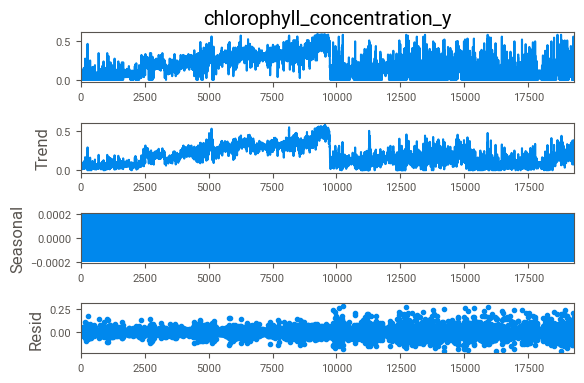

In [377]:
##example of seasonal decomposition (perioud 2)
series = df_merge1_row_sun2.chlorophyll_concentration_y
result = seasonal_decompose(series, period=2, model='additive')

result.plot()
plt.show()

In [378]:
df_merge1_row_sun3=df_merge1_row_sun2.copy()

In [ ]:
#df_merge1_row_sun3.to_csv("C:/Users/dalit/DataScience/project/final_project/df_merge1_row_sun3.csv")

In [379]:
### downloded the file
path = "C:/Users/dalit/DataScience/project/final_project/df_merge1_row_sun3.csv"

In [380]:
### user pandas to read the csv (read_csv())
### show the top rows
df_merge1_row_sun3 = pd.read_csv(path)
df_merge1_row_sun3

,Unnamed: 0,Unnamed: 0.1,d_stamp_x,T_round1_x,chl_pred_x,chlorophyll_concentration_x,avg_g,std_g,x,g_14,g_50,g_59,g_77,g_86,depth_103,depth_85,depth_127,depth_95,depth_129,depth_99,depth_89,depth_91,depth_131,depth_115,depth_83,depth_121,depth_97,depth_101,depth_93,depth_125,depth_87,depth_117,depth_123,depth_119,[i]_na,wind_speed,dominant_period_x,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,East_cm_s,North_cm_s,Abs_Speed_cm_s,g_5,g_23_x,g_68,temp_avg,...,Std_Tilt_Deg,Strength_dB_y,Strength_dB_x,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgLinearAdjVal,AvgVolt,turbidity_units,Tilt_Y_Deg,Heading_DegM_x,Direction_DegM_x,Temperature_DegC_x,Temperature_DegC_y,Max_Tilt_Deg_x,Heading_DegM_y,SP_Std_cm_s_y,SP_Std_cm_s_x,Direction_DegM_y,Max_Tilt_Deg_y,significant_height_y,mean_period_y,significant_height_x,mean_period_x,Unnamed: 0_y,T_round1_y,d_stamp1,year,hour,minute,T_round2,am/pm,d_stamp_y,Sun_Declin_deg,Sunrise_Time_LST,Sunset_Time_LST,Sunlight_Duration_minutes,True_Solar_Time _min,chl_change,chl_mov_avg,L/D,seasonality2,trend2,seasonality12,trend12,seasonality24,trend24,seasonality48,trend48
0,0,0,26/07/2017,00:00,0.0357,0.0714,24.538571,3.926277,0,12.0,8.0,8.0,7.0,11,12,12.0,11,13,11,12,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,1,3,10,10,2,2,9,8,7,10,16,16,13,13,13,...,1.341,-23.242,-23.242,2396.0,0.851,85.104,2290.2,29.219,0.592,0.177,2.111,268.558,354.116,29.656,29.656,6.658,268.558,15.587,15.587,354.116,6.658,0.350,3.569,0.350,3.569,0,00:00,26/07/2017,26/07/2017,0,0,12:00,PM,26/07/2017,19.341710,04:49:37,18:43:52,834.248455,733.260372,-0.035,0.052479,0,0.000806,NaN,0.003868,NaN,0.006314,NaN,0.009250,NaN
1,1,1,26/07/2017,00:30,0.0833,0.0952,24.542857,3.972936,1,12.0,8.0,8.0,7.0,11,12,12.0,11,13,11,13,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,2,5,10,10,2,2,8,8,7,10,16,16,13,13,13,...,1.299,-23.277,-23.277,2395.4,0.849,84.860,2285.6,27.998,0.580,0.189,1.981,271.677,359.196,29.710,29.710,5.848,271.677,14.462,14.462,359.196,5.848,0.368,3.535,0.368,3.535,1,00:30,26/07/2017,26/07/2017,0,30,12:30,PM,26/07/2017,19.341710,04:49:37,18:43:52,834.248455,733.260372,-0.012,0.051750,0,-0.000806,0.086275,0.002694,NaN,0.006489,NaN,0.004519,NaN
2,2,2,26/07/2017,01:00,0.0595,0.0833,24.651429,3.982476,2,12.0,11.0,8.0,6.0,11,12,12.0,11,12,11,13,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,2,5,10,10,2,2,9,9,7,10,16,16,12,14,13,...,1.266,-23.103,-23.103,2395.6,0.849,84.860,2289.4,28.974,0.590,0.183,2.221,275.965,357.789,29.775,29.775,5.827,275.965,13.411,13.411,357.789,5.827,0.383,3.632,0.383,3.632,2,01:00,26/07/2017,26/07/2017,1,0,01:00,AM,26/07/2017,19.341710,04:49:37,18:43:52,834.248455,733.260372,-0.023,0.051500,0,0.000806,0.089250,0.007530,NaN,0.013554,NaN,0.007960,NaN
3,3,3,26/07/2017,01:30,0.0833,0.0952,24.647143,4.040803,3,12.0,11.0,8.0,6.0,11,12,12.0,11,13,11,12,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,1,4,10,10,2,2,8,8,7,10,16,16,12,14,13,...,1.349,-22.739,-22.739,2396.8,0.851,85.104,2291.6,29.463,0.595,0.189,2.145,277.912,358.542,29.807,29.807,7.250,277.912,12.593,12.593,358.542,7.250,0.373,3.516,0.373,3.516,3,01:30,26/07/2017,26/07/2017,1,30,01:30,AM,26/07/2017,19.341710,04:49:37,18:43:52,834.248455,733.260372,-0.012,0.051021,0,-0.000806,0.095200,-0.001597,NaN,0.001452,NaN,0.010057,NaN
4,4,4,26/07/2017,02:00,0.0476,0.1071,24.677143,4.041587,4,12.0,10.0,8.0,6.0,11,12,12.0,11,13,11,12,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,2,5,10,10,2,1,8,8,7,10,16,16,12,14,13,...,1.233,-22.449,-22.449,2391.4,0.839,83.883,2291.0,29.463,0.595,0.201,2.222,276.629,356.702,29.849,29.849,6.186,276.629,11.526,11.526,356.702,6.186,0.344,3.570,0.344,3.570,4,02:00,26/07/2017,26/07/2017,2,0,02:00,AM,26/07/2017,19.341710,04:49:37,18:43:52,834.248455,733.260372,-0.059,0.050771,0,0.000806,0.098175,-0.002606,NaN,0.002395,NaN,0.002356,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

In [381]:
df_merge1_row_sun3.describe()

,Unnamed: 0,Unnamed: 0.1,chl_pred_x,chlorophyll_concentration_x,avg_g,std_g,x,g_14,g_50,g_59,g_77,g_86,depth_103,depth_85,depth_127,depth_95,depth_129,depth_99,depth_89,depth_91,depth_131,depth_115,depth_83,depth_121,depth_97,depth_101,depth_93,depth_125,depth_87,depth_117,depth_123,depth_119,[i]_na,temperature,humidity,dewpoint,wind_direction,pressure,BAROMETER,chl_pred_y,Unnamed: 0_x,dominant_period_y,chlorophyll_concentration_y,Tilt_X_Deg,Abs_Tilt_Deg,Std_Tilt_Deg,Strength_dB_y,Strength_dB_x,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgLinearAdjVal,AvgVolt,turbidity_units,Tilt_Y_Deg,Heading_DegM_x,Direction_DegM_x,Temperature_DegC_x,Temperature_DegC_y,Max_Tilt_Deg_x,Heading_DegM_y,SP_Std_cm_s_y,SP_Std_cm_s_x,Direction_DegM_y,Max_Tilt_Deg_y,significant_height_y,mean_period_y,significant_height_x,mean_period_x,Unnamed: 0_y,hour,minute,Sun_Declin_deg,Sunlight_Duration_minutes,True_Solar_Time _min,chl_change,chl_mov_avg,L/D,seasonality2,trend2,seasonality12,trend12,seasonality24,trend24,seasonality48,trend48
count,19289.000000,19289.000000,19289.000000,19289.000000,15563.000000,15506.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.0,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.00000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,19289.000000,1.928900e+04,19288.000000,1.928900e+04,19283.000000,1.928900e+04,19277.000000,1.928900e+04,19265.000000
mean,9644.000000,9658.051947,0.200526,0.199819,37.893380,34.870923,9658.051947,10.825515,10.468848,10.743388,8.323793,8.300638,12.251957,12.316037,10.243040,12.249676,10.244440,12.068329,12.068692,12.411214,10.249520,12.252735,12.239026,10.249987,12.165379,12.296117,12.087459,10.254394,12.455346,10.222873,10.257193,10.243818,0.0,22.374058,64.271725,16.051154,164.674403,971.195640,971.332472,0.201163,9658.051947,5.063162,0.191278,-2.708707,4.061481,1.599377,-16.830184,-16.830184,2217.245014,0.626141,62.61383,2173.054006,23.098136,0.518245,0.740502,1.007258,187.598020,130.622225,24.462232,24.462232,9.174424,187.598020,20.318746,20.318746,130.622225,9.174424,0.609707,3.795281,0.609707,3.795281,9658.051947,11.459796,16.176214,-9.606973,675.739768,746.504608,-0.000131,0.191550,0.470268,4.178677e-08,0.199394,5.126412e-07,0.199423,9.950564e-07,0.199467,-4.129952e-07,0.199556
std,5568.399007,5583.173897,0.186656,0.186427,940.014651,2100.002801,5583.173897,3.640321,3.809793,3.681796,3.406515,3.411921,2.633214,1.499266,2.257053,2.614503,2.254684,2.641750,2.607915,1.335833,2.246386,2.662306,1.559233,2.252776,2.643580,1.810230,2.621770,2.229086,1.088447,2.320728,2.224271,2.260928,0.0,6.261044,16.879887,5.974194,104.874173,204.698854,204.725626,0.175308,5583.173897,1.945920,0.121202,1.504107,1.735201,0.760202,6.486100,6.486100,468.981185,0.165253,16.52510,458.229805,6.474993,0.117258,0.616463,2.269787,113.666973,110.905994,6.231133,6.231133,4.573815,113.666973,9.346545,9.346545,110.905994,4.573815,0.485494,1.130736,0.485494,1.130736,5583.173897,6.918135,16.064818,11.940623,65.039473,8.903326,0.080186,0.106719,0.499128,8.060459e-04,0.161210,3.236331e-03,0.141178,5.240535e-03,0.135175,7.119039e-03,0.130391
min,0.000000,0.000000,-2.081200,-2.081200,9.730000,0.000000,0.000000,1.000000,1.000000

In [382]:
##correlation between all variables in the DataFrame
df_merge1_row_sun3_corr=df_merge1_row_sun3.corr(method='spearman').sort_values(ascending=True,by='chl_pred_y')
df_merge1_row_sun3_corr.head(200)


,Unnamed: 0,Unnamed: 0.1,chl_pred_x,chlorophyll_concentration_x,avg_g,std_g,x,g_14,g_50,g_59,g_77,g_86,depth_103,depth_85,depth_127,depth_95,depth_129,depth_99,depth_89,depth_91,depth_131,depth_115,depth_83,depth_121,depth_97,depth_101,depth_93,depth_125,depth_87,depth_117,depth_123,depth_119,[i]_na,temperature,humidity,dewpoint,wind_direction,pressure,BAROMETER,chl_pred_y,Unnamed: 0_x,dominant_period_y,chlorophyll_concentration_y,Tilt_X_Deg,Abs_Tilt_Deg,Std_Tilt_Deg,Strength_dB_y,Strength_dB_x,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgLinearAdjVal,AvgVolt,turbidity_units,Tilt_Y_Deg,Heading_DegM_x,Direction_DegM_x,Temperature_DegC_x,Temperature_DegC_y,Max_Tilt_Deg_x,Heading_DegM_y,SP_Std_cm_s_y,SP_Std_cm_s_x,Direction_DegM_y,Max_Tilt_Deg_y,significant_height_y,mean_period_y,significant_height_x,mean_period_x,Unnamed: 0_y,hour,minute,Sun_Declin_deg,Sunlight_Duration_minutes,True_Solar_Time _min,chl_change,chl_mov_avg,L/D,seasonality2,trend2,seasonality12,trend12,seasonality24,trend24,seasonality48,trend48
std_g,-7.273249e-02,-7.273249e-02,-0.687435,-0.693616,0.375124,1.000000,-7.273249e-02,-0.260979,-0.642311,-0.561890,0.007673,-0.015856,0.275874,0.140631,-0.253031,0.269476,-0.252050,-0.047273,0.243013,0.000470,-0.250757,-0.290881,0.116930,-0.263663,-0.036631,0.100353,0.054994,-0.251248,0.164880,-0.257582,-0.252556,-0.254090,NaN,0.677967,0.199198,0.647804,-0.120078,-0.506568,-0.512318,-0.685608,-7.273249e-02,-0.127106,-0.694411,0.383157,-0.372592,-0.348993,-0.257312,-0.257312,0.169603,0.169590,0.169590,0.664492,0.664512,0.664512,0.160912,-0.235008,0.088413,0.108793,0.679586,0.679586,-0.355061,0.088413,-0.124109,-0.124109,0.108793,-0.355061,-0.214560,-0.110636,-0.214560,-0.110636,-7.273249e-02,0.012589,0.002527,0.722484,0.722484,-0.084714,-0.001074,-0.781005,0.087017,0.000613,-0.718995,4.495116e-04,-0.750550,0.000792,-0.765326,-0.000436,-0.782844
Sun_Declin_deg,-3.213757e-01,-3.213757e-01,-0.685707,-0.688501,0.663225,0.722484,-3.213757e-01,-0.010206,-0.285668,-0.258909,0.202553,0.264240,0.214448,0.188583,0.049729,0.283132,0.049771,0.113260,0.289907,0.078592,0.049370,-0.078082,0.150985,0.039838,0.091305,0.000977,0.141785,0.051862,0.217291,0.042468,0.050893,0.047952,NaN,0.787821,0.242521,0.749816,-0.124260,-0.630255,-0.639238,-0.675795,-3.213757e-01,-0.053186,-0.680237,0.288254,-0.332405,-0.363065,-0.209444,-0.209444,0.221528,0.221541,0.221539,0.776622,0.776506,0.776504,-0.025287,0.023885,0.168175,0.057628,0.816091,0.816091,-0.359609,0.168175,-0.150166,-0.150166,0.057628,-0.359609,-0.178228,-0.026614,-0.178228,-0.026614,-3.213757e-01,0.001666,-0.000495,1.000000,1.000000,-0.143456,0.002187,-0.771555,0.085475,-0.000076,-0.703651,2.894860e-04,-0.736334,0.000711,-0.750817,0.000703,-0.764274
Sunlight_Duration_minutes,-3.213757e-01,-3.213757e-01,-0.685707,-0.688501,0.663225,0.722484,-3.213757e-01,-0.010206,-0.285668,-0.258909,0.202553,0.264240,0.214448,0.188583,0.049729,0.283132,0.049771,0.113260,0.289907,0.078592,0.049370,-0.078082,0.150985,0.039838,0.091305,0.000977,0.141785,0.051862,0.217291,0.042468,0.050893,0.047952,NaN,0.787821,0.242521,0.749816,-0.124260,-0.630255,-0.639238,-0.675795,-3.213757e-01,-0.053186,-0.680237,0.288254,-0.332405,-0.363065,-0.209444,-0.209444,0.221528,0.221541,0.221539,0.776622,0.776506,0.776504,-0.025287,0.023885,0.168175,0.057628,0.816091,0.816091,-0.359609,0.168175,-0.150166,-0.150166,0.057628,-0.359609,-0.178228,-0.026614,-0.178228,-0.026614,-3.213757e-01,0.001666,-0.000495,1.000000,1.000000,-0.143456,0.002187,-0.771555,0.085475,-0.000076,-0.703651,2.894860e-04,-0.736334,0.000711,-0.750817,0.000703,-0.764274
Temperature_DegC_y,-2.356199e-01,-2.356199e-01,-0.618557,-0.624157,0.755360,0.679586,-2.356199e-01,0.068770,-0.176961,-0.134956,0.496758,0.535135,0.511564,0.346385,0.180208,0.532093,0.180222,0.309964,0.515900,0.254569,0.180417,0.104884,0.305911,0.174233,0.309837,0.192876,0.389532,0.181982,0.379387,0.174959,0.181438,0.178971,NaN,0.950264,0.328220,0.888289,0.0

# EDA of the new features

<AxesSubplot:>

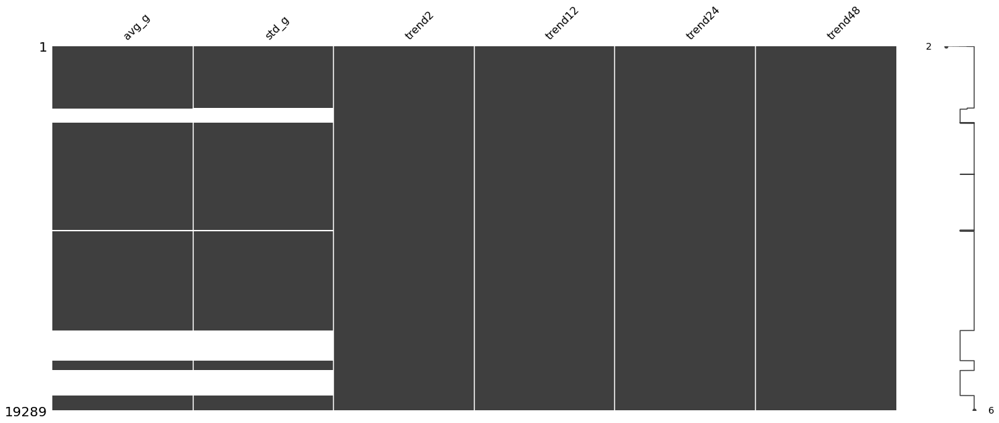

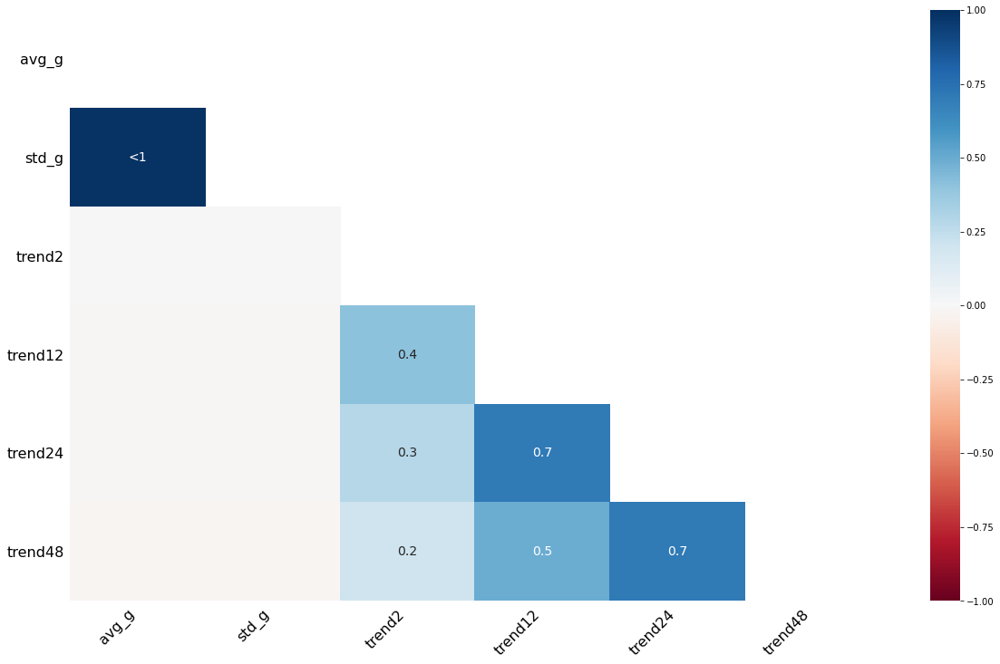

In [21]:
import missingno as msno
df = df_merge1_row_sun3.columns[df_merge1_row_sun3.isnull().any()].tolist()
msno.matrix(df_merge1_row_sun3[df])
msno.heatmap(df_merge1_row_sun3)

In [ ]:
#pd.set_option("max_rows", None)

In [383]:
df_merge1_row_sun3.isnull().sum().sort_values(ascending=False,axis=0).head(100)

std_g                          3783
avg_g                          3726
trend48                          24
trend24                          12
trend12                           6
trend2                            1
magnitude_2                       0
g_68                              0
depth_45                          0
depth_15                          0
depth_73                          0
depth_69                          0
depth_39                          0
temp_avg                          0
g_5                               0
g_23_x                            0
Abs_Speed_cm_s                    0
depth_3                           0
North_cm_s                        0
East_cm_s                         0
winddirection                     0
gustdirection                     0
depth_51                          0
depth_81                          0
depth_21                          0
depth_53                          0
depth_13                          0
depth_57                    

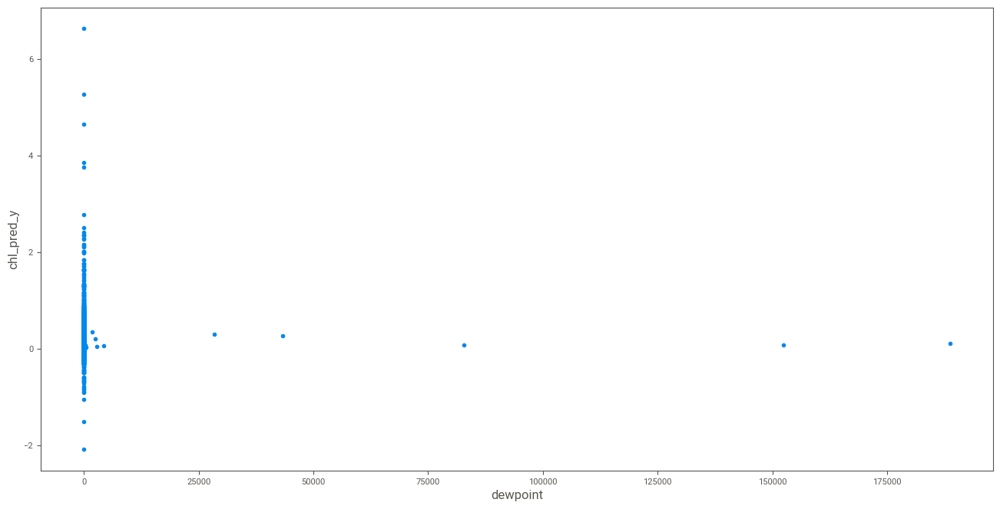

In [384]:
fig, ax = plt.subplots(figsize=(16,8))
ax.scatter(df_merge1_row_sun3['std_g'], df_merge1_row_sun3['chl_pred_x'])
#ax.scatter(df_merge1_row_sun3['avg_g'], df_merge1_row_sun3['chl_pred_y'])
ax.set_xlabel('dewpoint')
ax.set_ylabel('chl_pred_y')
plt.show()

<AxesSubplot:xlabel='avg_g'>

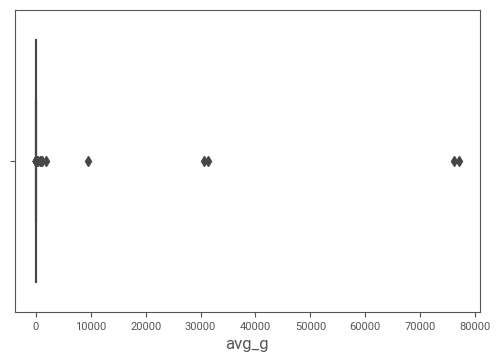

In [385]:
import seaborn as sns
sns.boxplot(x=df_merge1_row_sun3['avg_g'])

#sns.boxplot(x=df_merge1_row_sun3['turbidity_units'])

<AxesSubplot:xlabel='chl_mov_avg'>

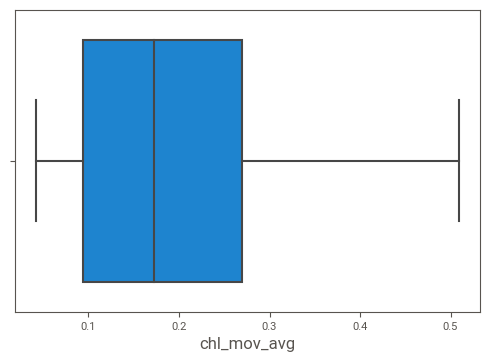

In [386]:
sns.boxplot(x=df_merge1_row_sun3['chl_mov_avg'])

<AxesSubplot:xlabel='trend48'>

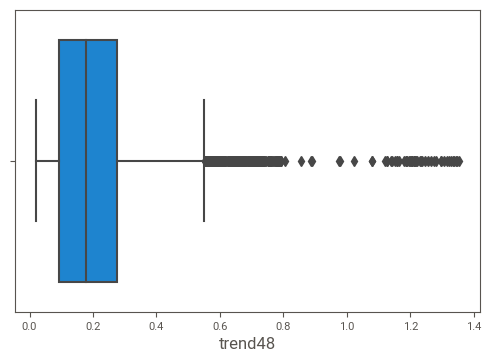

In [388]:
sns.boxplot(x=df_merge1_row_sun3['trend48'])

<AxesSubplot:xlabel='L/D'>

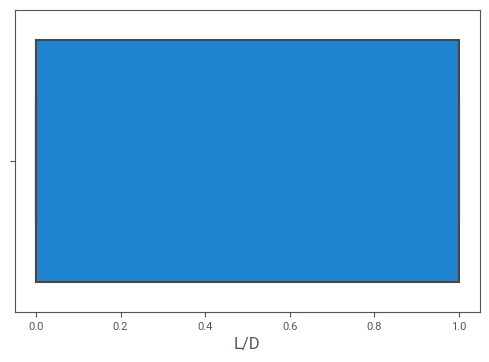

In [389]:
sns.boxplot(x=df_merge1_row_sun3['L/D'])

<AxesSubplot:xlabel='Sunlight_Duration_minutes'>

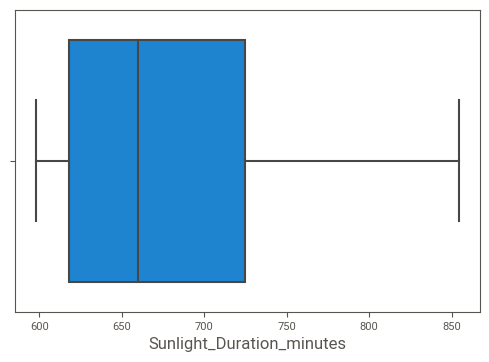

In [390]:
sns.boxplot(x=df_merge1_row_sun3['Sunlight_Duration_minutes'])

<AxesSubplot:xlabel='Sun_Declin_deg'>

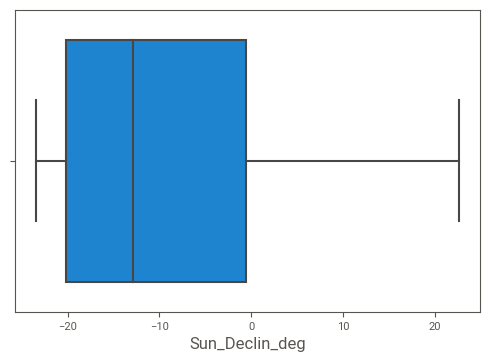

In [391]:
sns.boxplot(x=df_merge1_row_sun3['Sun_Declin_deg'])

In [392]:
list(df_merge1_row_sun3)

['Unnamed: 0',
 'Unnamed: 0.1',
 'd_stamp_x',
 'T_round1_x',
 'chl_pred_x',
 'chlorophyll_concentration_x',
 'avg_g',
 'std_g',
 'x',
 'g_14',
 'g_50',
 'g_59',
 'g_77',
 'g_86',
 'depth_103',
 'depth_85',
 'depth_127',
 'depth_95',
 'depth_129',
 'depth_99',
 'depth_89',
 'depth_91',
 'depth_131',
 'depth_115',
 'depth_83',
 'depth_121',
 'depth_97',
 'depth_101',
 'depth_93',
 'depth_125',
 'depth_87',
 'depth_117',
 'depth_123',
 'depth_119',
 '[i]_na',
 'wind_speed',
 'dominant_period_x',
 'north',
 'east',
 'magnitude_1',
 'magnitude_2',
 'gustdirection',
 'winddirection',
 'East_cm_s',
 'North_cm_s',
 'Abs_Speed_cm_s',
 'g_5',
 'g_23_x',
 'g_68',
 'temp_avg',
 'depth_39',
 'depth_69',
 'depth_73',
 'depth_15',
 'depth_45',
 'depth_51',
 'depth_3',
 'depth_21',
 'depth_23',
 'depth_81',
 'depth_11',
 'depth_41',
 'depth_77',
 'depth_35',
 'depth_65',
 'depth_49',
 'depth_53',
 'depth_31',
 'depth_59',
 'depth_61',
 'depth_27',
 'depth_57',
 'depth_13',
 'depth_75',
 'depth_47',
 '

In [393]:
##create df from the new features
df_new=df_merge1_row_sun3[['chl_pred_y', 'avg_g',
 'std_g','am/pm','Sun_Declin_deg',
 'Sunlight_Duration_minutes',
 'True_Solar_Time _min',
 'chl_change',
 'chl_mov_avg',
 'L/D',
 'seasonality2',
 'trend2',
 'seasonality12',
 'trend12',
 'seasonality24',
 'trend24',
 'seasonality48',
 'trend48']]
df_new

,chl_pred_y,avg_g,std_g,am/pm,Sun_Declin_deg,Sunlight_Duration_minutes,True_Solar_Time _min,chl_change,chl_mov_avg,L/D,seasonality2,trend2,seasonality12,trend12,seasonality24,trend24,seasonality48,trend48
0,0.036,24.538571,3.926277,PM,19.341710,834.248455,733.260372,-0.035,0.052479,0,0.000806,NaN,0.003868,NaN,0.006314,NaN,0.009250,NaN
1,0.083,24.542857,3.972936,PM,19.341710,834.248455,733.260372,-0.012,0.051750,0,-0.000806,0.086275,0.002694,NaN,0.006489,NaN,0.004519,NaN
2,0.060,24.651429,3.982476,AM,19.341710,834.248455,733.260372,-0.023,0.051500,0,0.000806,0.089250,0.007530,NaN,0.013554,NaN,0.007960,NaN
3,0.083,24.647143,4.040803,AM,19.341710,834.248455,733.260372,-0.012,0.051021,0,-0.000806,0.095200,-0.001597,NaN,0.001452,NaN,0.010057,NaN
4,0.048,24.677143,4.041587,AM,19.341710,834.248455,733.260372,-0.059,0.050771,0,0.000806,0.098175,-0.002606,NaN,0.002395,NaN,0.002356,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19284,0.351,23.820000,0.255421,AM,-21.239724,611.650718,752.056426,-0.266,0.263600,1,0.000806,0.305525,0.003868,0.298971,0.001487,0.312331,0.011198,0.305147
19285,0.315,23.916667,0.077374,AM,-21.239724,611.650718,752.056426,-0.278,0.263000,0,-0.000806,0.302500,0.002694,0.299979,-0.001026,0.309558,-0.002683,0.307668
19286,0.339,23.875000,0.215105,AM,-21.239724,611.650718,752.056426,-0.254,0.258000,0,0.000806,0.302500,0.007530,0.300483,0.001481,0.307037,0.001928,0.307164
19287,0.339,23.881667,0.228947,AM,-21.239724,611.650718,752.056426,-0.278,0.260000,0,-0.000806,0.296450,-0.001597,0.300483,-0.004693,0.303256,0.003181,0.301366


In [394]:
##changing the object to numbers
df_new['am/pm']=np.where((df_new['am/pm']=='AM'),1,0)


C:\Users\dalit\anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [395]:
#change to numeric for the sweetwiz
df_new['am/pm'] = pd.to_numeric(df_new['am/pm'], errors='coerce')
df_new['L/D'] = pd.to_numeric(df_new['L/D'], errors='coerce')
df_new.dtypes

C:\Users\dalit\anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\dalit\anaconda3\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


chl_pred_y                   float64
avg_g                        float64
std_g                        float64
am/pm                          int32
Sun_Declin_deg               float64
Sunlight_Duration_minutes    float64
True_Solar_Time _min         float64
chl_change                   float64
chl_mov_avg                  float64
L/D                            int64
seasonality2                 float64
trend2                       float64
seasonality12                float64
trend12                      float64
seasonality24                float64
trend24                      float64
seasonality48                float64
trend48                      float64
dtype: object

In [396]:
df_new
df_new1=df_new.copy()

In [397]:
##creating a loop for defining outliers and transform it to o,1
for i in df_new1.columns:
    Q1=df_new1[i].quantile(0.25)
    Q3=df_new1[i].quantile(0.75)
    IQR = Q3 - Q1
    low=Q1-1.5* IQR
    high=Q3+1.5* IQR
    df_new1[i]=np.where((df_new1[i]>high)|(df_new1[i]<low),0,1)
df_new1

,chl_pred_y,avg_g,std_g,am/pm,Sun_Declin_deg,Sunlight_Duration_minutes,True_Solar_Time _min,chl_change,chl_mov_avg,L/D,seasonality2,trend2,seasonality12,trend12,seasonality24,trend24,seasonality48,trend48
0,1,1,1,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1
1,1,1,1,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1
2,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
3,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
4,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19284,1,1,1,1,1,1,1,0,1,1,1,1,1,1,1,1,1,1
19285,1,1,1,1,1,1,1,0,1,1,1,1,1,1,1,1,1,1
19286,1,1,1,1,1,1,1,0,1,1,1,1,1,1,1,1,1,1
19287,1,1,1,1,1,1,1,0,1,1,1,1,1,1,1,1,1,1


In [398]:
df_new2=df_new1.copy()
df_new2.dtypes

chl_pred_y                   int32
avg_g                        int32
std_g                        int32
am/pm                        int32
Sun_Declin_deg               int32
Sunlight_Duration_minutes    int32
True_Solar_Time _min         int32
chl_change                   int32
chl_mov_avg                  int32
L/D                          int32
seasonality2                 int32
trend2                       int32
seasonality12                int32
trend12                      int32
seasonality24                int32
trend24                      int32
seasonality48                int32
trend48                      int32
dtype: object

In [399]:
from scipy.stats import ks_2samp
from scipy import stats
df_new2 = df_new2.replace(0,np.nan)
df_new2
df_new2.describe(include='all')

from scipy import stats
ot=[]
for a in df_new.columns:
    for b in df_new1.columns:
        try:
            dict={}
            test = stats.ks_2samp(df_new[a],df_new1[b])
            dict['names']=a
            dict['namesb']=b
            dict['stat']=test.statistic
            dict['pval']=test.pvalue
            ot.append(dict)
        except FloatingPointError:
            print('error')
ot=pd.DataFrame(ot)      

ot2=pd.DataFrame(ot)
ot2

ot3=ot2.loc[(ot2.names==ot2.namesb)] #& (ot2.pval<0.05)] 
ot3.head(100)

,names,namesb,stat,pval
0,chl_pred_y,chl_pred_y,0.979885,0.0
19,avg_g,avg_g,1.000000,0.0
38,std_g,std_g,0.628752,0.0
57,am/pm,am/pm,0.000000,1.0
76,Sun_Declin_deg,Sun_Declin_deg,0.780652,0.0
95,Sunlight_Duration_minutes,Sunlight_Duration_minutes,1.000000,0.0
114,True_Solar_Time _min,True_Solar_Time _min,1.000000,0.0
133,chl_change,chl_change,0.905179,0.0
152,chl_mov_avg,chl_mov_avg,1.000000,0.0
171,L/D,L/D,0.529732,0.0


In [403]:
##creating new df for outliers detection
outliers_out=df_new.copy()
outliers=df_new.copy()
#creating a loop
for i in outliers_out.columns:
    Q1=outliers_out[i].quantile(0.25)
    Q3=outliers_out[i].quantile(0.75)
    IQR = Q3 - Q1
    low=Q1-1.5* IQR
    high=Q3+1.5* IQR
    outliers_out[i]=np.where((outliers_out[i]>high)|(outliers_out[i]<low),np.nan,outliers_out[i])
    


In [401]:
#this code contains fisher z transformation to look at statistic significancy between correlation comparison
from __future__ import division

__author__ = 'psinger'

import numpy as np
from scipy.stats import t, norm
from math import atanh, pow
from numpy import tanh

def rz_ci(r, n, conf_level = 0.95):
    zr_se = pow(1/(n - 3), .5)
    moe = norm.ppf(1 - (1 - conf_level)/float(2)) * zr_se
    zu = atanh(r) + moe
    zl = atanh(r) - moe
    return tanh((zl, zu))

def rho_rxy_rxz(rxy, rxz, ryz):
    num = (ryz-1/2.*rxy*rxz)*(1-pow(rxy,2)-pow(rxz,2)-pow(ryz,2))+pow(ryz,3)
    den = (1 - pow(rxy,2)) * (1 - pow(rxz,2))
    return num/float(den)

def dependent_corr(xy, xz, yz, n, twotailed=True, conf_level=0.95, method='steiger'):
    """
    Calculates the statistic significance between two dependent correlation coefficients
    @param xy: correlation coefficient between x and y
    @param xz: correlation coefficient between x and z
    @param yz: correlation coefficient between y and z
    @param n: number of elements in x, y and z
    @param twotailed: whether to calculate a one or two tailed test, only works for 'steiger' method
    @param conf_level: confidence level, only works for 'zou' method
    @param method: defines the method uses, 'steiger' or 'zou'
    @return: t and p-val
    """
    if method == 'steiger':
        d = xy - xz
        determin = 1 - xy * xy - xz * xz - yz * yz + 2 * xy * xz * yz
        av = (xy + xz)/2
        cube = (1 - yz) * (1 - yz) * (1 - yz)

        t2 = d * np.sqrt((n - 1) * (1 + yz)/(((2 * (n - 1)/(n - 3)) * determin + av * av * cube)))
        p = 1 - t.cdf(abs(t2), n - 3)

        if twotailed:
            p *= 2

        return t2, p
    elif method == 'zou':
        L1 = rz_ci(xy, n, conf_level=conf_level)[0]
        U1 = rz_ci(xy, n, conf_level=conf_level)[1]
        L2 = rz_ci(xz, n, conf_level=conf_level)[0]
        U2 = rz_ci(xz, n, conf_level=conf_level)[1]
        rho_r12_r13 = rho_rxy_rxz(xy, xz, yz)
        lower = xy - xz - pow((pow((xy - L1), 2) + pow((U2 - xz), 2) - 2 * rho_r12_r13 * (xy - L1) * (U2 - xz)), 0.5)
        upper = xy - xz + pow((pow((U1 - xy), 2) + pow((xz - L2), 2) - 2 * rho_r12_r13 * (U1 - xy) * (xz - L2)), 0.5)
        return lower, upper
    else:
        raise Exception('Wrong method!')

def independent_corr(xy, ab, n, n2 = None, twotailed=True, conf_level=0.95, method='fisher'):
    """
    Calculates the statistic significance between two independent correlation coefficients
    @param xy: correlation coefficient between x and y
    @param xz: correlation coefficient between a and b
    @param n: number of elements in xy
    @param n2: number of elements in ab (if distinct from n)
    @param twotailed: whether to calculate a one or two tailed test, only works for 'fisher' method
    @param conf_level: confidence level, only works for 'zou' method
    @param method: defines the method uses, 'fisher' or 'zou'
    @return: z and p-val
    """

    if method == 'fisher':
        xy_z = 0.5 * np.log((1 + xy)/(1 - xy))
        ab_z = 0.5 * np.log((1 + ab)/(1 - ab))
        if n2 is None:
            n2 = n

        se_diff_r = np.sqrt(1/(n - 3) + 1/(n2 - 3))
        diff = xy_z - ab_z
        z = abs(diff / se_diff_r)
        p = (1 - norm.cdf(z))
        if twotailed:
            p *= 2

        return z, p
    elif method == 'zou':
        L1 = rz_ci(xy, n, conf_level=conf_level)[0]
        U1 = rz_ci(xy, n, conf_level=conf_level)[1]
        L2 = rz_ci(ab, n2, conf_level=conf_level)[0]
        U2 = rz_ci(ab, n2, conf_level=conf_level)[1]
        lower = xy - ab - pow((pow((xy - L1), 2) + pow((U2 - ab), 2)), 0.5)
        upper = xy - ab + pow((pow((U1 - xy), 2) + pow((ab - L2), 2)), 0.5)
        return lower, upper
    else:
        raise Exception('Wrong method!')

#print dependent_corr(.40, .50, .10, 103, method='steiger')
#print independent_corr(0.5 , 0.6, 103, 103, method='fisher')

#print dependent_corr(.396, .179, .088, 200, method='zou')
#print independent_corr(.560, .588, 100, 353, method='zou')

In [404]:
    
for a in outliers.columns:
    for b in outliers_out.columns:
        fisher=(0,0) 
        try: 
            fisher=independent_corr(df_new[a].corr(outliers.chl_pred_y, method='spearman'), outliers_out[b].corr(outliers.chl_pred_y, method='spearman'), outliers.shape[0],outliers_out.shape[0], twotailed=True, conf_level=0.95, method='fisher')
        except FloatingPointError:
            print('error')
            dict={}
            dict['a']=a
            dict['b']=b
            dict['p']=fisher[0]
            dict['r']=fisher[1]
            ot.append(dict)
            
            

error


C:\Users\dalit\anaconda3\lib\site-packages\scipy\stats\stats.py:4196: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())


TypeError: Can only append a dict if ignore_index=True

In [405]:
#define loops for correlations between each variable to y, before and after outliers removal
dfa=[]
for a in outliers.columns:
    otl_a=outliers[a].corr(outliers.chl_pred_y, method='spearman')
    dict={}
    dict['names']=a
    dict['corr_a']=otl_a
    dfa.append(dict)
    dfa2=pd.DataFrame(dfa)

dfb=[]
for b in outliers_out.columns:
    otl_b=outliers_out[b].corr(outliers.chl_pred_y, method='spearman')
    dict={}
    dict['names']=b
    dict['corr_b']=otl_b
    dfb.append(dict)
    dfb2=pd.DataFrame(dfb)
    
###inner merge courses and classrooms by CoureId
cor=pd.merge(dfb2,dfa2,on='names')
cor.head(100)

,names,corr_b,corr_a
0,chl_pred_y,1.000000,1.000000
1,avg_g,-0.549198,-0.545440
2,std_g,-0.686038,-0.685608
3,am/pm,NaN,0.004049
4,Sun_Declin_deg,-0.675795,-0.675795
5,Sunlight_Duration_minutes,-0.675795,-0.675795
6,True_Solar_Time _min,-0.083390,-0.083390
7,chl_change,0.176206,0.181206
8,chl_mov_avg,0.856420,0.856420
9,L/D,-0.133088,-0.133088


In [406]:
#design a loop for fisher z transformation function to which each 
#correlation value from the cor df will be added

fisher_list=[]
for index, row in cor.iterrows():
    #print(row['pval_a']==row['pval_b'])
    try:
        fisher=independent_corr(row['corr_a'],row['corr_b'], outliers.shape[0],outliers_out.shape[0], twotailed=True, conf_level=0.95, method='fisher')
        dict={}
        dict['names']=row['names']
        dict['corr_a']=row['corr_a']
        dict['corr_b']=row['corr_b']
        dict['z']=fisher[0]
        dict['p']=fisher[1]
        fisher_list.append(dict)
    except FloatingPointError:
        print(row['names']+str(row['corr_a'])+";"+str(row['corr_b']))
    except ZeroDivisionError:
        print(row['names']+str(row['corr_a'])+";"+str(row['corr_b']))
fisher_df=pd.DataFrame(fisher_list)  

#merge between fisher df to ot3(ks test)
df=pd.merge(ot3,fisher_df,on='names',how='right')
df.head(100)

##create a df 
dfcorr=pd.DataFrame(df)
dfcorr   

#filtering the variables in which their distribution (ks test) and correlation
#with y have not been changed after outliers removal
dfcorr= pd.concat([dfcorr.loc[(df.p>0.05) & (dfcorr.pval>0.05)],dfcorr.loc[(df.p>0.05) & (dfcorr.pval<0.05)]])
#dfcorr=dfcorr.loc[(df.p>0.05) | dfcorr.loc(df.pval>0.05)]
#dfcorr=dfcorr.loc[(df.p>0.05) | (dfcorr.pval<0.05)]
#dfcorr=dfcorr.loc[(df.p>0.05) & (dfcorr.pval<0.05)]
dfcorr

am/pm0.004049325397496902;nan


,names,namesb,stat,pval,corr_a,corr_b,z,p
0,chl_pred_y,chl_pred_y,0.979885,0.0,1.000000,1.000000,0.000000,1.000000
1,avg_g,avg_g,1.000000,0.0,-0.545440,-0.549198,0.526778,0.598348
2,std_g,std_g,0.628752,0.0,-0.685608,-0.686038,0.079782,0.936411
3,Sun_Declin_deg,Sun_Declin_deg,0.780652,0.0,-0.675795,-0.675795,0.000000,1.000000
4,Sunlight_Duration_minutes,Sunlight_Duration_minutes,1.000000,0.0,-0.675795,-0.675795,0.000000,1.000000
5,True_Solar_Time _min,True_Solar_Time _min,1.000000,0.0,-0.083390,-0.083390,0.000000,1.000000
6,chl_change,chl_change,0.905179,0.0,0.181206,0.176206,0.507265,0.611969
7,chl_mov_avg,chl_mov_avg,1.000000,0.0,0.856420,0.856420,0.000000,1.000000
8,L/D,L/D,0.529732,0.0,-0.133088,-0.133088,0.000000,1.000000
9,seasonality2,seasonality2,1.000000,0.0,-0.002738,-0.002738,0.000000,1.000000


In [407]:
dfcorr.names.values

##creating new df for outliers detection
outliers= df_new.copy()

#remove outliers from variables that were filtered by the KS and fisher test (df=dfcorr)
for index, row in dfcorr.iterrows():
    Q1=outliers[row['names']].quantile(0.25)
    Q3=outliers[row['names']].quantile(0.75)
    IQR = Q3 - Q1
    low=Q1-1.5* IQR
    high=Q3+1.5* IQR
    rm_outliers=outliers[row['names']]=np.where((outliers[row['names']]>high)|(outliers[row['names']]<low),np.nan,outliers[row['names']])
    rm_outliers=pd.DataFrame(rm_outliers)
    
OL_phyto=outliers
OL_phyto

,chl_pred_y,avg_g,std_g,am/pm,Sun_Declin_deg,Sunlight_Duration_minutes,True_Solar_Time _min,chl_change,chl_mov_avg,L/D,seasonality2,trend2,seasonality12,trend12,seasonality24,trend24,seasonality48,trend48
0,0.036,24.538571,3.926277,0,19.341710,834.248455,733.260372,-0.035,0.052479,0.0,0.000806,NaN,0.003868,NaN,0.006314,NaN,0.009250,NaN
1,0.083,24.542857,3.972936,0,19.341710,834.248455,733.260372,-0.012,0.051750,0.0,-0.000806,0.086275,0.002694,NaN,0.006489,NaN,0.004519,NaN
2,0.060,24.651429,3.982476,1,19.341710,834.248455,733.260372,-0.023,0.051500,0.0,0.000806,0.089250,0.007530,NaN,0.013554,NaN,0.007960,NaN
3,0.083,24.647143,4.040803,1,19.341710,834.248455,733.260372,-0.012,0.051021,0.0,-0.000806,0.095200,-0.001597,NaN,0.001452,NaN,0.010057,NaN
4,0.048,24.677143,4.041587,1,19.341710,834.248455,733.260372,-0.059,0.050771,0.0,0.000806,0.098175,-0.002606,NaN,0.002395,NaN,0.002356,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19284,0.351,23.820000,0.255421,1,-21.239724,611.650718,752.056426,NaN,0.263600,1.0,0.000806,0.305525,0.003868,0.298971,0.001487,0.312331,0.011198,0.305147
19285,0.315,23.916667,0.077374,1,-21.239724,611.650718,752.056426,NaN,0.263000,0.0,-0.000806,0.302500,0.002694,0.299979,-0.001026,0.309558,-0.002683,0.307668
19286,0.339,23.875000,0.215105,1,-21.239724,611.650718,752.056426,NaN,0.258000,0.0,0.000806,0.302500,0.007530,0.300483,0.001481,0.307037,0.001928,0.307164
19287,0.339,23.881667,0.228947,1,-21.239724,611.650718,752.056426,NaN,0.260000,0.0,-0.000806,0.296450,-0.001597,0.300483,-0.004693,0.303256,0.003181,0.301366


In [408]:
OL_phyto

,chl_pred_y,avg_g,std_g,am/pm,Sun_Declin_deg,Sunlight_Duration_minutes,True_Solar_Time _min,chl_change,chl_mov_avg,L/D,seasonality2,trend2,seasonality12,trend12,seasonality24,trend24,seasonality48,trend48
0,0.036,24.538571,3.926277,0,19.341710,834.248455,733.260372,-0.035,0.052479,0.0,0.000806,NaN,0.003868,NaN,0.006314,NaN,0.009250,NaN
1,0.083,24.542857,3.972936,0,19.341710,834.248455,733.260372,-0.012,0.051750,0.0,-0.000806,0.086275,0.002694,NaN,0.006489,NaN,0.004519,NaN
2,0.060,24.651429,3.982476,1,19.341710,834.248455,733.260372,-0.023,0.051500,0.0,0.000806,0.089250,0.007530,NaN,0.013554,NaN,0.007960,NaN
3,0.083,24.647143,4.040803,1,19.341710,834.248455,733.260372,-0.012,0.051021,0.0,-0.000806,0.095200,-0.001597,NaN,0.001452,NaN,0.010057,NaN
4,0.048,24.677143,4.041587,1,19.341710,834.248455,733.260372,-0.059,0.050771,0.0,0.000806,0.098175,-0.002606,NaN,0.002395,NaN,0.002356,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19284,0.351,23.820000,0.255421,1,-21.239724,611.650718,752.056426,NaN,0.263600,1.0,0.000806,0.305525,0.003868,0.298971,0.001487,0.312331,0.011198,0.305147
19285,0.315,23.916667,0.077374,1,-21.239724,611.650718,752.056426,NaN,0.263000,0.0,-0.000806,0.302500,0.002694,0.299979,-0.001026,0.309558,-0.002683,0.307668
19286,0.339,23.875000,0.215105,1,-21.239724,611.650718,752.056426,NaN,0.258000,0.0,0.000806,0.302500,0.007530,0.300483,0.001481,0.307037,0.001928,0.307164
19287,0.339,23.881667,0.228947,1,-21.239724,611.650718,752.056426,NaN,0.260000,0.0,-0.000806,0.296450,-0.001597,0.300483,-0.004693,0.303256,0.003181,0.301366


In [410]:
### KNN
from fancyimpute import KNN 

#X_imputed = fancyimpute.KNN(6).fit_transform(miss_df_imp)
X_imputed = KNN(6).fit_transform(OL_phyto)
X_imputed = pd.DataFrame(X_imputed,columns=OL_phyto.columns)
X_imputed.head(100)

Imputing row 1/19289 with 4 missing, elapsed time: 81.020
Imputing row 101/19289 with 0 missing, elapsed time: 81.120
Imputing row 201/19289 with 0 missing, elapsed time: 81.136
Imputing row 301/19289 with 0 missing, elapsed time: 81.136
Imputing row 401/19289 with 0 missing, elapsed time: 81.152
Imputing row 501/19289 with 0 missing, elapsed time: 81.152
Imputing row 601/19289 with 0 missing, elapsed time: 81.167
Imputing row 701/19289 with 0 missing, elapsed time: 81.167
Imputing row 801/19289 with 0 missing, elapsed time: 81.183
Imputing row 901/19289 with 0 missing, elapsed time: 81.183
Imputing row 1001/19289 with 0 missing, elapsed time: 81.183
Imputing row 1101/19289 with 0 missing, elapsed time: 81.205
Imputing row 1201/19289 with 0 missing, elapsed time: 81.205
Imputing row 1301/19289 with 0 missing, elapsed time: 81.221
Imputing row 1401/19289 with 0 missing, elapsed time: 81.221
Imputing row 1501/19289 with 0 missing, elapsed time: 81.221
Imputing row 1601/19289 with 0 missi

Imputing row 13501/19289 with 1 missing, elapsed time: 83.755
Imputing row 13601/19289 with 1 missing, elapsed time: 83.830
Imputing row 13701/19289 with 0 missing, elapsed time: 83.871
Imputing row 13801/19289 with 0 missing, elapsed time: 83.902
Imputing row 13901/19289 with 0 missing, elapsed time: 83.917
Imputing row 14001/19289 with 1 missing, elapsed time: 83.992
Imputing row 14101/19289 with 0 missing, elapsed time: 84.062
Imputing row 14201/19289 with 0 missing, elapsed time: 84.110
Imputing row 14301/19289 with 0 missing, elapsed time: 84.155
Imputing row 14401/19289 with 0 missing, elapsed time: 84.155
Imputing row 14501/19289 with 0 missing, elapsed time: 84.155
Imputing row 14601/19289 with 1 missing, elapsed time: 84.171
Imputing row 14701/19289 with 0 missing, elapsed time: 84.187
Imputing row 14801/19289 with 0 missing, elapsed time: 84.223
Imputing row 14901/19289 with 0 missing, elapsed time: 84.228
Imputing row 15001/19289 with 0 missing, elapsed time: 84.238
Imputing

,chl_pred_y,avg_g,std_g,am/pm,Sun_Declin_deg,Sunlight_Duration_minutes,True_Solar_Time _min,chl_change,chl_mov_avg,L/D,seasonality2,trend2,seasonality12,trend12,seasonality24,trend24,seasonality48,trend48
0,0.036,24.538571,3.926277,0.0,19.341710,834.248455,733.260372,-0.035,0.052479,0.0,0.000806,0.086261,0.003868,0.066082,0.006314,0.050289,0.009250,0.050884
1,0.083,24.542857,3.972936,0.0,19.341710,834.248455,733.260372,-0.012,0.051750,0.0,-0.000806,0.086275,0.002694,0.066092,0.006489,0.050334,0.004519,0.050856
2,0.060,24.651429,3.982476,1.0,19.341710,834.248455,733.260372,-0.023,0.051500,0.0,0.000806,0.089250,0.007530,0.073976,0.013554,0.052848,0.007960,0.049432
3,0.083,24.647143,4.040803,1.0,19.341710,834.248455,733.260372,-0.012,0.051021,0.0,-0.000806,0.095200,-0.001597,0.073623,0.001452,0.052829,0.010057,0.049425
4,0.048,24.677143,4.041587,1.0,19.341710,834.248455,733.260372,-0.059,0.050771,0.0,0.000806,0.098175,-0.002606,0.075073,0.002395,0.052844,0.002356,0.049441
5,0.060,24.681429,3.975573,1.0,19.341710,834.248455,733.260372,-0.023,0.049542,0.0,-0.000806,0.089250,-0.002765,0.076087,-0.004064,0.052870,-0.002087,0.049451
6,0.048,24.728571,3.970401,1.0,19.341710,834.248455,733.260372,-0.035,0.049063,0.0,0.000806,0.083300,-0.000367,0.079333,0.000932,0.052812,-0.001581,0.049465
7,0.060,24.721429,3.880088,1.0,19.341710,834.248455,733.260372,-0.023,0.048333,0.0,-0.000806,0.080325,-0.004179,0.075862,0.001232,0.052809,0.000387,0.049487
8,0.060,24.692857,3.854831,1.0,19.341710,834.248455,733.260372,-0.011,0.047854,0.0,0.000806,0.077350,-0.002758,0.072392,-0.001577,0.052839,-0.002946,0.049473
9,0.048,24.631429,3.891578,1.0,19.341710,834.248455,733.260372,-0.035,0.047625,0.0,-0.000806,0.077350,0.001800,0.068921,0.005996,0.052863,-0.000334,0.049432


In [411]:
X_imputed = pd.DataFrame(X_imputed,columns=OL_phyto.columns)
X_imputed.head()

,chl_pred_y,avg_g,std_g,am/pm,Sun_Declin_deg,Sunlight_Duration_minutes,True_Solar_Time _min,chl_change,chl_mov_avg,L/D,seasonality2,trend2,seasonality12,trend12,seasonality24,trend24,seasonality48,trend48
0,0.036,24.538571,3.926277,0.0,19.34171,834.248455,733.260372,-0.035,0.052479,0.0,0.000806,0.086261,0.003868,0.066082,0.006314,0.050289,0.009250,0.050884
1,0.083,24.542857,3.972936,0.0,19.34171,834.248455,733.260372,-0.012,0.051750,0.0,-0.000806,0.086275,0.002694,0.066092,0.006489,0.050334,0.004519,0.050856
2,0.060,24.651429,3.982476,1.0,19.34171,834.248455,733.260372,-0.023,0.051500,0.0,0.000806,0.089250,0.007530,0.073976,0.013554,0.052848,0.007960,0.049432
3,0.083,24.647143,4.040803,1.0,19.34171,834.248455,733.260372,-0.012,0.051021,0.0,-0.000806,0.095200,-0.001597,0.073623,0.001452,0.052829,0.010057,0.049425
4,0.048,24.677143,4.041587,1.0,19.34171,834.248455,733.260372,-0.059,0.050771,0.0,0.000806,0.098175,-0.002606,0.075073,0.002395,0.052844,0.002356,0.049441


In [412]:
X_imputed.isnull().sum().sort_values(ascending=False,axis=0).head(100)

trend48                      0
seasonality48                0
avg_g                        0
std_g                        0
am/pm                        0
Sun_Declin_deg               0
Sunlight_Duration_minutes    0
True_Solar_Time _min         0
chl_change                   0
chl_mov_avg                  0
L/D                          0
seasonality2                 0
trend2                       0
seasonality12                0
trend12                      0
seasonality24                0
trend24                      0
chl_pred_y                   0
dtype: int64

In [413]:
X_imputed_new=X_imputed.copy()

In [414]:
list(X_imputed_new)

['chl_pred_y',
 'avg_g',
 'std_g',
 'am/pm',
 'Sun_Declin_deg',
 'Sunlight_Duration_minutes',
 'True_Solar_Time _min',
 'chl_change',
 'chl_mov_avg',
 'L/D',
 'seasonality2',
 'trend2',
 'seasonality12',
 'trend12',
 'seasonality24',
 'trend24',
 'seasonality48',
 'trend48']

In [415]:
### downloded the file
### downloded the file
path = "C:/Users/dalit/DataScience/project/final_project/df_merge1_row_sun3.csv"


In [416]:
df_merge1_row_sun3 = pd.read_csv(path)
df_merge1_row_sun3.head()

,Unnamed: 0,Unnamed: 0.1,d_stamp_x,T_round1_x,chl_pred_x,chlorophyll_concentration_x,avg_g,std_g,x,g_14,g_50,g_59,g_77,g_86,depth_103,depth_85,depth_127,depth_95,depth_129,depth_99,depth_89,depth_91,depth_131,depth_115,depth_83,depth_121,depth_97,depth_101,depth_93,depth_125,depth_87,depth_117,depth_123,depth_119,[i]_na,wind_speed,dominant_period_x,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,East_cm_s,North_cm_s,Abs_Speed_cm_s,g_5,g_23_x,g_68,temp_avg,...,Std_Tilt_Deg,Strength_dB_y,Strength_dB_x,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgLinearAdjVal,AvgVolt,turbidity_units,Tilt_Y_Deg,Heading_DegM_x,Direction_DegM_x,Temperature_DegC_x,Temperature_DegC_y,Max_Tilt_Deg_x,Heading_DegM_y,SP_Std_cm_s_y,SP_Std_cm_s_x,Direction_DegM_y,Max_Tilt_Deg_y,significant_height_y,mean_period_y,significant_height_x,mean_period_x,Unnamed: 0_y,T_round1_y,d_stamp1,year,hour,minute,T_round2,am/pm,d_stamp_y,Sun_Declin_deg,Sunrise_Time_LST,Sunset_Time_LST,Sunlight_Duration_minutes,True_Solar_Time _min,chl_change,chl_mov_avg,L/D,seasonality2,trend2,seasonality12,trend12,seasonality24,trend24,seasonality48,trend48
0,0,0,26/07/2017,00:00,0.0357,0.0714,24.538571,3.926277,0,12.0,8.0,8.0,7.0,11,12,12.0,11,13,11,12,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,1,3,10,10,2,2,9,8,7,10,16,16,13,13,13,...,1.341,-23.242,-23.242,2396.0,0.851,85.104,2290.2,29.219,0.592,0.177,2.111,268.558,354.116,29.656,29.656,6.658,268.558,15.587,15.587,354.116,6.658,0.350,3.569,0.350,3.569,0,00:00,26/07/2017,26/07/2017,0,0,12:00,PM,26/07/2017,19.34171,04:49:37,18:43:52,834.248455,733.260372,-0.035,0.052479,0,0.000806,NaN,0.003868,NaN,0.006314,NaN,0.009250,NaN
1,1,1,26/07/2017,00:30,0.0833,0.0952,24.542857,3.972936,1,12.0,8.0,8.0,7.0,11,12,12.0,11,13,11,13,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,2,5,10,10,2,2,8,8,7,10,16,16,13,13,13,...,1.299,-23.277,-23.277,2395.4,0.849,84.860,2285.6,27.998,0.580,0.189,1.981,271.677,359.196,29.710,29.710,5.848,271.677,14.462,14.462,359.196,5.848,0.368,3.535,0.368,3.535,1,00:30,26/07/2017,26/07/2017,0,30,12:30,PM,26/07/2017,19.34171,04:49:37,18:43:52,834.248455,733.260372,-0.012,0.051750,0,-0.000806,0.086275,0.002694,NaN,0.006489,NaN,0.004519,NaN
2,2,2,26/07/2017,01:00,0.0595,0.0833,24.651429,3.982476,2,12.0,11.0,8.0,6.0,11,12,12.0,11,12,11,13,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,2,5,10,10,2,2,9,9,7,10,16,16,12,14,13,...,1.266,-23.103,-23.103,2395.6,0.849,84.860,2289.4,28.974,0.590,0.183,2.221,275.965,357.789,29.775,29.775,5.827,275.965,13.411,13.411,357.789,5.827,0.383,3.632,0.383,3.632,2,01:00,26/07/2017,26/07/2017,1,0,01:00,AM,26/07/2017,19.34171,04:49:37,18:43:52,834.248455,733.260372,-0.023,0.051500,0,0.000806,0.089250,0.007530,NaN,0.013554,NaN,0.007960,NaN
3,3,3,26/07/2017,01:30,0.0833,0.0952,24.647143,4.040803,3,12.0,11.0,8.0,6.0,11,12,12.0,11,13,11,12,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,1,4,10,10,2,2,8,8,7,10,16,16,12,14,13,...,1.349,-22.739,-22.739,2396.8,0.851,85.104,2291.6,29.463,0.595,0.189,2.145,277.912,358.542,29.807,29.807,7.250,277.912,12.593,12.593,358.542,7.250,0.373,3.516,0.373,3.516,3,01:30,26/07/2017,26/07/2017,1,30,01:30,AM,26/07/2017,19.34171,04:49:37,18:43:52,834.248455,733.260372,-0.012,0.051021,0,-0.000806,0.095200,-0.001597,NaN,0.001452,NaN,0.010057,NaN
4,4,4,26/07/2017,02:00,0.0476,0.1071,24.677143,4.041587,4,12.0,10.0,8.0,6.0,11,12,12.0,11,13,11,12,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,2,5,10,10,2,1,8,8,7,10,16,16,12,14,13,...,1.233,-22.449,-22.449,2391.4,0.839,83.883,2291.0,29.463,0.595,0.201,2.222,276.629,356.702,29.849,29.849,6.186,276.629,11.526,11.526,356.702,6.186,0.344,3.570,0.344,3.570,4,02:00,26/07/2017,26/07/2017,2,0,02:00,AM,26/07/2017,19.34171,04:49:37,18:43:52,834.248455,733.260372,-0.059,0.050771,0,0.000806,0.098175,-0.002606,NaN,0.002395,NaN,0.002356,NaN


In [418]:
final_df=df_merge1_row_sun3.copy()
final_df

,Unnamed: 0,Unnamed: 0.1,d_stamp_x,T_round1_x,chl_pred_x,chlorophyll_concentration_x,avg_g,std_g,x,g_14,g_50,g_59,g_77,g_86,depth_103,depth_85,depth_127,depth_95,depth_129,depth_99,depth_89,depth_91,depth_131,depth_115,depth_83,depth_121,depth_97,depth_101,depth_93,depth_125,depth_87,depth_117,depth_123,depth_119,[i]_na,wind_speed,dominant_period_x,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,East_cm_s,North_cm_s,Abs_Speed_cm_s,g_5,g_23_x,g_68,temp_avg,...,Std_Tilt_Deg,Strength_dB_y,Strength_dB_x,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgLinearAdjVal,AvgVolt,turbidity_units,Tilt_Y_Deg,Heading_DegM_x,Direction_DegM_x,Temperature_DegC_x,Temperature_DegC_y,Max_Tilt_Deg_x,Heading_DegM_y,SP_Std_cm_s_y,SP_Std_cm_s_x,Direction_DegM_y,Max_Tilt_Deg_y,significant_height_y,mean_period_y,significant_height_x,mean_period_x,Unnamed: 0_y,T_round1_y,d_stamp1,year,hour,minute,T_round2,am/pm,d_stamp_y,Sun_Declin_deg,Sunrise_Time_LST,Sunset_Time_LST,Sunlight_Duration_minutes,True_Solar_Time _min,chl_change,chl_mov_avg,L/D,seasonality2,trend2,seasonality12,trend12,seasonality24,trend24,seasonality48,trend48
0,0,0,26/07/2017,00:00,0.0357,0.0714,24.538571,3.926277,0,12.0,8.0,8.0,7.0,11,12,12.0,11,13,11,12,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,1,3,10,10,2,2,9,8,7,10,16,16,13,13,13,...,1.341,-23.242,-23.242,2396.0,0.851,85.104,2290.2,29.219,0.592,0.177,2.111,268.558,354.116,29.656,29.656,6.658,268.558,15.587,15.587,354.116,6.658,0.350,3.569,0.350,3.569,0,00:00,26/07/2017,26/07/2017,0,0,12:00,PM,26/07/2017,19.341710,04:49:37,18:43:52,834.248455,733.260372,-0.035,0.052479,0,0.000806,NaN,0.003868,NaN,0.006314,NaN,0.009250,NaN
1,1,1,26/07/2017,00:30,0.0833,0.0952,24.542857,3.972936,1,12.0,8.0,8.0,7.0,11,12,12.0,11,13,11,13,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,2,5,10,10,2,2,8,8,7,10,16,16,13,13,13,...,1.299,-23.277,-23.277,2395.4,0.849,84.860,2285.6,27.998,0.580,0.189,1.981,271.677,359.196,29.710,29.710,5.848,271.677,14.462,14.462,359.196,5.848,0.368,3.535,0.368,3.535,1,00:30,26/07/2017,26/07/2017,0,30,12:30,PM,26/07/2017,19.341710,04:49:37,18:43:52,834.248455,733.260372,-0.012,0.051750,0,-0.000806,0.086275,0.002694,NaN,0.006489,NaN,0.004519,NaN
2,2,2,26/07/2017,01:00,0.0595,0.0833,24.651429,3.982476,2,12.0,11.0,8.0,6.0,11,12,12.0,11,12,11,13,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,2,5,10,10,2,2,9,9,7,10,16,16,12,14,13,...,1.266,-23.103,-23.103,2395.6,0.849,84.860,2289.4,28.974,0.590,0.183,2.221,275.965,357.789,29.775,29.775,5.827,275.965,13.411,13.411,357.789,5.827,0.383,3.632,0.383,3.632,2,01:00,26/07/2017,26/07/2017,1,0,01:00,AM,26/07/2017,19.341710,04:49:37,18:43:52,834.248455,733.260372,-0.023,0.051500,0,0.000806,0.089250,0.007530,NaN,0.013554,NaN,0.007960,NaN
3,3,3,26/07/2017,01:30,0.0833,0.0952,24.647143,4.040803,3,12.0,11.0,8.0,6.0,11,12,12.0,11,13,11,12,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,1,4,10,10,2,2,8,8,7,10,16,16,12,14,13,...,1.349,-22.739,-22.739,2396.8,0.851,85.104,2291.6,29.463,0.595,0.189,2.145,277.912,358.542,29.807,29.807,7.250,277.912,12.593,12.593,358.542,7.250,0.373,3.516,0.373,3.516,3,01:30,26/07/2017,26/07/2017,1,30,01:30,AM,26/07/2017,19.341710,04:49:37,18:43:52,834.248455,733.260372,-0.012,0.051021,0,-0.000806,0.095200,-0.001597,NaN,0.001452,NaN,0.010057,NaN
4,4,4,26/07/2017,02:00,0.0476,0.1071,24.677143,4.041587,4,12.0,10.0,8.0,6.0,11,12,12.0,11,13,11,12,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,2,5,10,10,2,1,8,8,7,10,16,16,12,14,13,...,1.233,-22.449,-22.449,2391.4,0.839,83.883,2291.0,29.463,0.595,0.201,2.222,276.629,356.702,29.849,29.849,6.186,276.629,11.526,11.526,356.702,6.186,0.344,3.570,0.344,3.570,4,02:00,26/07/2017,26/07/2017,2,0,02:00,AM,26/07/2017,19.341710,04:49:37,18:43:52,834.248455,733.260372,-0.059,0.050771,0,0.000806,0.098175,-0.002606,NaN,0.002395,NaN,0.002356,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

In [419]:
# Drop the columns
final_df1= final_df.drop(['avg_g',
 'std_g',
 'am/pm',
 'Sun_Declin_deg',
 'Sunlight_Duration_minutes',
 'True_Solar_Time _min',
 'chl_change',
 'chl_mov_avg',
 'L/D',
 'seasonality2',
 'trend2',
 'seasonality12',
 'trend12',
 'seasonality24',
 'trend24',
 'seasonality48',
 'trend48'
 ], axis = 1)
final_df1

,Unnamed: 0,Unnamed: 0.1,d_stamp_x,T_round1_x,chl_pred_x,chlorophyll_concentration_x,x,g_14,g_50,g_59,g_77,g_86,depth_103,depth_85,depth_127,depth_95,depth_129,depth_99,depth_89,depth_91,depth_131,depth_115,depth_83,depth_121,depth_97,depth_101,depth_93,depth_125,depth_87,depth_117,depth_123,depth_119,[i]_na,wind_speed,dominant_period_x,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,East_cm_s,North_cm_s,Abs_Speed_cm_s,g_5,g_23_x,g_68,temp_avg,depth_39,depth_69,...,depth_9,depth_79,temperature,humidity,dewpoint,wind_direction,pressure,BAROMETER,chl_pred_y,g_23_y,Unnamed: 0_x,dominant_period_y,chlorophyll_concentration_y,Tilt_X_Deg,Abs_Tilt_Deg,Std_Tilt_Deg,Strength_dB_y,Strength_dB_x,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgLinearAdjVal,AvgVolt,turbidity_units,Tilt_Y_Deg,Heading_DegM_x,Direction_DegM_x,Temperature_DegC_x,Temperature_DegC_y,Max_Tilt_Deg_x,Heading_DegM_y,SP_Std_cm_s_y,SP_Std_cm_s_x,Direction_DegM_y,Max_Tilt_Deg_y,significant_height_y,mean_period_y,significant_height_x,mean_period_x,Unnamed: 0_y,T_round1_y,d_stamp1,year,hour,minute,T_round2,d_stamp_y,Sunrise_Time_LST,Sunset_Time_LST
0,0,0,26/07/2017,00:00,0.0357,0.0714,0,12.0,8.0,8.0,7.0,11,12,12.0,11,13,11,12,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,1,3,10,10,2,2,9,8,7,10,16,16,13,13,13,16,16,...,16,16,28.1,86.1,25.5,158.000,1004.9,1004.77,0.036,13,0,3.774,0.071,-1.209,3.019,1.341,-23.242,-23.242,2396.0,0.851,85.104,2290.2,29.219,0.592,0.177,2.111,268.558,354.116,29.656,29.656,6.658,268.558,15.587,15.587,354.116,6.658,0.350,3.569,0.350,3.569,0,00:00,26/07/2017,26/07/2017,0,0,12:00,26/07/2017,04:49:37,18:43:52
1,1,1,26/07/2017,00:30,0.0833,0.0952,1,12.0,8.0,8.0,7.0,11,12,12.0,11,13,11,13,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,2,5,10,10,2,2,8,8,7,10,16,16,13,13,13,16,16,...,16,16,28.1,86.1,25.6,181.000,1005.0,1004.85,0.083,13,1,4.878,0.095,-1.251,2.911,1.299,-23.277,-23.277,2395.4,0.849,84.860,2285.6,27.998,0.580,0.189,1.981,271.677,359.196,29.710,29.710,5.848,271.677,14.462,14.462,359.196,5.848,0.368,3.535,0.368,3.535,1,00:30,26/07/2017,26/07/2017,0,30,12:30,26/07/2017,04:49:37,18:43:52
2,2,2,26/07/2017,01:00,0.0595,0.0833,2,12.0,11.0,8.0,6.0,11,12,12.0,11,12,11,13,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,2,5,10,10,2,2,9,9,7,10,16,16,12,14,13,16,16,...,16,16,28.1,86.4,25.7,156.000,1005.0,1004.86,0.060,12,2,5.000,0.083,-1.250,3.168,1.266,-23.103,-23.103,2395.6,0.849,84.860,2289.4,28.974,0.590,0.183,2.221,275.965,357.789,29.775,29.775,5.827,275.965,13.411,13.411,357.789,5.827,0.383,3.632,0.383,3.632,2,01:00,26/07/2017,26/07/2017,1,0,01:00,26/07/2017,04:49:37,18:43:52
3,3,3,26/07/2017,01:30,0.0833,0.0952,3,12.0,11.0,8.0,6.0,11,12,12.0,11,13,11,12,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,1,4,10,10,2,2,8,8,7,10,16,16,12,14,13,16,16,...,16,16,28.1,84.6,25.2,188.000,1005.2,1005.10,0.083,12,3,4.444,0.095,-1.219,3.110,1.349,-22.739,-22.739,2396.8,0.851,85.104,2291.6,29.463,0.595,0.189,2.145,277.912,358.542,29.807,29.807,7.250,277.912,12.593,12.593,358.542,7.250,0.373,3.516,0.373,3.516,3,01:30,26/07/2017,26/07/2017,1,30,01:30,26/07/2017,04:49:37,18:43:52
4,4,4,26/07/2017,02:00,0.0476,0.1071,4,12.0,10.0,8.0,6.0,11,12,12.0,11,13,11,12,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,2,5,10,10,2,1,8,8,7,10,16,16,12,14,13,16,16,...,16,16,27.9,85.2,25.2,150.000,1005.3,1005.15,0.048,12,4,5.263,0.107,-1.224,3.014,1.233,-22.449,-22.449,2391.4,0.839,83.883,2291.0,29.463,0.595,0.201,2.222,276.629,356.702,29.849,29.849,6.186,276.629,11.526,11.526,356.702,6.186,0.344,3.570,0.344,3.570,4,02:00,26/07/2017,26/07/2017,2,0,02:00,26/07/2017,04:49:37,18:43:52
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

In [420]:
X_imputed_new['x']=X_imputed_new.index
X_imputed_new.head()
final_df1['x']=final_df1.index
final_df1.head()

,Unnamed: 0,Unnamed: 0.1,d_stamp_x,T_round1_x,chl_pred_x,chlorophyll_concentration_x,x,g_14,g_50,g_59,g_77,g_86,depth_103,depth_85,depth_127,depth_95,depth_129,depth_99,depth_89,depth_91,depth_131,depth_115,depth_83,depth_121,depth_97,depth_101,depth_93,depth_125,depth_87,depth_117,depth_123,depth_119,[i]_na,wind_speed,dominant_period_x,north,east,magnitude_1,magnitude_2,gustdirection,winddirection,East_cm_s,North_cm_s,Abs_Speed_cm_s,g_5,g_23_x,g_68,temp_avg,depth_39,depth_69,...,depth_9,depth_79,temperature,humidity,dewpoint,wind_direction,pressure,BAROMETER,chl_pred_y,g_23_y,Unnamed: 0_x,dominant_period_y,chlorophyll_concentration_y,Tilt_X_Deg,Abs_Tilt_Deg,Std_Tilt_Deg,Strength_dB_y,Strength_dB_x,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgLinearAdjVal,AvgVolt,turbidity_units,Tilt_Y_Deg,Heading_DegM_x,Direction_DegM_x,Temperature_DegC_x,Temperature_DegC_y,Max_Tilt_Deg_x,Heading_DegM_y,SP_Std_cm_s_y,SP_Std_cm_s_x,Direction_DegM_y,Max_Tilt_Deg_y,significant_height_y,mean_period_y,significant_height_x,mean_period_x,Unnamed: 0_y,T_round1_y,d_stamp1,year,hour,minute,T_round2,d_stamp_y,Sunrise_Time_LST,Sunset_Time_LST
0,0,0,26/07/2017,00:00,0.0357,0.0714,0,12.0,8.0,8.0,7.0,11,12,12.0,11,13,11,12,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,1,3,10,10,2,2,9,8,7,10,16,16,13,13,13,16,16,...,16,16,28.1,86.1,25.5,158.0,1004.9,1004.77,0.036,13,0,3.774,0.071,-1.209,3.019,1.341,-23.242,-23.242,2396.0,0.851,85.104,2290.2,29.219,0.592,0.177,2.111,268.558,354.116,29.656,29.656,6.658,268.558,15.587,15.587,354.116,6.658,0.350,3.569,0.350,3.569,0,00:00,26/07/2017,26/07/2017,0,0,12:00,26/07/2017,04:49:37,18:43:52
1,1,1,26/07/2017,00:30,0.0833,0.0952,1,12.0,8.0,8.0,7.0,11,12,12.0,11,13,11,13,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,2,5,10,10,2,2,8,8,7,10,16,16,13,13,13,16,16,...,16,16,28.1,86.1,25.6,181.0,1005.0,1004.85,0.083,13,1,4.878,0.095,-1.251,2.911,1.299,-23.277,-23.277,2395.4,0.849,84.860,2285.6,27.998,0.580,0.189,1.981,271.677,359.196,29.710,29.710,5.848,271.677,14.462,14.462,359.196,5.848,0.368,3.535,0.368,3.535,1,00:30,26/07/2017,26/07/2017,0,30,12:30,26/07/2017,04:49:37,18:43:52
2,2,2,26/07/2017,01:00,0.0595,0.0833,2,12.0,11.0,8.0,6.0,11,12,12.0,11,12,11,13,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,2,5,10,10,2,2,9,9,7,10,16,16,12,14,13,16,16,...,16,16,28.1,86.4,25.7,156.0,1005.0,1004.86,0.060,12,2,5.000,0.083,-1.250,3.168,1.266,-23.103,-23.103,2395.6,0.849,84.860,2289.4,28.974,0.590,0.183,2.221,275.965,357.789,29.775,29.775,5.827,275.965,13.411,13.411,357.789,5.827,0.383,3.632,0.383,3.632,2,01:00,26/07/2017,26/07/2017,1,0,01:00,26/07/2017,04:49:37,18:43:52
3,3,3,26/07/2017,01:30,0.0833,0.0952,3,12.0,11.0,8.0,6.0,11,12,12.0,11,13,11,12,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,1,4,10,10,2,2,8,8,7,10,16,16,12,14,13,16,16,...,16,16,28.1,84.6,25.2,188.0,1005.2,1005.10,0.083,12,3,4.444,0.095,-1.219,3.110,1.349,-22.739,-22.739,2396.8,0.851,85.104,2291.6,29.463,0.595,0.189,2.145,277.912,358.542,29.807,29.807,7.250,277.912,12.593,12.593,358.542,7.250,0.373,3.516,0.373,3.516,3,01:30,26/07/2017,26/07/2017,1,30,01:30,26/07/2017,04:49:37,18:43:52
4,4,4,26/07/2017,02:00,0.0476,0.1071,4,12.0,10.0,8.0,6.0,11,12,12.0,11,13,11,12,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,0,2,5,10,10,2,1,8,8,7,10,16,16,12,14,13,16,16,...,16,16,27.9,85.2,25.2,150.0,1005.3,1005.15,0.048,12,4,5.263,0.107,-1.224,3.014,1.233,-22.449,-22.449,2391.4,0.839,83.883,2291.0,29.463,0.595,0.201,2.222,276.629,356.702,29.849,29.849,6.186,276.629,11.526,11.526,356.702,6.186,0.344,3.570,0.344,3.570,4,02:00,26/07/2017,26/07/2017,2,0,02:00,26/07/2017,04:49:37,18:43:52


In [421]:
###inner merge courses and classrooms by CoureId
final_df2=pd.merge(X_imputed_new,final_df1,on=['x'])
final_df2

,chl_pred_y_x,avg_g,std_g,am/pm,Sun_Declin_deg,Sunlight_Duration_minutes,True_Solar_Time _min,chl_change,chl_mov_avg,L/D,seasonality2,trend2,seasonality12,trend12,seasonality24,trend24,seasonality48,trend48,x,Unnamed: 0,Unnamed: 0.1,d_stamp_x,T_round1_x,chl_pred_x,chlorophyll_concentration_x,g_14,g_50,g_59,g_77,g_86,depth_103,depth_85,depth_127,depth_95,depth_129,depth_99,depth_89,depth_91,depth_131,depth_115,depth_83,depth_121,depth_97,depth_101,depth_93,depth_125,depth_87,depth_117,depth_123,depth_119,...,depth_9,depth_79,temperature,humidity,dewpoint,wind_direction,pressure,BAROMETER,chl_pred_y_y,g_23_y,Unnamed: 0_x,dominant_period_y,chlorophyll_concentration_y,Tilt_X_Deg,Abs_Tilt_Deg,Std_Tilt_Deg,Strength_dB_y,Strength_dB_x,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgLinearAdjVal,AvgVolt,turbidity_units,Tilt_Y_Deg,Heading_DegM_x,Direction_DegM_x,Temperature_DegC_x,Temperature_DegC_y,Max_Tilt_Deg_x,Heading_DegM_y,SP_Std_cm_s_y,SP_Std_cm_s_x,Direction_DegM_y,Max_Tilt_Deg_y,significant_height_y,mean_period_y,significant_height_x,mean_period_x,Unnamed: 0_y,T_round1_y,d_stamp1,year,hour,minute,T_round2,d_stamp_y,Sunrise_Time_LST,Sunset_Time_LST
0,0.036,24.538571,3.926277,0.0,19.341710,834.248455,733.260372,-0.035000,0.052479,0.0,0.000806,0.086261,0.003868,0.066082,0.006314,0.050289,0.009250,0.050884,0,0,0,26/07/2017,00:00,0.0357,0.0714,12.0,8.0,8.0,7.0,11,12,12.0,11,13,11,12,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,...,16,16,28.1,86.1,25.5,158.000,1004.9,1004.77,0.036,13,0,3.774,0.071,-1.209,3.019,1.341,-23.242,-23.242,2396.0,0.851,85.104,2290.2,29.219,0.592,0.177,2.111,268.558,354.116,29.656,29.656,6.658,268.558,15.587,15.587,354.116,6.658,0.350,3.569,0.350,3.569,0,00:00,26/07/2017,26/07/2017,0,0,12:00,26/07/2017,04:49:37,18:43:52
1,0.083,24.542857,3.972936,0.0,19.341710,834.248455,733.260372,-0.012000,0.051750,0.0,-0.000806,0.086275,0.002694,0.066092,0.006489,0.050334,0.004519,0.050856,1,1,1,26/07/2017,00:30,0.0833,0.0952,12.0,8.0,8.0,7.0,11,12,12.0,11,13,11,13,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,...,16,16,28.1,86.1,25.6,181.000,1005.0,1004.85,0.083,13,1,4.878,0.095,-1.251,2.911,1.299,-23.277,-23.277,2395.4,0.849,84.860,2285.6,27.998,0.580,0.189,1.981,271.677,359.196,29.710,29.710,5.848,271.677,14.462,14.462,359.196,5.848,0.368,3.535,0.368,3.535,1,00:30,26/07/2017,26/07/2017,0,30,12:30,26/07/2017,04:49:37,18:43:52
2,0.060,24.651429,3.982476,1.0,19.341710,834.248455,733.260372,-0.023000,0.051500,0.0,0.000806,0.089250,0.007530,0.073976,0.013554,0.052848,0.007960,0.049432,2,2,2,26/07/2017,01:00,0.0595,0.0833,12.0,11.0,8.0,6.0,11,12,12.0,11,12,11,13,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,...,16,16,28.1,86.4,25.7,156.000,1005.0,1004.86,0.060,12,2,5.000,0.083,-1.250,3.168,1.266,-23.103,-23.103,2395.6,0.849,84.860,2289.4,28.974,0.590,0.183,2.221,275.965,357.789,29.775,29.775,5.827,275.965,13.411,13.411,357.789,5.827,0.383,3.632,0.383,3.632,2,01:00,26/07/2017,26/07/2017,1,0,01:00,26/07/2017,04:49:37,18:43:52
3,0.083,24.647143,4.040803,1.0,19.341710,834.248455,733.260372,-0.012000,0.051021,0.0,-0.000806,0.095200,-0.001597,0.073623,0.001452,0.052829,0.010057,0.049425,3,3,3,26/07/2017,01:30,0.0833,0.0952,12.0,11.0,8.0,6.0,11,12,12.0,11,13,11,12,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,...,16,16,28.1,84.6,25.2,188.000,1005.2,1005.10,0.083,12,3,4.444,0.095,-1.219,3.110,1.349,-22.739,-22.739,2396.8,0.851,85.104,2291.6,29.463,0.595,0.189,2.145,277.912,358.542,29.807,29.807,7.250,277.912,12.593,12.593,358.542,7.250,0.373,3.516,0.373,3.516,3,01:30,26/07/2017,26/07/2017,1,30,01:30,26/07/2017,04:49:37,18:43:52
4,0.048,24.677143,4.041587,1.0,19.341710,834.248455,733.260372,-0.059000,0.050771,0.0,0.000806,0.098175,-0.002606,0.075073,0.002395,0.052844,0.002356,0.049441,4,4,4,26/07/2017,02:00,0.0476,0.1071,12.0,10.0,8.0,6.0,11,12,12.0,11,13,11,12,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,...,16,16,27.9,85.2,25.2,150.000,1005.3,1005.15,0.048,12,4,5.263,0.107,-

In [422]:

list(final_df2)

['chl_pred_y_x',
 'avg_g',
 'std_g',
 'am/pm',
 'Sun_Declin_deg',
 'Sunlight_Duration_minutes',
 'True_Solar_Time _min',
 'chl_change',
 'chl_mov_avg',
 'L/D',
 'seasonality2',
 'trend2',
 'seasonality12',
 'trend12',
 'seasonality24',
 'trend24',
 'seasonality48',
 'trend48',
 'x',
 'Unnamed: 0',
 'Unnamed: 0.1',
 'd_stamp_x',
 'T_round1_x',
 'chl_pred_x',
 'chlorophyll_concentration_x',
 'g_14',
 'g_50',
 'g_59',
 'g_77',
 'g_86',
 'depth_103',
 'depth_85',
 'depth_127',
 'depth_95',
 'depth_129',
 'depth_99',
 'depth_89',
 'depth_91',
 'depth_131',
 'depth_115',
 'depth_83',
 'depth_121',
 'depth_97',
 'depth_101',
 'depth_93',
 'depth_125',
 'depth_87',
 'depth_117',
 'depth_123',
 'depth_119',
 '[i]_na',
 'wind_speed',
 'dominant_period_x',
 'north',
 'east',
 'magnitude_1',
 'magnitude_2',
 'gustdirection',
 'winddirection',
 'East_cm_s',
 'North_cm_s',
 'Abs_Speed_cm_s',
 'g_5',
 'g_23_x',
 'g_68',
 'temp_avg',
 'depth_39',
 'depth_69',
 'depth_73',
 'depth_15',
 'depth_45',
 'd

In [423]:
# Drop the columns  as it is of no use.
final_df3= final_df2.drop(['chlorophyll_concentration_x','[i]_na','dominant_period_x','g_23_x','Unnamed: 0_x','Strength_dB_x', 'Heading_DegM_x','Direction_DegM_x', 'Max_Tilt_Deg_x','SP_Std_cm_s_x','significant_height_x', 'mean_period_x',
 'Temperature_DegC_x', 'd_stamp_y', 'Unnamed: 0',
 'Unnamed: 0.1','Unnamed: 0_y','year'], axis = 1)
final_df3

,chl_pred_y_x,avg_g,std_g,am/pm,Sun_Declin_deg,Sunlight_Duration_minutes,True_Solar_Time _min,chl_change,chl_mov_avg,L/D,seasonality2,trend2,seasonality12,trend12,seasonality24,trend24,seasonality48,trend48,x,d_stamp_x,T_round1_x,chl_pred_x,g_14,g_50,g_59,g_77,g_86,depth_103,depth_85,depth_127,depth_95,depth_129,depth_99,depth_89,depth_91,depth_131,depth_115,depth_83,depth_121,depth_97,depth_101,depth_93,depth_125,depth_87,depth_117,depth_123,depth_119,wind_speed,north,east,...,depth_29,depth_19,depth_17,depth_7,depth_37,depth_33,depth_25,depth_67,depth_63,depth_55,depth_5,depth_71,depth_9,depth_79,temperature,humidity,dewpoint,wind_direction,pressure,BAROMETER,chl_pred_y_y,g_23_y,dominant_period_y,chlorophyll_concentration_y,Tilt_X_Deg,Abs_Tilt_Deg,Std_Tilt_Deg,Strength_dB_y,external_humidity_AvgVal,e_AvgVolt,e_AvgLinearAdjVal,external_temperature_AvgVal,AvgLinearAdjVal,AvgVolt,turbidity_units,Tilt_Y_Deg,Temperature_DegC_y,Heading_DegM_y,SP_Std_cm_s_y,Direction_DegM_y,Max_Tilt_Deg_y,significant_height_y,mean_period_y,T_round1_y,d_stamp1,hour,minute,T_round2,Sunrise_Time_LST,Sunset_Time_LST
0,0.036,24.538571,3.926277,0.0,19.341710,834.248455,733.260372,-0.035000,0.052479,0.0,0.000806,0.086261,0.003868,0.066082,0.006314,0.050289,0.009250,0.050884,0,26/07/2017,00:00,0.0357,12.0,8.0,8.0,7.0,11,12,12.0,11,13,11,12,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,1,10,10,...,16,16,16,16,16,16,16,16,16,16,16,16,16,16,28.1,86.1,25.5,158.000,1004.9,1004.77,0.036,13,3.774,0.071,-1.209,3.019,1.341,-23.242,2396.0,0.851,85.104,2290.2,29.219,0.592,0.177,2.111,29.656,268.558,15.587,354.116,6.658,0.350,3.569,00:00,26/07/2017,0,0,12:00,04:49:37,18:43:52
1,0.083,24.542857,3.972936,0.0,19.341710,834.248455,733.260372,-0.012000,0.051750,0.0,-0.000806,0.086275,0.002694,0.066092,0.006489,0.050334,0.004519,0.050856,1,26/07/2017,00:30,0.0833,12.0,8.0,8.0,7.0,11,12,12.0,11,13,11,13,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,2,10,10,...,16,16,16,16,16,16,16,16,16,16,16,16,16,16,28.1,86.1,25.6,181.000,1005.0,1004.85,0.083,13,4.878,0.095,-1.251,2.911,1.299,-23.277,2395.4,0.849,84.860,2285.6,27.998,0.580,0.189,1.981,29.710,271.677,14.462,359.196,5.848,0.368,3.535,00:30,26/07/2017,0,30,12:30,04:49:37,18:43:52
2,0.060,24.651429,3.982476,1.0,19.341710,834.248455,733.260372,-0.023000,0.051500,0.0,0.000806,0.089250,0.007530,0.073976,0.013554,0.052848,0.007960,0.049432,2,26/07/2017,01:00,0.0595,12.0,11.0,8.0,6.0,11,12,12.0,11,12,11,13,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,2,10,10,...,16,16,16,16,16,16,16,16,16,16,16,0.03,16,16,28.1,86.4,25.7,156.000,1005.0,1004.86,0.060,12,5.000,0.083,-1.250,3.168,1.266,-23.103,2395.6,0.849,84.860,2289.4,28.974,0.590,0.183,2.221,29.775,275.965,13.411,357.789,5.827,0.383,3.632,01:00,26/07/2017,1,0,01:00,04:49:37,18:43:52
3,0.083,24.647143,4.040803,1.0,19.341710,834.248455,733.260372,-0.012000,0.051021,0.0,-0.000806,0.095200,-0.001597,0.073623,0.001452,0.052829,0.010057,0.049425,3,26/07/2017,01:30,0.0833,12.0,11.0,8.0,6.0,11,12,12.0,11,13,11,12,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,1,10,10,...,16,16,16,16,16,16,16,16,16,16,16,16,16,16,28.1,84.6,25.2,188.000,1005.2,1005.10,0.083,12,4.444,0.095,-1.219,3.110,1.349,-22.739,2396.8,0.851,85.104,2291.6,29.463,0.595,0.189,2.145,29.807,277.912,12.593,358.542,7.250,0.373,3.516,01:30,26/07/2017,1,30,01:30,04:49:37,18:43:52
4,0.048,24.677143,4.041587,1.0,19.341710,834.248455,733.260372,-0.059000,0.050771,0.0,0.000806,0.098175,-0.002606,0.075073,0.002395,0.052844,0.002356,0.049441,4,26/07/2017,02:00,0.0476,12.0,10.0,8.0,6.0,11,12,12.0,11,13,11,12,12,12.0,11,13,12.0,11,13,12.0,12,11,12.0,11,11,11,2,10,10,...,16,16,16,16,16,16,16,16,16,16,16,0.03,16,16,27.9,85.2,25.2,150.000,1005.3,1005.15,0.048,12,5.263,0.107,-1.224,3.014,1.233,-22.449,2391.4,0.839,83.883,2291.0,29.463,0.595,0.201,2.222,29.849,276.629,11.526,356.702,6.186,0.344,3.570,02:00,26/07/2017,2,0,02:00,04:49:37,18:43:52
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

In [424]:

list(final_df3)

['chl_pred_y_x',
 'avg_g',
 'std_g',
 'am/pm',
 'Sun_Declin_deg',
 'Sunlight_Duration_minutes',
 'True_Solar_Time _min',
 'chl_change',
 'chl_mov_avg',
 'L/D',
 'seasonality2',
 'trend2',
 'seasonality12',
 'trend12',
 'seasonality24',
 'trend24',
 'seasonality48',
 'trend48',
 'x',
 'd_stamp_x',
 'T_round1_x',
 'chl_pred_x',
 'g_14',
 'g_50',
 'g_59',
 'g_77',
 'g_86',
 'depth_103',
 'depth_85',
 'depth_127',
 'depth_95',
 'depth_129',
 'depth_99',
 'depth_89',
 'depth_91',
 'depth_131',
 'depth_115',
 'depth_83',
 'depth_121',
 'depth_97',
 'depth_101',
 'depth_93',
 'depth_125',
 'depth_87',
 'depth_117',
 'depth_123',
 'depth_119',
 'wind_speed',
 'north',
 'east',
 'magnitude_1',
 'magnitude_2',
 'gustdirection',
 'winddirection',
 'East_cm_s',
 'North_cm_s',
 'Abs_Speed_cm_s',
 'g_5',
 'g_68',
 'temp_avg',
 'depth_39',
 'depth_69',
 'depth_73',
 'depth_15',
 'depth_45',
 'depth_51',
 'depth_3',
 'depth_21',
 'depth_23',
 'depth_81',
 'depth_11',
 'depth_41',
 'depth_77',
 'depth_

In [425]:
##correlation between all variables in the DataFrame
final_df3_corr=final_df3.corr(method='spearman').sort_values(ascending=True,by='chl_pred_y_x')
final_df3_corr.chl_pred_y_x


Sun_Declin_deg                -0.677444
Sunlight_Duration_minutes     -0.677444
std_g                         -0.579458
Temperature_DegC_y            -0.564181
temperature                   -0.541873
external_temperature_AvgVal   -0.534705
AvgVolt                       -0.534675
AvgLinearAdjVal               -0.534674
avg_g                         -0.530637
dewpoint                      -0.516400
depth_83                      -0.264676
depth_85                      -0.260504
depth_87                      -0.251555
g_86                          -0.208936
g_77                          -0.204331
depth_89                      -0.203506
Tilt_X_Deg                    -0.187513
depth_95                      -0.165653
depth_103                     -0.163147
depth_91                      -0.156529
L/D                           -0.140941
depth_101                     -0.128784
depth_93                      -0.109411
humidity                      -0.106908
True_Solar_Time _min          -0.087163


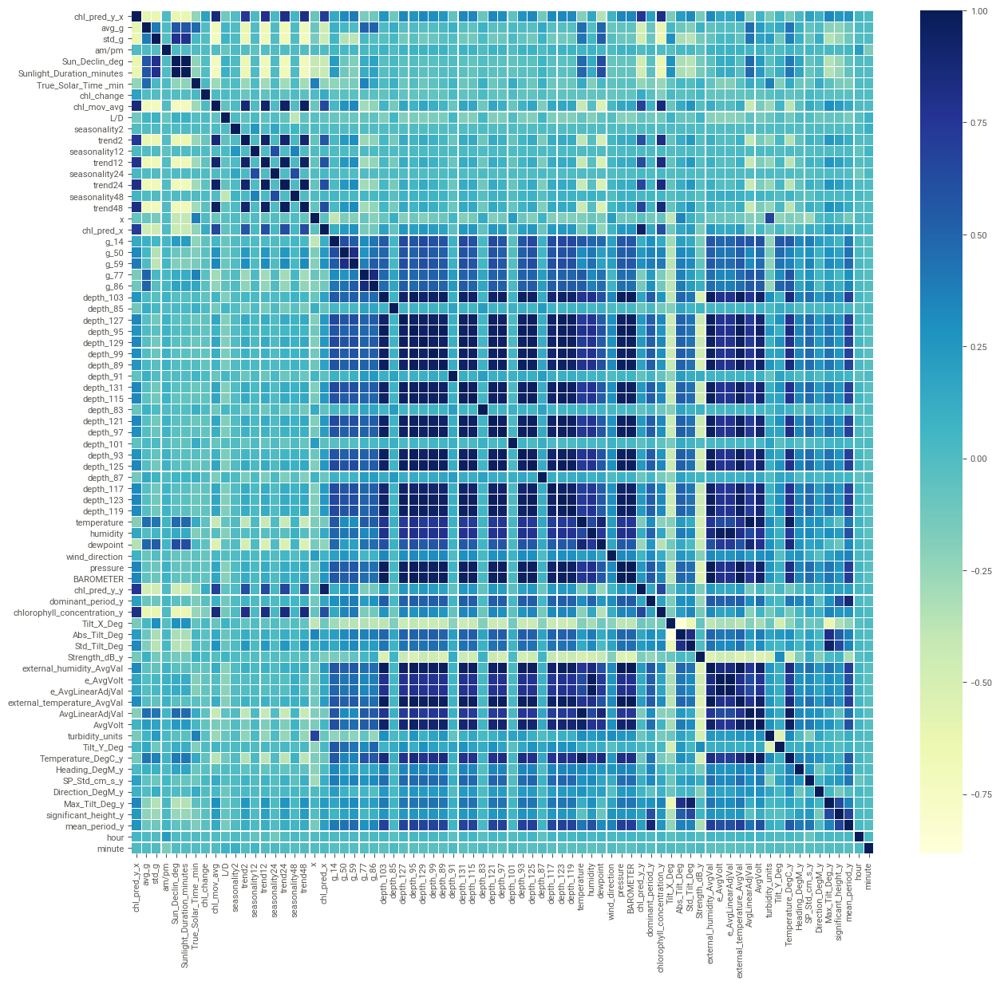

In [426]:
corrmat2 = final_df3.corr() 
f, ax = plt.subplots(figsize =(15, 14)) 
sns.heatmap(corrmat2, ax = ax, cmap ="YlGnBu", linewidths = 0.1),
          
sns.set_context("poster", font_scale = 0.5, rc={"grid.linewidth": 0.6})

# The end of part 1. 


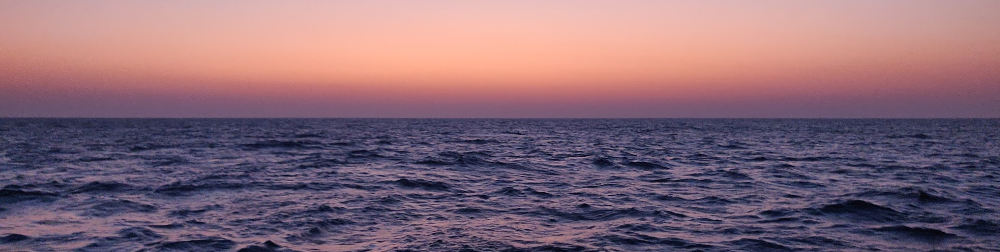